In [1]:
""" 
PROGRAM :  diagnostics_basics.ipynb 

reads in NO3 assimilation runs, historical simulations 
and raw forecasts under CMIP6 emissions 
to produce some basic diagnostics

STATUS  : Complete 
COMMENTS: (1) No adjusted forecast shown here
"""

' \nPROGRAM :  diagnostics_basics.ipynb \n\nreads in NO3 assimilation runs, historical simulations \nand raw forecasts under CMIP6 emissions \nto produce some basic diagnostics\n\nSTATUS  : Complete \nCOMMENTS: (1) No adjusted forecast shown here\n'

In [2]:
import warnings
warnings.filterwarnings('ignore')

from module_data_info import *
from module_data_locations import *
from module_data_load import load_data, load_ensemble, load_biomes
from module_data_preprocessing import * 
from module_data_postprocessing import * 
from module_global_averages import * 
from module_metrics import *
from module_plot_lines import *
from module_plot_maps  import *
from module_plot_bars  import plot_bars

In [3]:
units_dics = {
# unit_change_wo = 1000 # CMIP6 units --> units
'wo' : r'm s$^{-1}$', # ???,
'uo' : r'm s$^{-1}$', # ???,
'vo' : r'm s$^{-1}$', # ???
'uas' : r'm s$^{-1}$', # ???,
'vas' : r'm s$^{-1}$', # ???
'so' : r'psu$', # ???
# unit_change_chl = 1000000 # CMIP6 units --> units
'thetao' : r'deg C', # ???
'density' : r'kg m$^{-3}$', # ???
'agessc' : r'years' }# ???

In [4]:
def nanmasker(ds, dim = 'time', return_mask = False):
    mask = ds.isnull().sum(dim=dim)/len(ds[dim])
    if return_mask:
        return ds * xr.ones_like(mask).where(mask<0.2, np.nan), xr.ones_like(mask).where(mask<0.2, np.nan)
    else:
        return ds * xr.ones_like(mask).where(mask<0.2, np.nan)



In [5]:
# print(dir_forecasts_no3)


print(dir_simulations_so)
print(dir_assimilations_so)


print(dir_simulations_vo)
print(dir_assimilations_vo)


print(dir_simulations_uo)
print(dir_assimilations_uo)

print(dir_simulations_wo)
print(dir_assimilations_wo)

print(dir_simulations_uas)
print(dir_assimilations_uas)

print(dir_simulations_vas)
print(dir_assimilations_vas)

print(dir_simulations_thetao)
print(dir_assimilations_thetao)

print(dir_simulations_thetao)
print(dir_assimilations_thetao)

print(dir_simulations_agessc)
print(dir_assimilations_agessc)

print(dir_biomes_chl)

/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/so/simulation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/so/assimilation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/vo/simulation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/vo/assimilation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/uo/simulation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/uo/assimilation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/wo/simulation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/wo/assimilation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/uas/simulation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/uas/assimilation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/vas/simulation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/vas/assimilation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/theta

In [6]:
sim_uo_info = data_module_uo(dir_simulations_uo)
assim_uo_info = data_module_uo(dir_assimilations_uo)
obs_uo_info = data_module_uo(dir_observations_uo)

sim_vo_info = data_module_vo(dir_simulations_vo)
assim_vo_info = data_module_vo(dir_assimilations_vo)
obs_vo_info = data_module_vo(dir_observations_vo)


sim_uas_info = data_module_uas(dir_simulations_uas)
assim_uas_info = data_module_uas(dir_assimilations_uas)
obs_uas_info = data_module_uas(dir_observations_uas)

sim_vas_info = data_module_vas(dir_simulations_vas)
assim_vas_info = data_module_vas(dir_assimilations_vas)
obs_vas_info = data_module_vas(dir_observations_vas)

sim_so_info = data_module_so(dir_simulations_so)
assim_so_info = data_module_so(dir_assimilations_so)
obs_so_info = data_module_so(dir_observations_so)

sim_wo_info = data_module_wo(dir_simulations_wo)
assim_wo_info = data_module_wo(dir_assimilations_wo)
obs_wo_info = data_module_wo(dir_observations_wo)

sim_thetao_info = data_module_thetao(dir_simulations_thetao)
assim_thetao_info = data_module_thetao(dir_assimilations_thetao)
obs_thetao_info = data_module_thetao(dir_observations_thetao)


sim_agessc_info = data_module_agessc(dir_simulations_agessc)
assim_agessc_info = data_module_agessc(dir_assimilations_agessc)
# obs_agessc_info = data_module_thetao(dir_observations_agessc)

bms_info = biomes_module(dir_biomes_chl)

sim_uo_info.PrintLoc()
assim_uo_info.PrintLoc()
obs_uo_info.PrintLoc()

sim_vo_info.PrintLoc()
assim_vo_info.PrintLoc()
obs_vo_info.PrintLoc()

sim_uas_info.PrintLoc()
assim_uas_info.PrintLoc()
obs_uas_info.PrintLoc()

sim_vas_info.PrintLoc()
assim_vas_info.PrintLoc()
obs_vas_info.PrintLoc()

sim_so_info.PrintLoc()
assim_so_info.PrintLoc()
obs_so_info.PrintLoc()

sim_wo_info.PrintLoc()
assim_wo_info.PrintLoc()
obs_wo_info.PrintLoc()

sim_thetao_info.PrintLoc()
assim_thetao_info.PrintLoc()
obs_thetao_info.PrintLoc()

sim_agessc_info.PrintLoc()
assim_agessc_info.PrintLoc()
# obs_agessc_info.PrintLoc()

bms_info.PrintLoc()

/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/uo/simulation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/uo/assimilation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/uo/observation/SODA
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/vo/simulation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/vo/assimilation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/vo/observation/SODA
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/uas/simulation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/uas/assimilation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/uas/observation/ERA5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/vas/simulation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/vas/assimilation/CanESM5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/vas/observation/ERA5
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/so/simulation/C

In [7]:
sim_dicts = {
    'so' : sim_so_info.data_dict['sim'],
    'thetao' :sim_thetao_info.data_dict['sim'],
    'agessc' : sim_agessc_info.data_dict['sim'],
    'vo' : sim_vo_info.data_dict['sim'],
    'wo' : sim_wo_info.data_dict['sim'],
    'uo' : sim_uo_info.data_dict['sim'],
    'uas' : sim_uas_info.data_dict['sim'],
    'vas' : sim_vas_info.data_dict['sim'],
}

assim_dicts = {
    'so' : assim_so_info.data_dict['asm'],
    'thetao' :assim_thetao_info.data_dict['asm'],
    'agessc' : assim_agessc_info.data_dict['asm'],
    'vo' : assim_vo_info.data_dict['asm'],
    'wo' : assim_wo_info.data_dict['asm'],
    'uo' : assim_uo_info.data_dict['asm'],
    'uas' : assim_uas_info.data_dict['sim'],
    'vas' : assim_vas_info.data_dict['sim'],
}

obs_dicts = {
    'so' : obs_so_info.data_dict['obs'],
    'thetao' :obs_thetao_info.data_dict['obs'],
    # 'agessc' : obs_agessc_info.data_dict['obs'],
    'vo' : obs_vo_info.data_dict['obs'],
    'wo' : obs_wo_info.data_dict['obs'],
    'uo' : obs_uo_info.data_dict['obs'],
        'uas' : obs_uas_info.data_dict['obs'],
    'vas' : obs_vas_info.data_dict['obs'],
}


sim_dir_dicts = {}
assim_dir_dicts = {}
obs_dir_dicts = {}
for var in sim_dicts.keys():

    sim_dir_dicts[var] = sim_dicts[var]['dir']
    assim_dir_dicts[var] = assim_dicts[var]['dir']
    try:
        obs_dir_dicts[var] = obs_dicts[var]['dir']
    except:
        pass


# sim_file_uo = sim_dict_uo['file']
# assim_file_uo = assim_dict_uo['file']
# obs_file_uo = obs_dict_uo['file']

# sim_file_vo = sim_dict_vo['file']
# assim_file_vo = assim_dict_vo['file']
# obs_file_vo = obs_dict_vo['file']

# sim_file_wo = sim_dict_wo['file']
# assim_file_wo = assim_dict_wo['file']
# obs_file_wo = obs_dict_wo['file']

# sim_file_thetao = sim_dict_thetao['file']
# assim_file_thetao = assim_dict_thetao['file']
# obs_file_thetao = obs_dict_thetao['file']

# sim_file_so = sim_dict_so['file']
# assim_file_so = assim_dict_so['file']
# obs_file_so = obs_dict_so['file']
# hnd_dir  = hnd_dict['dir']
# hnd_file = hnd_dict['file']

In [8]:
bms_dict = bms_info.data_dict['biomes']
bms_dir  = bms_dict['dir']
bms_file = bms_dict['file']
bms_dict_plot = bms_info.dict_biomes_plot

In [9]:
verbose = True
if verbose:
    for var in sim_dir_dicts.keys():
        print(sim_dir_dicts[var])
        print(assim_dir_dicts[var])
        try:
            print(obs_dir_dicts[var])
        except:
            pass


/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/so/simulation/CanESM5/so_Omon_ensmebles_*_1x1_LE.nc
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/so/assimilation/CanESM5/so_Omon_ensmebles_*_1x1_LE.nc
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/so/observation/SODA/so_Omon_obs_198001_202312_1x1.nc
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/thetao/simulation/CanESM5/thetao_Omon_ensmebles_*_1x1_LE.nc
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/thetao/assimilation/CanESM5/thetao_Omon_ensmebles_*_1x1_LE.nc
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/thetao/observation/SODA/thetao_Omon_obs_198001_202312_1x1.nc
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/agessc/simulation/CanESM5/agessc_Omon_ensmebles_*_1x1_LE.nc
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/agessc/assimilation/CanESM5/agessc_Omon_ensmebles_*_1x1_LE.nc
/space/hall5/sitestore/eccc/crd/ccrn/users/rpg002/data/vo/simulation/CanESM5/vo_Omon_ensmebles_*

In [10]:
varx_dicts = {
'thetao'     : 'thetao',
'so'     : 'so',
'density'     : 'density',
'agessc'     : 'agessc',
'wo'     : 'wo',
'uo'     : 'uo',
'vo'     : 'vo',
'uas'   : 'uas',
'vas'   : 'vas'}

mdl_set  = 'canesm5'  
ensemble_mean = False

In [11]:
# dir_out = f'{dir_output_chl}/{obs_name}/results/00_Diagnostics/Basics'

In [12]:


y0_sim_thetao = sim_dicts['thetao'] ['y0'] # ini year avaliable simulations
y1_sim_thetao  = sim_dicts['thetao'] ['y1'] # ini year avaliable simulations

y0_assim_thetao  = assim_dicts['thetao'] ['y0'] # ini year avaliable simulations
y1_assim_thetao  = assim_dicts['thetao'] ['y1'] # ini year avaliable simulations

y0_sim_so = sim_dicts['thetao']['y0'] # ini year avaliable simulations
y1_sim_so = sim_dicts['thetao']['y1'] # ini year avaliable simulations


y0_sim_wo = sim_dicts['thetao']['y0'] # ini year avaliable simulations
y1_sim_wo = sim_dicts['thetao']['y1'] # ini year avaliable simulations

y0_sim_uo = sim_dicts['thetao']['y0'] # ini year avaliable simulations
y1_sim_uo = sim_dicts['thetao']['y1'] # ini year avaliable simulations

y0_sim_vo = sim_dicts['thetao']['y0'] # ini year avaliable simulations
y1_sim_vo = sim_dicts['thetao']['y1'] # ini year avaliable simulations


y0_base = 1982          # initial year for base period to compute anomalies
y1_base = 2024          # end     year for base period to compute anomalies

y0_show = 1982            # first initial to show
y1_show = 2022            # last  initial to show

In [13]:
verbose = True
if verbose:
    print(f"y0_sim_thetao  : {y0_sim_thetao }")
    print(f"y1_sim_thetao  : {y1_sim_thetao }")
    print("======")
    print(f"y0_assim_thetao  : {y0_assim_thetao }")
    print(f"y1_assim_thetao  : {y1_assim_thetao }")
    print("======")
    print(f"y0_sim_so : {y0_sim_so}")
    print(f"y1_sim_so : {y1_sim_so}")
    print("======")
    print(f"y0_sim_wo : {y0_sim_wo}")
    print(f"y1_sim_wo : {y1_sim_wo}")
    print("======")
    print(f"y0_sim_vo : {y0_sim_vo}")
    print(f"y1_sim_vo : {y1_sim_vo}")
    print("======")
    print(f"y0_sim_uo : {y0_sim_uo}")
    print(f"y1_sim_uo : {y1_sim_uo}")
    print("======")
    print(f"y0_base: {y0_base}")
    print(f"y1_base: {y1_base}")
    print("======")
    print(f"y0_show: {y0_show}")
    print(f"y1_show: {y1_show}")
    print("======")

y0_sim_thetao  : 1950
y1_sim_thetao  : 2025
y0_assim_thetao  : 1958
y1_assim_thetao  : 2023
y0_sim_so : 1950
y1_sim_so : 2025
y0_sim_wo : 1950
y1_sim_wo : 2025
y0_sim_vo : 1950
y1_sim_vo : 2025
y0_sim_uo : 1950
y1_sim_uo : 2025
y0_base: 1982
y1_base: 2024
y0_show: 1982
y1_show: 2022


In [14]:
# hnd_in = load_ensemble(dir_forecasts_chl,
#                         varx,
#                         1998,
#                         2024,
#                         ensemble_mean=ensemble_mean)*unit_change
# hnd_in, model_mask = nanmasker(hnd_in, return_mask= True)

In [15]:
ensemble_mean = False
obs_levs = load_data(obs_dir_dicts['thetao'], varx_dicts['thetao'], load = False).lev
model_levs = load_data(assim_dir_dicts['thetao'] , varx_dicts['thetao'] , ensemble_mean=True, load = False).lev

sim_in_dicts = {}
assim_in_dicts = {}
obs_in_dicts = {}

for var in ['thetao','so','uo','vo','wo','agessc','uas','vas']:
    if var != 'wo':
        sim_in_dicts[var]  = load_data(sim_dir_dicts[var] , varx_dicts[var] , ensemble_mean=ensemble_mean,ensemble_id=['r1i1p2f1'], load = False) 
        assim_in_dicts[var]  = load_data(assim_dir_dicts[var], varx_dicts[var] , ensemble_mean=True, load = False) 
        try:
            obs_in_dicts[var] =  load_data(obs_dir_dicts[var], varx_dicts[var], load = False).interp(lev = model_levs)
        except:
            try:
                obs_in_dicts[var] =  load_data(obs_dir_dicts[var], varx_dicts[var], load = False)
            except:
                pass

    else:
        sim_in_dicts[var]  = load_data(sim_dir_dicts[var] , varx_dicts[var] , ensemble_mean=ensemble_mean,ensemble_id=['r1i1p2f1'], load = False).interp(lev = model_levs)
        assim_in_dicts[var]  = load_data(assim_dir_dicts[var], varx_dicts[var] , ensemble_mean=True, load = False).interp(lev = model_levs) 
        obs_in_dicts[var] =  load_data(obs_dir_dicts[var], varx_dicts[var], load = False).sel(lev = obs_levs).interp(lev = model_levs)


    # sim_in_wo = load_data(sim_dir_dicts['wo'], varx_dicts, ensemble_mean=ensemble_mean,ensemble_id=['r1i1p2f1'], load = False).interp(lev = model_levs)
    # assim_in_wo = load_data(assim_dicts['wo'], varx_dicts, ensemble_mean=True, load = False).interp(lev = model_levs) #, kwargs={'fill_value': 'extrapolate'})
    # obs_in_wo = load_data(obs_dir_dicts['wo'], varx_dicts, load = False).sel(lev = obs_levs).interp(lev = model_levs) #* ~np.isnan(load_data(obs_dir_wo, varx_wo, load = False))
    
    # sim_in_vo = load_data(sim_dir_vo, varx_dicts, ensemble_mean=ensemble_mean,ensemble_id=['r1i1p2f1'], load = False) 
    # assim_in_vo = load_data(assim_dir_vo, varx_dicts, ensemble_mean=True, load = False) 
    # obs_in_vo = load_data(obs_dir_vo, varx_dicts, load = False).interp(lev = model_levs) #, kwargs={'fill_value': 'extrapolate'})

    # sim_in_uo = load_data(sim_dir_uo, varx_dicts, ensemble_mean=ensemble_mean,ensemble_id=['r1i1p2f1'], load = False) 
    # assim_in_uo = load_data(assim_dir_uo, varx_dicts, ensemble_mean=True, load = False) 
    # obs_in_uo = load_data(obs_dir_uo, varx_dicts, load = False).interp(lev = model_levs) #, kwargs={'fill_value': 'extrapolate'}) 

    # sim_in_so = load_data(sim_dir_so, varx_dicts, ensemble_mean=ensemble_mean,ensemble_id=['r1i1p2f1'], load = False) 
    # assim_in_so = load_data(assim_dir_so, varx_dicts, ensemble_mean=True, load = False) 
    # obs_in_so = load_data(obs_dir_so, varx_dicts, load = False).interp(lev = model_levs) #, kwargs={'fill_value': 'extrapolate'})

sim_in_dicts['density'] = dens0(sim_in_dicts['so'], sim_in_dicts['thetao'] )
assim_in_dicts['density'] = dens0(assim_in_dicts['so'], assim_in_dicts['thetao'] )
obs_in_dicts['density'] = dens0(obs_in_dicts['so'], obs_in_dicts['thetao'])


loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done
loading data..
done


In [16]:
mask_ocean = ~assim_in_dicts['wo'][0,0].squeeze().drop(['year','time','d']).isnull().load()
mask_ocean = mask_ocean.where(mask_ocean ==1)

In [17]:
biomes = load_biomes(f'{bms_dir}',
                     f'{bms_file}')
nbms = 17
bms_labels = [bms_info.biomes_dict[ii]['label'] for ii in np.arange(nbms)+1]

mask_biomes = {}
for bms_label in bms_labels:
    bm = (biomes.MeanBiomes * mask_ocean.squeeze()).where(biomes.MeanBiomes * mask_ocean.squeeze() == bms_labels.index(bms_label)+1, 0)
    mask_biomes[bms_label] = bm.where(bm == 0,1) +  (biomes.MeanBiomes * mask_ocean.squeeze()).where(np.isnan((biomes.MeanBiomes * mask_ocean.squeeze())),0)


loading global ocean biomes..
done


In [18]:
idisplay = False
if idisplay:
    display(biomes)

# rewrite data based on target #

In [19]:
# hnd_in, obs = rewrite_data_like_obs_on_target(hnd_in, 
#                                      obs_in)

# obs = xr.concat([obs for _ in range(int(len(hnd_in.time)/12))], dim = 'time').assign_coords(time = hnd_in.time.values)

# sim_in = rewrite_data_like_obs_on_target(sim_in, 
#                                      obs_in)[0]
# sim_in = xr.concat([sim_in for _ in range(int(len(hnd_in.time)/12))], dim = 'time').assign_coords(time = hnd_in.time.values)

# asm_in = rewrite_data_like_obs_on_target(asm_in, 
#                                      obs_in)[0]

# asm_in = xr.concat([asm_in for _ in range((int(len(hnd_in.time)/12)))], dim = 'time').assign_coords(time = hnd_in.time.values)

# asm_CanOE_in = rewrite_data_like_obs_on_target(asm_CanOE_in, 
#                                      obs_in)[0].sel(year = slice(1980,None))

# asm_CanOE_in = xr.concat([asm_CanOE_in for _ in range((int(len(hnd_in.time)/12)))], dim = 'time').assign_coords(time = hnd_in.time.values)

# del obs_in


In [20]:
ensemble_mean = True
sim_em_dicts = {}
assim_em_dicts = {}

for var in ['thetao','so','density','uo','vo','wo','agessc','uas','vas']:
    if ensemble_mean:
        sim_em_dicts[var] = sim_in_dicts[var].mean('ensembles')

    else:
        sim_em_dicts[var] = sim_in_dicts[var].squeeze()


    assim_em_dicts[var] = assim_in_dicts[var].squeeze()

# assim_em_wo = assim_in_wo.squeeze()
# assim_em_uo = assim_in_uo.squeeze()
# assim_em_vo = assim_in_vo.squeeze()

# assim_em_thetao  = assim_in_thetao .squeeze()
# assim_em_so = assim_in_so.squeeze()
# assim_em_density = assim_in_density.squeeze()
del sim_in_dicts

# del  assim_in_wo,assim_in_uo,assim_in_vo, assim_in_thetao ,assim_in_so, sim_in_wo,sim_in_uo,sim_in_vo ,sim_in_thetao , sim_in_so, assim_in_density, sim_in_density

In [21]:
idisplay = True
if idisplay:
    for var in ['uo','vo','wo','uas','vas']:
        display(sim_em_dicts[var])
        display(assim_em_dicts[var])



<xarray.DataArray 'uo' (year: 76, time: 12, lev: 20, lat: 180, lon: 360)>
dask.array<mean_agg-aggregate, shape=(76, 12, 20, 180, 360), dtype=float32, chunksize=(1, 12, 20, 180, 360), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
    d        (lev) float64 dask.array<chunksize=(20,), meta=np.ndarray>
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
  * lev      (lev) float64 3.047 9.454 16.36 23.9 ... 322.0 382.1 452.4 534.0
  * year     (year) int64 1950 1951 1952 1953 1954 ... 2021 2022 2023 2024 2025

<xarray.DataArray 'uo' (year: 66, time: 12, lev: 20, lat: 180, lon: 360)>
dask.array<concatenate, shape=(66, 12, 20, 180, 360), dtype=float32, chunksize=(1, 12, 20, 180, 360), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
  * lev      (lev) float64 3.047 9.454 16.36 23.9 ... 322.0 382.1 452.4 534.0
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
    d        (lev) float64 dask.array<chunksize=(20,), meta=np.ndarray>
  * year     (year) int64 1958 1959 1960 1961 1962 ... 2019 2020 2021 2022 2023

<xarray.DataArray 'vo' (year: 76, time: 12, lev: 20, lat: 180, lon: 360)>
dask.array<mean_agg-aggregate, shape=(76, 12, 20, 180, 360), dtype=float32, chunksize=(1, 12, 20, 180, 360), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
    d        (lev) float64 dask.array<chunksize=(20,), meta=np.ndarray>
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
  * lev      (lev) float64 3.047 9.454 16.36 23.9 ... 322.0 382.1 452.4 534.0
  * year     (year) int64 1950 1951 1952 1953 1954 ... 2021 2022 2023 2024 2025

<xarray.DataArray 'vo' (year: 66, time: 12, lev: 20, lat: 180, lon: 360)>
dask.array<concatenate, shape=(66, 12, 20, 180, 360), dtype=float32, chunksize=(1, 12, 20, 180, 360), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
  * lev      (lev) float64 3.047 9.454 16.36 23.9 ... 322.0 382.1 452.4 534.0
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
    d        (lev) float64 dask.array<chunksize=(20,), meta=np.ndarray>
  * year     (year) int64 1958 1959 1960 1961 1962 ... 2019 2020 2021 2022 2023

<xarray.DataArray 'wo' (year: 76, time: 12, lev: 20, lat: 180, lon: 360)>
dask.array<mean_agg-aggregate, shape=(76, 12, 20, 180, 360), dtype=float32, chunksize=(1, 12, 20, 180, 360), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
    d        (lev) float64 dask.array<chunksize=(20,), meta=np.ndarray>
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
  * year     (year) int64 1950 1951 1952 1953 1954 ... 2021 2022 2023 2024 2025
  * lev      (lev) float64 3.047 9.454 16.36 23.9 ... 322.0 382.1 452.4 534.0

<xarray.DataArray 'wo' (year: 66, time: 12, lev: 20, lat: 180, lon: 360)>
dask.array<transpose, shape=(66, 12, 20, 180, 360), dtype=float32, chunksize=(1, 12, 20, 180, 360), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
    d        (lev) float64 dask.array<chunksize=(20,), meta=np.ndarray>
  * year     (year) int64 1958 1959 1960 1961 1962 ... 2019 2020 2021 2022 2023
  * lev      (lev) float64 3.047 9.454 16.36 23.9 ... 322.0 382.1 452.4 534.0

<xarray.DataArray 'uas' (year: 76, time: 12, lat: 90, lon: 180)>
dask.array<mean_agg-aggregate, shape=(76, 12, 90, 180), dtype=float32, chunksize=(1, 12, 90, 180), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.0 -87.0 -85.0 -83.0 -81.0 ... 83.0 85.0 87.0 89.0
  * lon      (lon) float64 -179.0 -177.0 -175.0 -173.0 ... 175.0 177.0 179.0
    d        (year, time) float64 dask.array<chunksize=(1, 12), meta=np.ndarray>
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
  * year     (year) int64 1950 1951 1952 1953 1954 ... 2021 2022 2023 2024 2025

<xarray.DataArray 'uas' (year: 66, time: 12, lat: 90, lon: 180)>
dask.array<concatenate, shape=(66, 12, 90, 180), dtype=float32, chunksize=(1, 12, 90, 180), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.0 -87.0 -85.0 -83.0 -81.0 ... 83.0 85.0 87.0 89.0
  * lon      (lon) float64 -179.0 -177.0 -175.0 -173.0 ... 175.0 177.0 179.0
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
    d        (year, time) float64 dask.array<chunksize=(1, 12), meta=np.ndarray>
  * year     (year) int64 1958 1959 1960 1961 1962 ... 2019 2020 2021 2022 2023

<xarray.DataArray 'vas' (year: 76, time: 12, lat: 90, lon: 180)>
dask.array<mean_agg-aggregate, shape=(76, 12, 90, 180), dtype=float32, chunksize=(1, 12, 90, 180), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.0 -87.0 -85.0 -83.0 -81.0 ... 83.0 85.0 87.0 89.0
  * lon      (lon) float64 -179.0 -177.0 -175.0 -173.0 ... 175.0 177.0 179.0
    d        (year, time) float64 dask.array<chunksize=(1, 12), meta=np.ndarray>
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
  * year     (year) int64 1950 1951 1952 1953 1954 ... 2021 2022 2023 2024 2025

<xarray.DataArray 'vas' (year: 66, time: 12, lat: 90, lon: 180)>
dask.array<concatenate, shape=(66, 12, 90, 180), dtype=float32, chunksize=(1, 12, 90, 180), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.0 -87.0 -85.0 -83.0 -81.0 ... 83.0 85.0 87.0 89.0
  * lon      (lon) float64 -179.0 -177.0 -175.0 -173.0 ... 175.0 177.0 179.0
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
    d        (year, time) float64 dask.array<chunksize=(1, 12), meta=np.ndarray>
  * year     (year) int64 1958 1959 1960 1961 1962 ... 2019 2020 2021 2022 2023

In [22]:
idisplay = True
if idisplay:
    for var in ['thetao','so','density','agessc']:
        display(sim_em_dicts[var])
        display(assim_em_dicts[var])



<xarray.DataArray 'thetao' (year: 76, time: 12, lev: 20, lat: 180, lon: 360)>
dask.array<mean_agg-aggregate, shape=(76, 12, 20, 180, 360), dtype=float32, chunksize=(1, 12, 20, 180, 360), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
    d        (lev) float64 dask.array<chunksize=(20,), meta=np.ndarray>
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
  * lev      (lev) float64 3.047 9.454 16.36 23.9 ... 322.0 382.1 452.4 534.0
  * year     (year) int64 1950 1951 1952 1953 1954 ... 2021 2022 2023 2024 2025

<xarray.DataArray 'thetao' (year: 66, time: 12, lev: 20, lat: 180, lon: 360)>
dask.array<concatenate, shape=(66, 12, 20, 180, 360), dtype=float32, chunksize=(1, 12, 20, 180, 360), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
  * lev      (lev) float64 3.047 9.454 16.36 23.9 ... 322.0 382.1 452.4 534.0
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
    d        (lev) float64 dask.array<chunksize=(20,), meta=np.ndarray>
  * year     (year) int64 1958 1959 1960 1961 1962 ... 2019 2020 2021 2022 2023

<xarray.DataArray 'so' (year: 76, time: 12, lev: 20, lat: 180, lon: 360)>
dask.array<mean_agg-aggregate, shape=(76, 12, 20, 180, 360), dtype=float32, chunksize=(1, 12, 20, 180, 360), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
    d        (lev) float64 dask.array<chunksize=(20,), meta=np.ndarray>
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
  * lev      (lev) float64 3.047 9.454 16.36 23.9 ... 322.0 382.1 452.4 534.0
  * year     (year) int64 1950 1951 1952 1953 1954 ... 2021 2022 2023 2024 2025

<xarray.DataArray 'so' (year: 66, time: 12, lev: 20, lat: 180, lon: 360)>
dask.array<concatenate, shape=(66, 12, 20, 180, 360), dtype=float32, chunksize=(1, 12, 20, 180, 360), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
  * lev      (lev) float64 3.047 9.454 16.36 23.9 ... 322.0 382.1 452.4 534.0
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
    d        (lev) float64 dask.array<chunksize=(20,), meta=np.ndarray>
  * year     (year) int64 1958 1959 1960 1961 1962 ... 2019 2020 2021 2022 2023

,Array,Chunk
Bytes,4.40 GiB,59.33 MiB
Shape,"(76, 12, 20, 180, 360)","(1, 12, 20, 180, 360)"
Count,3288 Tasks,76 Chunks
Type,float32,numpy.ndarray


,Array,Chunk
Bytes,3.82 GiB,59.33 MiB
Shape,"(66, 12, 20, 180, 360)","(1, 12, 20, 180, 360)"
Count,2732 Tasks,66 Chunks
Type,float32,numpy.ndarray


<xarray.DataArray 'agessc' (year: 76, time: 12, lev: 20, lat: 180, lon: 360)>
dask.array<mean_agg-aggregate, shape=(76, 12, 20, 180, 360), dtype=float32, chunksize=(1, 12, 20, 180, 360), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
    d        (lev) float64 dask.array<chunksize=(20,), meta=np.ndarray>
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
  * lev      (lev) float64 3.047 9.454 16.36 23.9 ... 322.0 382.1 452.4 534.0
  * year     (year) int64 1950 1951 1952 1953 1954 ... 2021 2022 2023 2024 2025

<xarray.DataArray 'agessc' (year: 66, time: 12, lev: 20, lat: 180, lon: 360)>
dask.array<concatenate, shape=(66, 12, 20, 180, 360), dtype=float32, chunksize=(1, 12, 20, 180, 360), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
  * lev      (lev) float64 3.047 9.454 16.36 23.9 ... 322.0 382.1 452.4 534.0
  * time     (time) int64 0 1 2 3 4 5 6 7 8 9 10 11
    d        (lev) float64 dask.array<chunksize=(20,), meta=np.ndarray>
  * year     (year) int64 1958 1959 1960 1961 1962 ... 2019 2020 2021 2022 2023

In [23]:

ddata_em_bfore = {}
for var in ['thetao','so','density','uo','vo','wo','agessc','uas','vas']:
    ddata_em_bfore[var] = {}

    ddata_em_bfore[var]['historical_CMOC'] = sim_em_dicts[var] * mask_ocean
    ddata_em_bfore[var]['assimilation_CMOC'] = assim_em_dicts[var] * mask_ocean



In [24]:
for var in ['thetao','so','density','uo','vo','wo','agessc','uas','vas']:
    try:
        ddata_em_bfore[var]['obs'] = obs_in_dicts[var] * mask_ocean
    except:
        pass


del obs_in_dicts

In [25]:
# nldyr = 1

# mask_time = np.isnan(ddata_em_bfore['hindcast_CMOC'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,y1_show)).mean(['lat','lon']))
# mask_time = None                                                                            

# ddata_em_after = {
#                   'obs'     : ddata_em_bfore['obs'].where(~mask_time).sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                                                 y1_show)),
#                   'assim_CMOC' : ddata_em_bfore['assim_CMOC'].where(~mask_time).sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                                                 y1_show)),
#                   'assim_CanOE' : ddata_em_bfore['assim_CanOE'].where(~mask_time).sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                                                 y1_show)),
#                   'hindcast_CMOC'  : ddata_em_bfore['hindcast_CMOC'].where(~mask_time).sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                                                 y1_show)),
#                   'historical_CMOC' :ddata_em_bfore['historical_CMOC'].where(~mask_time).sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                                                 y1_show)),
#                }


# del ddata_em_bfore

nldyr = 1
ddata_em_after = {}
for var in ['thetao','so','density','uo','vo','wo','agessc','uas','vas']:
    ddata_em_after[var]  = {}
    for run in ['historical_CMOC', 'assimilation_CMOC', 'obs']:
        try:
            ddata_em_after[var][run]  = ddata_em_bfore[var][run].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,y1_show))
        except:
            pass

del ddata_em_bfore
# ddata_em_after_wo = {
    
#                     'historical_CMOC' :ddata_em_bfore_wo['historical_CMOC'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show)),

#                     'assimilation_CMOC' :ddata_em_bfore_wo['assimilation_CMOC'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show)),

#                     'obs' :ddata_em_bfore_wo['obs'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show))
#                }

# ddata_em_after_uo = {
#                     'obs' :ddata_em_bfore_uo['obs'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show)),
#                     'historical_CMOC' :ddata_em_bfore_uo['historical_CMOC'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show)),
#                     'assimilation_CMOC' :ddata_em_bfore_uo['assimilation_CMOC'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show))
#                }

# ddata_em_after_vo = {
#                     'obs' :ddata_em_bfore_vo['obs'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show)),
#                     'historical_CMOC' :ddata_em_bfore_vo['historical_CMOC'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show)),

#                     'assimilation_CMOC' :ddata_em_bfore_vo['assimilation_CMOC'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show))
#                }


# ddata_em_after_thetao  = {
#                     'obs' :ddata_em_bfore_thetao ['obs'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show)), 
#                     'historical_CMOC' :ddata_em_bfore_thetao ['historical_CMOC'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show)),

#                     'assimilation_CMOC' :ddata_em_bfore_thetao ['assimilation_CMOC'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show))
#                }

# ddata_em_after_so = {
#                     'obs' :ddata_em_bfore_so['obs'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show)),
#                     'historical_CMOC' :ddata_em_bfore_so['historical_CMOC'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show)),

#                     'assimilation_CMOC' :ddata_em_bfore_so['assimilation_CMOC'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show))
#                }

# ddata_em_after_density = {
#                     'obs' :ddata_em_bfore_density['obs'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show)),
#                     'historical_CMOC' :ddata_em_bfore_density['historical_CMOC'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show)),

#                     'assimilation_CMOC' :ddata_em_bfore_density['assimilation_CMOC'].sel(time = np.arange(nldyr * 12)).sel(year=slice(y0_show,
#                                                             y1_show))
#                }


                                                           
# del ddata_em_bfore_wo, ddata_em_bfore_uo, ddata_em_bfore_vo, ddata_em_bfore_thetao, ddata_em_bfore_so, ddata_em_bfore_density

In [26]:
def add_cyclic_point(ds):
    add = ds.isel(lon = -1).assign_coords(lon = ds.isel(lon = -1).lon.values + 1)
    return xr.concat([ds,add], dim = 'lon')

In [27]:
# dict_LE_data = ddata_LE_after
dict_em_data = ddata_em_after


In [28]:
ONI = xr.open_dataset('CanESM5_sim_r1i1p2f1_ONI_1950-2025.nc')['tos'].sel(year = slice(y0_show,y1_show))

time_coords = ONI.stack(ref = ('year','time')).year + (ONI.stack(ref = ('year','time')).time + 0.5) /12
ONI_stacked = ONI.stack(ref = ('year','time')).assign_coords(ref = time_coords.values)

ELNI_active = ONI_stacked.where((ONI_stacked > np.quantile(ONI,0.75)), drop = False)
LANI_active = ONI_stacked.where((ONI_stacked < np.quantile(ONI,0.25)), drop = False)


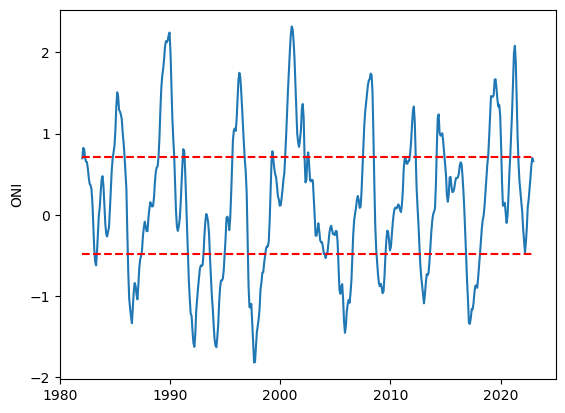

In [29]:
plt.plot(time_coords, ONI_stacked)
plt.ylabel('ONI')
plt.hlines(np.quantile(ONI,0.25),xmin = time_coords.min(), xmax = time_coords.max(), color = 'r', linestyle = 'dashed')
plt.hlines(np.quantile(ONI,0.75),xmin = time_coords.min(), xmax = time_coords.max(), color = 'r', linestyle = 'dashed')

In [30]:
ENSO_years = ((ELNI_active.dropna(dim = 'ref').ref).values)
LANI_years = ((LANI_active.dropna(dim = 'ref').ref).values)


In [31]:
var_list =  ['thetao','so','density','uo','vo','wo','agessc','uas','vas']

# Biomes #

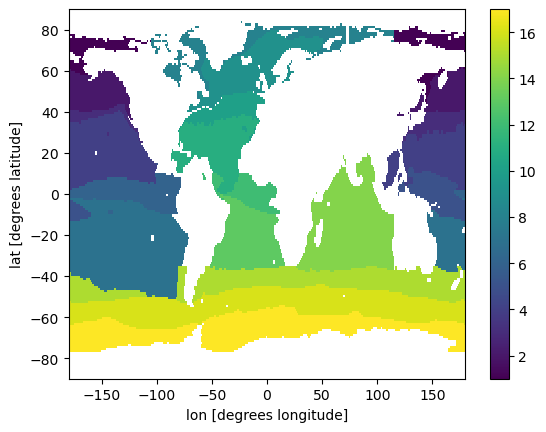

In [32]:
b = (biomes.MeanBiomes * mask_ocean[0].drop('lev')).where(biomes.MeanBiomes * mask_ocean[0].drop('lev') > 0)
b.plot()

# Time-series

### full field

In [32]:
# dict_em_ts_biomes_no3 = {}
# dict_em_ts_biomes_chl = {}
# dict_em_ts_biomes_tos = {}

# tropic_biomes = ['P_EQU_W' ,'P_EQU_E', 'A_EQU']
# for ii, bms_label in enumerate(tropic_biomes):
        
#         biome = biomes.MeanBiomes.where(biomes.MeanBiomes == bms_labels.index(bms_label)+1)
#         biome =spatial_mask(biome.to_dataset()) * mask_ocean
               
#         dict_em_ts_biomes_no3[bms_label] = {
#                 'historical_CMOC' : { 'ts'        : area_weighted_avg(dict_em_data_no3['historical_CMOC'].mean('lev'), mask=biome,
#                                                                 integral=False).load(),
#                                 'color'     : sim_dict_no3['color'],
#                                 'linestyle' : '-',
#                         },
#                 'historical_CanOE' : { 'ts'    : area_weighted_avg(dict_em_data_no3['historical_CanOE'].mean('lev'), mask=biome,
#                                                                 integral=False).load(),
#                                 'color'     : sim_dict_no3_CanOE['color'],
#                                 'linestyle' : '-',
#                         },
#                 }

               
#         dict_em_ts_biomes_chl[bms_label] = {
#                 'historical_CMOC' : { 'ts'        : area_weighted_avg(dict_em_data_chl['historical_CMOC'], mask=biome,
#                                                                 integral=False),
#                                 'color'     : sim_dict_chl['color'],
#                                 'linestyle' : '-'
#                         },
#                 'historical_CanOE' : { 'ts'    : area_weighted_avg(dict_em_data_chl['historical_CanOE'], mask=biome,
#                                                                 integral=False),
#                                 'color'     : sim_dict_chl_CanOE['color'],
#                                 'linestyle' : '-',
#                         },
#                 }
        
                       
#         dict_em_ts_biomes_tos[bms_label] = {
#                 'historical' : { 'ts'        : area_weighted_avg(temp, mask=biome,
#                                                                 integral=False),
#                                 'color'     : 'k',
#                                 'linestyle' : '-',
#                         },
#                 }
        

### anomalies

In [28]:

levs = dict_em_data['uo']['historical_CMOC'].lev.where(dict_em_data['uo']['historical_CMOC'].lev<= 100, drop = True)

dict_clim_mean_removed = {}
dict_anom_mean_clim_removed = {}
for var in var_list:
    
     dict_clim_mean_removed[var] = {

               'historical_CMOC': get_climatology_on_base(dict_em_data[var]['historical_CMOC'].sel(lev = levs).mean('lev'),
                                               y0_base,
                                               y1_base,
                                               ltime_dep=False,  # already aligned to target
                                               full_set=False,
                                               remove_mean = True).load(),  # already aligned to target

                'assimilation_CMOC': get_climatology_on_base(dict_em_data[var]['assimilation_CMOC'].sel(lev = levs).mean('lev'),
                                               y0_base,
                                               y1_base,
                                               ltime_dep=False,  # already aligned to target
                                               full_set=False,
                                               remove_mean = True).load(),  # already aligned to target
            }


     dict_anom_mean_clim_removed[var] = {
                    'historical_CMOC' : (dict_em_data[var]['historical_CMOC'].sel(lev = levs).mean('lev') - dict_clim_mean_removed[var]['historical_CMOC']).load(), 
                    'assimilation_CMOC' : (dict_em_data[var]['assimilation_CMOC'].sel(lev = levs).mean('lev') - dict_clim_mean_removed[var]['assimilation_CMOC']).load(),  
               }





: 

In [496]:
dict_em_anom_ts_biomes = {}


tropic_biomes = ['P_EQU_W' ,'P_EQU_E', 'A_EQU']

for ii, bms_label in enumerate(tropic_biomes):
   for var in var_list:
        dict_em_anom_ts_biomes[var] = {}
        
        biome = biomes.MeanBiomes.where(biomes.MeanBiomes == bms_labels.index(bms_label)+1)
        biome =spatial_mask(biome.to_dataset()) * mask_ocean.squeeze()
        dict_em_anom_ts_biomes[var][bms_label] = { 
                'historical_CMOC' : { 'ts'    : area_weighted_avg(dict_anom_mean_clim_removed[var]['historical_CMOC'], mask=biome,
                                                                integral=False),
                                'color'     : sim_dicts[var]['color'],
                                'linestyle' : '-',
                        },

                'assimilation_CMOC' : { 'ts'    : area_weighted_avg(dict_anom_mean_clim_removed[var]['assimilation_CMOC'], mask=biome,
                                                                integral=False),
                                'color'     : assim_dicts[var]['color'],
                                'linestyle' : '-',
                        },
                }
        



In [ ]:
season = 'ANN'
ds_dicts = dict_em_anom_ts_biomes_thetao 
monthly_res = True
ds_list = ['historical_CMOC','historical_CanOE']
figsize = (18,10)
dict_label = 'ts'
Trend = True
title = f'Anomalies thetao  top 100 meters'
ylabel = units_thetao 
mask_biomes = mask_biomes

plot_ts_biomeavg_on_target(ds_list,
                            ds_dicts,
                            tropic_biomes,
            mask_biomes = mask_biomes,
            xx=None,
            ldyr=1-1,
            dict_label=dict_label,
            ref_ds=None,
            title=title,
            bbox=None,
            figsize=figsize,
            ylabel = ylabel, 
            season = season,
            monthly_res = monthly_res,
            Trend = Trend,
            show = True,
            ENSO_years = ENSO_years)

In [ ]:

season = 'ANN'
ds_dicts = dict_em_anom_ts_biomes_wo
monthly_res = True
ds_list = ['historical_CMOC','historical_CanOE']
figsize = (18,10)
dict_label = 'ts'
Trend = True
title = f'Anomalies wo top 100 meters'
ylabel = units_wo
mask_biomes = mask_biomes

plot_ts_biomeavg_on_target(ds_list,
                            ds_dicts,
                            tropic_biomes,
            mask_biomes = mask_biomes,
            xx=None,
            ldyr=1-1,
            dict_label=dict_label,
            ref_ds=None,
            title=title,
            bbox=None,
            figsize=figsize,
            ylabel = ylabel, 
            season = season,
            monthly_res = monthly_res,
            Trend = Trend,
            show = True,
            ENSO_years = ENSO_years)

# Time vs depth

In [ ]:
# ENSO_years_limits = [ENSO_years[0]]
# start = ENSO_years[0]
# for ind in np.arange(1, len(ENSO_years)):
#     # if np.floor(ENSO_years[ind]) != np.floor(year):
#         if ENSO_years[ind] - ENSO_years[ind-1] > 1/11:
            
#             end = ENSO_years[ind-1]
#             start = ENSO_years[ind]
            

#             if end not in ENSO_years_limits:
#                 ENSO_years_limits.append(end)
#             else: 
#                 ENSO_years_limits.remove(end)
#             ENSO_years_limits.append(start)

#                  #ENSO_years_limits.append(ENSO_years[ind])
                   
# ENSO_years_limits_ = ENSO_years_limits[:-1]
# for ind in range(0,len(ENSO_years_limits_),2):
#     if ENSO_years_limits_[ind + 1] - ENSO_years_limits_[ind] < 1/11:
#         ENSO_years_limits.remove(ENSO_years_limits_[ind])
#         ENSO_years_limits.remove(ENSO_years_limits_[ind+1])
# ENSO_years_limits

ENSO_years_limits = [1982.125, 1982.29166667, 1984.875 , 1985.875  , 1988.95833333,1990.375, 1995.70833333,  1996.70833333, 2000.45833333, 2002.54166667, 2007.54166667 , 2008.45833333, 2011.79166667, 2012.29166667,2014.20833333, 2014.875 , 
2018.875, 2020.04166667,2020.875 ,2021.54166667]#, 2024.79166667,2024.95833333]


ONI_sim = xr.open_dataset('/home/rpg002/BGC_skill/00_diagnostics_basics/CanESM5_sim_r1i1p2f1_ONI_1950-2025.nc')['tos'].sel(year = slice(y0_show,y1_show))
ONI_assim = xr.open_dataset('/home/rpg002/BGC_skill/00_diagnostics_basics/CanESM5_assim_ONI_1975-2023.nc')['tos'].sel(year = slice(y0_show,y1_show))

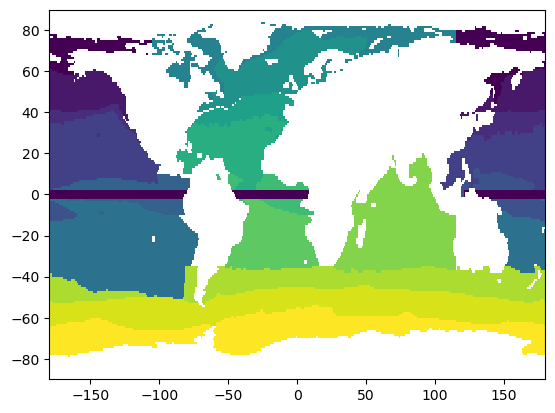

In [36]:

plt.pcolormesh(biomes.MeanBiomes.lon, biomes.MeanBiomes.lat, biomes.MeanBiomes.values)

PEQ = biomes.MeanBiomes.where((biomes.MeanBiomes.lat>= -2) & (biomes.MeanBiomes.lat <= 2))
PEQ = PEQ.where( (PEQ.lon <= -59) | (PEQ.lon >= 121))
PEQ = PEQ.where(np.isnan(PEQ), 1)

PEQ_E = PEQ.where(PEQ.lon<0)
PEQ_W = PEQ.where(PEQ.lon>0)

AEQ = biomes.MeanBiomes.where((biomes.MeanBiomes.lat>= -2) & (biomes.MeanBiomes.lat <= 2))
AEQ = AEQ.where( (AEQ.lon >= -55) & (AEQ.lon <= 20))
AEQ = AEQ.where(np.isnan(AEQ), 1)

plt.pcolormesh(PEQ.lon, PEQ.lat, PEQ.values)
plt.pcolormesh(AEQ.lon, AEQ.lat, AEQ.values)


In [ ]:
mask_EQ = { 'PEQ' : PEQ.where(~np.isnan(PEQ),0), 'AEQ' : AEQ.where(~np.isnan(AEQ),0), 'PEQ_E' : PEQ_E.where(~np.isnan(PEQ_E),0), 'PEQ_W' : PEQ_W.where(~np.isnan(PEQ_W),0)}

In [34]:
from module_plot_maps import plot_depth_vs_time_biomeavg

dict_profile_EQ = {}
dict_clim_mean_removed = {}
dict_anom_mean_clim_removed = {}



color_dict = {'obs' : 'k', 'historical_CMOC' : 'tab:red', 'historical_CanOE' : 'tab:purple', 'assimilation_CMOC' : 'tab:cyan'}

for var in var_list:

    dict_profile_EQ[var] = {}
    dict_clim_mean_removed[var] = {}
    dict_anom_mean_clim_removed[var] = {}
    for region in ['PEQ','PEQ_W','PEQ_E','AEQ']:

        dict_profile_EQ[var][region] = {}
        dict_clim_mean_removed[var][region] = {}
        dict_anom_mean_clim_removed[var][region] = {}

        for ds in ['obs', 'historical_CMOC', 'assimilation_CMOC']:
            try:
                dict_profile_EQ[var][region][ds] = area_weighted_avg(dict_em_data[var][ds], mask=mask_EQ[region],
                                                                        integral=False).load()

                
                dict_clim_mean_removed[var][region][ds] = get_climatology_on_base(dict_profile_EQ[var][region][ds],
                                                    y0_base,
                                                    y1_base,
                                                    ltime_dep=False,  # already aligned to target
                                                    full_set=False,
                                                    remove_mean = True)
                dict_anom_mean_clim_removed[var][region][ds] = {'ts' : dict_profile_EQ[var][region][ds] - dict_clim_mean_removed[var][region][ds],'color' : color_dict[ds], 'linestyle' : '-'} 
            except:
                print(f'{ds} for {var} non-existent' )






In [35]:


# dict_profile_EQ_density = {}
# dict_clim_mean_removed_density = {}
# dict_anom_mean_clim_removed_density = {}


# for region in ['PEQ','PEQ_W','PEQ_E','AEQ']:

#     dict_profile_EQ_density[region] = {}
#     dict_clim_mean_removed_density[region] = {}
#     dict_anom_mean_clim_removed_density[region] = {}


#     for ds in ['obs', 'historical_CMOC', 'assimilation_CMOC']:
#         dict_profile_EQ_density[region][ds] = area_weighted_avg(dict_em_data_density[ds], mask=mask_EQ[region],
#                                                                 integral=False).load()

        
#         dict_clim_mean_removed_density[region][ds] = get_climatology_on_base(dict_profile_EQ_density[region][ds],
#                                                y0_base,
#                                                y1_base,
#                                                ltime_dep=False,  # already aligned to target
#                                                full_set=False,
#                                                remove_mean = True)
#         dict_anom_mean_clim_removed_density[region][ds] = {'ts' : dict_profile_EQ_density[region][ds] - dict_clim_mean_removed_density[region][ds],'color' : color_dict[ds], 'linestyle' : '-'} 



In [ ]:
# season = 'ANN'
# ds_dicts = dict_anom_mean_clim_removed_thetao 
# monthly_res = True
# ds_list = ['historical_CMOC','assimilation_CMOC']
# figsize = (18,10)
# dict_label = 'ts'
# Trend = True

# ylabel = units_thetao 
# mask_biomes = None
# EQ_biomes = ['PEQ', 'AEQ']
# lev_range = 100
# title = f'Anomalies thetao top {lev_range}m'

# plot_ts_biomeavg_on_target(ds_list,
#                             ds_dicts,
#                             EQ_biomes,
#             mask_biomes = mask_biomes,
#             xx=None,
#             ldyr=1-1,
#             dict_label=dict_label,
#             ref_ds=None,
#             title=title,
#             bbox=None,
#             figsize=figsize,
#             ylabel = ylabel, 
#             lev_range = lev_range,
#             season = season,
#             monthly_res = monthly_res,
#             Trend = Trend,
#             show = True,
#             ENSO_years = ENSO_years)

In [ ]:
# season = 'ANN'
# ds_dicts = dict_anom_mean_clim_removed_wo
# monthly_res = True
# ds_list = ['historical_CMOC','assimilation_CMOC']
# figsize = (18,10)
# dict_label = 'ts'
# Trend = True

# ylabel = units_wo
# mask_biomes = None
# EQ_biomes = ['PEQ', 'AEQ']
# lev_range = 100
# title = f'Anomalies wo top {lev_range}m'

# plot_ts_biomeavg_on_target(ds_list,
#                             ds_dicts,
#                             EQ_biomes,
#             mask_biomes = mask_biomes,
#             xx=None,
#             ldyr=1-1,
#             dict_label=dict_label,
#             ref_ds=None,
#             title=title,
#             bbox=None,
#             figsize=figsize,
#             ylabel = ylabel, 
#             lev_range = lev_range,
#             season = season,
#             monthly_res = monthly_res,
#             Trend = Trend,
#             show = True,
#             ENSO_years = ENSO_years)

In [ ]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = 600
bms_label =  'PEQ_E'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_anom_mean_clim_removed['thetao'], unit =  units_dics['thetao'], contour_levels = [8,10,12,14,16,18,20,22,24,26,27,28,29,30,31,32,33,34,36])
plot_dict['so'] = dict(dict = dict_anom_mean_clim_removed['so'], unit =  units_dics['so'], contour_levels = 34 + np.arange(0,1.5,0.1))
plot_dict['density'] = dict(dict = dict_anom_mean_clim_removed['density'], unit =  units_dics['density'], contour_levels =  np.arange(0,30,0.5)+ 1010)


for var in ['thetao', 'so', 'density']:

    ds_dicts = plot_dict[var]['dict']
    title = f'Deseasonalized {var}'
    unit = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']
    plot_depth_vs_time_biomeavg(ds_list,
                                    ds_dicts,
                                    bms_label,
                    ldyr=1-1,
                    title=title,
                    figsize=figsize,
                    contour_levels = contour_levels,
                    # cmap = 'RdBu_r',
                    colorbar_label = unit,
                    season = 'ANN',
                    lev_range = lev_range,
                    monthly_res = monthly_res,
                    ENSO_years = ENSO_years_limits,
                    show=True)

In [ ]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = 600
bms_label =  'PEQ_E'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_anom_mean_clim_removed['thetao'], unit =  units_dics['thetao'], contour_levels = [8,10,12,14,16,18,20,22,24,26,27,28,29,30,31,32,33,34,36])
plot_dict['so'] = dict(dict = dict_anom_mean_clim_removed['so'], unit =  units_dics['so'], contour_levels = 34 + np.arange(0,1.5,0.1))
plot_dict['density'] = dict(dict = dict_anom_mean_clim_removed['density'], unit =  units_dics['density'], contour_levels =  np.arange(0,30,0.5)+ 1010)


for var in ['thetao', 'so', 'density']:

    ds_dicts = plot_dict[var]['dict']
    title = f'Deseasonalized {var}'
    unit = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']
    plot_depth_vs_time_biomeavg(ds_list,
                                    ds_dicts,
                                    bms_label,
                    ldyr=1-1,
                    title=title,
                    figsize=figsize,
                    contour_levels = contour_levels,
                    # cmap = 'RdBu_r',
                    colorbar_label = unit,
                    season = 'ANN',
                    lev_range = lev_range,
                    monthly_res = monthly_res,
                    ENSO_years = 'obs',
                    show=True)

In [ ]:
monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = 600
bms_label =  'PEQ_E'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_anom_mean_clim_removed['thetao'], unit =  units_dics['thetao'], contour_levels = [8,10,12,14,16,18,20,22,24,26,27,28,29,30,31,32,33,34,36])
plot_dict['so'] = dict(dict = dict_anom_mean_clim_removed['so'], unit =  units_dics['so'], contour_levels = 34 + np.arange(0,1.5,0.1))
plot_dict['density'] = dict(dict = dict_anom_mean_clim_removed['density'], unit =  units_dics['density'], contour_levels =  np.arange(0,30,0.5)+ 1010)


for var in ['thetao', 'so', 'density']:

    ds_dicts = plot_dict[var]['dict']
    title = f'Deseasonalized {var}'
    unit = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']
    plot_depth_vs_time_biomeavg(ds_list,
                                    ds_dicts,
                                    bms_label,
                    ldyr=1-1,
                    title=title,
                    figsize=figsize,
                    contour_levels = contour_levels,
                    # cmap = 'RdBu_r',
                    colorbar_label = unit,
                    season = 'ANN',
                    lev_range = lev_range,
                    monthly_res = monthly_res,
                    ENSO_years = 'obs',
                    show=True)

In [ ]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = 600
bms_label =  'PEQ_E'

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_anom_mean_clim_removed['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-20,24,4)* 1e-6 )
plot_dict['uo'] = dict(dict = dict_anom_mean_clim_removed['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-5,6,1) * 1e-1 )
plot_dict['vo'] = dict(dict = dict_anom_mean_clim_removed['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-40,50,10) * 1e-3)


for var in ['wo','uo','vo']:
    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None
    ds_dicts = plot_dict[var]['dict']
    title = f'Deseasonalized {var}'
    unit = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']
    plot_depth_vs_time_biomeavg(ds_list,
                                    ds_dicts,
                                    bms_label,
                    ldyr=1-1,
                    title=title,
                    figsize=figsize,
                    contour_levels = contour_levels,
                    cmap = 'RdBu_r',
                    colorbar_label = unit,
                    season = 'ANN',
                    lev_range = lev_range,
                    monthly_res = monthly_res,
                    ENSO_years = ENSO_years_limits,
                    show=True)

In [ ]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = 600
bms_label =  'PEQ_E'

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_anom_mean_clim_removed['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-20,24,4)* 1e-6 )
plot_dict['uo'] = dict(dict = dict_anom_mean_clim_removed['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-5,6,1) * 1e-1 )
plot_dict['vo'] = dict(dict = dict_anom_mean_clim_removed['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-40,50,10) * 1e-3)

for var in ['wo','uo','vo']:
    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None
    ds_dicts = plot_dict[var]['dict']
    title = f'Deseasonalized {var}'
    unit = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']
    plot_depth_vs_time_biomeavg(ds_list,
                                    ds_dicts,
                                    bms_label,
                    ldyr=1-1,
                    title=title,
                    figsize=figsize,
                    contour_levels = contour_levels,
                    cmap = 'RdBu_r',
                    colorbar_label = unit,
                    season = 'ANN',
                    lev_range = lev_range,
                    monthly_res = monthly_res,
                    ENSO_years = 'obs',
                    show=True)

In [ ]:
monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = 600
bms_label =  'PEQ_E'

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_anom_mean_clim_removed['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-20,24,4)* 1e-6 )
plot_dict['uo'] = dict(dict = dict_anom_mean_clim_removed['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-5,6,1) * 1e-1 )
plot_dict['vo'] = dict(dict = dict_anom_mean_clim_removed['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-40,50,10) * 1e-3)

for var in ['wo','uo','vo']:
    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None
    ds_dicts = plot_dict[var]['dict']
    title = f'Deseasonalized {var}'
    unit = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']
    plot_depth_vs_time_biomeavg(ds_list,
                                    ds_dicts,
                                    bms_label,
                    ldyr=1-1,
                    title=title,
                    figsize=figsize,
                    contour_levels = contour_levels,
                    cmap = 'RdBu_r',
                    colorbar_label = unit,
                    season = 'ANN',
                    lev_range = lev_range,
                    monthly_res = monthly_res,
                    ENSO_years = 'obs',
                    show=True)

In [292]:
del dict_profile_EQ 
del dict_clim_mean_removed
del dict_anom_mean_clim_removed


# Maps

In [33]:
# ENSO_years_limits = [ENSO_years[0]]
# start = ENSO_years[0]
# for ind in np.arange(1, len(ENSO_years)):
#     # if np.floor(ENSO_years[ind]) != np.floor(year):
#         if ENSO_years[ind] - ENSO_years[ind-1] > 1/11:
            
#             end = ENSO_years[ind-1]
#             start = ENSO_years[ind]
            

#             if end not in ENSO_years_limits:
#                 ENSO_years_limits.append(end)
#             else: 
#                 ENSO_years_limits.remove(end)
#             ENSO_years_limits.append(start)

#                  #ENSO_years_limits.append(ENSO_years[ind])
                   
# ENSO_years_limits_ = ENSO_years_limits[:-1]
# for ind in range(0,len(ENSO_years_limits_),2):
#     if ENSO_years_limits_[ind + 1] - ENSO_years_limits_[ind] < 1/11:
#         ENSO_years_limits.remove(ENSO_years_limits_[ind])
#         ENSO_years_limits.remove(ENSO_years_limits_[ind+1])
# ENSO_years_limits

ENSO_years_limits = [1982.125, 1982.29166667, 1984.875 , 1985.875  , 1988.95833333,1990.375, 1995.70833333,  1996.70833333, 2000.45833333, 2002.54166667, 2007.54166667 , 2008.45833333, 2011.79166667, 2012.29166667,2014.20833333, 2014.875 , 
2018.875, 2020.04166667,2020.875 ,2021.54166667]#, 2024.79166667,2024.95833333]


ONI_sim = xr.open_dataset('/home/rpg002/BGC_skill/00_diagnostics_basics/CanESM5_sim_r1i1p2f1_ONI_1950-2025.nc')['tos'].sel(year = slice(y0_show,y1_show))
ONI_assim = xr.open_dataset('/home/rpg002/BGC_skill/00_diagnostics_basics/CanESM5_assim_ONI_1975-2023.nc')['tos'].sel(year = slice(y0_show,y1_show))

## Prepare data for sections

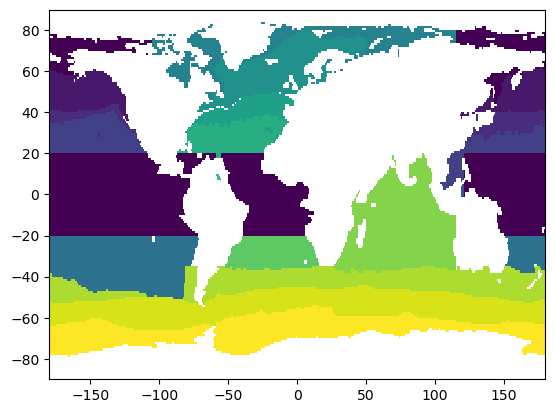

In [34]:

plt.pcolormesh(biomes.MeanBiomes.lon, biomes.MeanBiomes.lat, biomes.MeanBiomes.values)

PEQ = biomes.MeanBiomes.where((biomes.MeanBiomes.lat>= -20) & (biomes.MeanBiomes.lat <= 20))
PEQ = PEQ.where( (PEQ.lon <= -59) | (PEQ.lon >= 121))
PEQ = PEQ.where(np.isnan(PEQ), 1)

PEQ_E = PEQ.where(PEQ.lon<0)
PEQ_W = PEQ.where(PEQ.lon>0)

AEQ = biomes.MeanBiomes.where((biomes.MeanBiomes.lat>= -20) & (biomes.MeanBiomes.lat <= 20))
AEQ = AEQ.where( (AEQ.lon >= -55) & (AEQ.lon <= 20))
AEQ = AEQ.where(np.isnan(AEQ), 1)

plt.pcolormesh(PEQ.lon, PEQ.lat, PEQ.values)
plt.pcolormesh(AEQ.lon, AEQ.lat, AEQ.values)

mask_EQ = { 'PEQ' : PEQ.where(~np.isnan(PEQ),0), 'AEQ' : AEQ.where(~np.isnan(AEQ),0), 'PEQ_E' : PEQ_E.where(~np.isnan(PEQ_E),0), 'PEQ_W' : PEQ_W.where(~np.isnan(PEQ_W),0)}

In [35]:

dict_profile_EQ_REF = {}
dict_clim_mean_removed_REF = {}
dict_anom_snaps_clim_removed_REF = {}

for var in var_list:

    dict_profile_EQ_REF[var] = {}
    dict_clim_mean_removed_REF[var] = {}
    dict_anom_snaps_clim_removed_REF[var] = {}   

    for region in ['PEQ','AEQ']:
        dict_profile_EQ_REF[var][region] = {}
        dict_clim_mean_removed_REF[var][region] = {}
        dict_anom_snaps_clim_removed_REF[var][region] = {}


        for ds in ['obs','historical_CMOC', 'assimilation_CMOC']:
            try:
                dict_profile_EQ_REF[var][region][ds] = dict_em_data[var][ds].where(mask_EQ[region] == 1)
                
                
                
                dict_clim_mean_removed_REF[var][region][ds] = get_climatology_on_base(dict_profile_EQ_REF[var][region][ds],
                                                    y0_base,
                                                    y1_base,
                                                    ltime_dep=False,  # already aligned to target
                                                    full_set=False,
                                                    remove_mean = True).load()
                
                dict_anom_snaps_clim_removed_REF[var][region][ds] = (dict_profile_EQ_REF[var][region][ds] - dict_clim_mean_removed_REF[var][region][ds]).squeeze()


            except:

                print(f'{ds} for {var} npon-existent! ')




obs for agessc npon-existent! 
obs for agessc npon-existent! 
obs for uas npon-existent! 
obs for uas npon-existent! 
obs for vas npon-existent! 
obs for vas npon-existent! 


## profiles

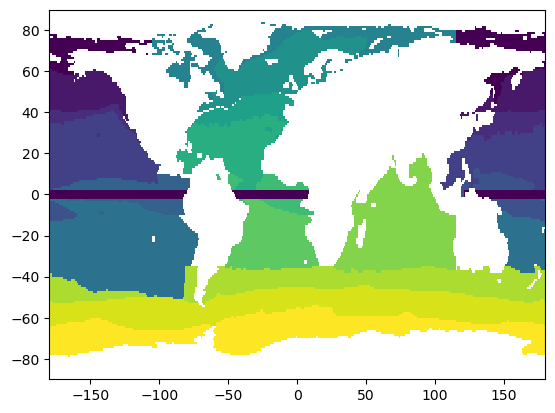

In [35]:

plt.pcolormesh(biomes.MeanBiomes.lon, biomes.MeanBiomes.lat, biomes.MeanBiomes.values)

PEQ = biomes.MeanBiomes.where((biomes.MeanBiomes.lat>= -2) & (biomes.MeanBiomes.lat <= 2))
PEQ = PEQ.where( (PEQ.lon <= -59) | (PEQ.lon >= 121))
PEQ = PEQ.where(np.isnan(PEQ), 1)

PEQ_E = PEQ.where(PEQ.lon<0)
PEQ_W = PEQ.where(PEQ.lon>0)

AEQ = biomes.MeanBiomes.where((biomes.MeanBiomes.lat>= -2) & (biomes.MeanBiomes.lat <= 2))
AEQ = AEQ.where( (AEQ.lon >= -55) & (AEQ.lon <= 20))
AEQ = AEQ.where(np.isnan(AEQ), 1)

plt.pcolormesh(PEQ.lon, PEQ.lat, PEQ.values)
plt.pcolormesh(AEQ.lon, AEQ.lat, AEQ.values)

mask_EQ = { 'PEQ' : PEQ.where(~np.isnan(PEQ),0), 'AEQ' : AEQ.where(~np.isnan(AEQ),0), 'PEQ_E' : PEQ_E.where(~np.isnan(PEQ_E),0), 'PEQ_W' : PEQ_W.where(~np.isnan(PEQ_W),0)}

In [36]:

dict_profile_EQ = {}
dict_clim_mean_removed = {}
dict_anom_snaps_clim_removed = {}

for var in var_list:
    dict_profile_EQ[var] = {}
    dict_clim_mean_removed[var] = {}
    dict_anom_snaps_clim_removed[var] = {}

    for region in ['PEQ','AEQ']:
        dict_profile_EQ[var][region] = {}
        dict_clim_mean_removed[var][region] = {}
        dict_anom_snaps_clim_removed[var][region] = {}


        for ds in ['obs','historical_CMOC', 'assimilation_CMOC']:
            try:
                dict_profile_EQ[var][region][ds] = dict_profile_EQ_REF[var][region][ds].where(mask_EQ[region] == 1, drop = True).mean('lat')                   
                dict_clim_mean_removed[var][region][ds] = dict_clim_mean_removed_REF[var][region][ds].where(mask_EQ[region] == 1, drop = True).mean('lat')
                dict_anom_snaps_clim_removed[var][region][ds] = dict_anom_snaps_clim_removed_REF[var][region][ds].where(mask_EQ[region] == 1, drop = True).mean('lat')


                if region == 'PEQ':

                    dict_anom_snaps_clim_removed[var][region][ds]['lon'] = np.mod(dict_anom_snaps_clim_removed[var][region][ds]['lon'] + 360,360)
                    dict_anom_snaps_clim_removed[var][region][ds] = dict_anom_snaps_clim_removed[var][region][ds].sortby('lon')
            except:
                print(f'{ds} for {var} non-existent!')





obs for agessc non-existent!
obs for agessc non-existent!
obs for uas non-existent!
obs for uas non-existent!
obs for vas non-existent!
obs for vas non-existent!


In [37]:
data_dicts_LANI = {}
data_dicts_ELNI = {}
for var in var_list:

    data_dicts_LANI[var] = {}
    data_dicts_ELNI[var] = {}

    for bm in dict_anom_snaps_clim_removed[var].keys():
        data_dicts_LANI[var][bm] = {}
        data_dicts_ELNI[var][bm] = {}

        for ds in dict_anom_snaps_clim_removed[var][bm].keys():
                if 'historical' in ds:
                    data_dicts_LANI[var][bm][ds] = dict_anom_snaps_clim_removed[var][bm][ds].where(ONI_sim<=np.quantile(ONI_sim,0.25))
                    data_dicts_ELNI[var][bm][ds] = dict_anom_snaps_clim_removed[var][bm][ds].where(ONI_sim>=np.quantile(ONI_sim,0.75))

                else:
                    data_dicts_LANI[var][bm][ds] = dict_anom_snaps_clim_removed[var][bm][ds].where(ONI_assim<=np.quantile(ONI_assim,0.25))
                    data_dicts_ELNI[var][bm][ds] = dict_anom_snaps_clim_removed[var][bm][ds].where(ONI_assim>=np.quantile(ONI_assim,0.75))


data_dicts_diff = {}

for var in var_list:
    data_dicts_diff[var] = {}

    for bm in dict_anom_snaps_clim_removed[var].keys():
        data_dicts_diff[var][bm] = {}


        for ds in dict_anom_snaps_clim_removed[var][bm].keys():

                data_dicts_diff[var][bm][ds] = (data_dicts_LANI[var][bm][ds].mean('year') - data_dicts_ELNI[var][bm][ds].mean('year')).expand_dims('year', axis = 0).assign_coords(year = ['diff'])



#### historical

##### La Nina

In [ ]:



monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_LANI['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4 )
plot_dict['uo'] = dict(dict = data_dicts_LANI['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-10,12,2) * 1e-1 )
plot_dict['vo'] = dict(dict = data_dicts_LANI['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3 )



for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO negative'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



In [ ]:



monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['thetao']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_LANI['thetao'], unit =  units_dics['thetao'], contour_levels = [6,8,10,12,14,16,18,20,22,24,26,28,30,32] )
plot_dict['so'] = dict(dict = data_dicts_LANI['so'], unit =  units_dics['so'], contour_levels = 32.5 + np.arange(0,3.2,0.2) )
plot_dict['density'] = dict(dict = data_dicts_LANI['density'], unit =  units_dics['density'], contour_levels = np.arange(0,30,0.5)+ 1010 )


for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)}  Deseasonalized {var} - ENSO negative'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### El Nino

In [ ]:

monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['wo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_ELNI['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4 )
plot_dict['uo'] = dict(dict = data_dicts_ELNI['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-10,12,2) * 1e-1 )
plot_dict['vo'] = dict(dict = data_dicts_ELNI['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3 )


for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO positive'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



In [ ]:

monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['so']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_ELNI['thetap'], unit =  units_dics['thetao'], contour_levels = [6,8,10,12,14,16,18,20,22,24,26,28,30,32] )                           
plot_dict['so'] = dict(dict = data_dicts_ELNI['so'], unit =  units_dics['so'], contour_levels = 32.5 + np.arange(0,3.2,0.2) )
plot_dict['density'] = dict(dict = data_dicts_ELNI['density'], unit =  units_dics['density'], contour_levels = np.arange(0,30,0.5)+ 1010 )


for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO positive'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### diff

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


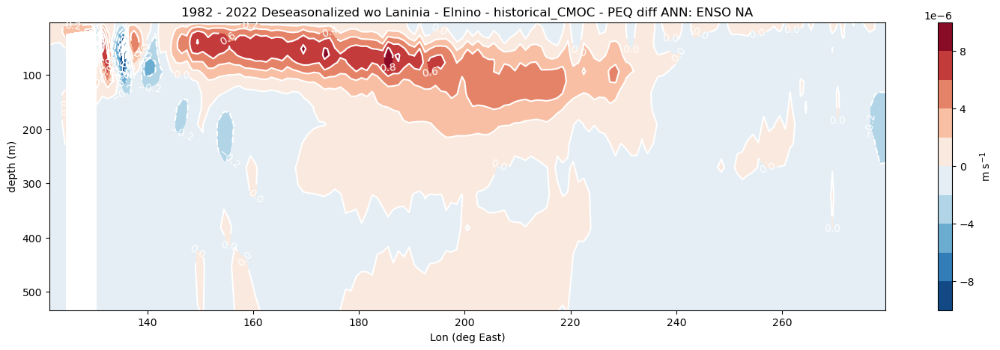

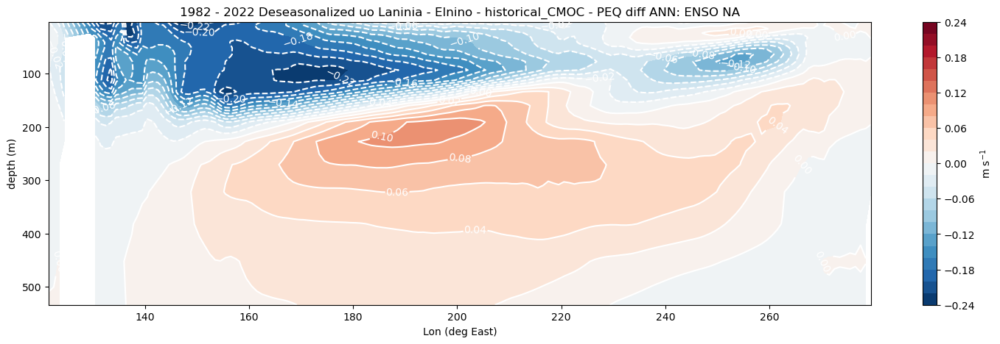

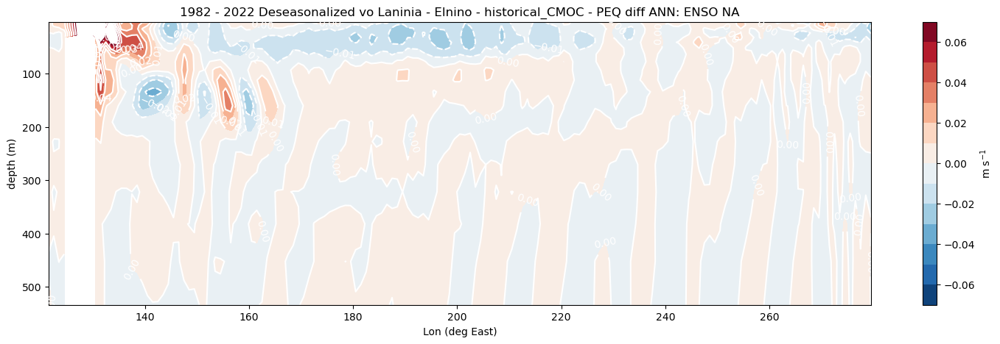

In [92]:

monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = ['diff']
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_diff['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.1,0.12,0.02)* 1e-4  )
plot_dict['uo'] = dict(dict = data_dicts_diff['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-2.4,2.6,0.2) * 1e-1)
plot_dict['vo'] = dict(dict = data_dicts_diff['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3  )



for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} Laninia - Elnino'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']
    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None
    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


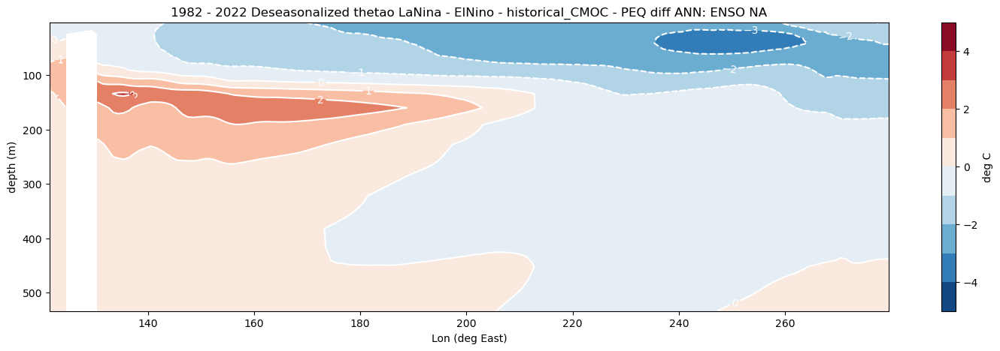

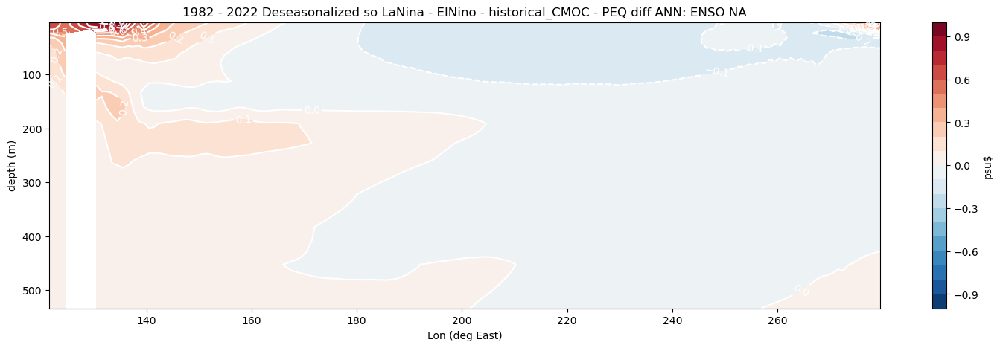

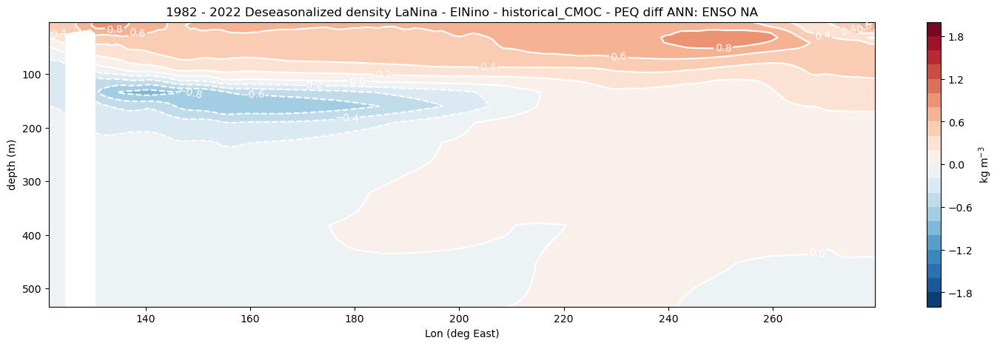

In [45]:

monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = ['diff']
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_diff['thetao'], unit =  units_dics['thetao'], contour_levels = np.arange(-5,6) )
plot_dict['so'] = dict(dict = data_dicts_diff['so'], unit =  units_dics['thetao'], contour_levels = np.arange(-1,1.1,0.1) )
plot_dict['density'] = dict(dict = data_dicts_diff['density'], unit =  units_dics['thetao'], contour_levels = np.arange(-2,2.2,0.2) )

for var in ['thetao', 'so','density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} LaNina - ElNino'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



#### assimilation

##### La Nina

In [ ]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['so']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_LANI['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4 )
plot_dict['uo'] = dict(dict = data_dicts_LANI['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-10,12,2) * 1e-1 )
plot_dict['vo'] = dict(dict = data_dicts_LANI['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3 )



for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO negative'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



In [ ]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['so']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_LANI['thetao'], unit =  units_dics['thetao'], contour_levels = [6,8,10,12,14,16,18,20,22,24,26,28,30,32] )                        
plot_dict['so'] = dict(dict = data_dicts_LANI['so'], unit =  units_dics['so'], contour_levels = 32.5 + np.arange(0,3.4,0.2) )
plot_dict['density'] = dict(dict = data_dicts_LANI['density'], unit =  units_dics['density'], contour_levels = np.arange(0,30,0.5)+ 1010 )

for var in ['thetao', 'so']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO negative'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### El Nino

In [ ]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['so']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_ELNI['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4 )
plot_dict['uo'] = dict(dict = data_dicts_ELNI['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-10,12,2) * 1e-1 )
plot_dict['vo'] = dict(dict = data_dicts_ELNI['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3 )

for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO positive'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



In [ ]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['so']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_ELNI['thetao'], unit =  units_dics['thetao'], contour_levels = [6,8,10,12,14,16,18,20,22,24,26,28,30,32] )                        
plot_dict['so'] = dict(dict = data_dicts_ELNI['so'], unit =  units_dics['so'], contour_levels = 32.5 + np.arange(0,3.4,0.2) )
plot_dict['density'] = dict(dict = data_dicts_ELNI['density'], unit =  units_dics['density'], contour_levels = np.arange(0,30,0.5)+ 1010 )

for var in ['thetao', 'so']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO positive'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### diff

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


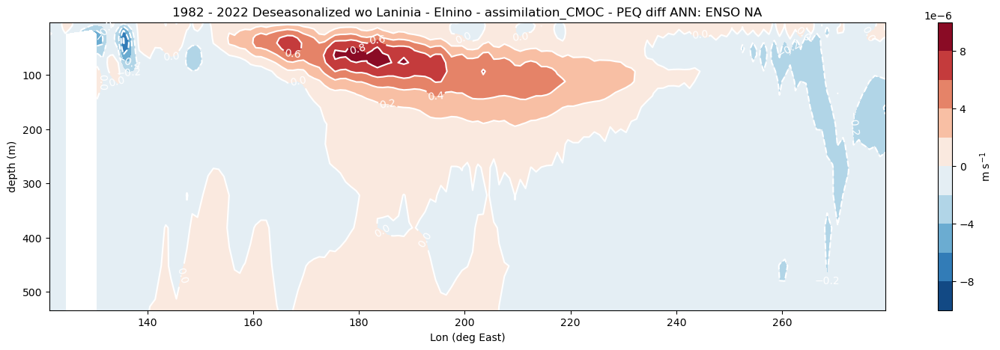

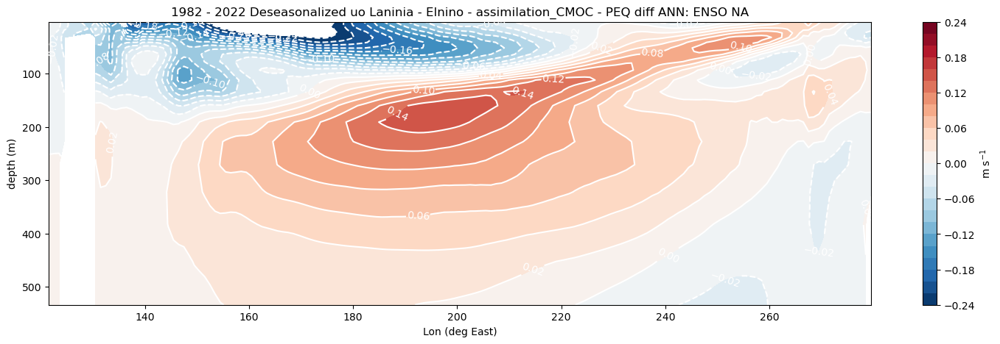

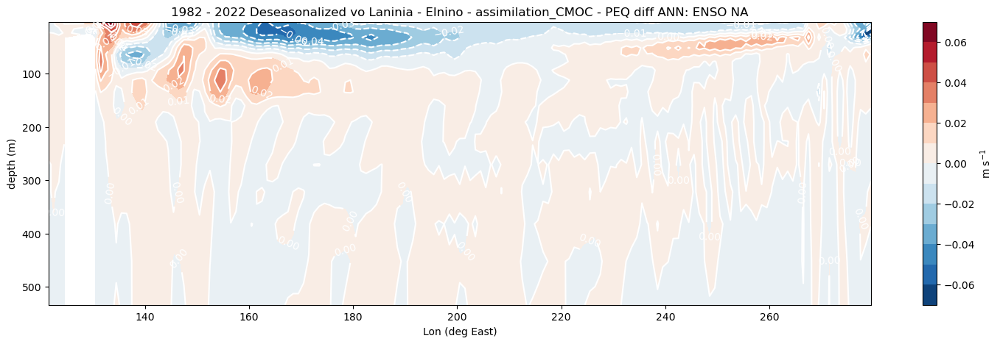

In [93]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = ['diff']
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_diff['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.1,0.12,0.02)* 1e-4  )
plot_dict['uo'] = dict(dict = data_dicts_diff['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-2.4,2.6,0.2) * 1e-1)
plot_dict['vo'] = dict(dict = data_dicts_diff['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3  )



for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} Laninia - Elnino'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']
    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None
    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


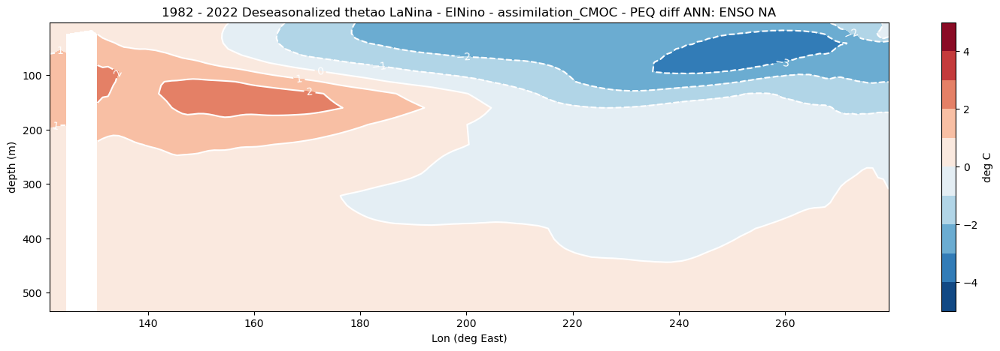

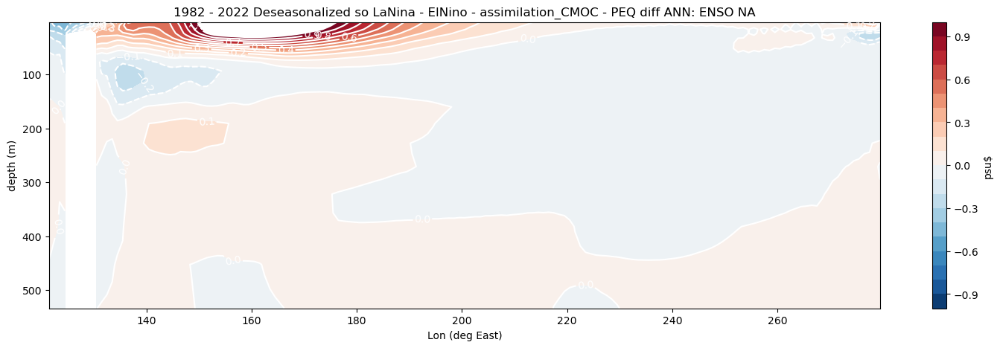

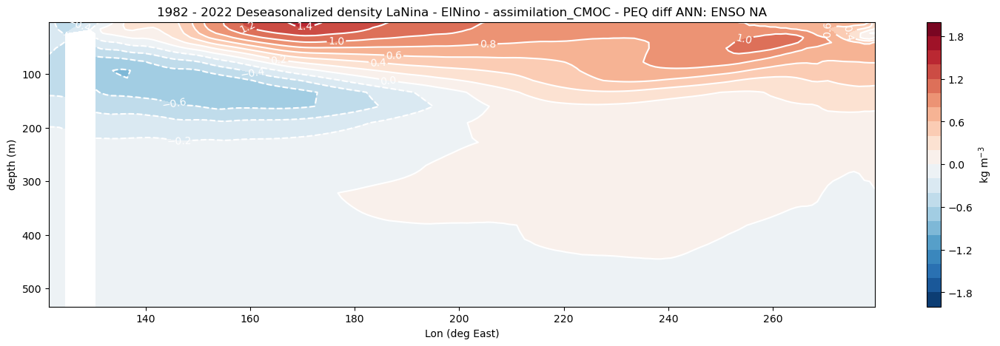

In [46]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = ['diff']
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_diff['thetao'], unit =  units_dics['thetao'], contour_levels = np.arange(-5,6) )
plot_dict['so'] = dict(dict = data_dicts_diff['so'], unit =  units_dics['so'], contour_levels = np.arange(-1,1.1,0.1) )
plot_dict['density'] = dict(dict = data_dicts_diff['density'], unit =  units_dics['density'], contour_levels = np.arange(-2,2.2,0.2) )

for var in ['thetao', 'so','density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} LaNina - ElNino'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



#### Obs

##### La Nina

In [ ]:

monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['so']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_LANI['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4 )
plot_dict['uo'] = dict(dict = data_dicts_LANI['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-10,12,2) * 1e-1 )
plot_dict['vo'] = dict(dict = data_dicts_LANI['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3 )



for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO negative'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



In [ ]:

monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['so']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_LANI['thetao'], unit =  units_dics['thetao'], contour_levels = [6,8,10,12,14,16,18,20,22,24,26,28,30,32] )                        
plot_dict['so'] = dict(dict = data_dicts_LANI['so'], unit =  units_dics['so'], contour_levels = 32.5 + np.arange(0,3.4,0.2) )
plot_dict['density'] = dict(dict = data_dicts_LANI['density'], unit =  units_dics['density'], contour_levels = np.arange(0,30,0.5)+ 1010 )

for var in ['thetao', 'so']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO negative'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### El Nino

In [ ]:

monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['so']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_ELNI['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4 )
plot_dict['uo'] = dict(dict = data_dicts_ELNI['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-10,12,2) * 1e-1 )
plot_dict['vo'] = dict(dict = data_dicts_ELNI['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3 )

for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO positive'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



In [ ]:

monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['so']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_ELNI['thetao'], unit =  units_dics['thetao'], contour_levels = [6,8,10,12,14,16,18,20,22,24,26,28,30,32] )                        
plot_dict['so'] = dict(dict = data_dicts_ELNI['so'], unit =  units_dics['so'], contour_levels = 32.5 + np.arange(0,3.4,0.2) )
plot_dict['density'] = dict(dict = data_dicts_ELNI['density'], unit =  units_dics['density'], contour_levels = np.arange(0,30,0.5)+ 1010 )

for var in ['thetao', 'so']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO positive'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### diff

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


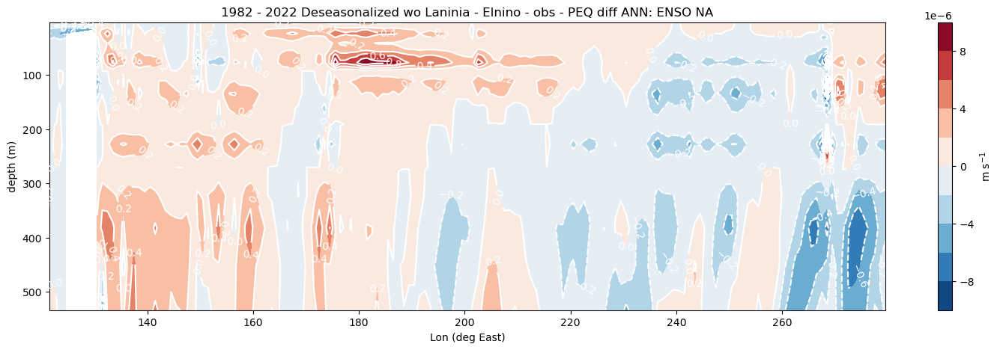

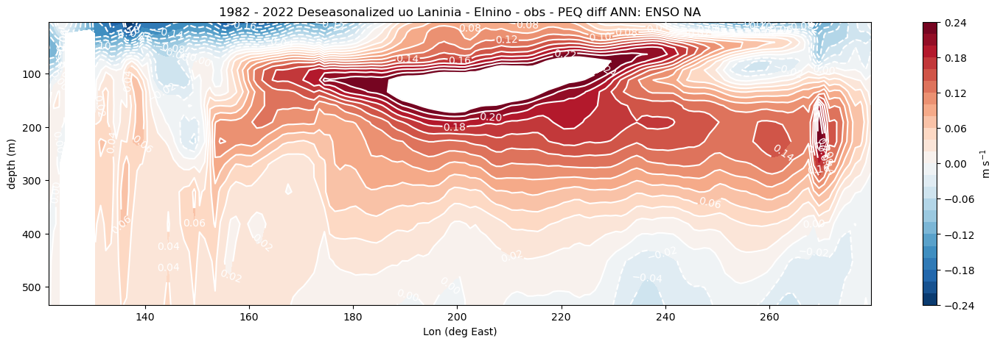

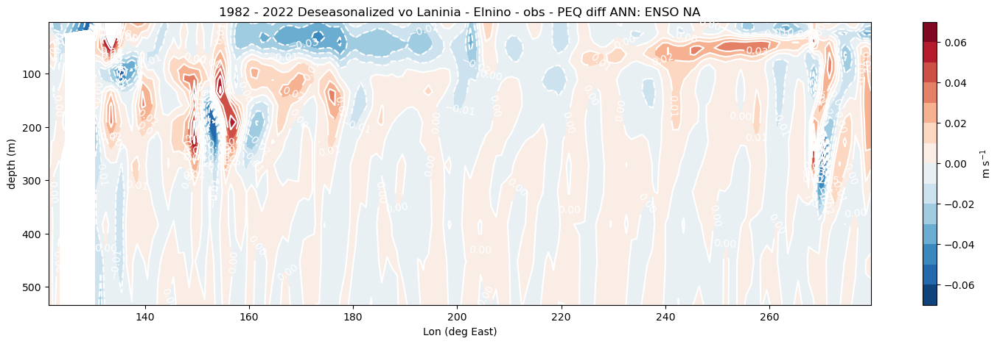

In [47]:

monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = 600
yeartoplot = ['diff']
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_diff['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.1,0.12,0.02)* 1e-4  )
plot_dict['uo'] = dict(dict = data_dicts_diff['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-2.4,2.6,0.2) * 1e-1)
plot_dict['vo'] = dict(dict = data_dicts_diff['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3  )



for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} Laninia - Elnino'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']
    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None
    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


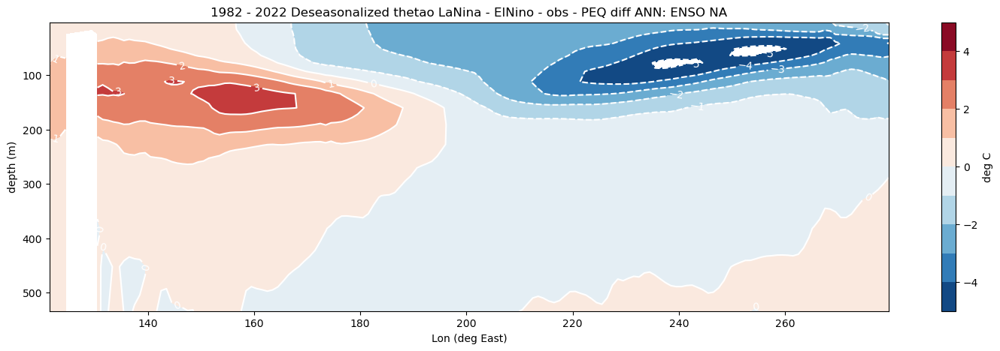

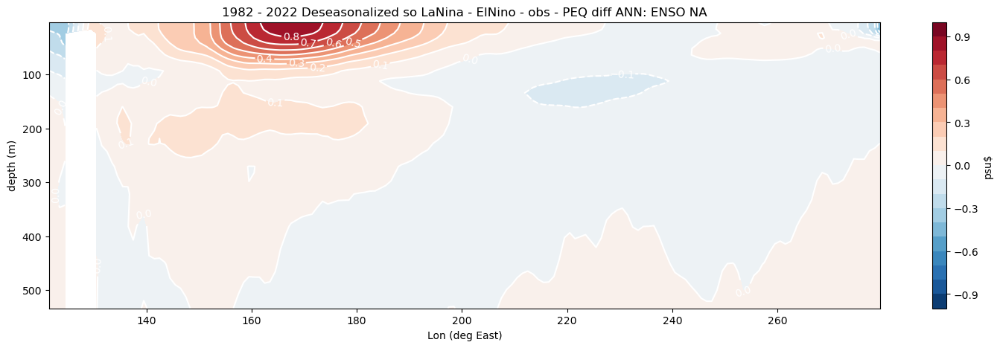

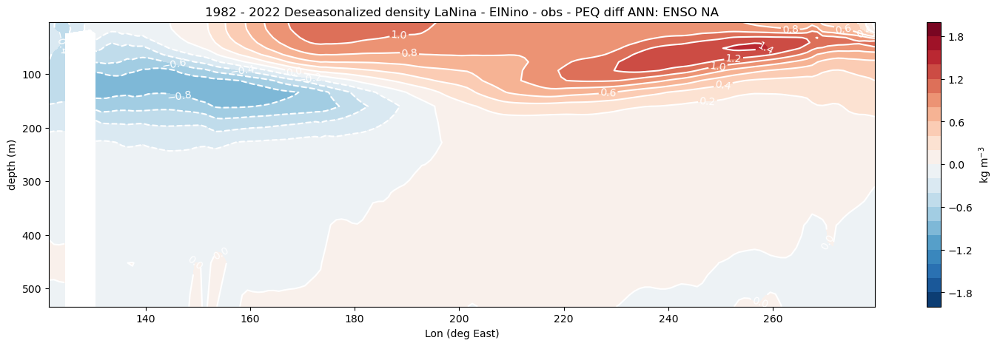

In [48]:

monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = 600
yeartoplot = ['diff']
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_diff['thetao'], unit =  units_dics['thetao'], contour_levels = np.arange(-5,6) )
plot_dict['so'] = dict(dict = data_dicts_diff['so'], unit =  units_dics['so'], contour_levels = np.arange(-1,1.1,0.1) )
plot_dict['density'] = dict(dict = data_dicts_diff['density'], unit =  units_dics['density'], contour_levels = np.arange(-2,2.2,0.2) )

for var in ['thetao', 'so','density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} LaNina - ElNino'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



#### compare climatology of assim vs hist

In [73]:
for var in var_list:
    for region in ['PEQ', 'AEQ']:
        for ds in ['obs', 'assimilation_CMOC', 'historical_CMOC']:
            try:
                dict_profile_EQ[var][region][ds]['lon'] = np.mod(dict_profile_EQ[var][region][ds]['lon'] + 360,360)
                dict_profile_EQ[var][region][ds] = dict_profile_EQ[var][region][ds].sortby('lon')
            except:
                print(f'{ds} fpr {var} non-existent!')




dict_profile_EQ_diff = {}
for var in var_list:
    dict_profile_EQ_diff[var] = {}
    for region in ['PEQ', 'AEQ']:
        dict_profile_EQ_diff[var][region] = {}

        dict_profile_EQ_diff[var][region]['assimilation_CMOC - historical_CMOC'] = dict_profile_EQ[var][region]['assimilation_CMOC'] - dict_profile_EQ[var][region]['historical_CMOC']
        try:
            dict_profile_EQ_diff[var][region]['assimilation_CMOC - obs'] = dict_profile_EQ[var][region]['assimilation_CMOC'] - dict_profile_EQ[var][region]['obs']
            dict_profile_EQ_diff[var][region]['historical_CMOC - obs'] = dict_profile_EQ[var][region]['historical_CMOC'] - dict_profile_EQ[var][region]['obs']
        except:
            print(f'obs for {var} non-existent!')

obs fpr agessc non-existent!
obs fpr agessc non-existent!
obs for agessc non-existent!
obs for agessc non-existent!


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


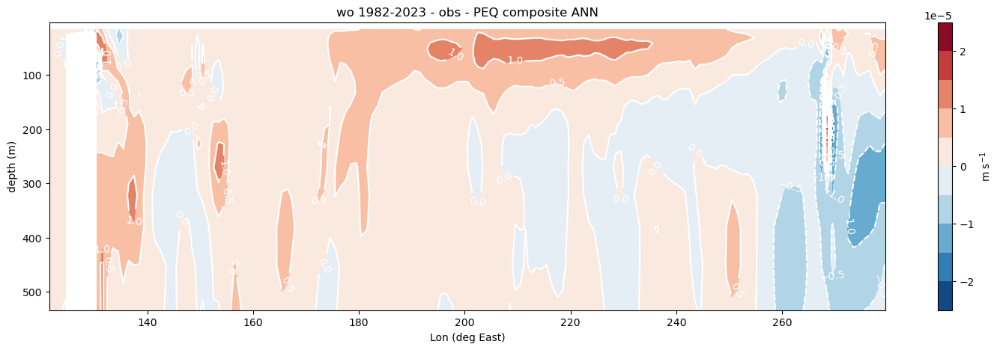

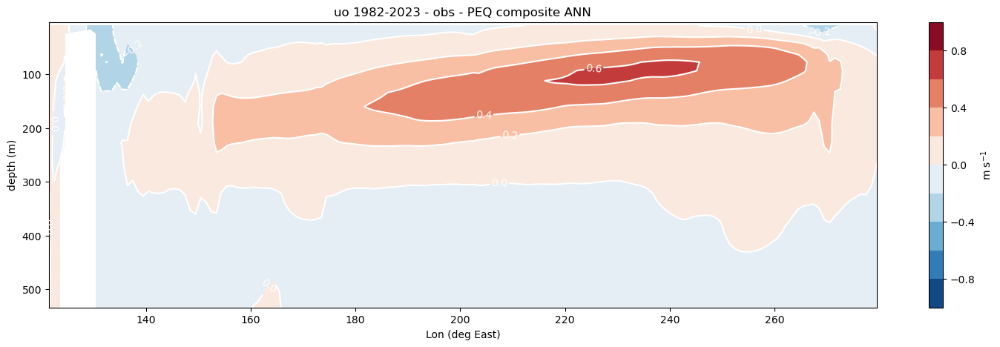

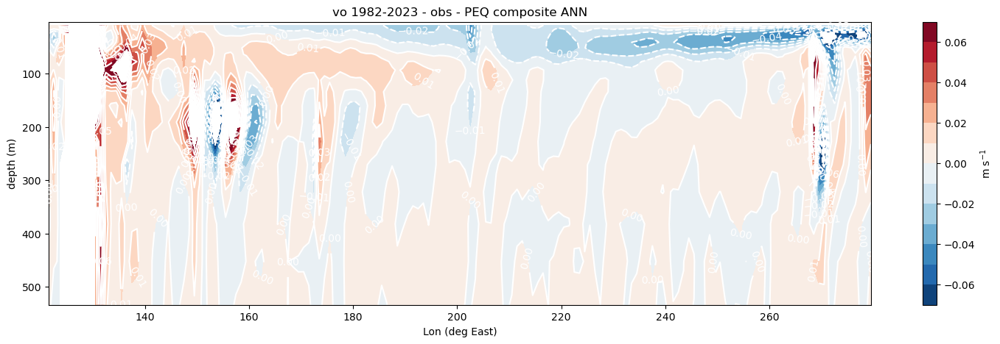

In [39]:

monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}

plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4 )
plot_dict['uo'] = dict(dict = dict_profile_EQ['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-10,12,2) * 1e-1)
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3 )

for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None


    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


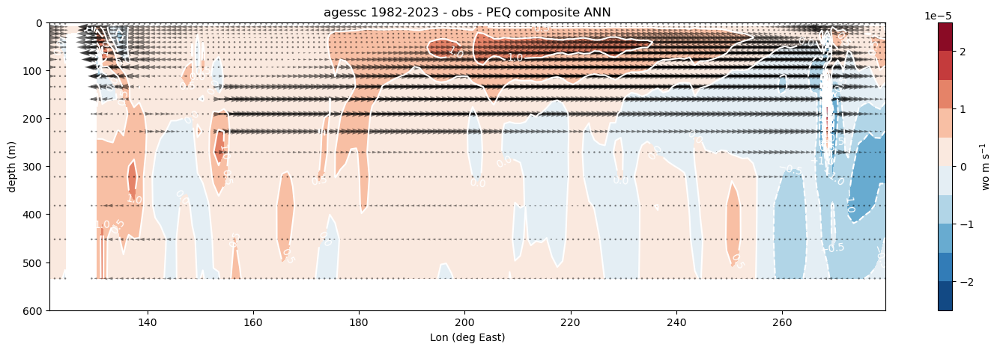

In [78]:

monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}

plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4 )
plot_dict['uo'] = dict(dict = dict_profile_EQ['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-10,12,2) * 1e-1)
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3 )


title = f'{var} 1982-2023'

ds_dicts_x = plot_dict['uo']['dict']
ds_dicts_y = plot_dict['wo']['dict']

ds_dicts = plot_dict['wo']['dict']
contour_levels = plot_dict['wo']['contour_levels']
units = 'wo ' + plot_dict['wo']['unit']


snapshot_depth_vs_lon_quiver(ds_list,
                            ds_dicts_x,
                            ds_dicts_y,
                            bms_label,
                            yeartoplot,
            title=title,
            figsize=figsize,
            contour_dict=ds_dicts,
            contour_levels = contour_levels,
            cmap = 'RdBu_r',
            colorbar_label = units, 
            season = 'ANN',
            lev_range = lev_range,
            show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


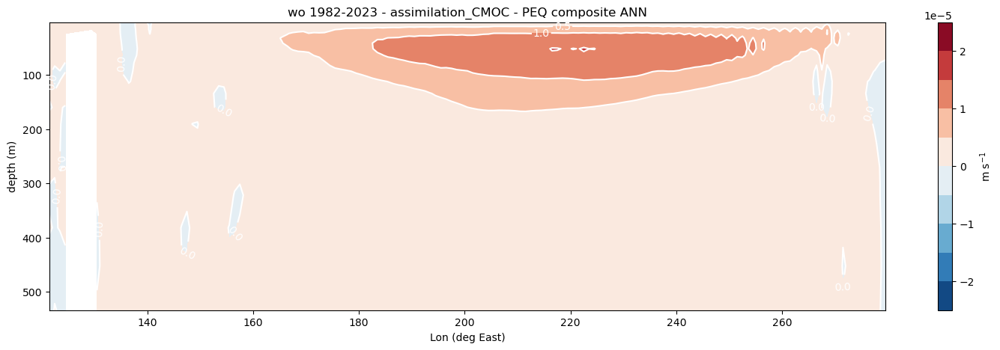

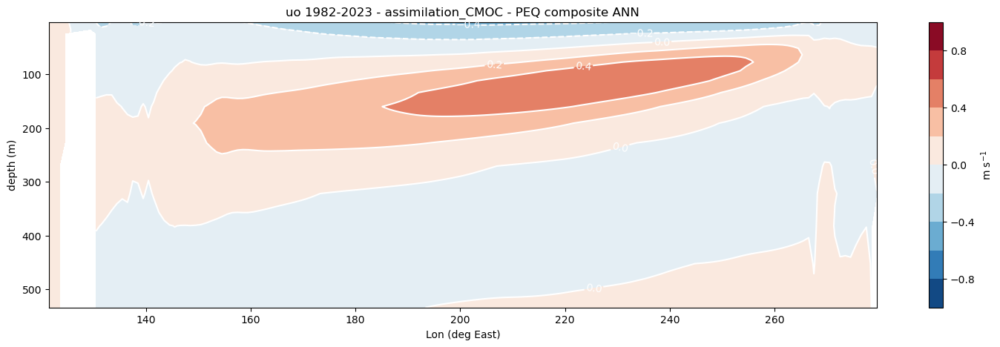

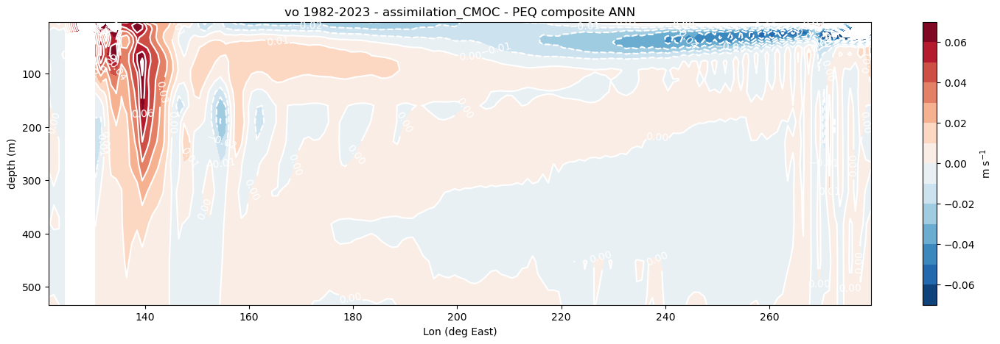

In [50]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}

plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4 )
plot_dict['uo'] = dict(dict = dict_profile_EQ['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-10,12,2) * 1e-1)
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3 )

for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None


    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


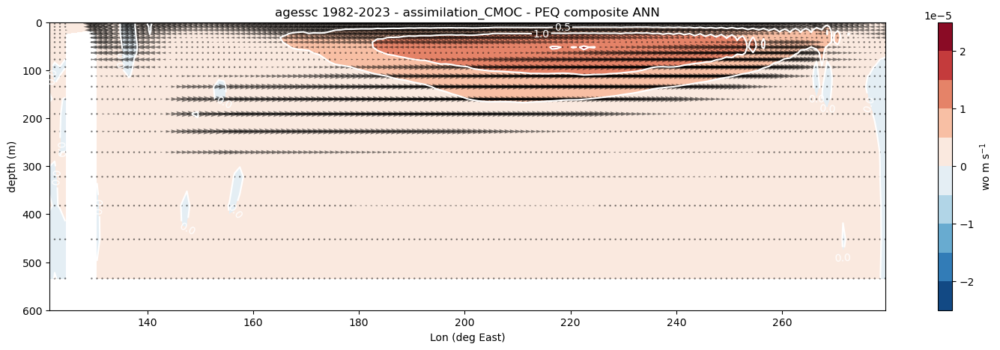

In [80]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}

plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4 )
plot_dict['uo'] = dict(dict = dict_profile_EQ['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-10,12,2) * 1e-1)
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3 )


title = f'{var} 1982-2023'

ds_dicts_x = plot_dict['uo']['dict']
ds_dicts_y = plot_dict['wo']['dict']

ds_dicts = plot_dict['wo']['dict']
contour_levels = plot_dict['wo']['contour_levels']
units = 'wo ' + plot_dict['wo']['unit']

for lev_range in [600 , [300,600]]:
    snapshot_depth_vs_lon_quiver(ds_list,
                                ds_dicts_x,
                                ds_dicts_y,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_dict=ds_dicts,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


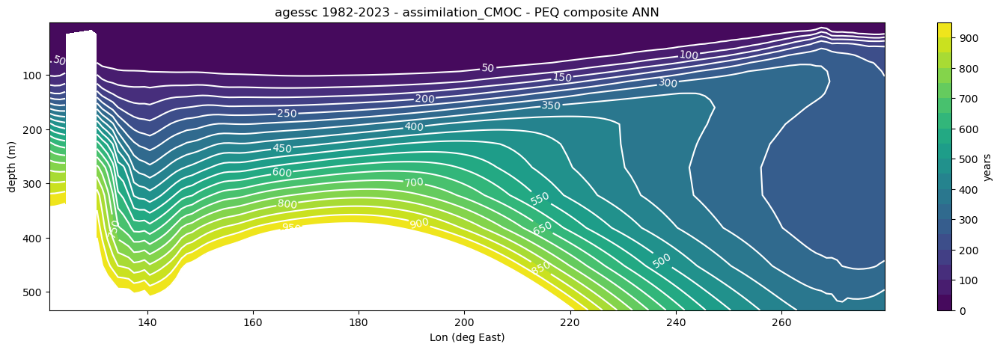

In [48]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}

plot_dict['agessc'] = dict(dict = dict_profile_EQ['agessc'], unit =  units_dics['agessc'], contour_levels = np.arange(0,1000,50) )


for var in ['agessc']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None


    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


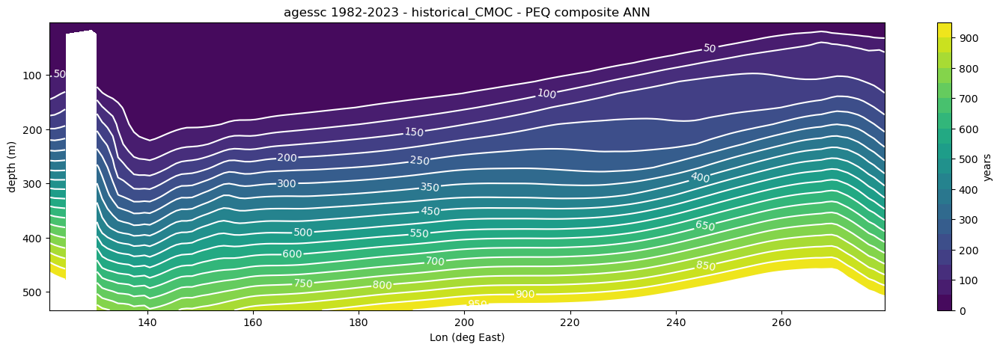

In [74]:

monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}

plot_dict['agessc'] = dict(dict = dict_profile_EQ['agessc'], unit =  units_dics['agessc'], contour_levels = np.arange(0,1000,50) )


for var in ['agessc']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None


    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


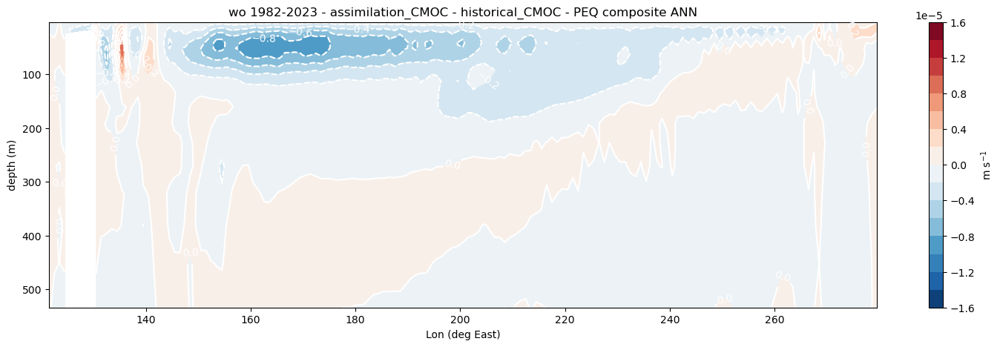

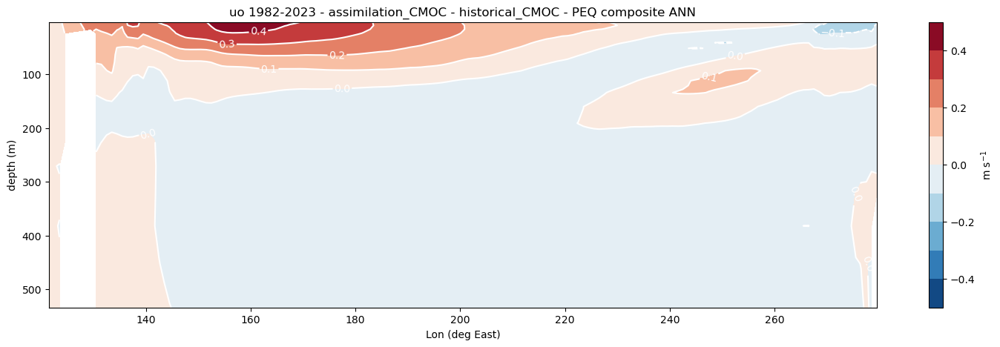

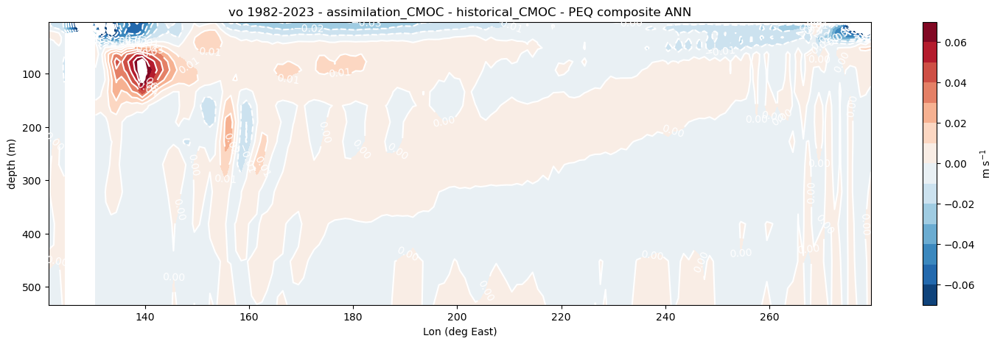

In [51]:

monthly_res = True
ds_list = ['assimilation_CMOC - historical_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}

plot_dict['wo'] = dict(dict = dict_profile_EQ_diff['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.16,0.18,0.02)* 1e-4  )
plot_dict['uo'] = dict(dict = dict_profile_EQ_diff['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-5,6,1) * 1e-1)
plot_dict['vo'] = dict(dict = dict_profile_EQ_diff['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3  )

for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None


    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


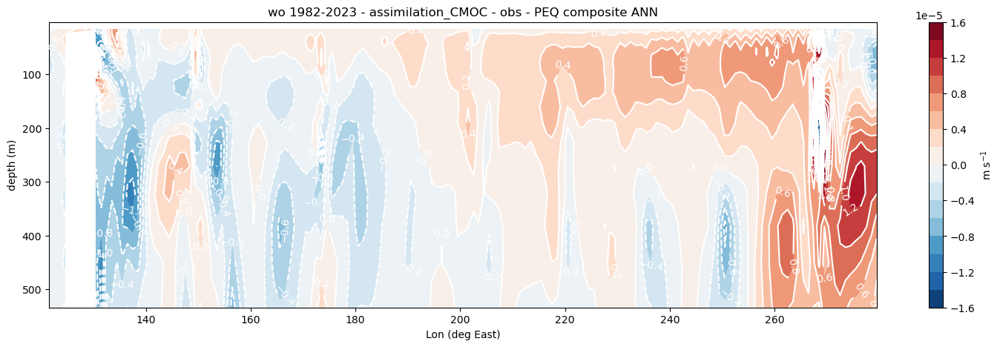

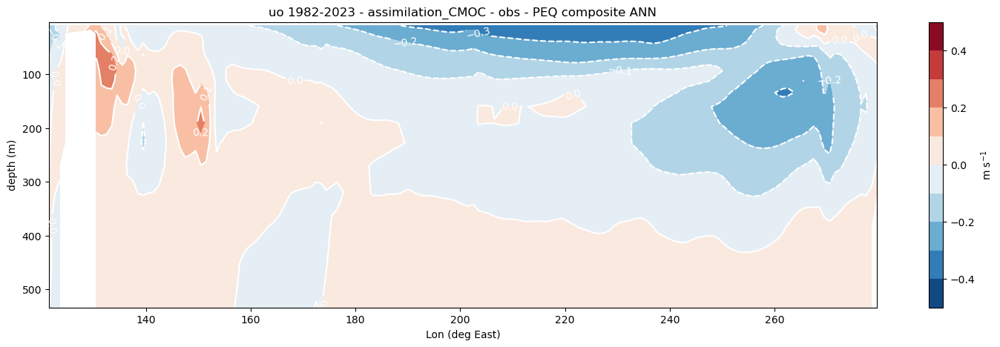

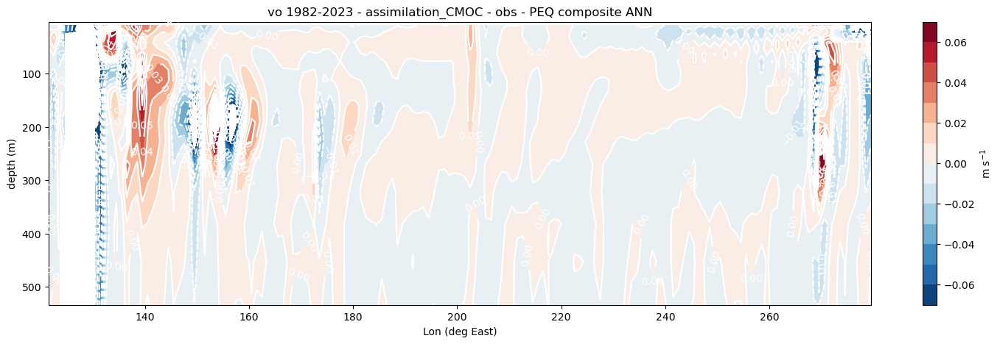

In [52]:

monthly_res = True
ds_list = ['assimilation_CMOC - obs']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}

plot_dict['wo'] = dict(dict = dict_profile_EQ_diff['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.16,0.18,0.02)* 1e-4  )
plot_dict['uo'] = dict(dict = dict_profile_EQ_diff['uo'], unit =  units_dics['uo'], contour_levels = np.arange(-5,6,1) * 1e-1)
plot_dict['vo'] = dict(dict = dict_profile_EQ_diff['vo'], unit =  units_dics['vo'], contour_levels = np.arange(-70,80,10) * 1e-3  )

for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None


    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



In [53]:
# for region in ['PEQ', 'AEQ']:
#     for ds in ['obs','assimilation_CMOC', 'historical_CMOC']:

#         dict_profile_EQ_so[region][ds]['lon'] = np.mod(dict_profile_EQ_so[region][ds]['lon'] + 360,360)
#         dict_profile_EQ_so[region][ds] = dict_profile_EQ_so[region][ds].sortby('lon')

#         dict_profile_EQ_thetao[region][ds]['lon'] = np.mod(dict_profile_EQ_thetao[region][ds]['lon'] + 360,360)
#         dict_profile_EQ_thetao[region][ds] = dict_profile_EQ_thetao[region][ds].sortby('lon')

#         dict_profile_EQ_density[region][ds]['lon'] = np.mod(dict_profile_EQ_density[region][ds]['lon'] + 360,360)
#         dict_profile_EQ_density[region][ds] = dict_profile_EQ_density[region][ds].sortby('lon')


# dict_profile_EQ_thetao_diff = {}
# dict_profile_EQ_so_diff = {}
# dict_profile_EQ_density_diff = {}
# for region in ['PEQ', 'AEQ']:
#     dict_profile_EQ_thetao_diff[region] = {}
#     dict_profile_EQ_so_diff[region] = {}
#     dict_profile_EQ_density_diff[region]  = {}

#     dict_profile_EQ_thetao_diff[region]['assimilation_CMOC - historical_CMOC'] = dict_profile_EQ_thetao[region]['assimilation_CMOC'] - dict_profile_EQ_thetao[region]['historical_CMOC']
#     dict_profile_EQ_so_diff[region]['assimilation_CMOC - historical_CMOC'] = dict_profile_EQ_so[region]['assimilation_CMOC'] - dict_profile_EQ_so[region]['historical_CMOC']
#     dict_profile_EQ_density_diff[region]['assimilation_CMOC - historical_CMOC'] = dict_profile_EQ_density[region]['assimilation_CMOC'] - dict_profile_EQ_density[region]['historical_CMOC']

#     dict_profile_EQ_thetao_diff[region]['assimilation_CMOC - obs'] = dict_profile_EQ_thetao[region]['assimilation_CMOC'] - dict_profile_EQ_thetao[region]['obs']
#     dict_profile_EQ_so_diff[region]['assimilation_CMOC - obs'] = dict_profile_EQ_so[region]['assimilation_CMOC'] - dict_profile_EQ_so[region]['obs']
#     dict_profile_EQ_density_diff[region]['assimilation_CMOC - obs'] = dict_profile_EQ_density[region]['assimilation_CMOC'] - dict_profile_EQ_density[region]['obs']

#     dict_profile_EQ_thetao_diff[region]['historical_CMOC - obs'] = dict_profile_EQ_thetao[region]['historical_CMOC'] - dict_profile_EQ_thetao[region]['obs']
#     dict_profile_EQ_so_diff[region]['historical_CMOC - obs'] = dict_profile_EQ_so[region]['historical_CMOC'] - dict_profile_EQ_so[region]['obs']
#     dict_profile_EQ_density_diff[region]['historical_CMOC - obs'] = dict_profile_EQ_density[region]['historical_CMOC'] - dict_profile_EQ_density[region]['obs']

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


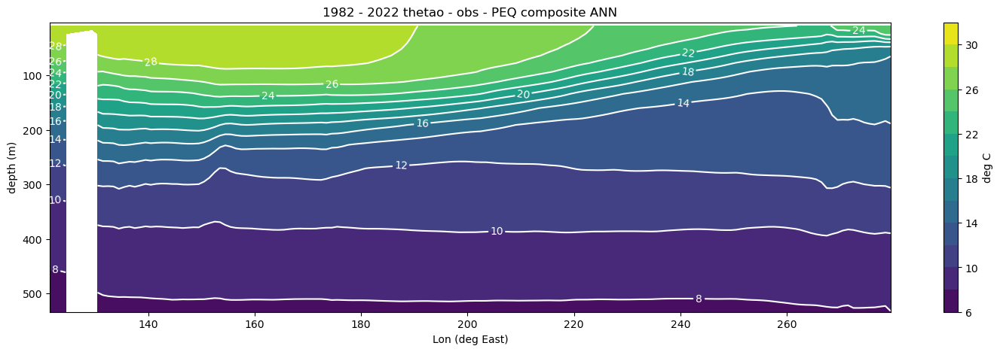

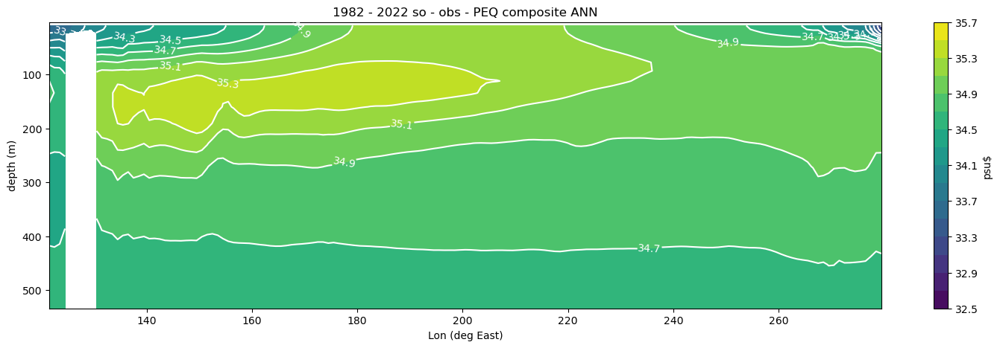

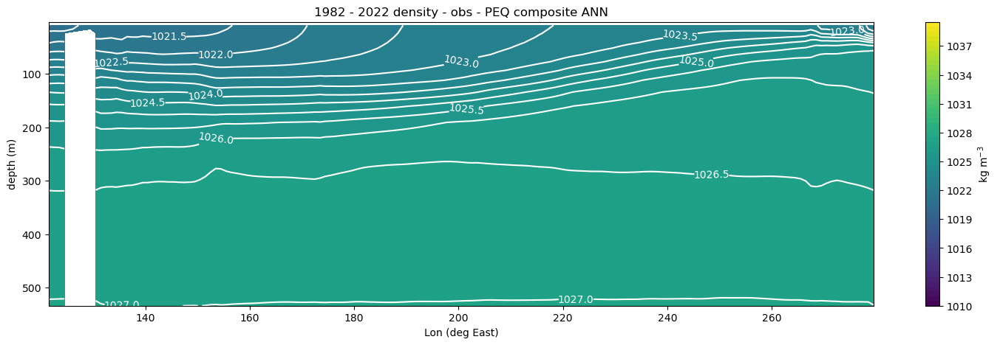

In [40]:

monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['so']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_profile_EQ['thetao'], unit =  units_dics['thetao'], contour_levels = [6,8,10,12,14,16,18,20,22,24,26,28,30,32] )                        
plot_dict['so'] = dict(dict = dict_profile_EQ['so'], unit =  units_dics['so'], contour_levels = 32.5 + np.arange(0,3.4,0.2) )
plot_dict['density'] = dict(dict = dict_profile_EQ['density'], unit =  units_dics['density'], contour_levels = np.arange(0,30,0.5)+ 1010 )

for var in ['thetao', 'so','density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} {var}'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


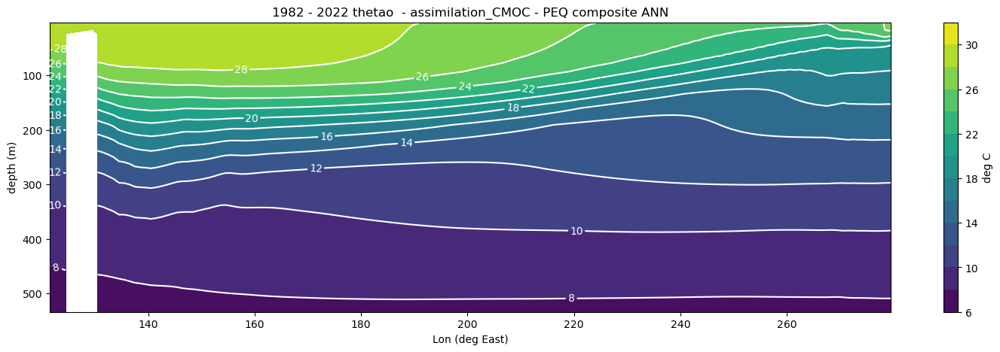

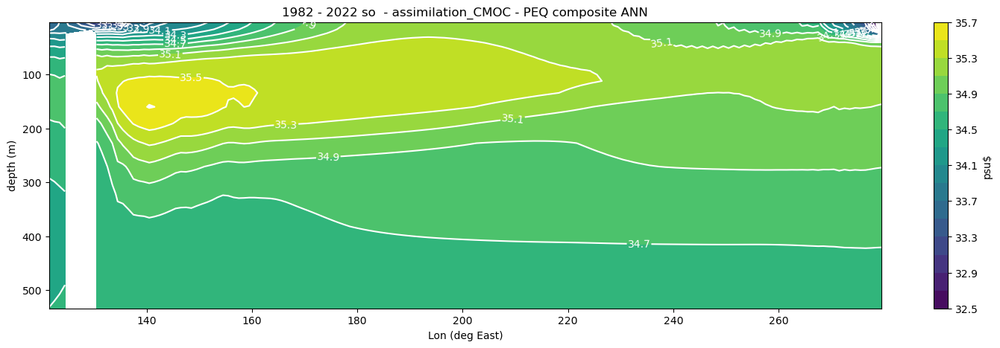

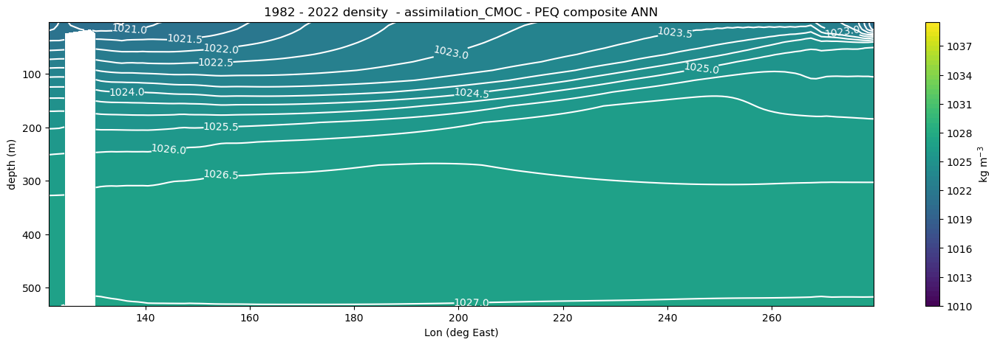

In [55]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['so']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_profile_EQ['thetao'], unit =  units_dics['thetao'], contour_levels = [6,8,10,12,14,16,18,20,22,24,26,28,30,32] )                        
plot_dict['so'] = dict(dict = dict_profile_EQ['so'], unit =  units_dics['so'], contour_levels = 32.5 + np.arange(0,3.4,0.2) )
plot_dict['density'] = dict(dict = dict_profile_EQ['density'], unit =  units_dics['density'], contour_levels = np.arange(0,30,0.5)+ 1010 )

for var in ['thetao', 'so','density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} {var} '
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


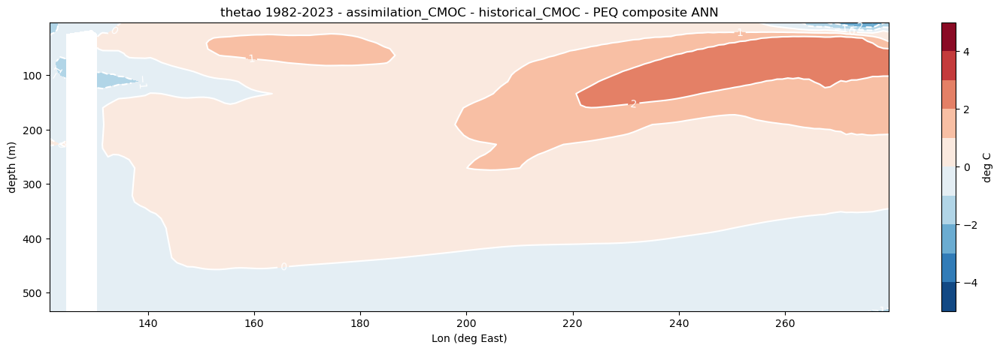

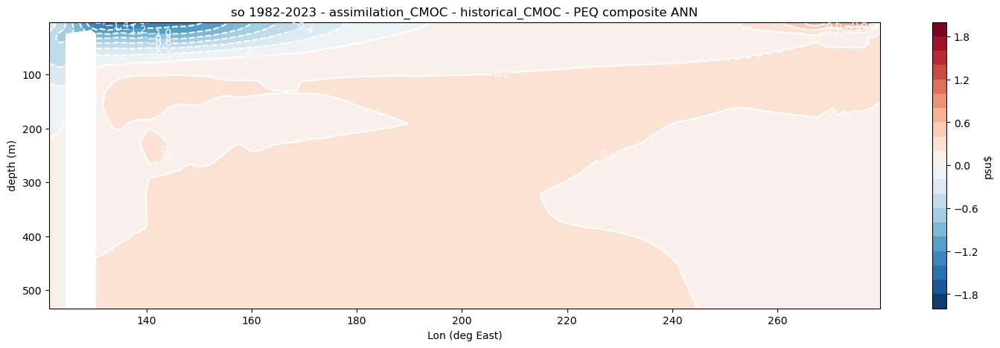

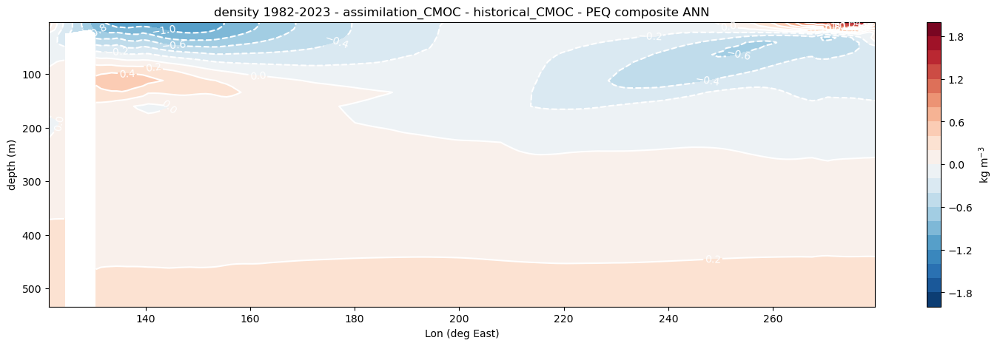

In [56]:

monthly_res = True
ds_list = ['assimilation_CMOC - historical_CMOC']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['thetao']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_profile_EQ_diff['thetao'], unit =  units_dics['thetao'], contour_levels = np.arange(-5,6) )
plot_dict['so'] = dict(dict = dict_profile_EQ_diff['so'], unit =  units_dics['so'], contour_levels = np.arange(-2,2.2,0.2) )
plot_dict['density'] = dict(dict = dict_profile_EQ_diff['density'], unit =  units_dics['density'], contour_levels = np.arange(-2,2.2,0.2) )


for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


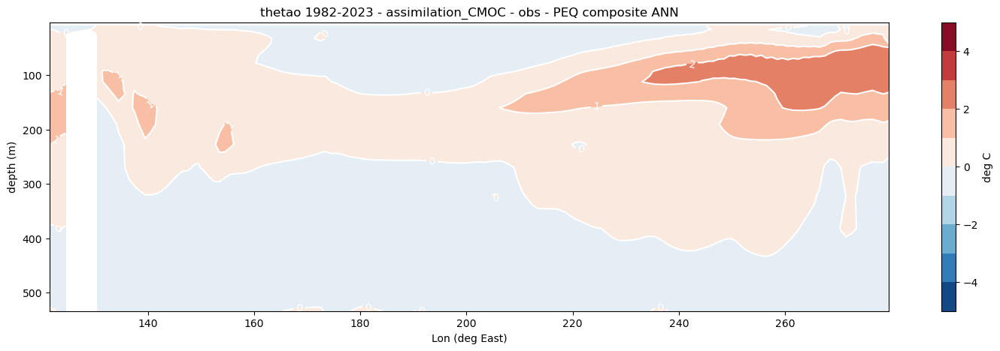

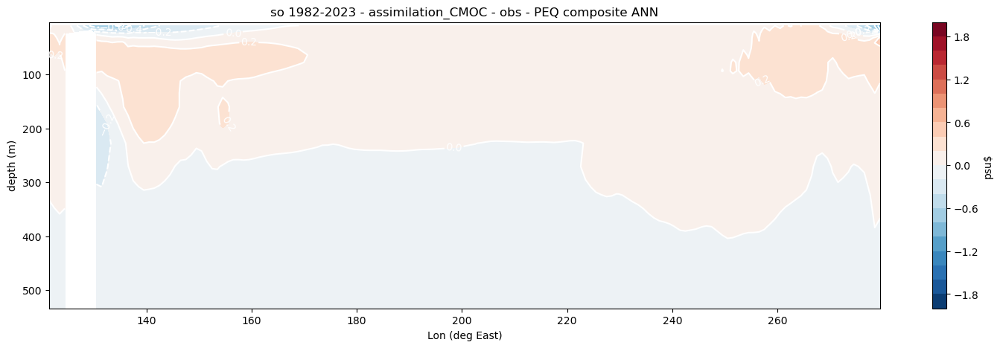

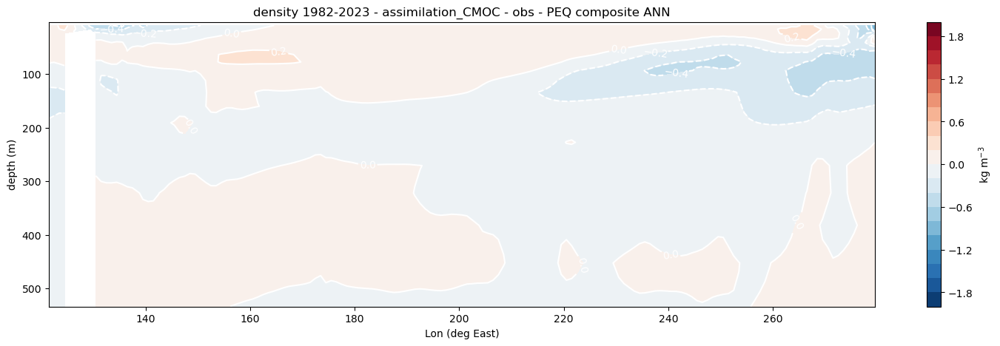

In [57]:

monthly_res = True
ds_list = ['assimilation_CMOC - obs']
figsize = (18,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['thetao']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_profile_EQ_diff['thetao'], unit =  units_dics['thetao'], contour_levels = np.arange(-5,6) )
plot_dict['so'] = dict(dict = dict_profile_EQ_diff['so'], unit =  units_dics['so'], contour_levels = np.arange(-2,2.2,0.2) )
plot_dict['density'] = dict(dict = dict_profile_EQ_diff['density'], unit =  units_dics['density'], contour_levels = np.arange(-2,2.2,0.2) )


for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    contour_levels = plot_dict[var]['contour_levels']

    snapshot_depth_vs_lon(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                contour_levels = contour_levels,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



## Arial view

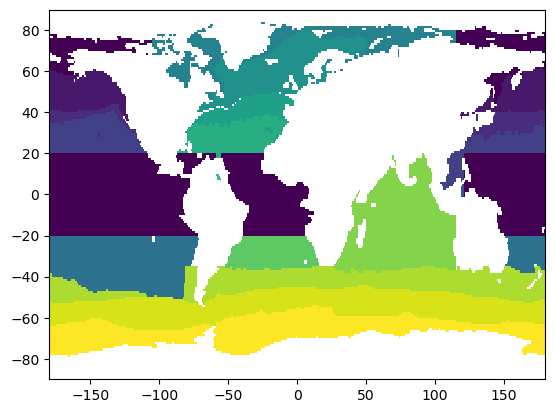

In [36]:

plt.pcolormesh(biomes.MeanBiomes.lon, biomes.MeanBiomes.lat, biomes.MeanBiomes.values)

PEQ = biomes.MeanBiomes.where((biomes.MeanBiomes.lat>= -20) & (biomes.MeanBiomes.lat <= 20))
PEQ = PEQ.where( (PEQ.lon <= -59) | (PEQ.lon >= 121))
PEQ = PEQ.where(np.isnan(PEQ), 1)

PEQ_E = PEQ.where(PEQ.lon<0)
PEQ_W = PEQ.where(PEQ.lon>0)

AEQ = biomes.MeanBiomes.where((biomes.MeanBiomes.lat>= -20) & (biomes.MeanBiomes.lat <= 20))
AEQ = AEQ.where( (AEQ.lon >= -55) & (AEQ.lon <= 20))
AEQ = AEQ.where(np.isnan(AEQ), 1)

plt.pcolormesh(PEQ.lon, PEQ.lat, PEQ.values)
plt.pcolormesh(AEQ.lon, AEQ.lat, AEQ.values)

mask_EQ = { 'PEQ' : PEQ.where(~np.isnan(PEQ),0), 'AEQ' : AEQ.where(~np.isnan(AEQ),0), 'PEQ_E' : PEQ_E.where(~np.isnan(PEQ_E),0), 'PEQ_W' : PEQ_W.where(~np.isnan(PEQ_W),0)}

In [37]:

dict_profile_EQ = {}
dict_clim_mean_removed = {}
dict_anom_snaps_clim_removed = {}

for var in var_list:
    dict_profile_EQ[var] = {}
    dict_clim_mean_removed[var] = {}
    dict_anom_snaps_clim_removed[var] = {}

    for region in ['PEQ','AEQ']:
        dict_profile_EQ[var][region] = {}
        dict_clim_mean_removed[var][region] = {}
        dict_anom_snaps_clim_removed[var][region] = {}


        for ds in ['obs','historical_CMOC', 'assimilation_CMOC']:
            try:
                dict_profile_EQ[var][region][ds] = dict_profile_EQ_REF[var][region][ds].where(mask_EQ[region] == 1, drop = True)                  
                dict_clim_mean_removed[var][region][ds] = dict_clim_mean_removed_REF[var][region][ds].where(mask_EQ[region] == 1, drop = True)
                dict_anom_snaps_clim_removed[var][region][ds] = dict_anom_snaps_clim_removed_REF[var][region][ds].where(mask_EQ[region] == 1, drop = True)


                if region == 'PEQ':

                    dict_anom_snaps_clim_removed[var][region][ds]['lon'] = np.mod(dict_anom_snaps_clim_removed[var][region][ds]['lon'] + 360,360)
                    dict_anom_snaps_clim_removed[var][region][ds] = dict_anom_snaps_clim_removed[var][region][ds].sortby('lon')
            except:
                print(f'{ds} for {var} non-existent!')








obs for agessc non-existent!
obs for agessc non-existent!
obs for uas non-existent!
obs for uas non-existent!
obs for vas non-existent!
obs for vas non-existent!


In [38]:
data_dicts_LANI = {}
data_dicts_ELNI = {}

for var in var_list:

    data_dicts_LANI[var] = {}
    data_dicts_ELNI[var] = {}

    for bm in dict_anom_snaps_clim_removed[var].keys():
        data_dicts_LANI[var][bm] = {}
        data_dicts_ELNI[var][bm] = {}


        for ds in dict_anom_snaps_clim_removed[var][bm].keys():
            if 'historical' in ds:
                data_dicts_LANI[var][bm][ds] = dict_anom_snaps_clim_removed[var][bm][ds].where(ONI_sim<=np.quantile(ONI_sim,0.25))
                data_dicts_ELNI[var][bm][ds] = dict_anom_snaps_clim_removed[var][bm][ds].where(ONI_sim>=np.quantile(ONI_sim,0.75))
            
            else:
                data_dicts_LANI[var][bm][ds] = dict_anom_snaps_clim_removed[var][bm][ds].where(ONI_assim<=np.quantile(ONI_assim,0.25))
                data_dicts_ELNI[var][bm][ds] = dict_anom_snaps_clim_removed[var][bm][ds].where(ONI_assim>=np.quantile(ONI_assim,0.75))

data_dicts_diff = {}

for var in var_list:
    data_dicts_diff[var] = {}

    for bm in dict_anom_snaps_clim_removed[var].keys():
        data_dicts_diff[var][bm] = {}
        for ds in dict_anom_snaps_clim_removed[var][bm].keys():
                data_dicts_diff[var][bm][ds] = (data_dicts_LANI[var][bm][ds].mean('year') - data_dicts_ELNI[var][bm][ds].mean('year')).expand_dims('year', axis = 0).assign_coords(year = ['diff'])
 

In [39]:
for var in var_list:
    for region in ['PEQ', 'AEQ']:
        for ds in ['obs','assimilation_CMOC', 'historical_CMOC']:
            try:
                dict_profile_EQ[var][region][ds]['lon'] = np.mod(dict_profile_EQ[var][region][ds]['lon'] + 360,360)
                dict_profile_EQ[var][region][ds] = dict_profile_EQ[var][region][ds].sortby('lon')
            except:
                print(f'{ds} for {var} non-existent!')

obs for agessc non-existent!
obs for agessc non-existent!
obs for uas non-existent!
obs for uas non-existent!
obs for vas non-existent!
obs for vas non-existent!


In [40]:
ranges_dicts_ENSO  = {
'wo' : {'surface' : {'vmin': -0.25 * 1e-4, 'vmax' :  0.23 * 1e-4}, 'depth' : {'vmin': -0.25 * 1e-5, 'vmax' : 0.25 * 1e-5}},
'uo' : {'surface' : {'vmin': -10 * 1e-1, 'vmax' :  10 * 1e-1}, 'depth' : {'vmin': -10 * 1e-2, 'vmax' : 10 * 1e-2}},
'vo' : {'surface' : {'vmin': -70 * 1e-3, 'vmax' :  70 * 1e-3}, 'depth' : {'vmin': -40 * 1e-3, 'vmax' : 40 * 1e-3}},
'thetao' : {'surface' : {'vmin': 15, 'vmax' :  35}, 'depth' : {'vmin': 6, 'vmax' : 12}},
'so' : {'surface' : {'vmin': 32.5, 'vmax' :  35.7}, 'depth' : {'vmin': 34.2, 'vmax' : 35}},
'density' : {'surface' : {'vmin': 1023, 'vmax' :  1028}, 'depth' : {'vmin': 1027, 'vmax' : 1028}}}


ranges_dicts_diff = {
'wo' : {'surface' : {'vmin': -1 * 1e-5, 'vmax' :  1 * 1e-5}, 'depth' : {'vmin': -0.2 * 1e-5, 'vmax' : 0.2 * 1e-5}},
'uo' : {'surface' : {'vmin': -70 * 1e-2, 'vmax' :  70 * 1e-2}, 'depth' : {'vmin': -10 * 1e-2, 'vmax' : 10 * 1e-2}},
'vo' : {'surface' : {'vmin': -70 * 1e-3, 'vmax' :  70 * 1e-3}, 'depth' : {'vmin': -10 * 1e-3, 'vmax' : 10 * 1e-3}},
'thetao' : {'surface' : {'vmin': -2, 'vmax' :  2}, 'depth' : {'vmin': -1, 'vmax' : 1}},
'so' : {'surface' : {'vmin': -0.2, 'vmax' :  0.2}, 'depth' : {'vmin': -0.1 , 'vmax' : 0.1}},
'density' : {'surface' : {'vmin': -0.7, 'vmax' :  0.7}, 'depth' : {'vmin': -0.3, 'vmax' : 0.3}}}

##### !!!!!!!!!!!!! ALL CALLS TO PLOTS BELOW SHOULD BE EDITED TO NEW DICTIONARY FORMAT !!!!!!!!!!!!!!!!!!!!!

#### historical

#### La Nina

##### surface

In [ ]:

monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_LANI['wo'], unit =  units_dics['wo'],  vmin = ranges_dicts_ENSO['wo']['surface']['vmin'], vmax = ranges_dicts_ENSO['wo']['surface']['vmax'])
plot_dict['uo'] = dict(dict = data_dicts_LANI['uo'], unit =  units_dics['uo'],    vmin = ranges_dicts_ENSO['uo']['surface']['vmin'], vmax = ranges_dicts_ENSO['uo']['surface']['vmax'] )
plot_dict['vo'] = dict(dict = data_dicts_LANI['vo'], unit =  units_dics['vo'],   vmin = ranges_dicts_ENSO['vo']['surface']['vmin'], vmax = ranges_dicts_ENSO['vo']['surface']['vmax'] )


for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO negative'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after['uo']['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



In [ ]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_LANI_thetao, unit =  units_thetao,  vmin = ranges_dicts_thetao_ENSO['surface']['vmin'], vmax = ranges_dicts_thetao_ENSO['surface']['vmax'] )
plot_dict['so'] = dict(dict = data_dicts_LANI_so, unit =  units_so, vmin = ranges_dicts_so_ENSO['surface']['vmin'], vmax = ranges_dicts_so_ENSO['surface']['vmax'] )
plot_dict['density'] = dict(dict = data_dicts_LANI_density, unit =  units_density,  vmin = ranges_dicts_density_ENSO['surface']['vmin'], vmax = ranges_dicts_density_ENSO['surface']['vmax'] )

for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO negative'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)


##### depth

In [ ]:

monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_uo['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_LANI_wo, unit =  units_wo,  vmin = ranges_dicts_wo_ENSO['depth']['vmin'], vmax = ranges_dicts_wo_ENSO['depth']['vmax'])
plot_dict['uo'] = dict(dict = data_dicts_LANI_uo, unit =  units_uo,    vmin = ranges_dicts_uo_ENSO['depth']['vmin'], vmax = ranges_dicts_uo_ENSO['depth']['vmax'] )
plot_dict['vo'] = dict(dict = data_dicts_LANI_vo, unit =  units_vo,   vmin = ranges_dicts_vo_ENSO['depth']['vmin'], vmax = ranges_dicts_vo_ENSO['depth']['vmax'] )


for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO negative'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



In [ ]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_LANI_thetao, unit =  units_thetao,  vmin = ranges_dicts_thetao_ENSO['depth']['vmin'], vmax = ranges_dicts_thetao_ENSO['depth']['vmax'] )
plot_dict['so'] = dict(dict = data_dicts_LANI_so, unit =  units_so, vmin = ranges_dicts_so_ENSO['depth']['vmin'], vmax = ranges_dicts_so_ENSO['depth']['vmax'] )
plot_dict['density'] = dict(dict = data_dicts_LANI_density, unit =  units_density,  vmin = ranges_dicts_density_ENSO['depth']['vmin'], vmax = ranges_dicts_density_ENSO['depth']['vmax'] )

for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO negative'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)

#### El Nino

##### surface

In [ ]:

monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_uo['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_ELNI_wo, unit =  units_wo,  vmin = ranges_dicts_wo_ENSO['surface']['vmin'], vmax = ranges_dicts_wo_ENSO['surface']['vmax'])
plot_dict['uo'] = dict(dict = data_dicts_ELNI_uo, unit =  units_uo,    vmin = ranges_dicts_uo_ENSO['surface']['vmin'], vmax = ranges_dicts_uo_ENSO['surface']['vmax'] )
plot_dict['vo'] = dict(dict = data_dicts_ELNI_vo, unit =  units_vo,   vmin = ranges_dicts_vo_ENSO['surface']['vmin'], vmax = ranges_dicts_vo_ENSO['surface']['vmax'] )


for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO positive'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



In [ ]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_ELNI_thetao, unit =  units_thetao,  vmin = ranges_dicts_thetao_ENSO['surface']['vmin'], vmax = ranges_dicts_thetao_ENSO['surface']['vmax'] )
plot_dict['so'] = dict(dict = data_dicts_ELNI_so, unit =  units_so, vmin = ranges_dicts_so_ENSO['surface']['vmin'], vmax = ranges_dicts_so_ENSO['surface']['vmax'] )
plot_dict['density'] = dict(dict = data_dicts_ELNI_density, unit =  units_density,  vmin = ranges_dicts_density_ENSO['surface']['vmin'], vmax = ranges_dicts_density_ENSO['surface']['vmax'] )

for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO positive'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)


##### depth

In [ ]:

monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_uo['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_ELNI_wo, unit =  units_wo,vmin = ranges_dicts_wo_ENSO['depth']['vmin'], vmax = ranges_dicts_wo_ENSO['depth']['vmax']   )
plot_dict['uo'] = dict(dict = data_dicts_ELNI_uo, unit =  units_uo,  vmin = ranges_dicts_uo_ENSO['depth']['vmin'], vmax = ranges_dicts_uo_ENSO['depth']['vmax']  )
plot_dict['vo'] = dict(dict = data_dicts_ELNI_vo, unit =  units_vo, vmin = ranges_dicts_vo_ENSO['depth']['vmin'], vmax = ranges_dicts_vo_ENSO['depth']['vmax']  )


for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO positive'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



In [ ]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_ELNI_thetao, unit =  units_thetao,  vmin = ranges_dicts_thetao_ENSO['depth']['vmin'], vmax = ranges_dicts_thetao_ENSO['depth']['vmax'] )
plot_dict['so'] = dict(dict = data_dicts_ELNI_so, unit =  units_so, vmin = ranges_dicts_so_ENSO['depth']['vmin'], vmax = ranges_dicts_so_ENSO['depth']['vmax'] )
plot_dict['density'] = dict(dict = data_dicts_ELNI_density, unit =  units_density,  vmin = ranges_dicts_density_ENSO['depth']['vmin'], vmax = ranges_dicts_density_ENSO['depth']['vmax'] )

for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO positive'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)

#### Diff

##### surface

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


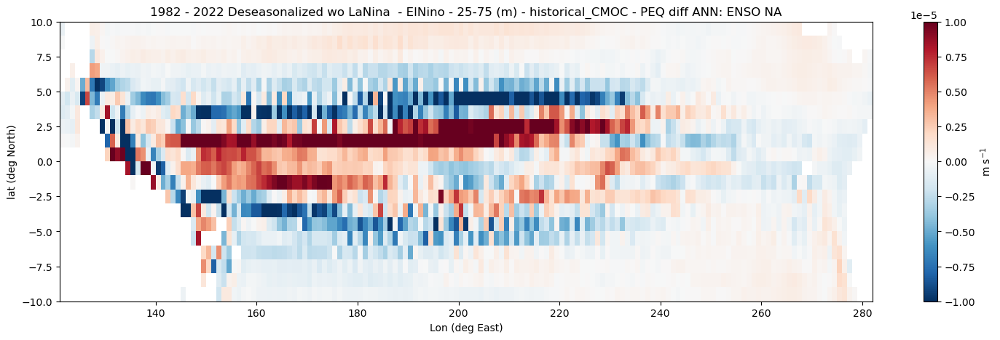

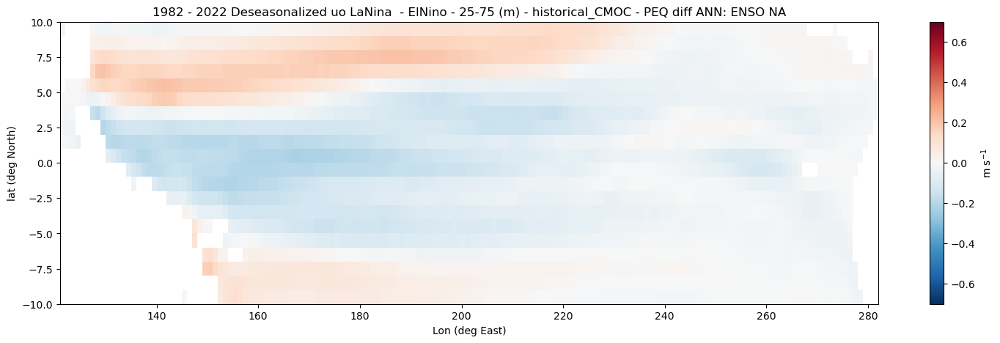

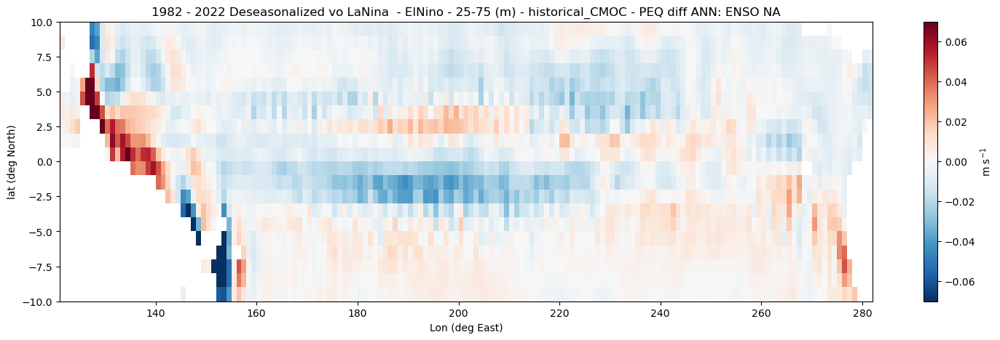

In [120]:

monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = ['diff']
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_diff_wo, unit =  units_wo, vmin = ranges_dicts_wo_diff['surface']['vmin'], vmax = ranges_dicts_wo_diff['surface']['vmax'] )
plot_dict['uo'] = dict(dict = data_dicts_diff_uo, unit =  units_uo,  vmin = ranges_dicts_uo_diff['surface']['vmin'], vmax = ranges_dicts_uo_diff['surface']['vmax']   )
plot_dict['vo'] = dict(dict = data_dicts_diff_vo, unit =  units_vo, vmin = ranges_dicts_vo_diff['surface']['vmin'], vmax = ranges_dicts_vo_diff['surface']['vmax']   )


for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} LaNina  - ElNino'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


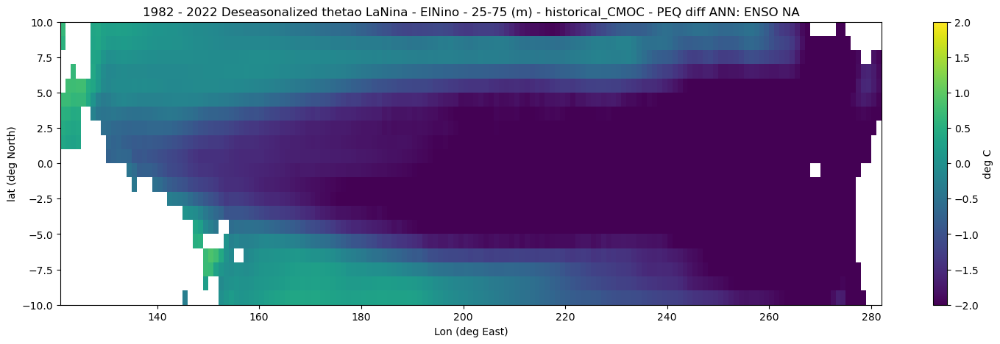

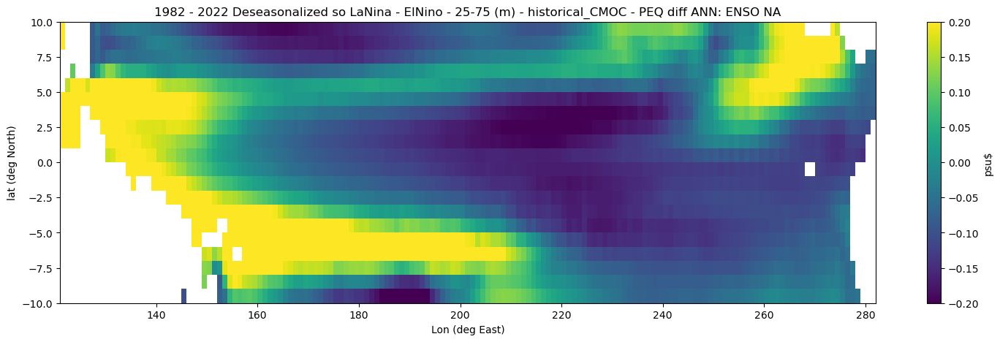

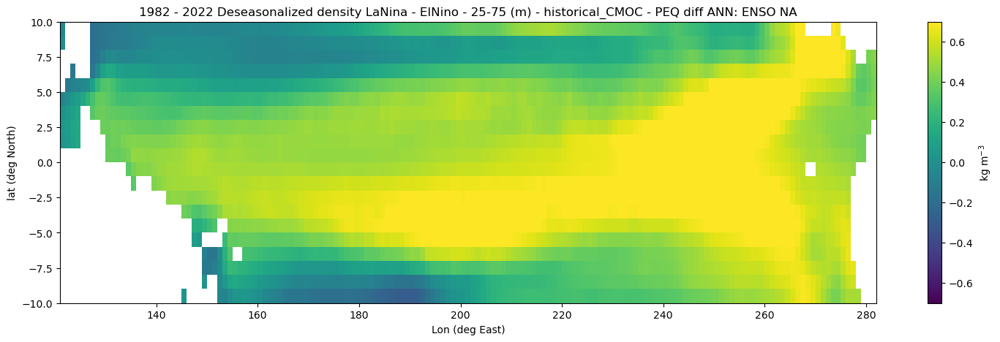

In [121]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = ['diff']
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_diff_thetao, unit =  units_thetao, vmin = ranges_dicts_thetao_diff['surface']['vmin'], vmax = ranges_dicts_thetao_diff['surface']['vmax'] )
plot_dict['so'] = dict(dict = data_dicts_diff_so, unit =  units_so, vmin = ranges_dicts_so_diff['surface']['vmin'], vmax = ranges_dicts_so_diff['surface']['vmax']  )
plot_dict['density'] = dict(dict = data_dicts_diff_density, unit =  units_density, vmin = ranges_dicts_density_diff['surface']['vmin'], vmax = ranges_dicts_density_diff['surface']['vmax']   )

for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} LaNina - ElNino'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)


##### depth

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


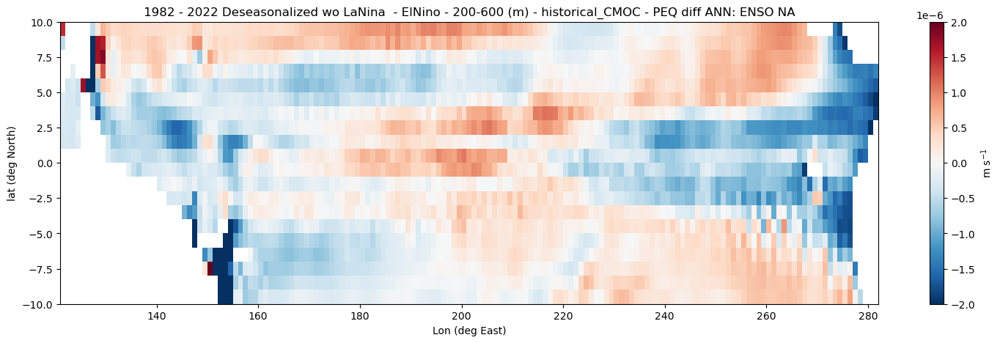

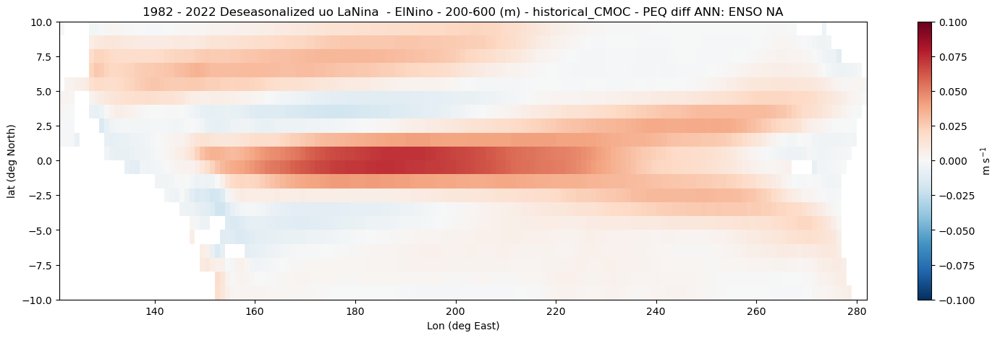

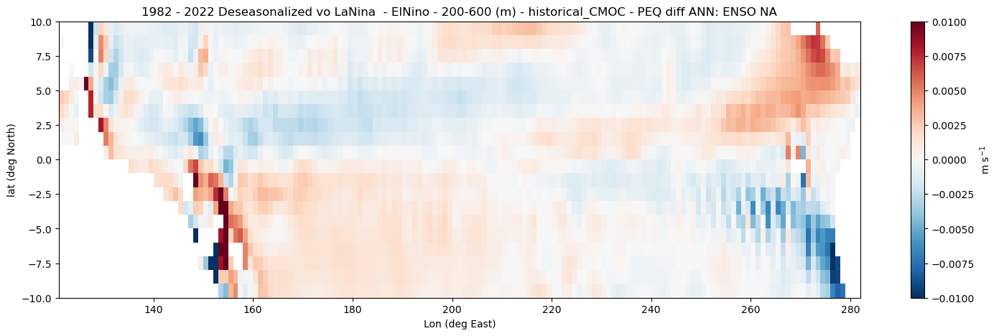

In [122]:

monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = ['diff']
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_diff_wo, unit =  units_wo, vmin = ranges_dicts_wo_diff['depth']['vmin'], vmax = ranges_dicts_wo_diff['depth']['vmax'] )
plot_dict['uo'] = dict(dict = data_dicts_diff_uo, unit =  units_uo,  vmin = ranges_dicts_uo_diff['depth']['vmin'], vmax = ranges_dicts_uo_diff['depth']['vmax']   )
plot_dict['vo'] = dict(dict = data_dicts_diff_vo, unit =  units_vo, vmin = ranges_dicts_vo_diff['depth']['vmin'], vmax = ranges_dicts_vo_diff['depth']['vmax']   )


for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} LaNina  - ElNino'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


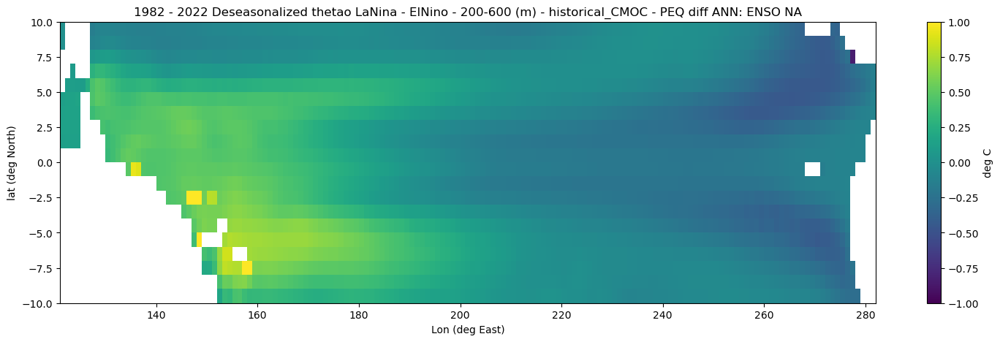

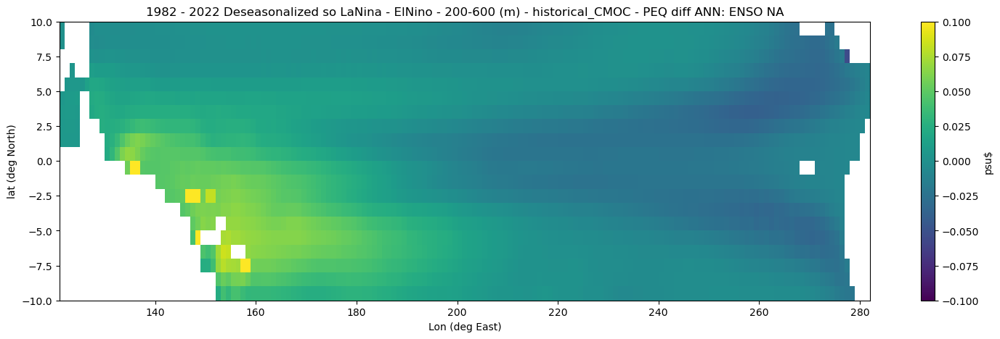

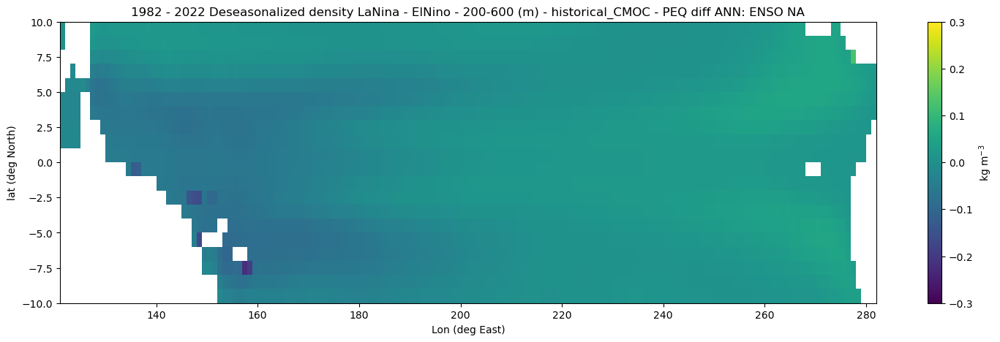

In [123]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = ['diff']
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_diff_thetao, unit =  units_thetao, vmin = ranges_dicts_thetao_diff['depth']['vmin'], vmax = ranges_dicts_thetao_diff['depth']['vmax'] )
plot_dict['so'] = dict(dict = data_dicts_diff_so, unit =  units_so, vmin = ranges_dicts_so_diff['depth']['vmin'], vmax = ranges_dicts_so_diff['depth']['vmax']  )
plot_dict['density'] = dict(dict = data_dicts_diff_density, unit =  units_density, vmin = ranges_dicts_density_diff['depth']['vmin'], vmax = ranges_dicts_density_diff['depth']['vmax']   )

for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} LaNina - ElNino'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)


#### Assimilation

#### La Nina

##### surface

In [ ]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_uo['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_LANI_wo, unit =  units_wo,  vmin = ranges_dicts_wo_ENSO['surface']['vmin'], vmax = ranges_dicts_wo_ENSO['surface']['vmax'])
plot_dict['uo'] = dict(dict = data_dicts_LANI_uo, unit =  units_uo,    vmin = ranges_dicts_uo_ENSO['surface']['vmin'], vmax = ranges_dicts_uo_ENSO['surface']['vmax'] )
plot_dict['vo'] = dict(dict = data_dicts_LANI_vo, unit =  units_vo,   vmin = ranges_dicts_vo_ENSO['surface']['vmin'], vmax = ranges_dicts_vo_ENSO['surface']['vmax'] )


for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO negative'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



In [ ]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_LANI_thetao, unit =  units_thetao,  vmin = ranges_dicts_thetao_ENSO['surface']['vmin'], vmax = ranges_dicts_thetao_ENSO['surface']['vmax'] )
plot_dict['so'] = dict(dict = data_dicts_LANI_so, unit =  units_so, vmin = ranges_dicts_so_ENSO['surface']['vmin'], vmax = ranges_dicts_so_ENSO['surface']['vmax'] )
plot_dict['density'] = dict(dict = data_dicts_LANI_density, unit =  units_density,  vmin = ranges_dicts_density_ENSO['surface']['vmin'], vmax = ranges_dicts_density_ENSO['surface']['vmax'] )

for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO negative'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)


##### depth

In [ ]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_uo['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_LANI_wo, unit =  units_wo,  vmin = ranges_dicts_wo_ENSO['depth']['vmin'], vmax = ranges_dicts_wo_ENSO['depth']['vmax'])
plot_dict['uo'] = dict(dict = data_dicts_LANI_uo, unit =  units_uo,    vmin = ranges_dicts_uo_ENSO['depth']['vmin'], vmax = ranges_dicts_uo_ENSO['depth']['vmax'] )
plot_dict['vo'] = dict(dict = data_dicts_LANI_vo, unit =  units_vo,   vmin = ranges_dicts_vo_ENSO['depth']['vmin'], vmax = ranges_dicts_vo_ENSO['depth']['vmax'] )


for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO negative'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)

   

In [ ]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_LANI_thetao, unit =  units_thetao,  vmin = ranges_dicts_thetao_ENSO['depth']['vmin'], vmax = ranges_dicts_thetao_ENSO['depth']['vmax'] )
plot_dict['so'] = dict(dict = data_dicts_LANI_so, unit =  units_so, vmin = ranges_dicts_so_ENSO['depth']['vmin'], vmax = ranges_dicts_so_ENSO['depth']['vmax'] )
plot_dict['density'] = dict(dict = data_dicts_LANI_density, unit =  units_density,  vmin = ranges_dicts_density_ENSO['depth']['vmin'], vmax = ranges_dicts_density_ENSO['depth']['vmax'] )

for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{min(yeartoplot)} - {max(yeartoplot)} Deseasonalized {var} ENSO negative'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)
    

 


#### El Nino

##### surface

In [ ]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_ELNI_wo, unit =  units_wo,  vmin = ranges_dicts_wo_ENSO['surface']['vmin'], vmax = ranges_dicts_wo_ENSO['surface']['vmax'])
plot_dict['uo'] = dict(dict = data_dicts_ELNI_uo, unit =  units_uo,    vmin = ranges_dicts_uo_ENSO['surface']['vmin'], vmax = ranges_dicts_uo_ENSO['surface']['vmax'] )
plot_dict['vo'] = dict(dict = data_dicts_ELNI_vo, unit =  units_vo,   vmin = ranges_dicts_vo_ENSO['surface']['vmin'], vmax = ranges_dicts_vo_ENSO['surface']['vmax'] )



for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'Deseasonalized {var} ENSO positive'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



In [ ]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_ELNI_thetao, unit =  units_thetao,  vmin = ranges_dicts_thetao_ENSO['surface']['vmin'], vmax = ranges_dicts_thetao_ENSO['surface']['vmax'] )
plot_dict['so'] = dict(dict = data_dicts_ELNI_so, unit =  units_so, vmin = ranges_dicts_so_ENSO['surface']['vmin'], vmax = ranges_dicts_so_ENSO['surface']['vmax'] )
plot_dict['density'] = dict(dict = data_dicts_ELNI_density, unit =  units_density,  vmin = ranges_dicts_density_ENSO['surface']['vmin'], vmax = ranges_dicts_density_ENSO['surface']['vmax'] )


for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'Deseasonalized {var} ENSO positive'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)


##### depth

In [ ]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_ELNI_wo, unit =  units_wo,  vmin = ranges_dicts_wo_ENSO['depth']['vmin'], vmax = ranges_dicts_wo_ENSO['depth']['vmax'] )
plot_dict['uo'] = dict(dict = data_dicts_ELNI_uo, unit =  units_uo, vmin = ranges_dicts_uo_ENSO['depth']['vmin'], vmax = ranges_dicts_uo_ENSO['depth']['vmax'] )
plot_dict['vo'] = dict(dict = data_dicts_ELNI_vo, unit =  units_vo,  vmin = ranges_dicts_vo_ENSO['depth']['vmin'], vmax = ranges_dicts_vo_ENSO['depth']['vmax'] )



for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'Deseasonalized {var} ENSO positive'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



In [ ]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = [1987]
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_ELNI_thetao, unit =  units_thetao,  vmin = ranges_dicts_thetao_ENSO['depth']['vmin'], vmax = ranges_dicts_thetao_ENSO['depth']['vmax'] )
plot_dict['so'] = dict(dict = data_dicts_ELNI_so, unit =  units_so, vmin = ranges_dicts_so_ENSO['depth']['vmin'], vmax = ranges_dicts_so_ENSO['depth']['vmax'] )
plot_dict['density'] = dict(dict = data_dicts_ELNI_density, unit =  units_density,  vmin = ranges_dicts_density_ENSO['depth']['vmin'], vmax = ranges_dicts_density_ENSO['depth']['vmax'] )


for var in ['thetao', 'so','density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'Deseasonalized {var} ENSO positive'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



#### Diff

##### surface

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


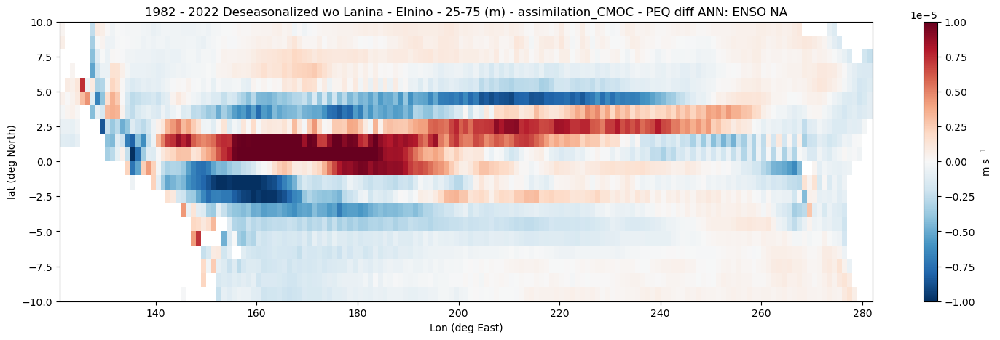

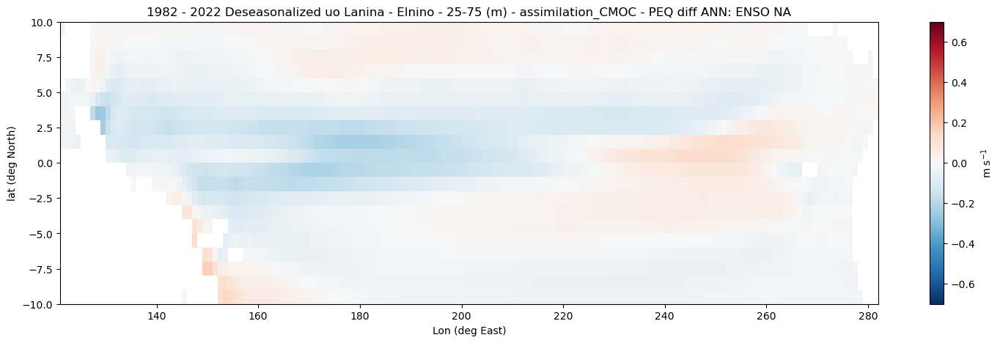

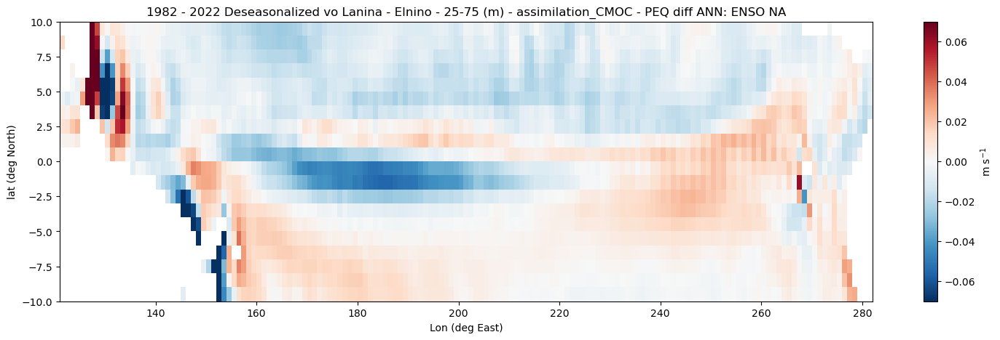

In [130]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = ['diff']
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_diff_wo, unit =  units_wo, vmin = ranges_dicts_wo_diff['surface']['vmin'], vmax = ranges_dicts_wo_diff['surface']['vmax'] )
plot_dict['uo'] = dict(dict = data_dicts_diff_uo, unit =  units_uo,  vmin = ranges_dicts_uo_diff['surface']['vmin'], vmax = ranges_dicts_uo_diff['surface']['vmax']   )
plot_dict['vo'] = dict(dict = data_dicts_diff_vo, unit =  units_vo, vmin = ranges_dicts_vo_diff['surface']['vmin'], vmax = ranges_dicts_vo_diff['surface']['vmax']   )




for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var} Lanina - Elnino'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


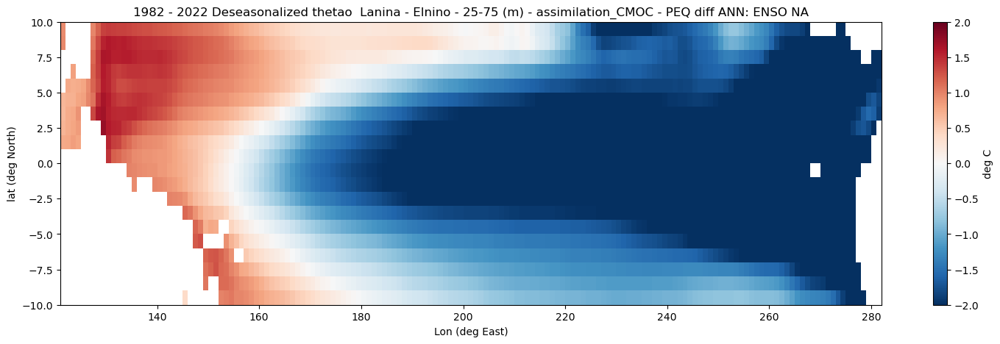

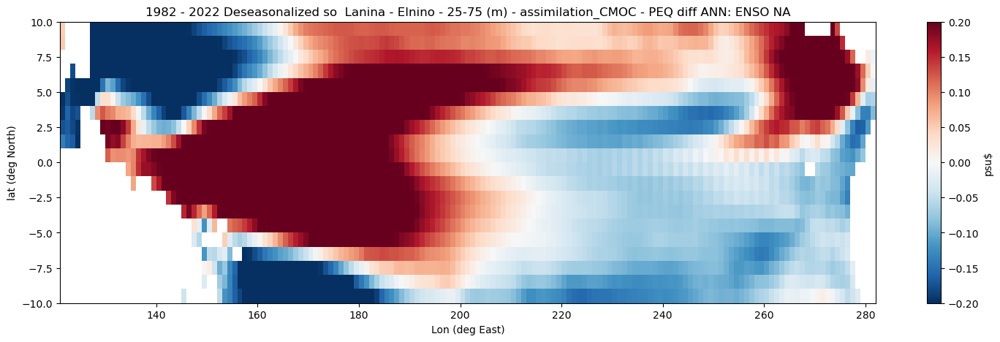

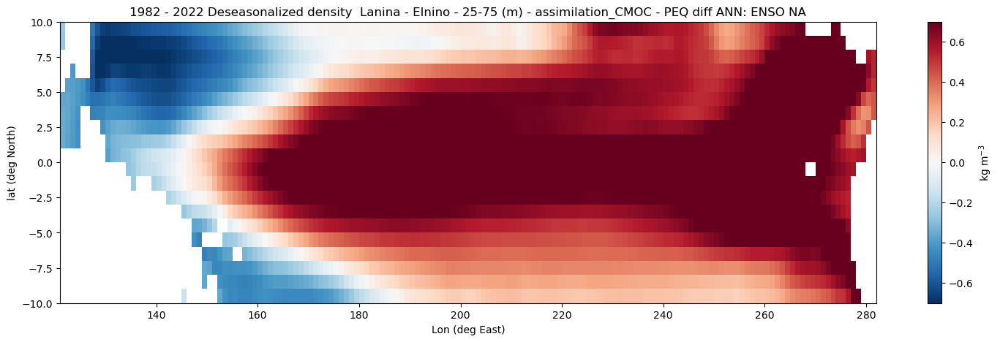

In [131]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = ['diff']
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_diff_thetao, unit =  units_thetao, vmin = ranges_dicts_thetao_diff['surface']['vmin'], vmax = ranges_dicts_thetao_diff['surface']['vmax'] )
plot_dict['so'] = dict(dict = data_dicts_diff_so, unit =  units_so, vmin = ranges_dicts_so_diff['surface']['vmin'], vmax = ranges_dicts_so_diff['surface']['vmax']  )
plot_dict['density'] = dict(dict = data_dicts_diff_density, unit =  units_density, vmin = ranges_dicts_density_diff['surface']['vmin'], vmax = ranges_dicts_density_diff['surface']['vmax']   )


for var in ['thetao', 'so','density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var}  Lanina - Elnino'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)


##### depth

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


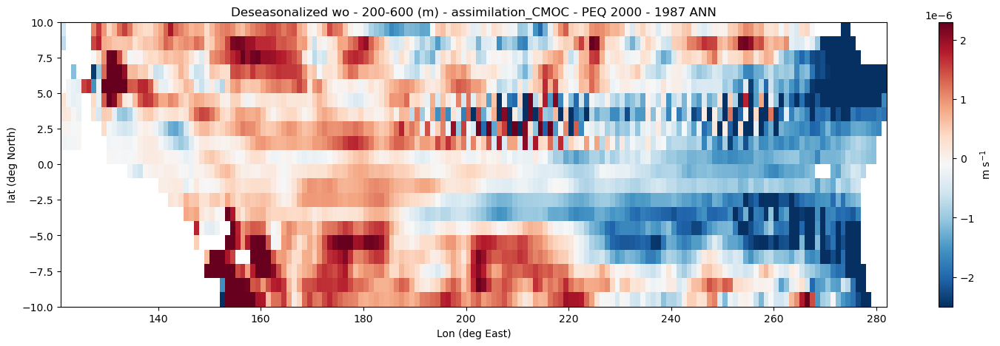

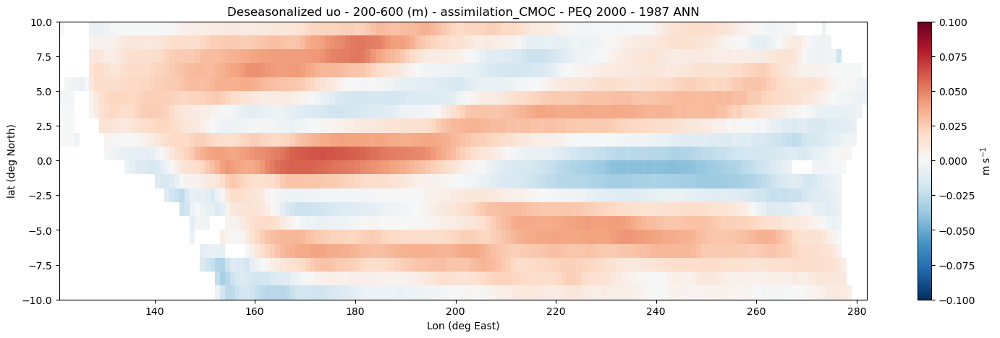

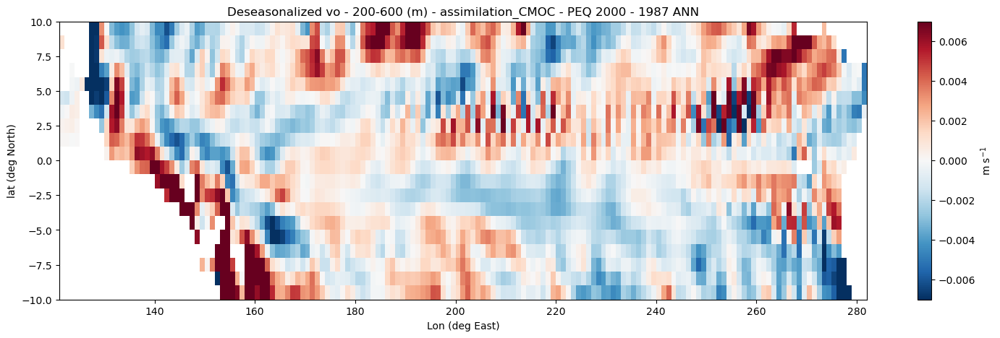

In [195]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = ['diff']
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_diff_wo, unit =  units_wo, vmin = ranges_dicts_wo_diff['depth']['vmin'], vmax = ranges_dicts_wo_diff['depth']['vmax'] )
plot_dict['uo'] = dict(dict = data_dicts_diff_uo, unit =  units_uo,  vmin = ranges_dicts_uo_diff['depth']['vmin'], vmax = ranges_dicts_uo_diff['depth']['vmax']   )
plot_dict['vo'] = dict(dict = data_dicts_diff_vo, unit =  units_vo, vmin = ranges_dicts_vo_diff['depth']['vmin'], vmax = ranges_dicts_vo_diff['depth']['vmax']   )



for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var}  Lanina - Elnino'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


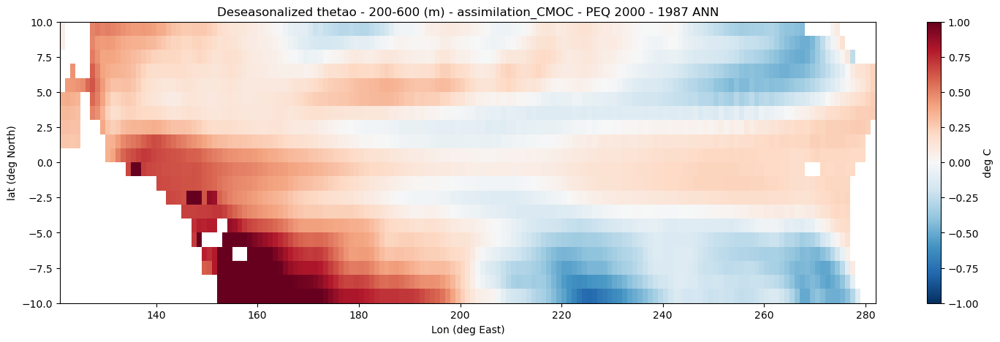

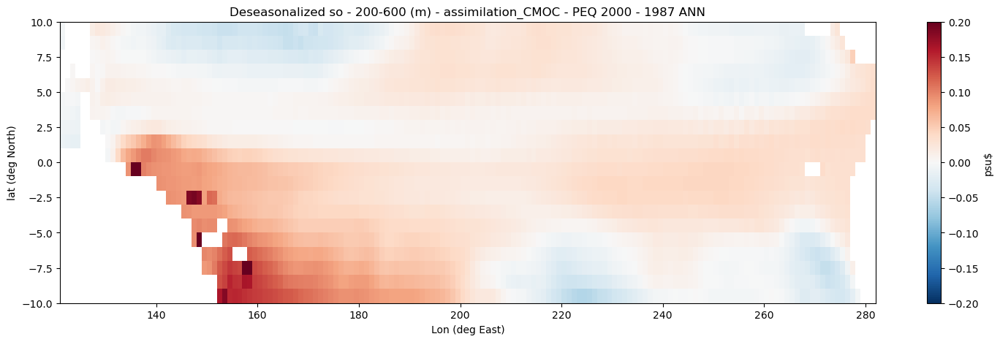

In [36]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = ['diff']
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = data_dicts_diff_thetao, unit =  units_thetao, vmin = ranges_dicts_thetao_diff['depth']['vmin'], vmax = ranges_dicts_thetao_diff['depth']['vmax'] )
plot_dict['so'] = dict(dict = data_dicts_diff_so, unit =  units_so, vmin = ranges_dicts_so_diff['depth']['vmin'], vmax = ranges_dicts_so_diff['depth']['vmax']  )
plot_dict['density'] = dict(dict = data_dicts_diff_density, unit =  units_density, vmin = ranges_dicts_density_diff['depth']['vmin'], vmax = ranges_dicts_density_diff['depth']['vmax']   )


for var in ['thetao', 'so','density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} Deseasonalized {var}  Lanina - Elnino'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



#### compare climatology of assim vs hist

In [41]:

dict_profile_EQ_diff = {}
for var in var_list:
    dict_profile_EQ_diff[var] = {}
    for region in ['PEQ', 'AEQ']:
        dict_profile_EQ_diff[var][region] = {}

        dict_profile_EQ_diff[var][region]['assimilation_CMOC - historical_CMOC'] = dict_profile_EQ[var][region]['assimilation_CMOC'] - dict_profile_EQ[var][region]['historical_CMOC']

        try:

            dict_profile_EQ_diff[var][region]['assimilation_CMOC - obs'] = dict_profile_EQ[var][region]['assimilation_CMOC'] - dict_profile_EQ[var][region]['obs']
            dict_profile_EQ_diff[var][region]['historical_CMOC - obs'] = dict_profile_EQ[var][region]['historical_CMOC'] - dict_profile_EQ[var][region]['obs']
        except:
            print(f'obs for {var} non-existent!')


obs for agessc non-existent!
obs for agessc non-existent!
obs for uas non-existent!
obs for uas non-existent!
obs for vas non-existent!
obs for vas non-existent!


##### surface

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


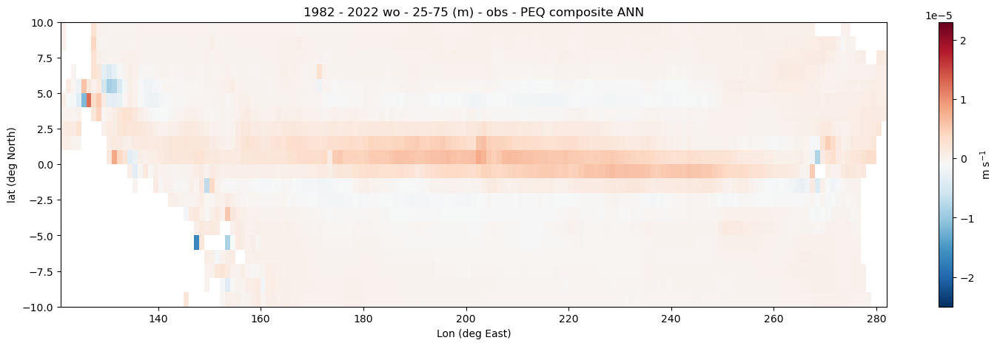

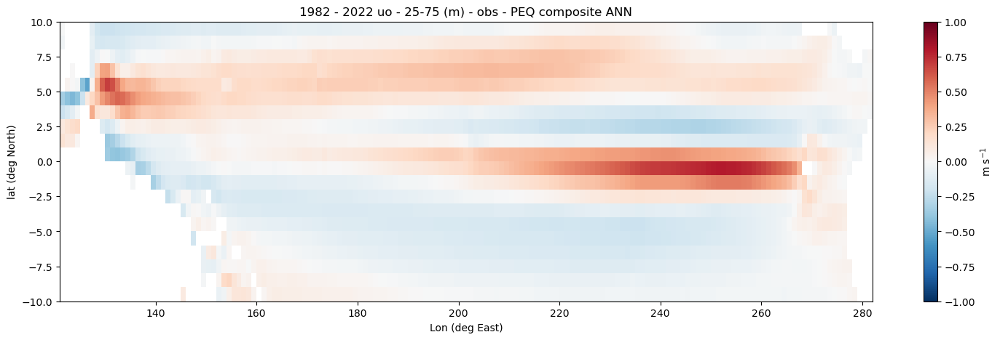

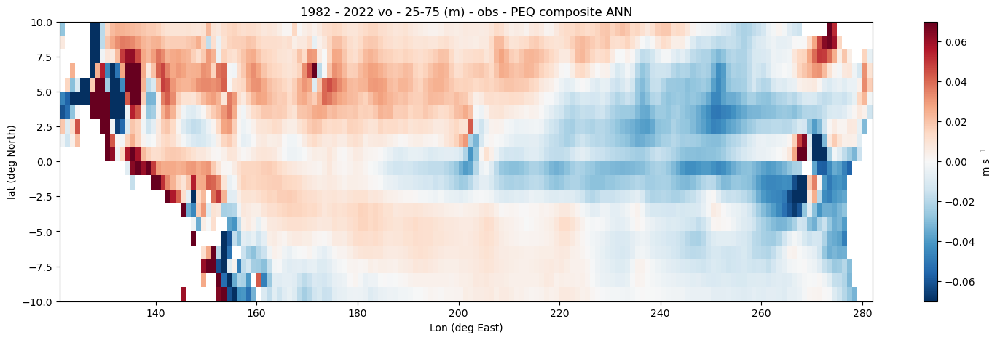

In [182]:

monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_uo['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ_wo, unit =  units_wo,  vmin = ranges_dicts_wo_ENSO['surface']['vmin'], vmax = ranges_dicts_wo_ENSO['surface']['vmax'])
plot_dict['uo'] = dict(dict = dict_profile_EQ_uo, unit =  units_uo,    vmin = ranges_dicts_uo_ENSO['surface']['vmin'], vmax = ranges_dicts_uo_ENSO['surface']['vmax'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ_vo, unit =  units_vo,   vmin = ranges_dicts_vo_ENSO['surface']['vmin'], vmax = ranges_dicts_vo_ENSO['surface']['vmax'] )


for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} {var}'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


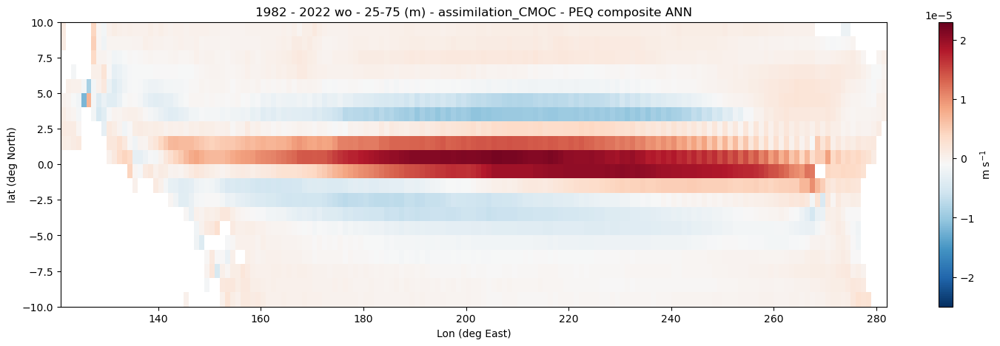

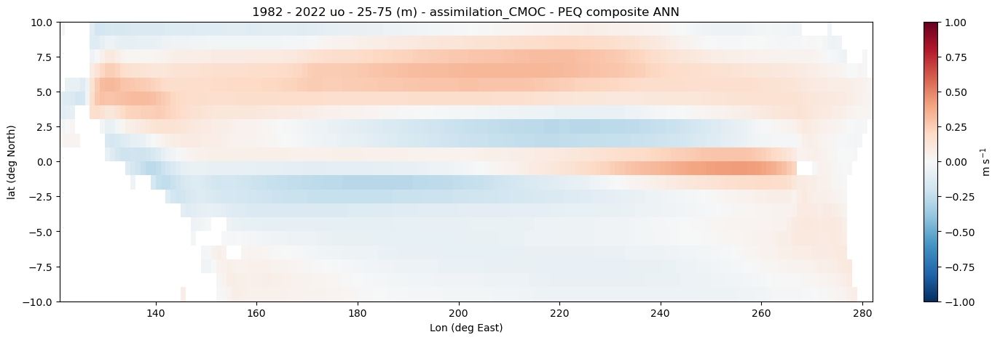

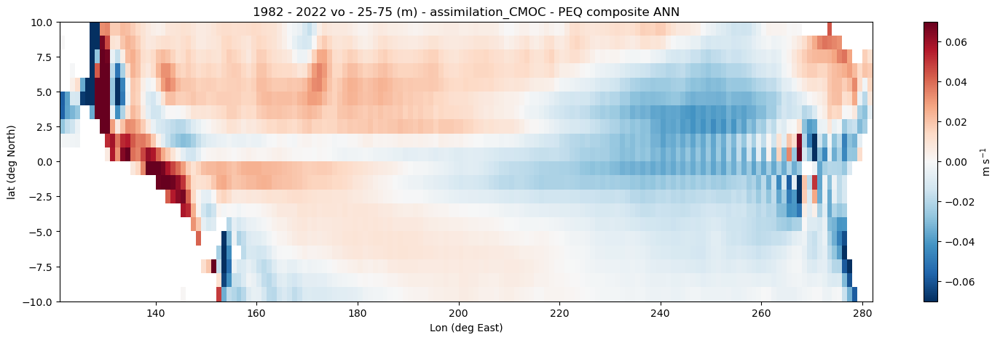

In [183]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_uo['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ_wo, unit =  units_wo,  vmin = ranges_dicts_wo_ENSO['surface']['vmin'], vmax = ranges_dicts_wo_ENSO['surface']['vmax'])
plot_dict['uo'] = dict(dict = dict_profile_EQ_uo, unit =  units_uo,    vmin = ranges_dicts_uo_ENSO['surface']['vmin'], vmax = ranges_dicts_uo_ENSO['surface']['vmax'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ_vo, unit =  units_vo,   vmin = ranges_dicts_vo_ENSO['surface']['vmin'], vmax = ranges_dicts_vo_ENSO['surface']['vmax'] )


for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} {var}'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


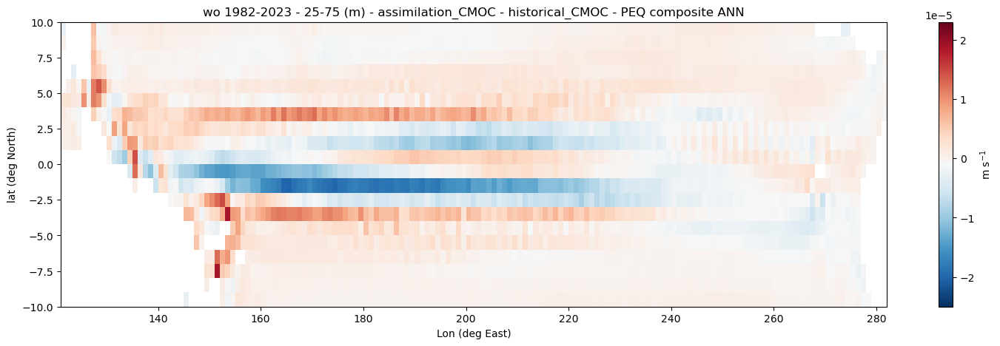

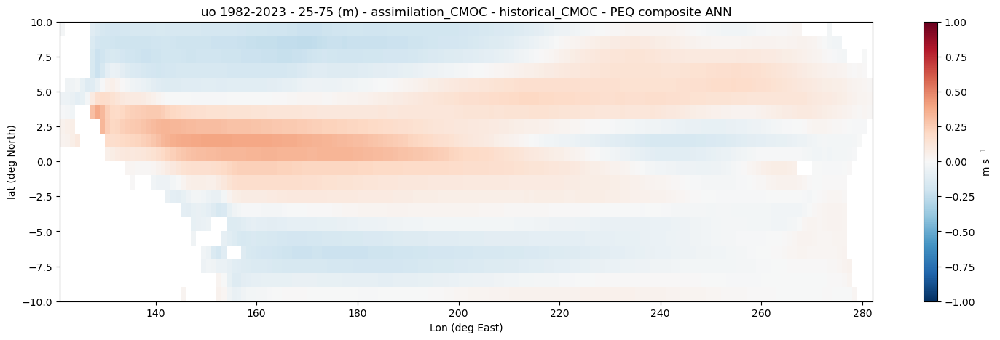

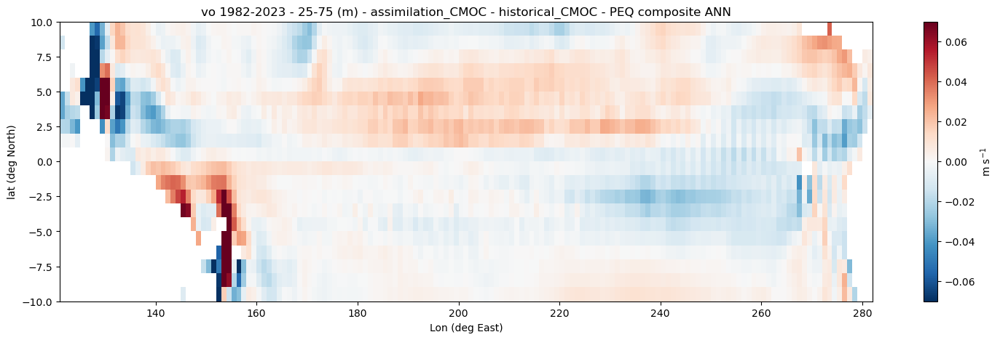

In [134]:

monthly_res = True
ds_list = ['assimilation_CMOC - historical_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_uo['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}

plot_dict['wo'] = dict(dict = dict_profile_EQ_wo_diff, unit =  units_wo, vmin = -0.25 * 1e-4, vmax = 0.23 * 1e-4  )
plot_dict['uo'] = dict(dict = dict_profile_EQ_uo_diff, unit =  units_uo, vmin = -10 * 1e-1, vmax = 10 * 1e-1 )
plot_dict['vo'] = dict(dict = dict_profile_EQ_vo_diff, unit =  units_vo, vmin = -70 * 1e-3, vmax = 70 * 1e-3    )



for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None


    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax = vmax,
                vmin = vmin,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


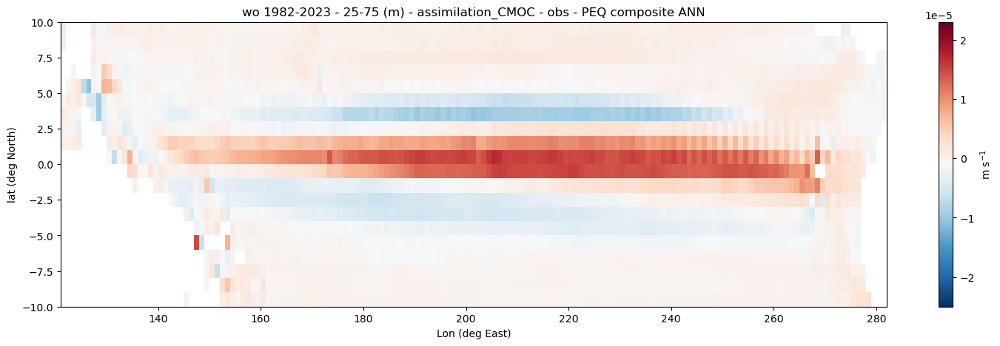

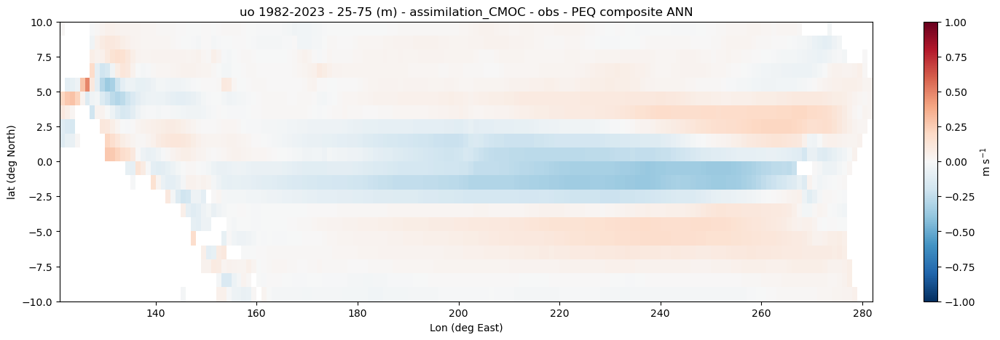

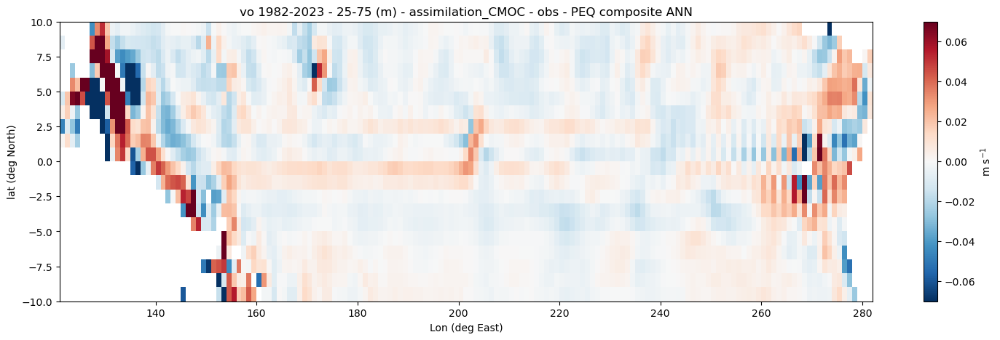

In [184]:

monthly_res = True
ds_list = ['assimilation_CMOC - obs']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_uo['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}

plot_dict['wo'] = dict(dict = dict_profile_EQ_wo_diff, unit =  units_wo, vmin = -0.25 * 1e-4, vmax = 0.23 * 1e-4  )
plot_dict['uo'] = dict(dict = dict_profile_EQ_uo_diff, unit =  units_uo, vmin = -10 * 1e-1, vmax = 10 * 1e-1 )
plot_dict['vo'] = dict(dict = dict_profile_EQ_vo_diff, unit =  units_vo, vmin = -70 * 1e-3, vmax = 70 * 1e-3    )



for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None


    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax = vmax,
                vmin = vmin,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


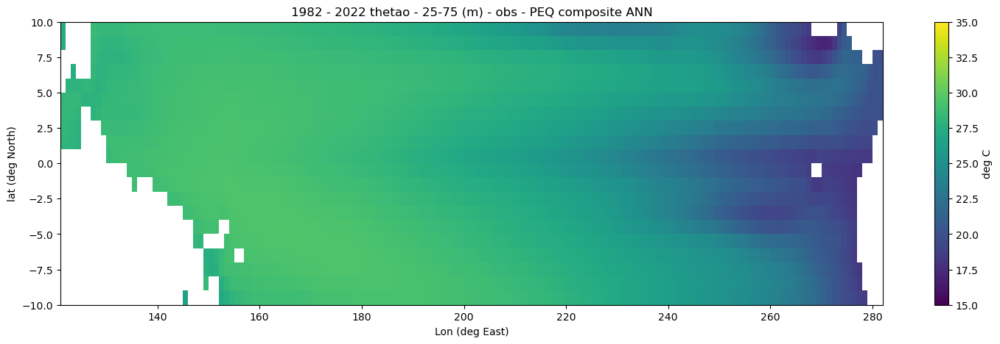

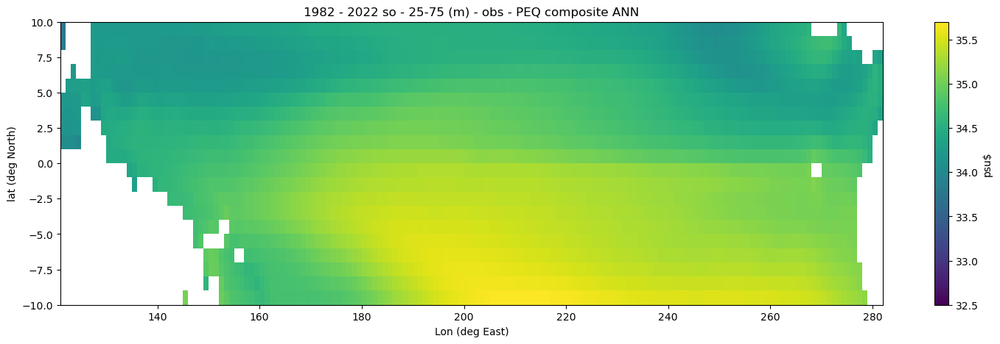

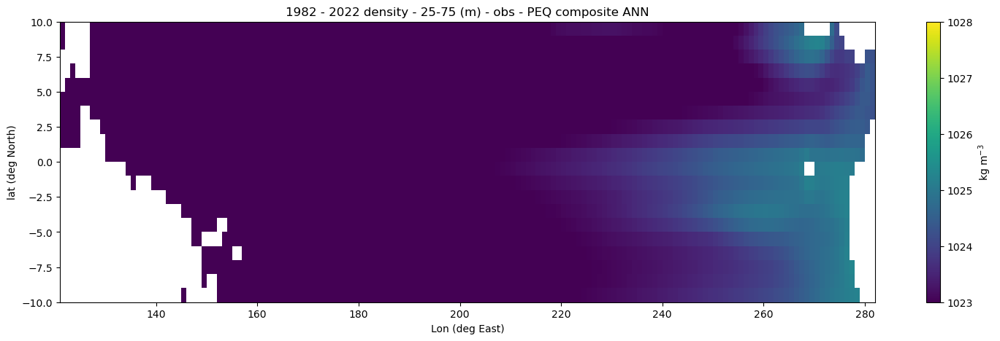

In [185]:
monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_profile_EQ_thetao, unit =  units_thetao,  vmin = ranges_dicts_thetao_ENSO['surface']['vmin'], vmax = ranges_dicts_thetao_ENSO['surface']['vmax'] )
plot_dict['so'] = dict(dict = dict_profile_EQ_so, unit =  units_so, vmin = ranges_dicts_so_ENSO['surface']['vmin'], vmax = ranges_dicts_so_ENSO['surface']['vmax'] )
plot_dict['density'] = dict(dict = dict_profile_EQ_density, unit =  units_density,  vmin = ranges_dicts_density_ENSO['surface']['vmin'], vmax = ranges_dicts_density_ENSO['surface']['vmax'] )

for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} {var}'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


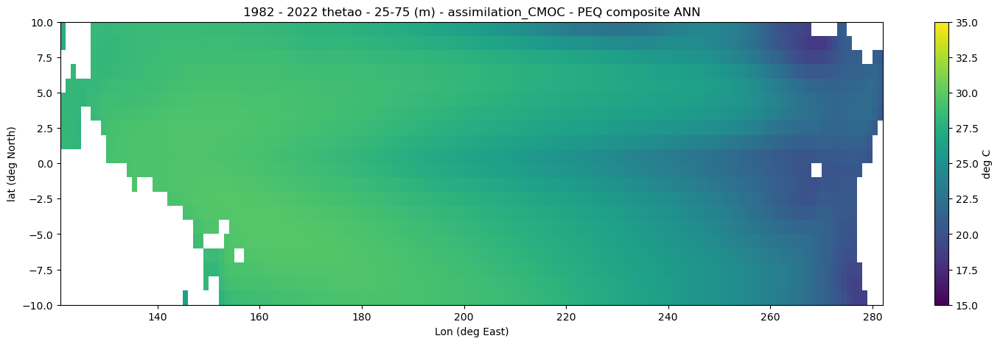

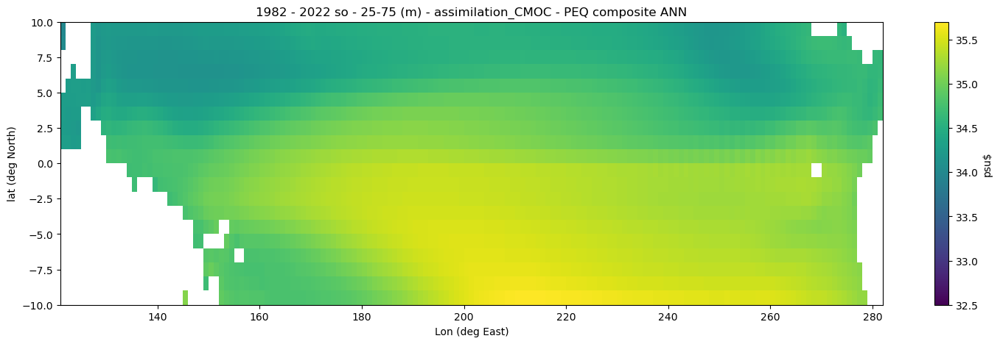

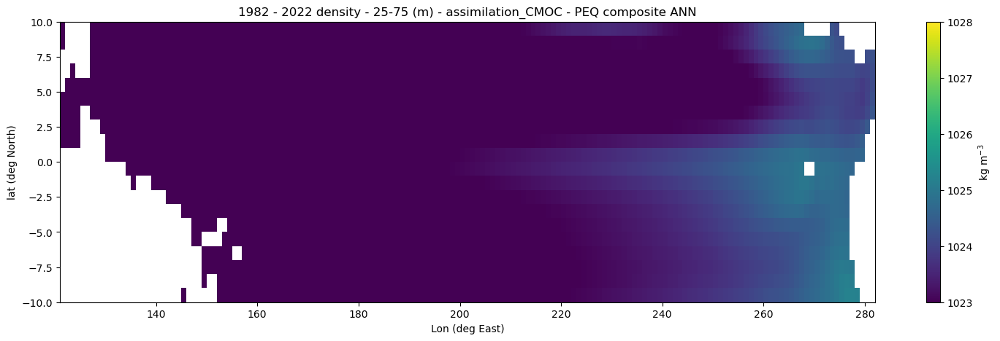

In [186]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_profile_EQ_thetao, unit =  units_thetao,  vmin = ranges_dicts_thetao_ENSO['surface']['vmin'], vmax = ranges_dicts_thetao_ENSO['surface']['vmax'] )
plot_dict['so'] = dict(dict = dict_profile_EQ_so, unit =  units_so, vmin = ranges_dicts_so_ENSO['surface']['vmin'], vmax = ranges_dicts_so_ENSO['surface']['vmax'] )
plot_dict['density'] = dict(dict = dict_profile_EQ_density, unit =  units_density,  vmin = ranges_dicts_density_ENSO['surface']['vmin'], vmax = ranges_dicts_density_ENSO['surface']['vmax'] )

for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} {var}'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


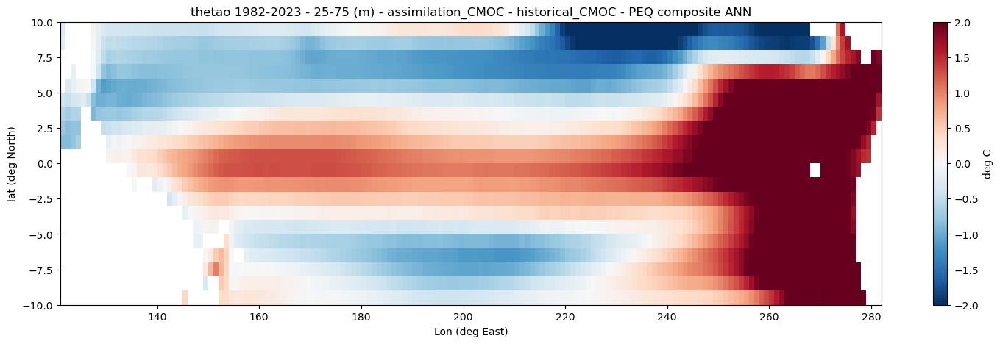

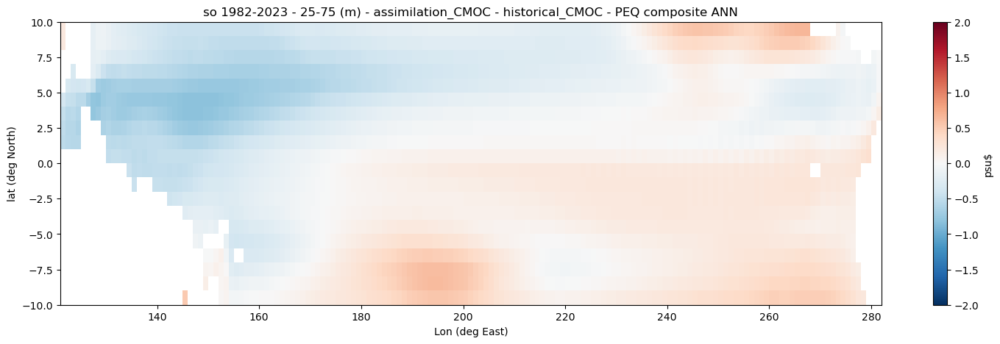

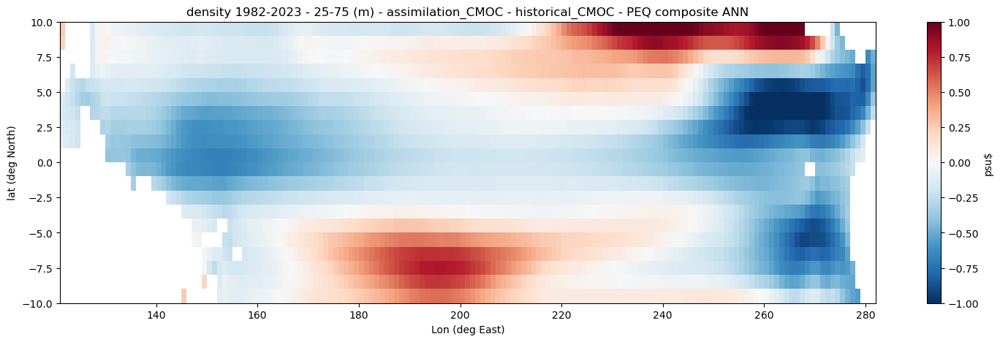

In [135]:

monthly_res = True
ds_list = ['assimilation_CMOC - historical_CMOC']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_profile_EQ_thetao_diff, unit =  units_thetao, vmin = -2, vmax =  2 )
plot_dict['so'] = dict(dict = dict_profile_EQ_so_diff, unit =  units_so, vmin = -2, vmax =  2 )
plot_dict['density'] = dict(dict = dict_profile_EQ_density_diff, unit =  units_so, vmin = -1, vmax =  1 )

for var in ['thetao', 'so','density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


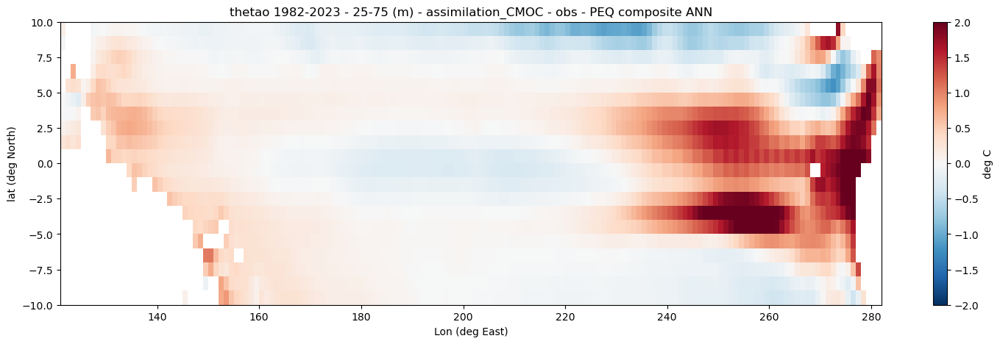

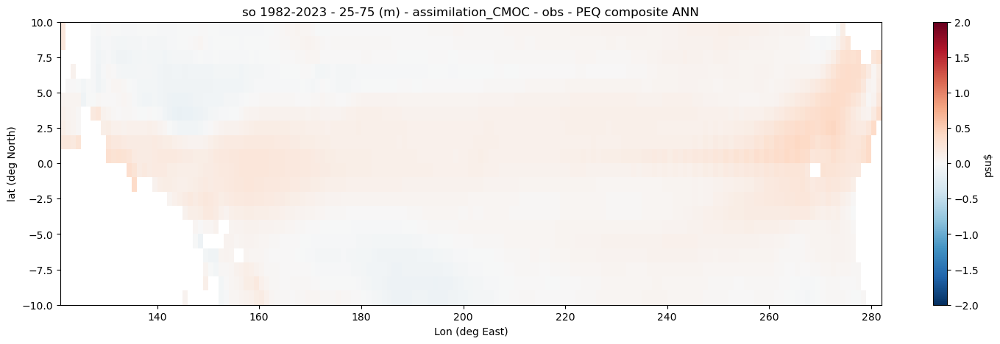

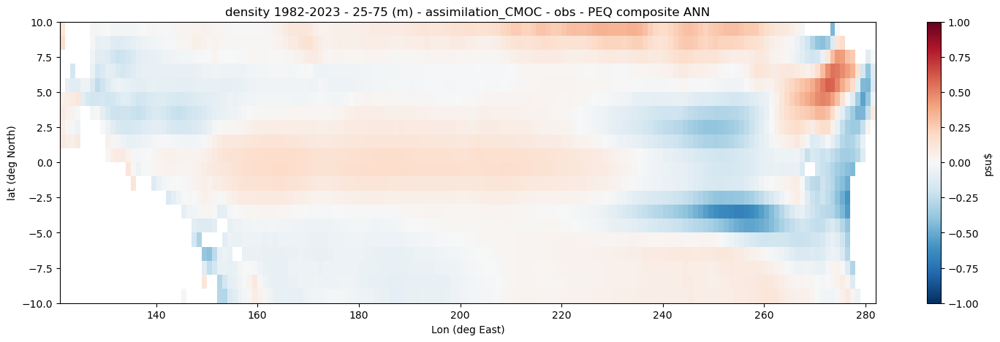

In [189]:

monthly_res = True
ds_list = ['assimilation_CMOC - obs']
figsize = (18,5)

lev_range = [25,75]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_profile_EQ_thetao_diff, unit =  units_thetao, vmin = -2, vmax =  2 )
plot_dict['so'] = dict(dict = dict_profile_EQ_so_diff, unit =  units_so, vmin = -2, vmax =  2 )
plot_dict['density'] = dict(dict = dict_profile_EQ_density_diff, unit =  units_so, vmin = -1, vmax =  1 )

for var in ['thetao', 'so','density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### depth

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


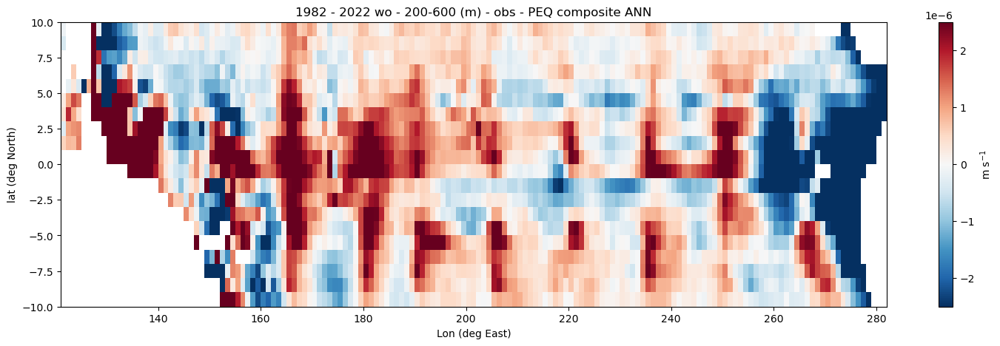

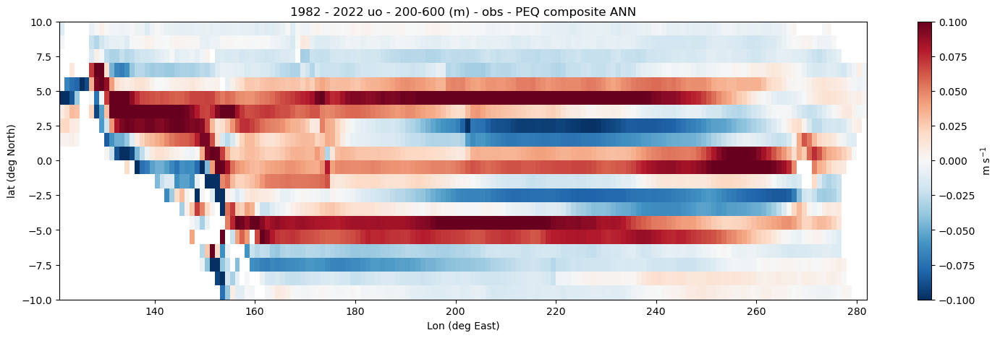

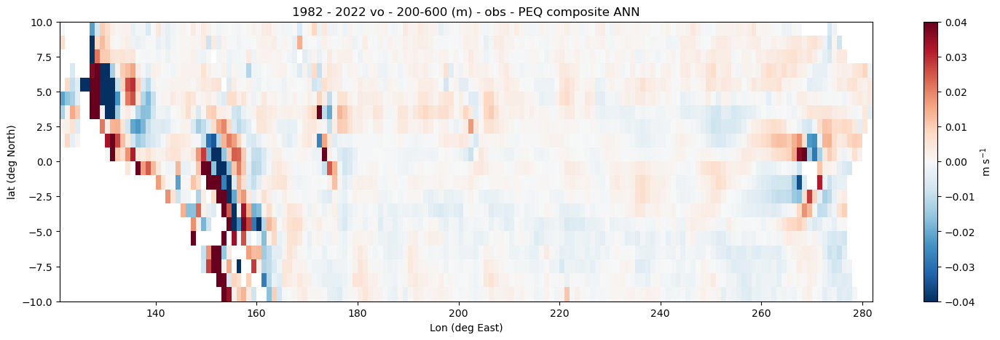

In [192]:

monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_uo['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ_wo, unit =  units_wo,  vmin = ranges_dicts_wo_ENSO['depth']['vmin'], vmax = ranges_dicts_wo_ENSO['depth']['vmax'])
plot_dict['uo'] = dict(dict = dict_profile_EQ_uo, unit =  units_uo,    vmin = ranges_dicts_uo_ENSO['depth']['vmin'], vmax = ranges_dicts_uo_ENSO['depth']['vmax'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ_vo, unit =  units_vo,   vmin = ranges_dicts_vo_ENSO['depth']['vmin'], vmax = ranges_dicts_vo_ENSO['depth']['vmax'] )


for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} {var}'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


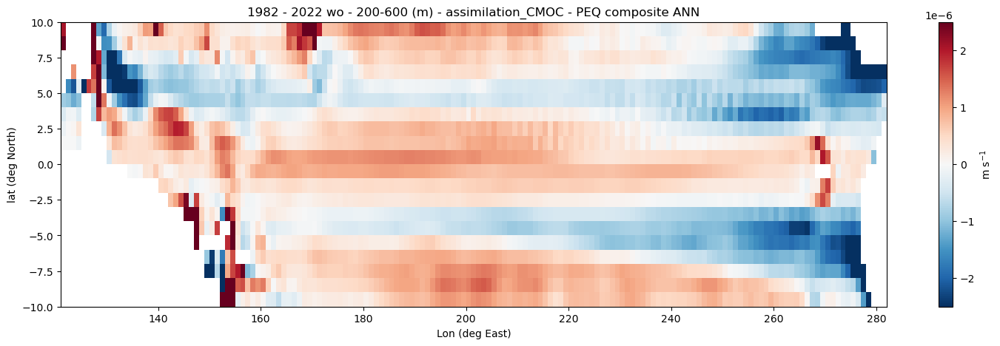

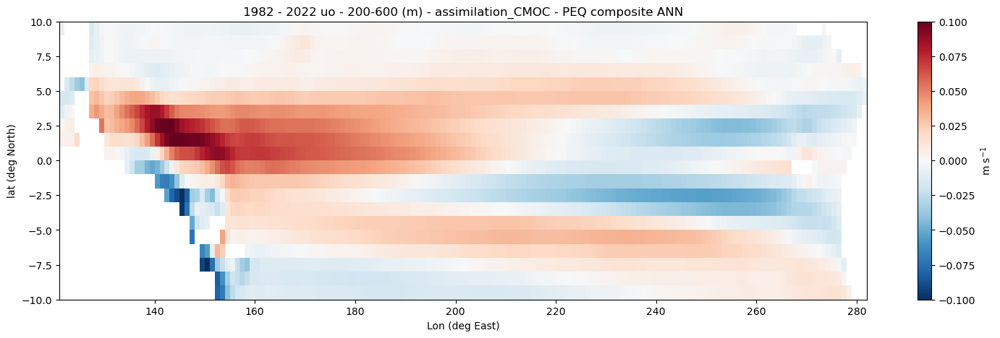

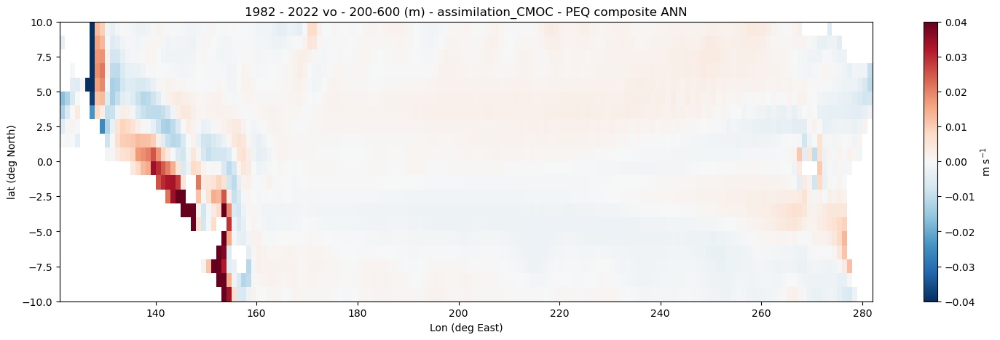

In [193]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_uo['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ_wo, unit =  units_wo,  vmin = ranges_dicts_wo_ENSO['depth']['vmin'], vmax = ranges_dicts_wo_ENSO['depth']['vmax'])
plot_dict['uo'] = dict(dict = dict_profile_EQ_uo, unit =  units_uo,   vmin = ranges_dicts_uo_ENSO['depth']['vmin'], vmax = ranges_dicts_uo_ENSO['depth']['vmax'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ_vo, unit =  units_vo,   vmin = ranges_dicts_vo_ENSO['depth']['vmin'], vmax = ranges_dicts_vo_ENSO['depth']['vmax'] )


for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} {var}'
    units = plot_dict[var]['unit']
    vmin = plot_dict[var]['vmin']
    vmax = plot_dict[var]['vmax']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


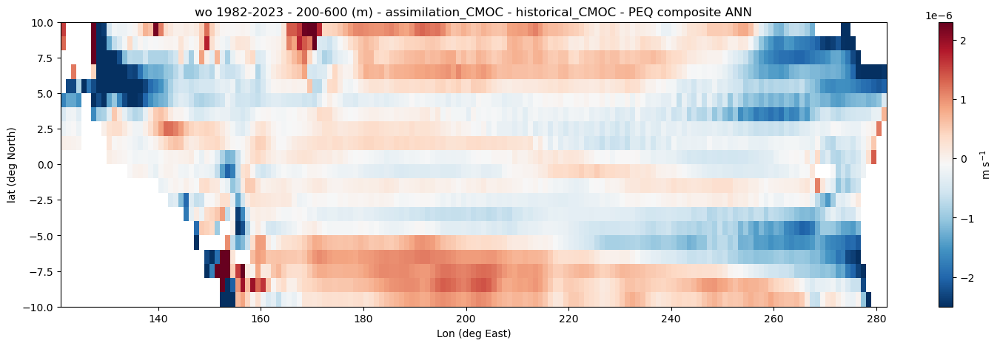

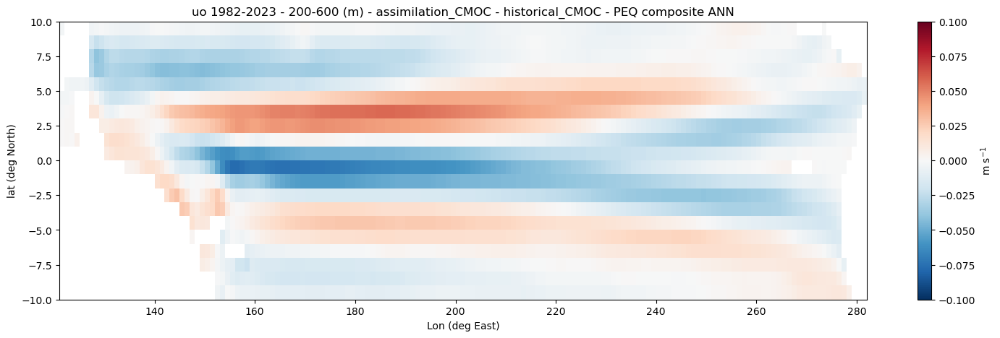

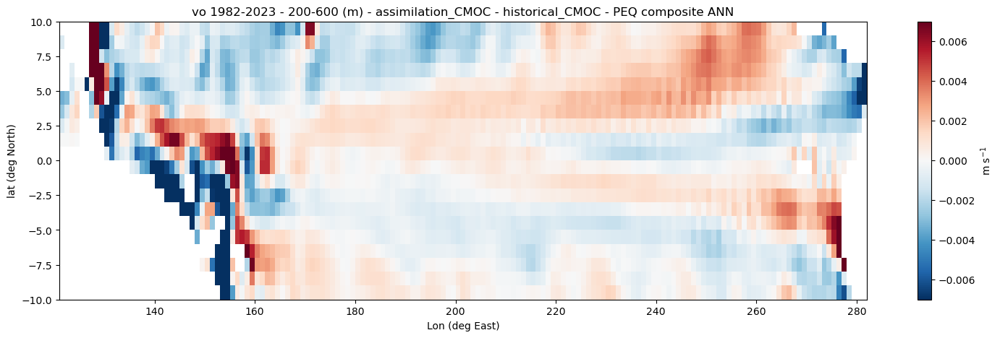

In [136]:

monthly_res = True
ds_list = ['assimilation_CMOC - historical_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_uo['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}

plot_dict['wo'] = dict(dict = dict_profile_EQ_wo_diff, unit =  units_wo, vmin = -0.25 * 1e-5, vmax = 0.23 * 1e-5  )
plot_dict['uo'] = dict(dict = dict_profile_EQ_uo_diff, unit =  units_uo, vmin = -10 * 1e-2, vmax = 10 * 1e-2 )
plot_dict['vo'] = dict(dict = dict_profile_EQ_vo_diff, unit =  units_vo, vmin = -70 * 1e-4, vmax = 70 * 1e-4    )



for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None


    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax = vmax,
                vmin = vmin,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


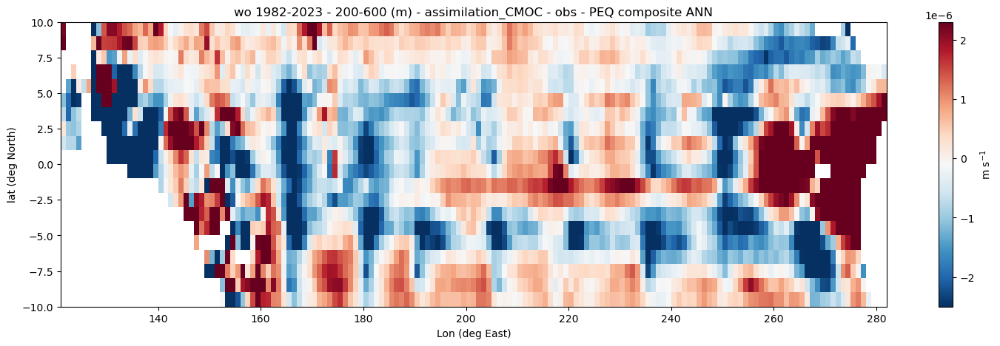

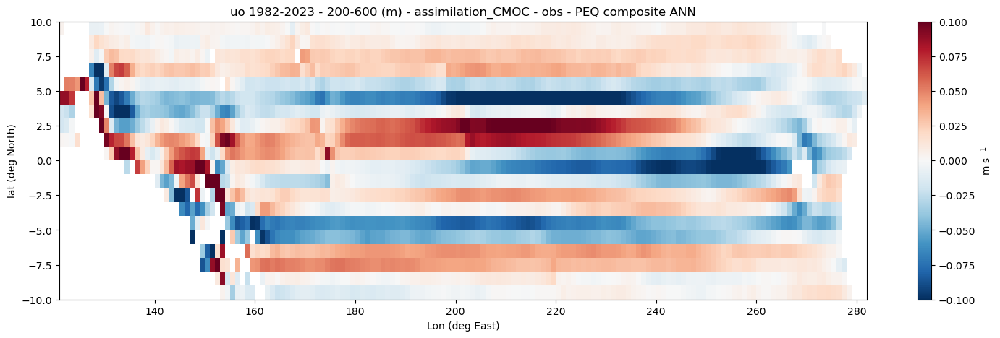

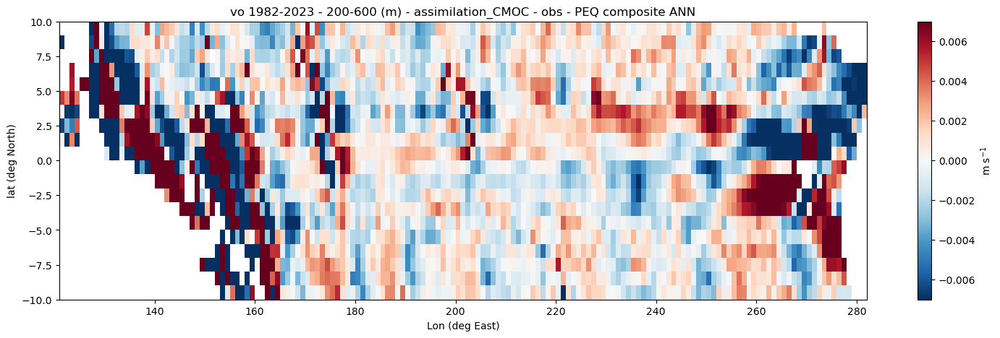

In [194]:

monthly_res = True
ds_list = ['assimilation_CMOC - obs']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_uo['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}

plot_dict['wo'] = dict(dict = dict_profile_EQ_wo_diff, unit =  units_wo, vmin = -0.25 * 1e-5, vmax = 0.23 * 1e-5  )
plot_dict['uo'] = dict(dict = dict_profile_EQ_uo_diff, unit =  units_uo, vmin = -10 * 1e-2, vmax = 10 * 1e-2 )
plot_dict['vo'] = dict(dict = dict_profile_EQ_vo_diff, unit =  units_vo, vmin = -70 * 1e-4, vmax = 70 * 1e-4    )



for var in ['wo', 'uo', 'vo']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    if var == 'wo':
        lev_interp = ddata_em_after_uo['historical_CMOC'].lev
    else:
        lev_interp = None


    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax = vmax,
                vmin = vmin,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                lev_interp = lev_interp,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


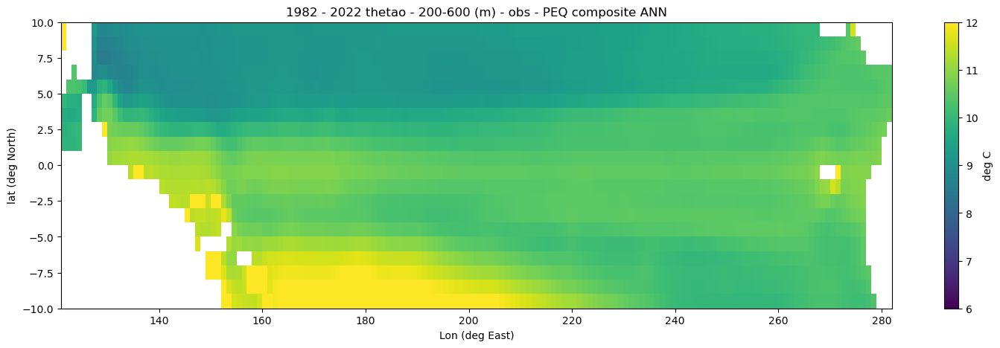

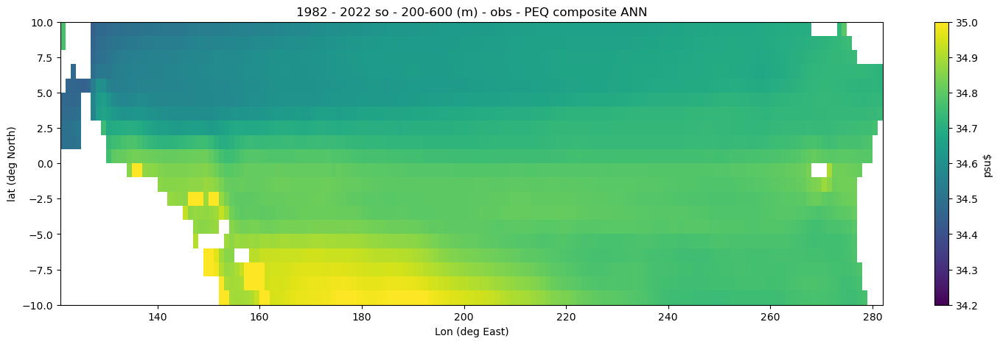

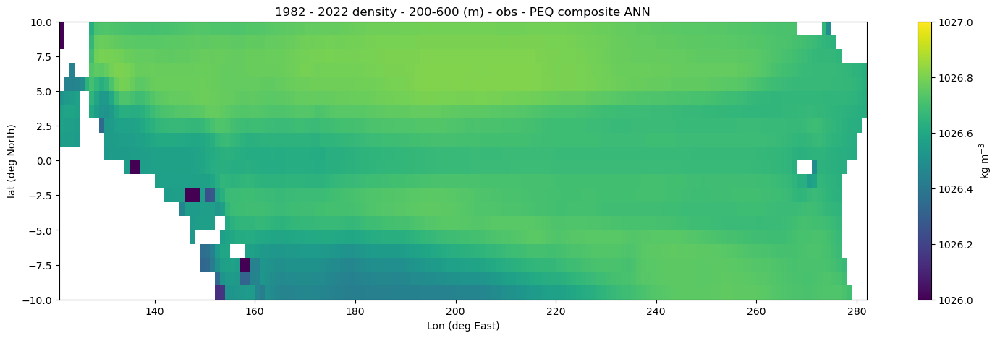

In [200]:
monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_profile_EQ_thetao, unit =  units_thetao,  vmin = ranges_dicts_thetao_ENSO['depth']['vmin'], vmax = ranges_dicts_thetao_ENSO['depth']['vmax'] )
plot_dict['so'] = dict(dict = dict_profile_EQ_so, unit =  units_so, vmin = ranges_dicts_so_ENSO['depth']['vmin'], vmax = ranges_dicts_so_ENSO['depth']['vmax'] )
plot_dict['density'] = dict(dict = dict_profile_EQ_density, unit =  units_density,  vmin = ranges_dicts_density_ENSO['depth']['vmin']-1, vmax = ranges_dicts_density_ENSO['depth']['vmax']-1 )

for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} {var}'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


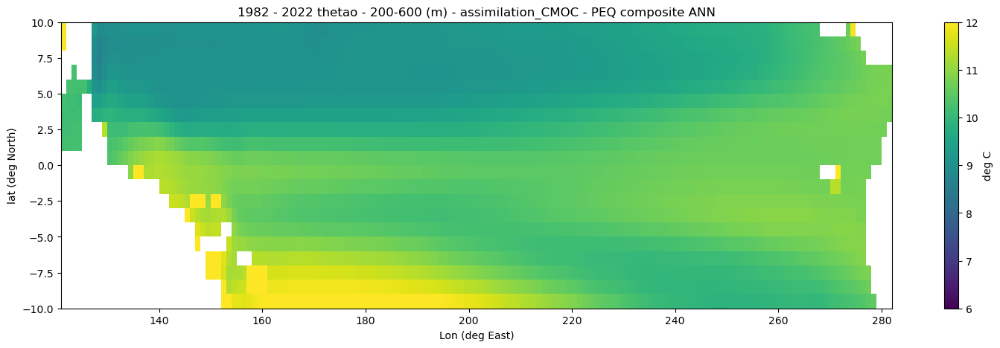

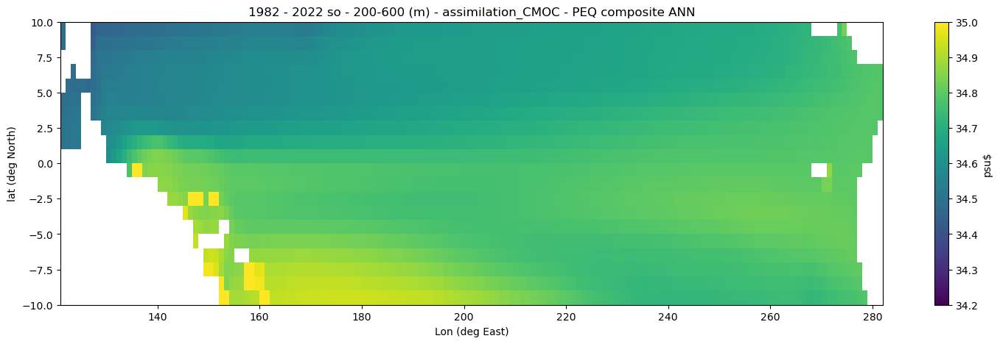

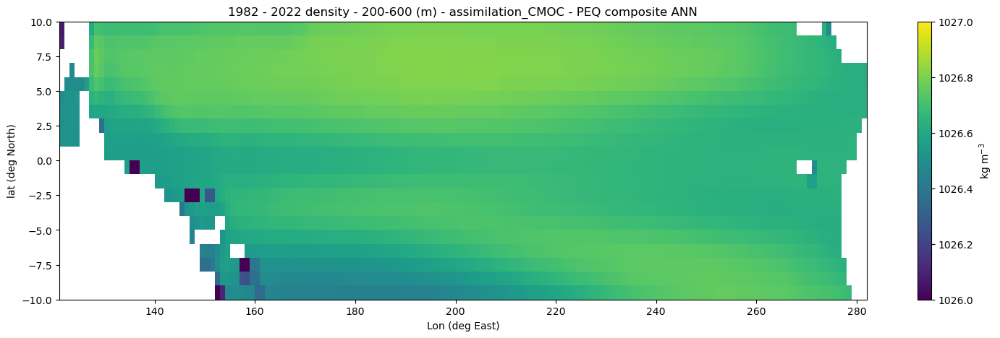

In [201]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_profile_EQ_thetao, unit =  units_thetao,  vmin = ranges_dicts_thetao_ENSO['depth']['vmin'], vmax = ranges_dicts_thetao_ENSO['depth']['vmax'] )
plot_dict['so'] = dict(dict = dict_profile_EQ_so, unit =  units_so, vmin = ranges_dicts_so_ENSO['depth']['vmin'], vmax = ranges_dicts_so_ENSO['depth']['vmax'] )
plot_dict['density'] = dict(dict = dict_profile_EQ_density, unit =  units_density,  vmin = ranges_dicts_density_ENSO['depth']['vmin']-1, vmax = ranges_dicts_density_ENSO['depth']['vmax']-1 )

for var in ['thetao', 'so', 'density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{y0_show} - {y1_show} {var}'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmax  = vmax,
                vmin = vmin,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


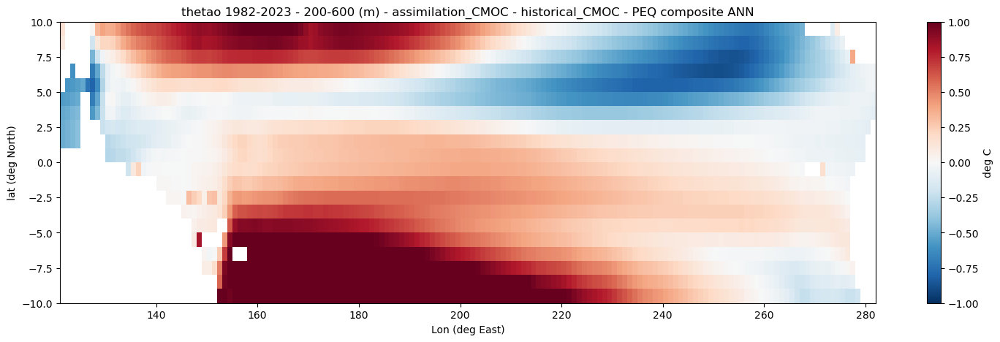

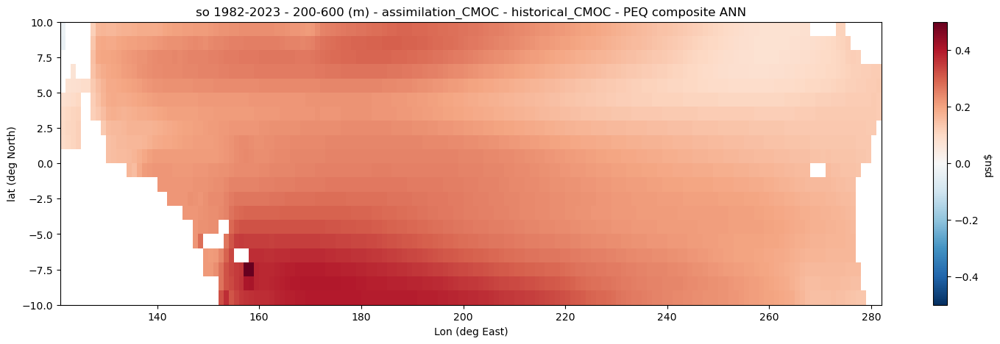

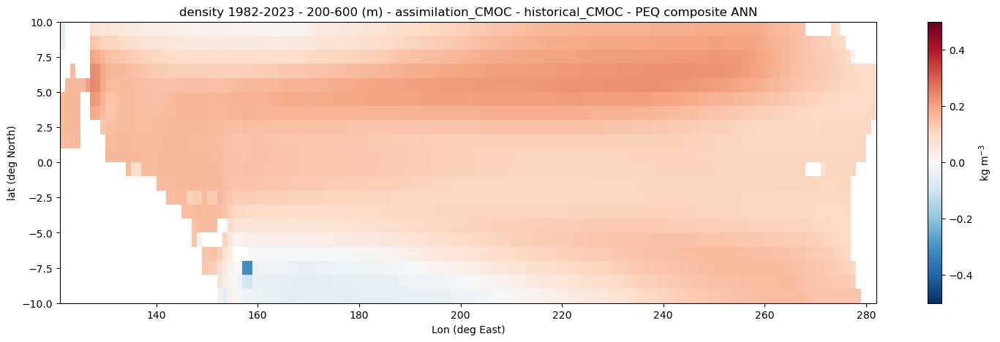

In [137]:

monthly_res = True
ds_list = ['assimilation_CMOC - historical_CMOC']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_profile_EQ_thetao_diff, unit =  units_thetao, vmin = -1, vmax =  1 )
plot_dict['so'] = dict(dict = dict_profile_EQ_so_diff, unit =  units_so, vmin = -0.5, vmax =  0.5 )
plot_dict['density'] = dict(dict = dict_profile_EQ_density_diff, unit =  units_density, vmin = -0.5, vmax =  0.5 )

for var in ['thetao', 'so','density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


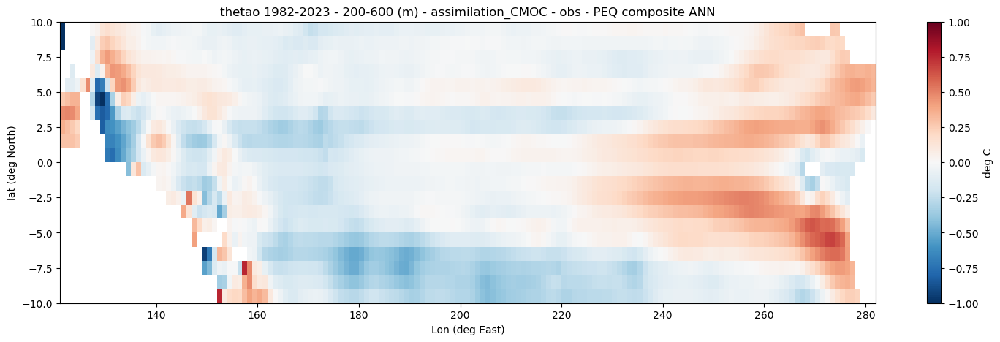

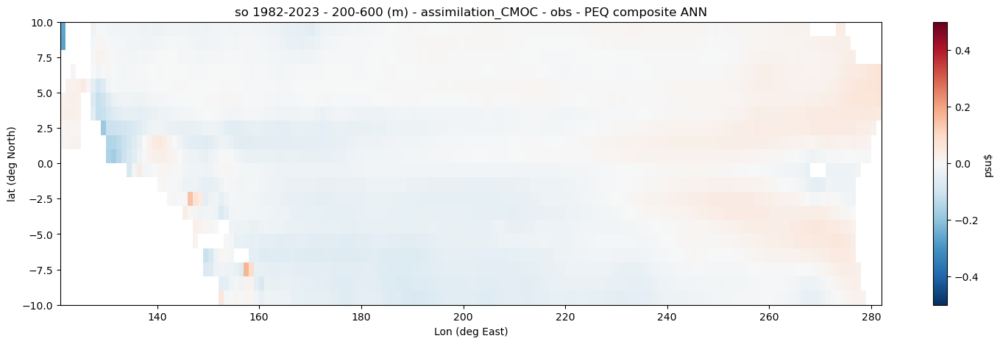

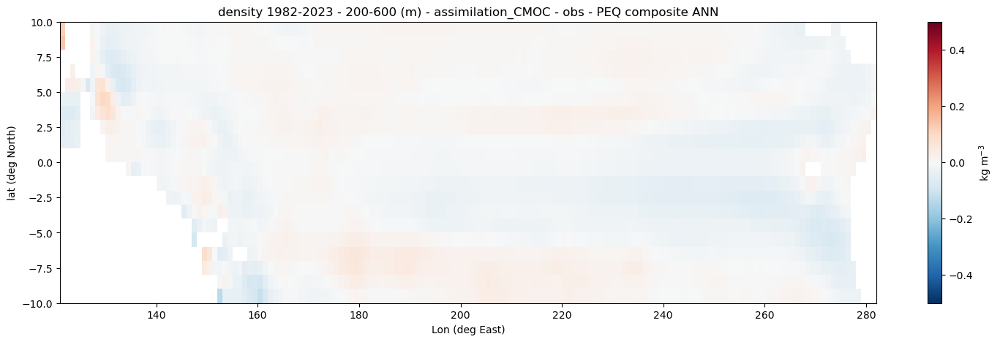

In [197]:

monthly_res = True
ds_list = ['assimilation_CMOC - obs']
figsize = (18,5)

lev_range = [200,600]
yeartoplot = list(dict_anom_snaps_clim_removed_thetao['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_profile_EQ_thetao_diff, unit =  units_thetao, vmin = -1, vmax =  1 )
plot_dict['so'] = dict(dict = dict_profile_EQ_so_diff, unit =  units_so, vmin = -0.5, vmax =  0.5 )
plot_dict['density'] = dict(dict = dict_profile_EQ_density_diff, unit =  units_density, vmin = -0.5, vmax =  0.5 )

for var in ['thetao', 'so','density']:
    ds_dicts = plot_dict[var]['dict']
    title = f'{var} 1982-2023'
    units = plot_dict[var]['unit']
    vmax = plot_dict[var]['vmax']
    vmin = plot_dict[var]['vmin']

    snapshot_arial(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                season = 'ANN',
                lev_range = lev_range,
                show=True)



### quiver

OND:[9, 10, 11]
Scale Factor Y : 10 
 Scale Factor X : 1 
OND:[9, 10, 11]
Scale Factor Y : 10 
 Scale Factor X : 1 
OND:[9, 10, 11]
Scale Factor Y : 10 
 Scale Factor X : 1 


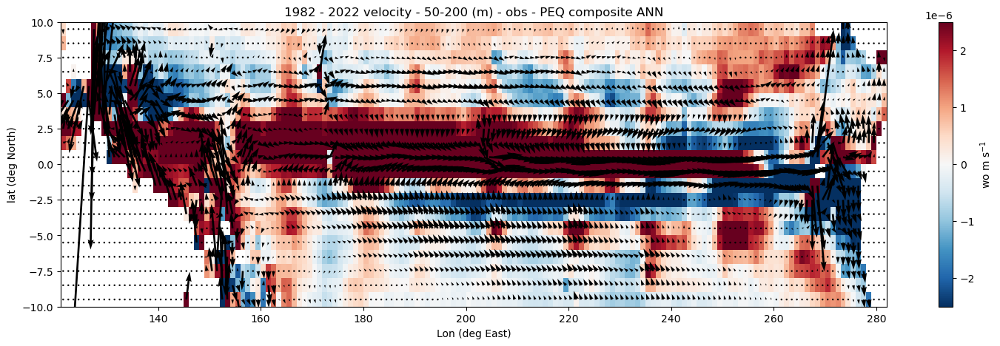

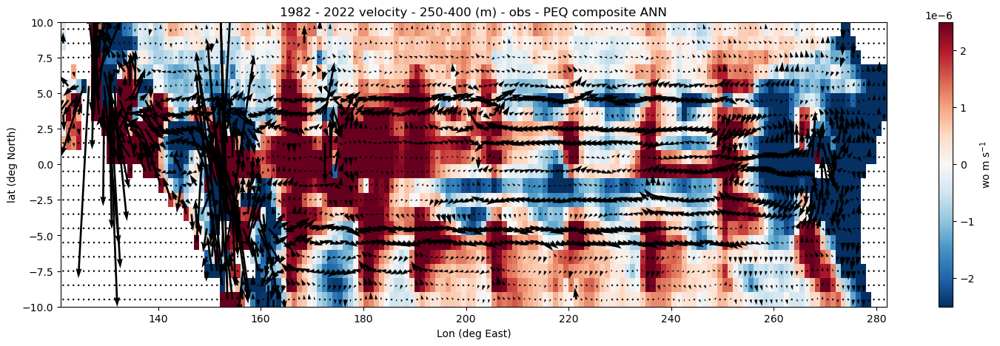

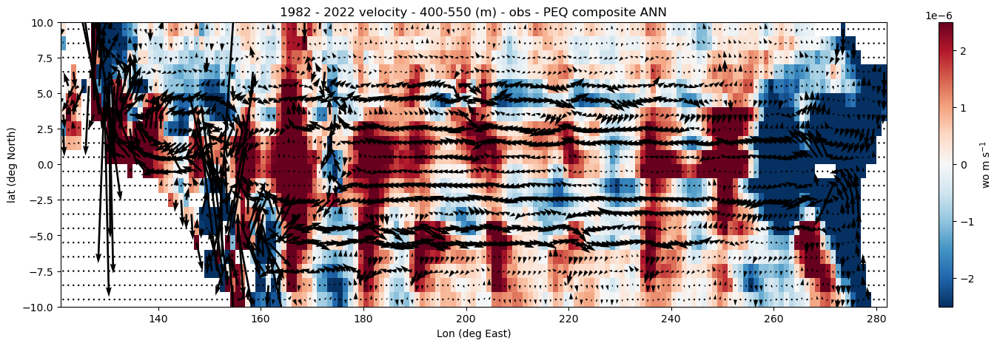

In [69]:

monthly_res = True
ds_list = ['obs']
figsize = (18,5)

lev_range = [300,400]
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'],  vmin = ranges_dicts_ENSO['wo']['depth']['vmin'], vmax = ranges_dicts_ENSO['wo']['depth']['vmax'])
plot_dict['uo'] = dict(dict = dict_profile_EQ['uo'], unit =  units_dics['uo'],    vmin = ranges_dicts_ENSO['uo']['depth']['vmin'], vmax = ranges_dicts_ENSO['uo']['depth']['vmax'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo'],   vmin = ranges_dicts_ENSO['vo']['depth']['vmin'], vmax = ranges_dicts_ENSO['vo']['depth']['vmax'] )



ds_dicts = plot_dict['wo']['dict']
title = f'{y0_show} - {y1_show} velocity'
units = 'wo ' +   plot_dict['wo']['unit']
vmin = plot_dict['wo']['vmin']
vmax = plot_dict['wo']['vmax']

for lev_range in [[50,200], [250,400], [400,550]]:

    snapshot_arial_quiver(ds_list,
                                plot_dict['uo']['dict'],
                                plot_dict['vo']['dict'],
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                colorbar_dict = ds_dicts,
                season = 'ANN',
                lev_range = lev_range,
                show=True,
                scale_factor_Y=10)



OND:[9, 10, 11]
Scale Factor Y : 10 
 Scale Factor X : 1 
OND:[9, 10, 11]
Scale Factor Y : 10 
 Scale Factor X : 1 
OND:[9, 10, 11]
Scale Factor Y : 10 
 Scale Factor X : 1 


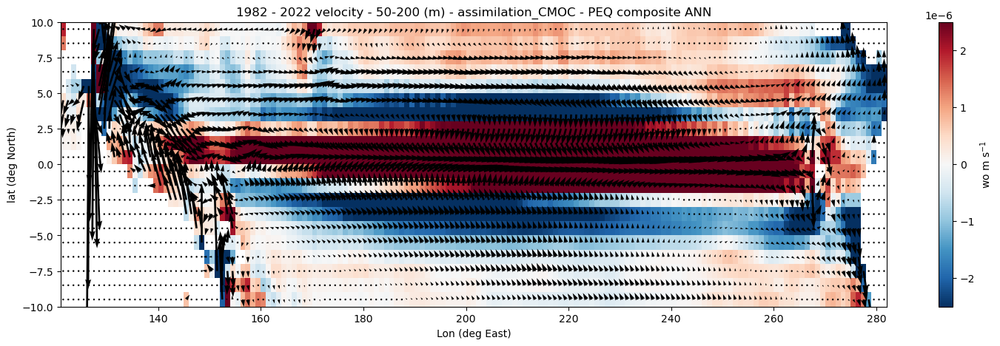

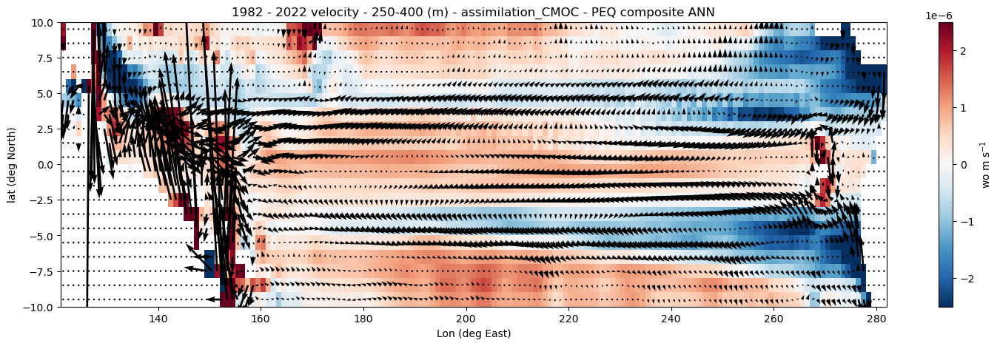

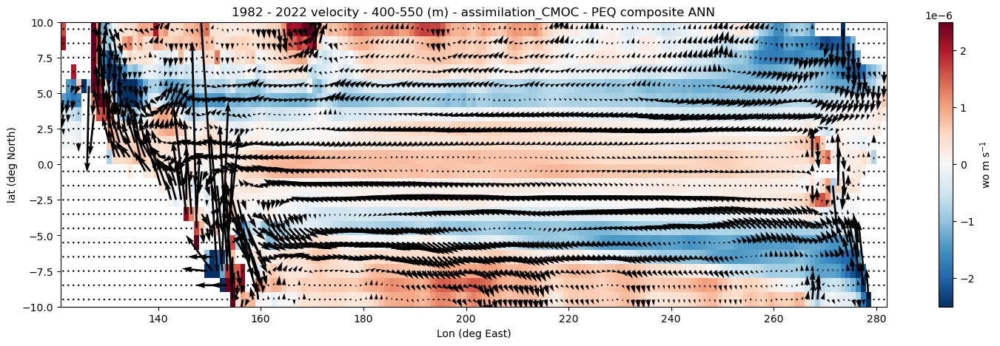

In [71]:

monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (18,5)

lev_range = [300,400]
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'],  vmin = ranges_dicts_ENSO['wo']['depth']['vmin'], vmax = ranges_dicts_ENSO['wo']['depth']['vmax'])
plot_dict['uo'] = dict(dict = dict_profile_EQ['uo'], unit =  units_dics['uo'],    vmin = ranges_dicts_ENSO['uo']['depth']['vmin'], vmax = ranges_dicts_ENSO['uo']['depth']['vmax'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo'],   vmin = ranges_dicts_ENSO['vo']['depth']['vmin'], vmax = ranges_dicts_ENSO['vo']['depth']['vmax'] )



ds_dicts = plot_dict['wo']['dict']
title = f'{y0_show} - {y1_show} velocity'
units = 'wo ' +   plot_dict['wo']['unit']
vmin = plot_dict['wo']['vmin']
vmax = plot_dict['wo']['vmax']

for lev_range in [[50,200], [250,400], [400,550]]:

    snapshot_arial_quiver(ds_list,
                                plot_dict['uo']['dict'],
                                plot_dict['vo']['dict'],
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                colorbar_dict = ds_dicts,
                season = 'ANN',
                lev_range = lev_range,
                show=True,
                scale_factor_Y=10)



OND:[9, 10, 11]
Scale Factor Y : 10 
 Scale Factor X : 1 
OND:[9, 10, 11]
Scale Factor Y : 10 
 Scale Factor X : 1 
OND:[9, 10, 11]
Scale Factor Y : 10 
 Scale Factor X : 1 


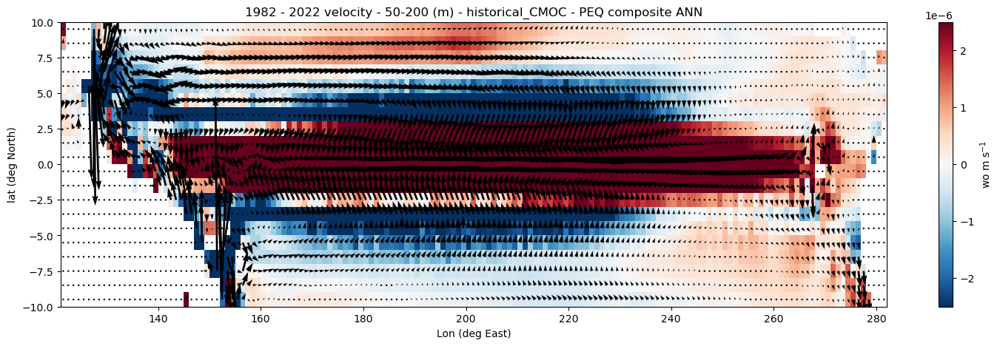

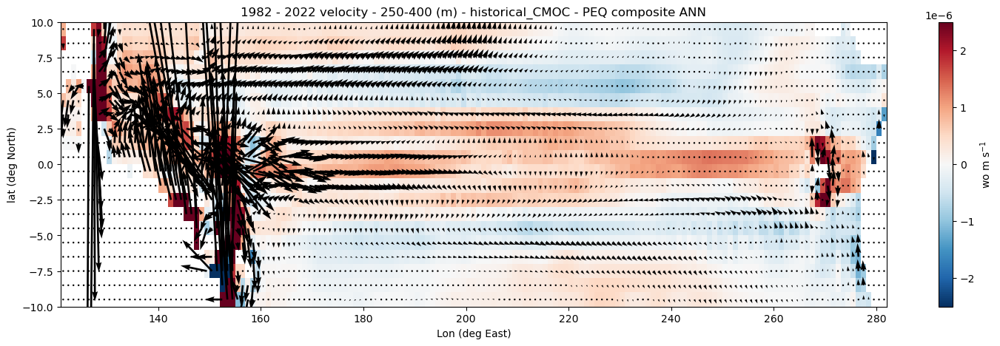

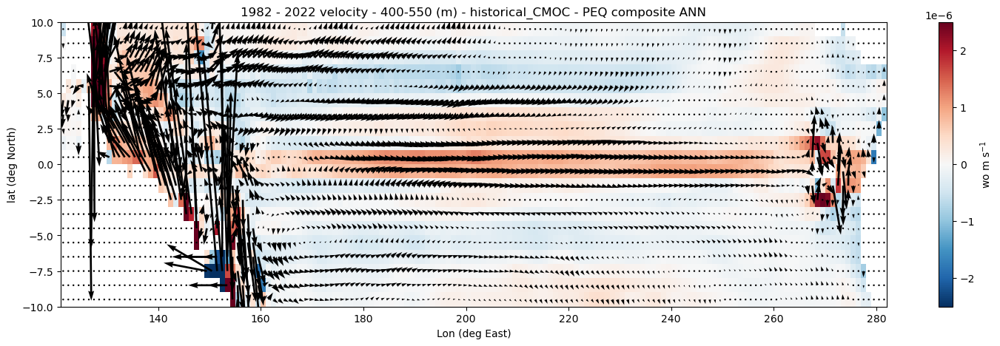

In [70]:

monthly_res = True
ds_list = ['historical_CMOC']
figsize = (18,5)

lev_range = [300,400]
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'],  vmin = ranges_dicts_ENSO['wo']['depth']['vmin'], vmax = ranges_dicts_ENSO['wo']['depth']['vmax'])
plot_dict['uo'] = dict(dict = dict_profile_EQ['uo'], unit =  units_dics['uo'],    vmin = ranges_dicts_ENSO['uo']['depth']['vmin'], vmax = ranges_dicts_ENSO['uo']['depth']['vmax'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo'],   vmin = ranges_dicts_ENSO['vo']['depth']['vmin'], vmax = ranges_dicts_ENSO['vo']['depth']['vmax'] )



ds_dicts = plot_dict['wo']['dict']
title = f'{y0_show} - {y1_show} velocity'
units = 'wo ' +   plot_dict['wo']['unit']
vmin = plot_dict['wo']['vmin']
vmax = plot_dict['wo']['vmax']

for lev_range in [[50,200], [250,400], [400,550]]:

    snapshot_arial_quiver(ds_list,
                                plot_dict['uo']['dict'],
                                plot_dict['vo']['dict'],
                                bms_label,
                                yeartoplot,
                title=title,
                figsize=figsize,
                vmin = vmin,
                vmax = vmax,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                colorbar_dict = ds_dicts,
                season = 'ANN',
                lev_range = lev_range,
                show=True,
                scale_factor_Y=10)



Scale Factor Y : 1 
 Scale Factor X : 1 


ValueError: X and Y must be the same size, but X.size is 180 and Y.size is 0.

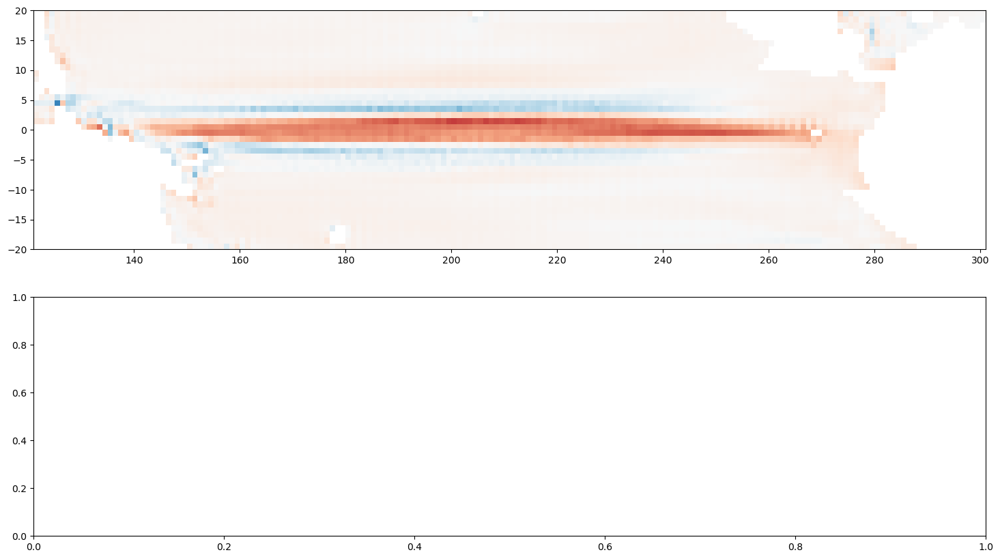

In [42]:

monthly_res = True
ds_list = ['historical_CMOC', 'assimilation_CMOC']
figsize = (18,10)

lev_range = [0,50]
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'],  vmin = ranges_dicts_ENSO['wo']['surface']['vmin'], vmax = ranges_dicts_ENSO['wo']['surface']['vmax'])
plot_dict['uas'] = dict(dict = dict_profile_EQ['uas'], unit =  units_dics['uas'] )
plot_dict['vas'] = dict(dict = dict_profile_EQ['vas'], unit =  units_dics['vas'] )



ds_dicts = plot_dict['wo']['dict']
title = f'{y0_show} - {y1_show} surface wind'
units = 'wo ' +   plot_dict['wo']['unit']
vmin = plot_dict['wo']['vmin']
vmax = plot_dict['wo']['vmax']


snapshot_arial_quiver(ds_list,
                            plot_dict['uas']['dict'],
                            plot_dict['vas']['dict'],
                            bms_label,
                            yeartoplot,
            title=title,
            figsize=figsize,
            vmin = vmin,
            vmax = vmax,
            cmap = 'RdBu_r',
            colorbar_label = units, 
            colorbar_dict = ds_dicts,
            season = 'ANN',
            lev_range = lev_range,
            show=True,
            arrow_scale=300)
            # scale_factor_Y=10)



## Cross sections

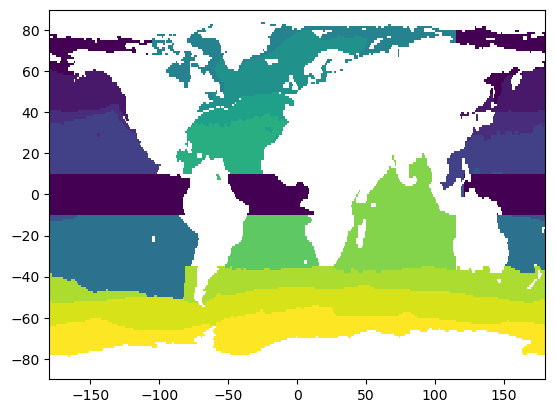

In [72]:

plt.pcolormesh(biomes.MeanBiomes.lon, biomes.MeanBiomes.lat, biomes.MeanBiomes.values)

PEQ = biomes.MeanBiomes.where((biomes.MeanBiomes.lat>= -10) & (biomes.MeanBiomes.lat <= 10))
PEQ = PEQ.where( (PEQ.lon <= -59) | (PEQ.lon >= 121))
PEQ = PEQ.where(np.isnan(PEQ), 1)

PEQ_E = PEQ.where(PEQ.lon<0)
PEQ_W = PEQ.where(PEQ.lon>0)

AEQ = biomes.MeanBiomes.where((biomes.MeanBiomes.lat>= -10) & (biomes.MeanBiomes.lat <= 10))
AEQ = AEQ.where( (AEQ.lon >= -55) & (AEQ.lon <= 20))
AEQ = AEQ.where(np.isnan(AEQ), 1)

plt.pcolormesh(PEQ.lon, PEQ.lat, PEQ.values)
plt.pcolormesh(AEQ.lon, AEQ.lat, AEQ.values)

mask_EQ = { 'PEQ' : PEQ.where(~np.isnan(PEQ),0), 'AEQ' : AEQ.where(~np.isnan(AEQ),0), 'PEQ_E' : PEQ_E.where(~np.isnan(PEQ_E),0), 'PEQ_W' : PEQ_W.where(~np.isnan(PEQ_W),0)}

In [73]:

dict_profile_EQ = {}
dict_clim_mean_removed = {}
dict_anom_snaps_clim_removed = {}

for var in var_list:
    dict_profile_EQ[var] = {}
    dict_clim_mean_removed[var] = {}
    dict_anom_snaps_clim_removed[var] = {}

    for region in ['PEQ','AEQ']:
        dict_profile_EQ[var][region] = {}
        dict_clim_mean_removed[var][region] = {}
        dict_anom_snaps_clim_removed[var][region] = {}


        for ds in ['obs','historical_CMOC', 'assimilation_CMOC']:
            try:
                dict_profile_EQ[var][region][ds] = dict_profile_EQ_REF[var][region][ds].where(mask_EQ[region] == 1, drop = True)                  
                dict_clim_mean_removed[var][region][ds] = dict_clim_mean_removed_REF[var][region][ds].where(mask_EQ[region] == 1, drop = True)
                dict_anom_snaps_clim_removed[var][region][ds] = dict_anom_snaps_clim_removed_REF[var][region][ds].where(mask_EQ[region] == 1, drop = True)


                if region == 'PEQ':

                    dict_anom_snaps_clim_removed[var][region][ds]['lon'] = np.mod(dict_anom_snaps_clim_removed[var][region][ds]['lon'] + 360,360)
                    dict_anom_snaps_clim_removed[var][region][ds] = dict_anom_snaps_clim_removed[var][region][ds].sortby('lon')
            except:
                print(f'{ds} for {var} non-existent!')




obs for agessc non-existent!
obs for agessc non-existent!


In [74]:
data_dicts_LANI = {}
data_dicts_ELNI = {}

for var in var_list:

    data_dicts_LANI[var] = {}
    data_dicts_ELNI[var] = {}

    for bm in dict_anom_snaps_clim_removed[var].keys():
        data_dicts_LANI[var][bm] = {}
        data_dicts_ELNI[var][bm] = {}


        for ds in dict_anom_snaps_clim_removed[var][bm].keys():
            if 'historical' in ds:
                data_dicts_LANI[var][bm][ds] = dict_anom_snaps_clim_removed[var][bm][ds].where(ONI_sim<=np.quantile(ONI_sim,0.25))
                data_dicts_ELNI[var][bm][ds] = dict_anom_snaps_clim_removed[var][bm][ds].where(ONI_sim>=np.quantile(ONI_sim,0.75))
            
            else:
                data_dicts_LANI[var][bm][ds] = dict_anom_snaps_clim_removed[var][bm][ds].where(ONI_assim<=np.quantile(ONI_assim,0.25))
                data_dicts_ELNI[var][bm][ds] = dict_anom_snaps_clim_removed[var][bm][ds].where(ONI_assim>=np.quantile(ONI_assim,0.75))

data_dicts_diff = {}

for var in var_list:
    data_dicts_diff[var] = {}

    for bm in dict_anom_snaps_clim_removed[var].keys():
        data_dicts_diff[var][bm] = {}
        for ds in dict_anom_snaps_clim_removed[var][bm].keys():
                data_dicts_diff[var][bm][ds] = (data_dicts_LANI[var][bm][ds].mean('year') - data_dicts_ELNI[var][bm][ds].mean('year')).expand_dims('year', axis = 0).assign_coords(year = ['diff'])
 

In [75]:
for var in var_list:
    for region in ['PEQ', 'AEQ']:
        for ds in ['obs','assimilation_CMOC', 'historical_CMOC']:
            try:
                dict_profile_EQ[var][region][ds]['lon'] = np.mod(dict_profile_EQ[var][region][ds]['lon'] + 360,360)
                dict_profile_EQ[var][region][ds] = dict_profile_EQ[var][region][ds].sortby('lon')
            except:
                print(f'{ds} for {var} non-existent!')


dict_profile_EQ_diff = {}
for var in var_list:
    dict_profile_EQ_diff[var] = {}
    for region in ['PEQ', 'AEQ']:
        dict_profile_EQ_diff[var][region] = {}

        dict_profile_EQ_diff[var][region]['assimilation_CMOC - historical_CMOC'] = dict_profile_EQ[var][region]['assimilation_CMOC'] - dict_profile_EQ[var][region]['historical_CMOC']

        try:

            dict_profile_EQ_diff[var][region]['assimilation_CMOC - obs'] = dict_profile_EQ[var][region]['assimilation_CMOC'] - dict_profile_EQ[var][region]['obs']
            dict_profile_EQ_diff[var][region]['historical_CMOC - obs'] = dict_profile_EQ[var][region]['historical_CMOC'] - dict_profile_EQ[var][region]['obs']
        except:
            print(f'obs for {var} non-existent!')


obs for agessc non-existent!
obs for agessc non-existent!
obs for agessc non-existent!
obs for agessc non-existent!


#### uo

##### assimilation

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


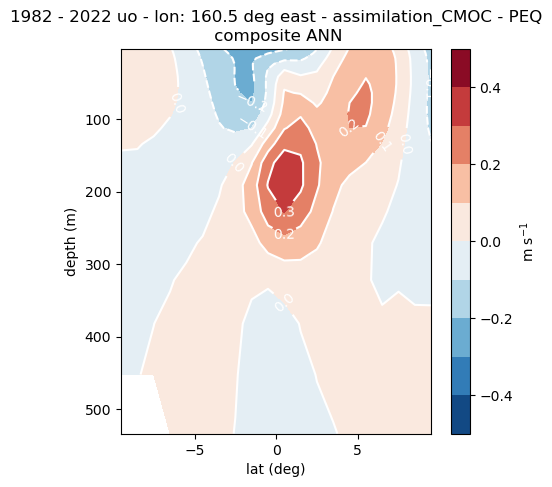

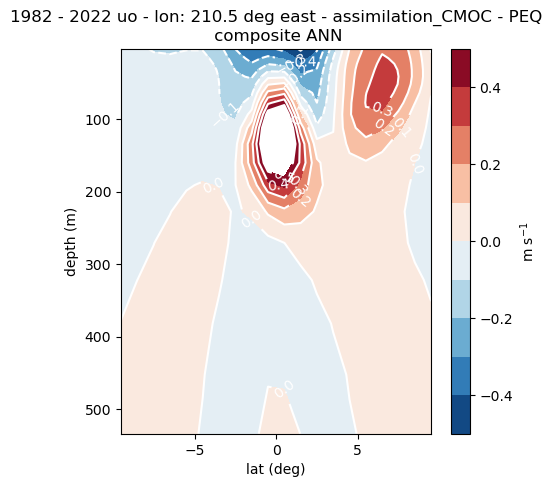

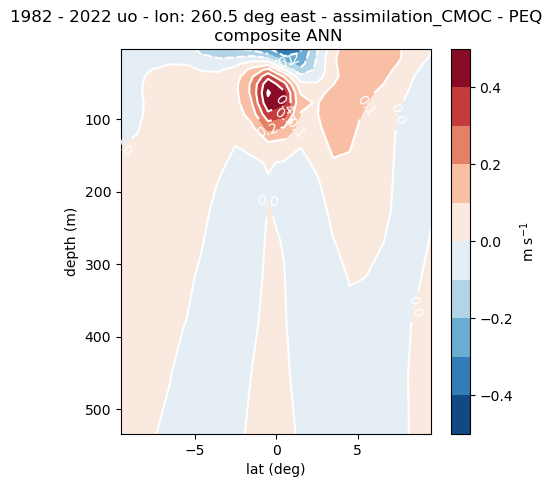

In [54]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['uo'] = dict(dict =dict_profile_EQ['uo'], unit =  units_dics['uo'], contour_levels =np.arange(-5,6) * 1e-1  )
var = 'uo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)




JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


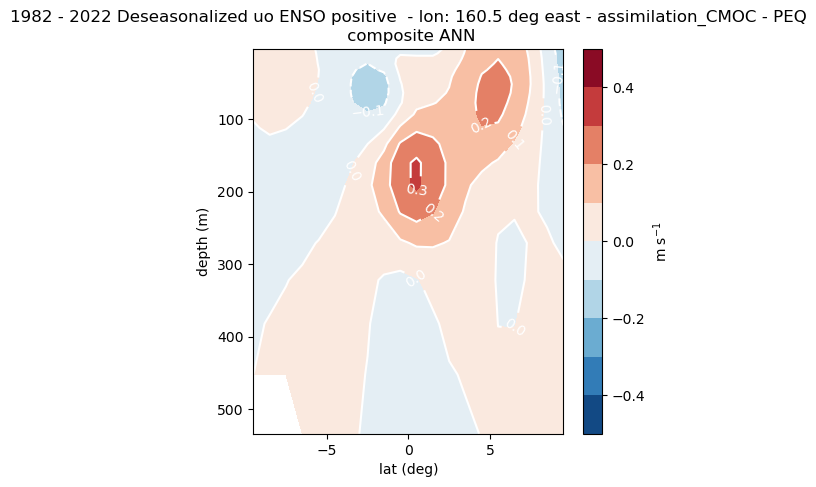

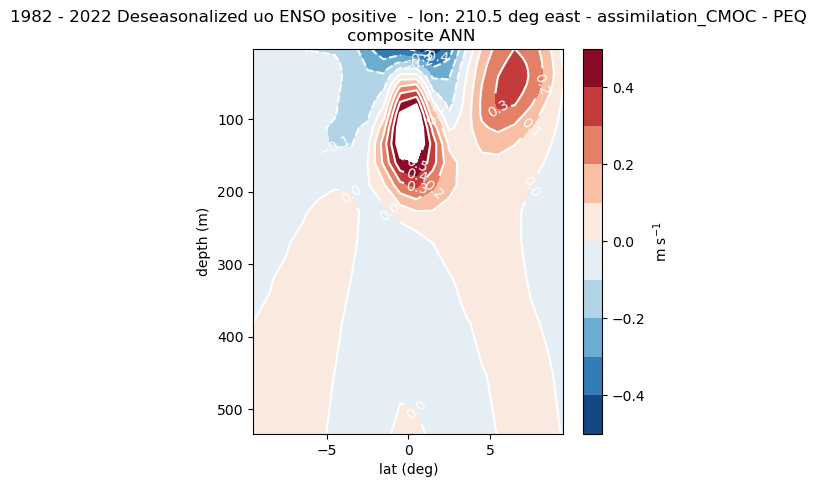

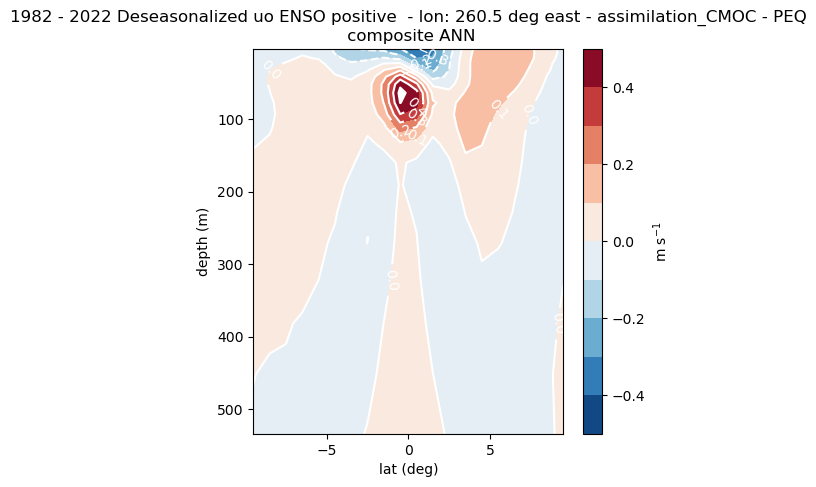

In [56]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['uo'] = dict(dict =data_dicts_ELNI['uo'], unit =  units_dics['uo'], contour_levels =np.arange(-5,6) * 1e-1  )
var = 'uo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO positive '
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)




JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


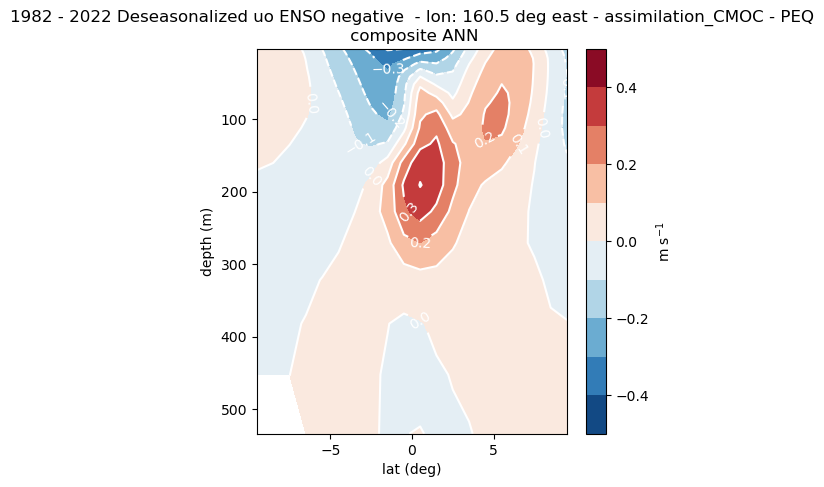

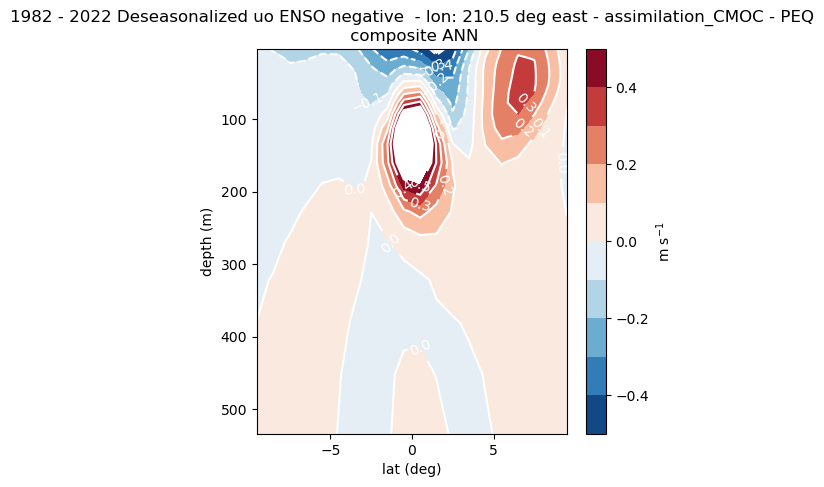

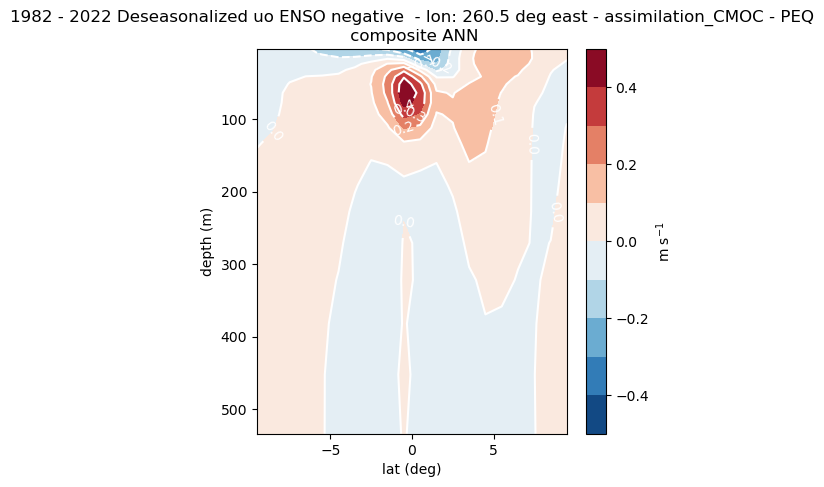

In [55]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['uo'] = dict(dict =data_dicts_LANI['uo'], unit =  units_dics['uo'], contour_levels =np.arange(-5,6) * 1e-1  )
var = 'uo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO negative '
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)




##### obs

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


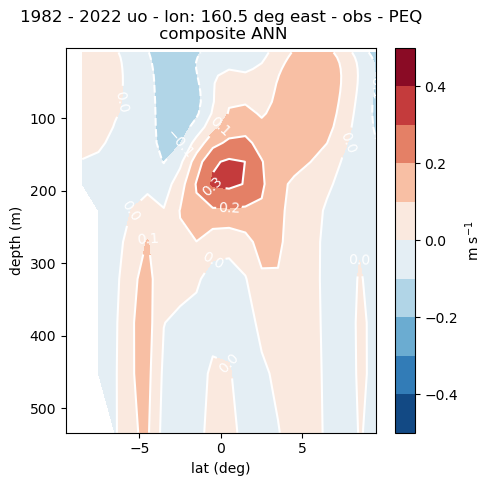

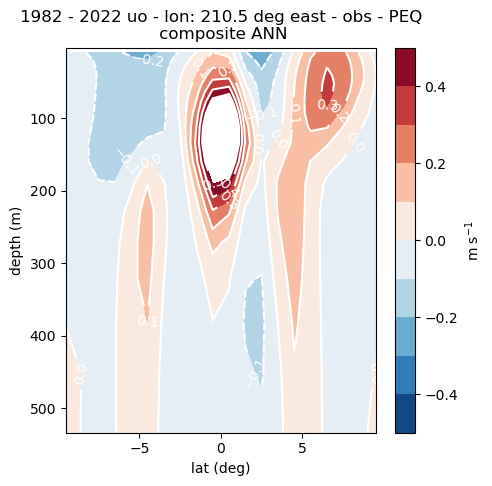

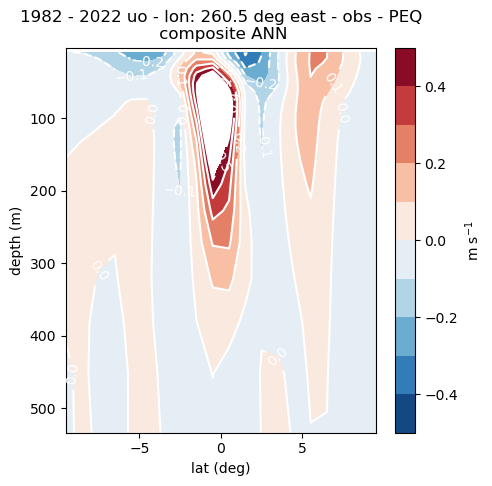

In [57]:
monthly_res = True
ds_list = ['obs']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['uo'] = dict(dict =dict_profile_EQ['uo'], unit =  units_dics['uo'], contour_levels =np.arange(-5,6) * 1e-1  )
var = 'uo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


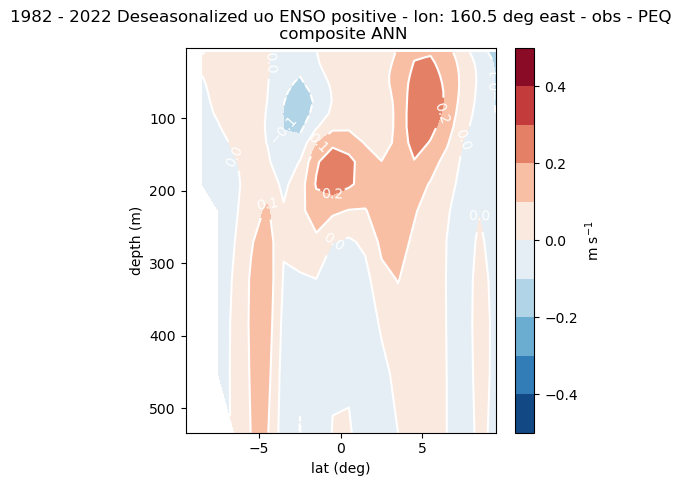

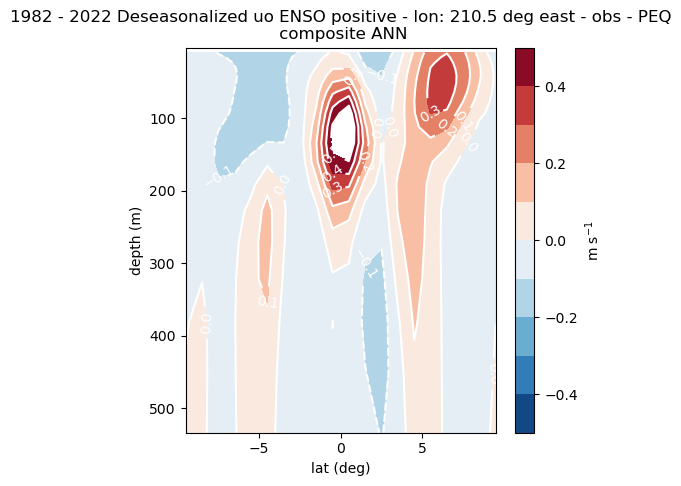

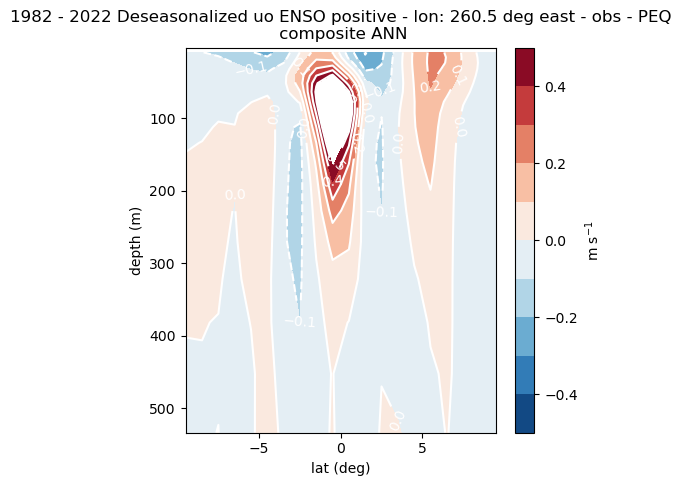

In [58]:
monthly_res = True
ds_list = ['obs']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['uo'] = dict(dict =data_dicts_ELNI['uo'], unit =  units_dics['uo'], contour_levels =np.arange(-5,6) * 1e-1  )
var = 'uo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO positive'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


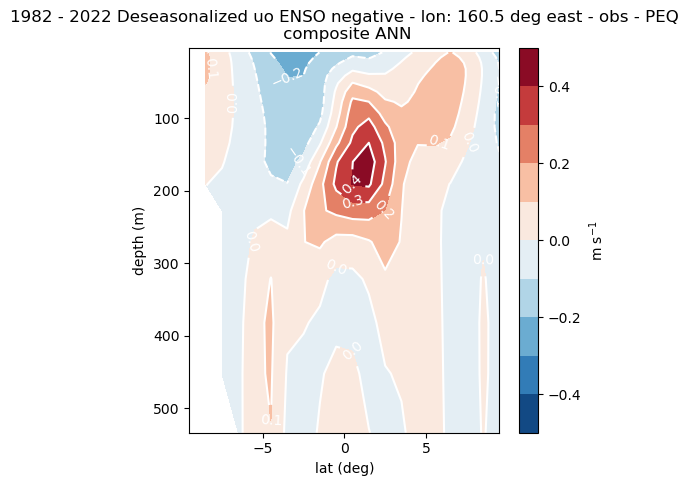

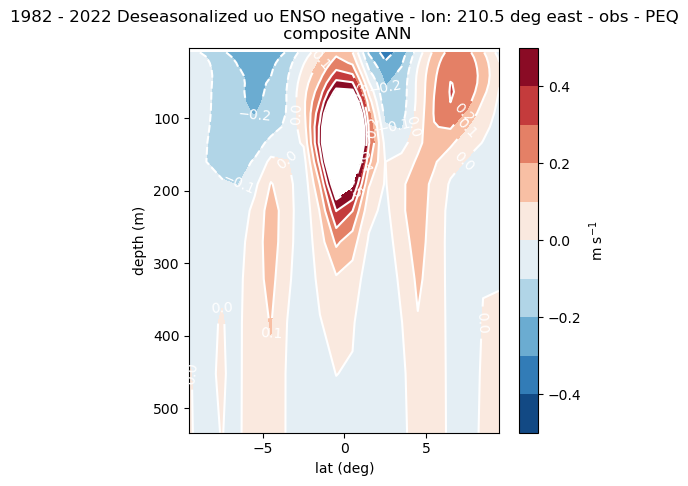

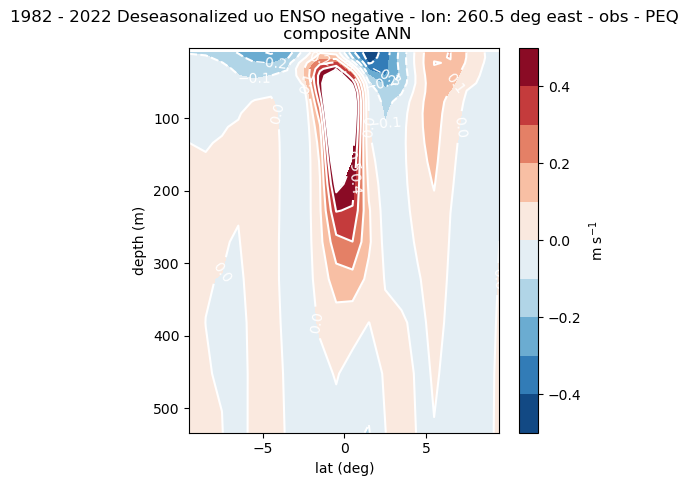

In [59]:
monthly_res = True
ds_list = ['obs']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['uo'] = dict(dict =data_dicts_LANI['uo'], unit =  units_dics['uo'], contour_levels =np.arange(-5,6) * 1e-1  )
var = 'uo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO negative'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### historical

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


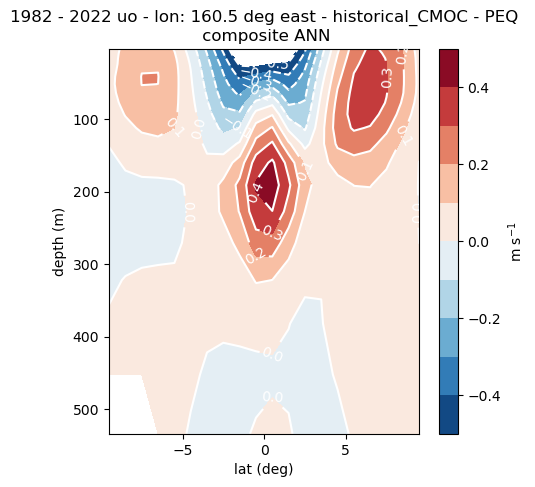

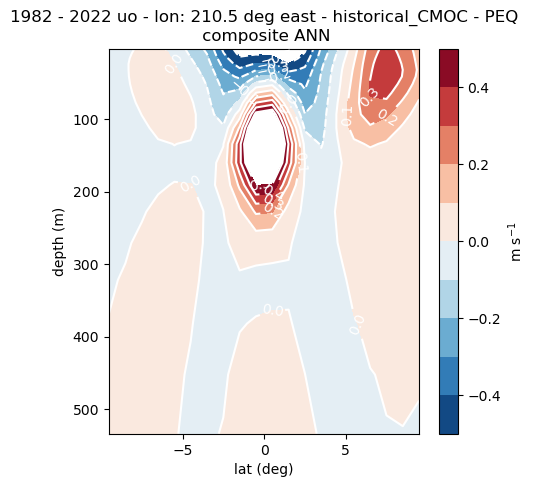

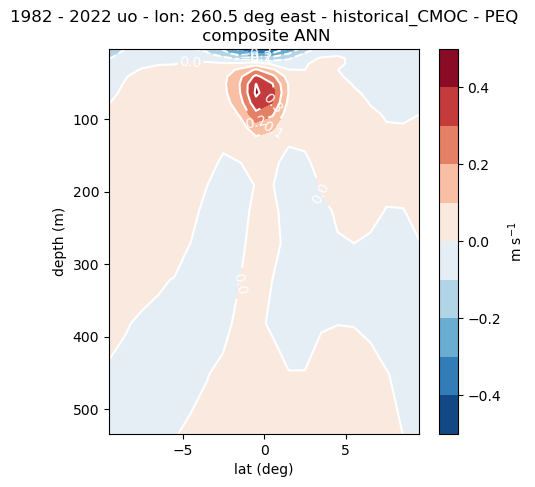

In [60]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['uo'] = dict(dict = dict_profile_EQ['uo'], unit =  units_dics['uo'], contour_levels =np.arange(-5,6) * 1e-1  )
var = 'uo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


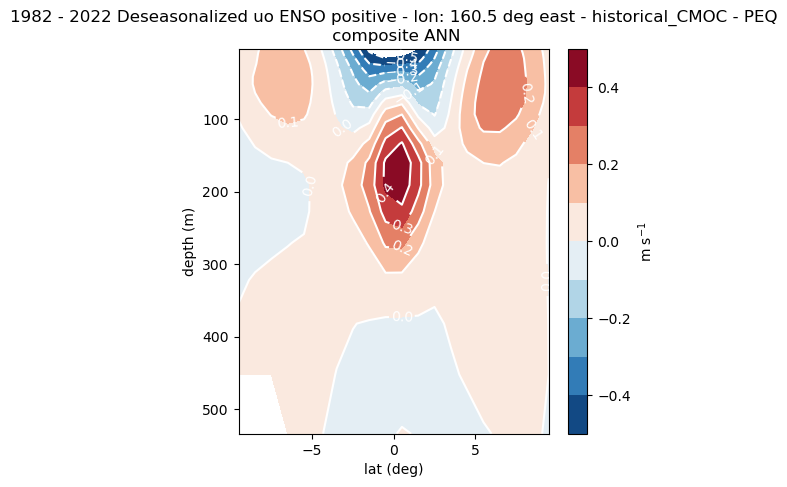

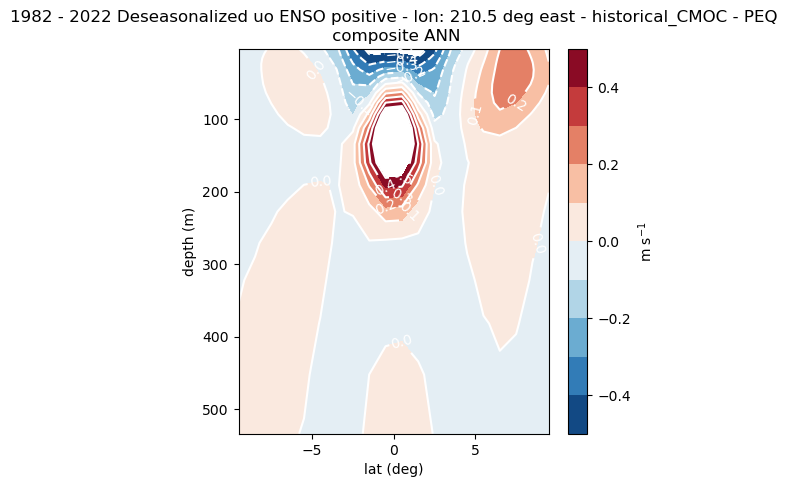

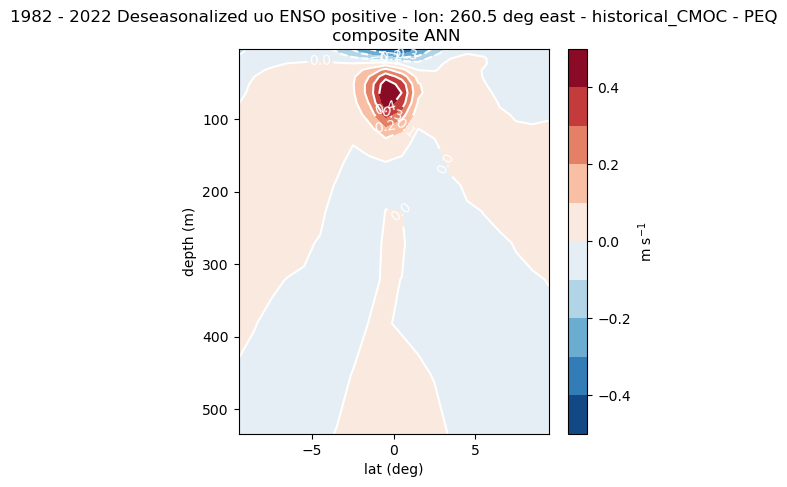

In [61]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['uo'] = dict(dict = data_dicts_ELNI['uo'], unit =  units_dics['uo'], contour_levels =np.arange(-5,6) * 1e-1  )
var = 'uo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO positive'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


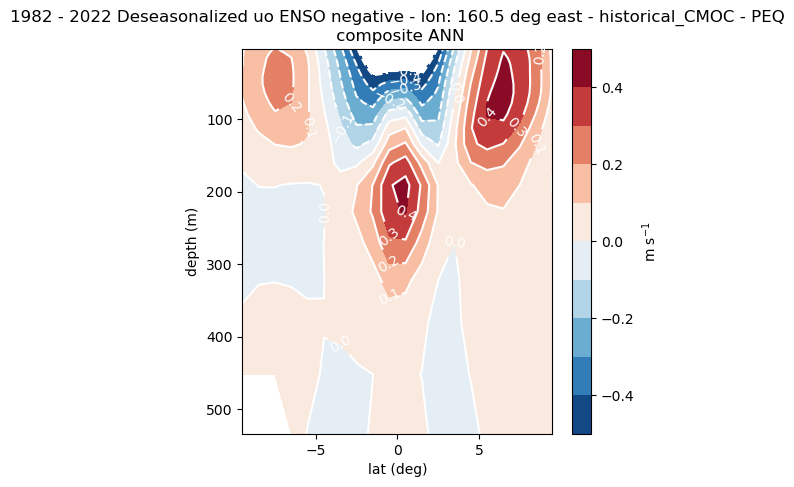

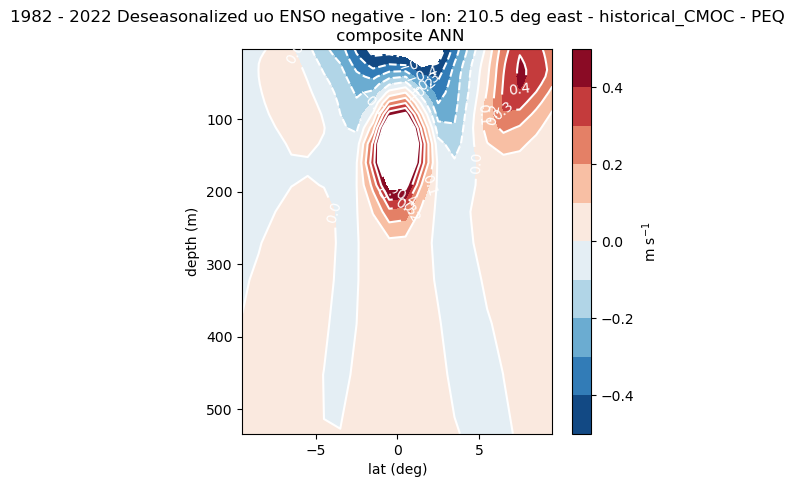

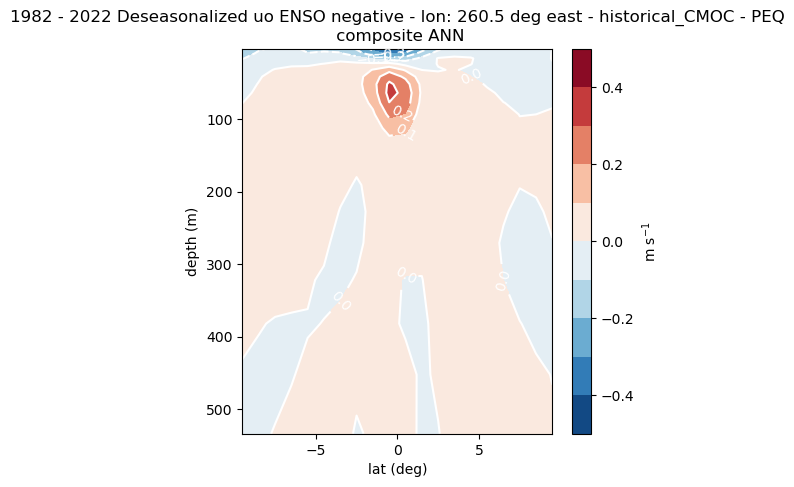

In [62]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['uo'] = dict(dict = data_dicts_LANI['uo'], unit =  units_dics['uo'], contour_levels =np.arange(-5,6) * 1e-1  )
var = 'uo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO negative'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### diffs

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


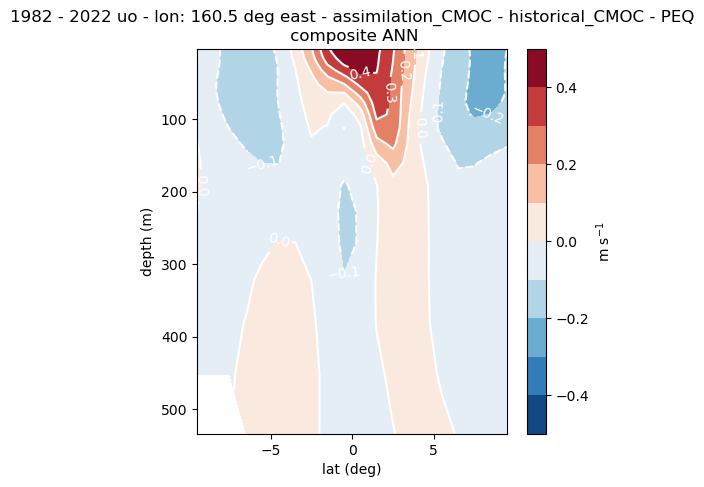

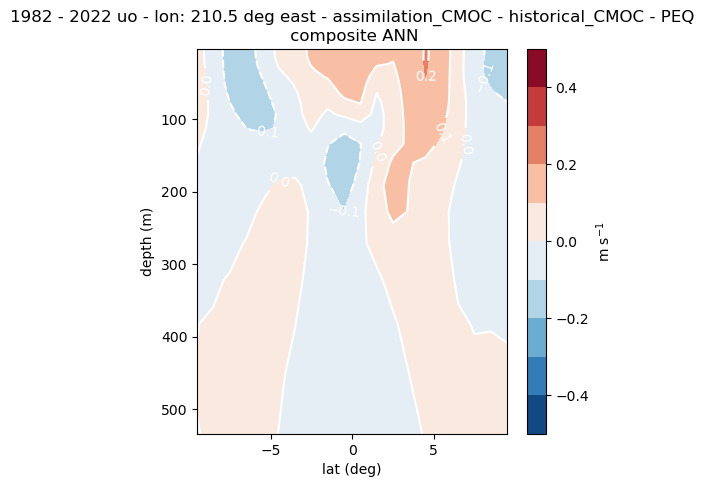

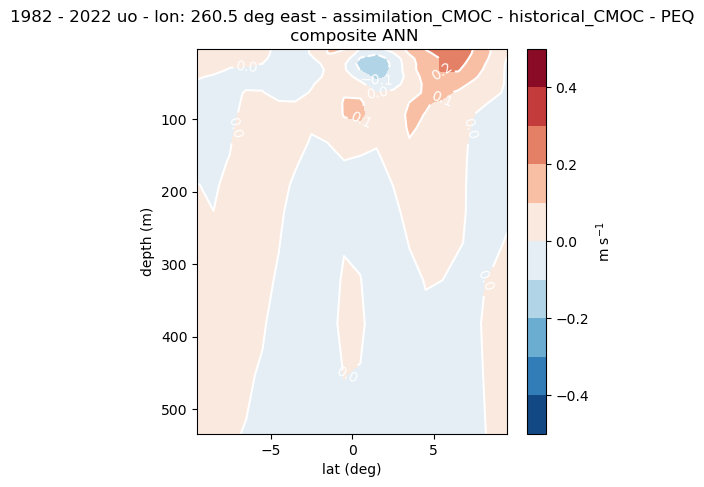

In [69]:
monthly_res = True
ds_list = ['assimilation_CMOC - historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['uo'] = dict(dict = dict_profile_EQ_diff['uo'], unit =  units_dics['uo'], contour_levels =np.arange(-5,6) * 1e-1  )
var = 'uo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


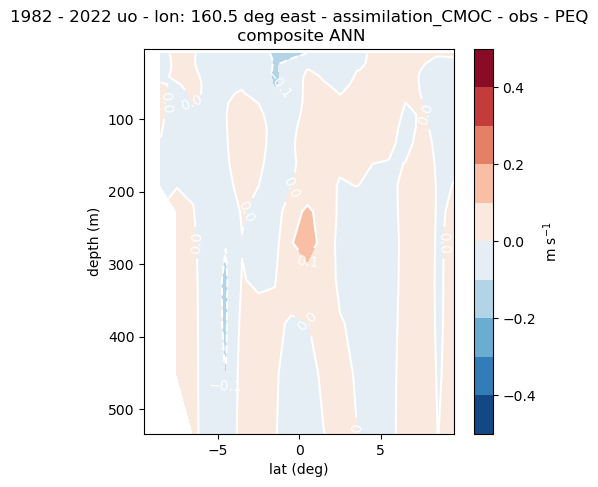

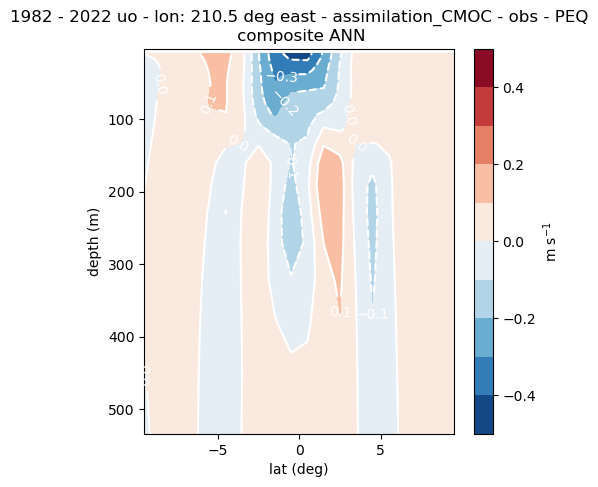

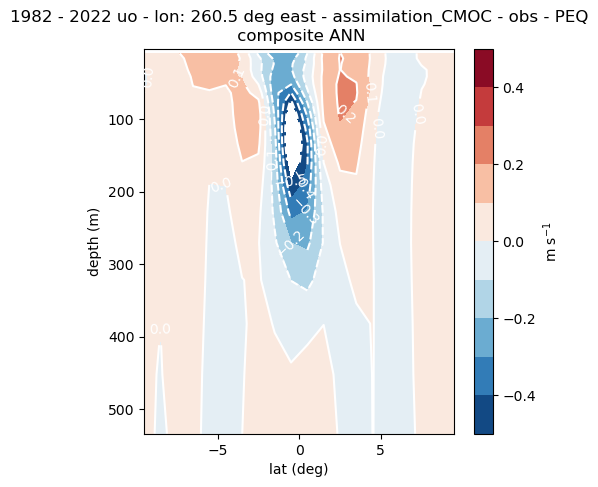

In [70]:
monthly_res = True
ds_list = ['assimilation_CMOC - obs']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['uo'] = dict(dict = dict_profile_EQ_diff['uo'], unit =  units_dics['uo'], contour_levels =np.arange(-5,6) * 1e-1  )
var = 'uo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



#### wo

##### assimilation

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


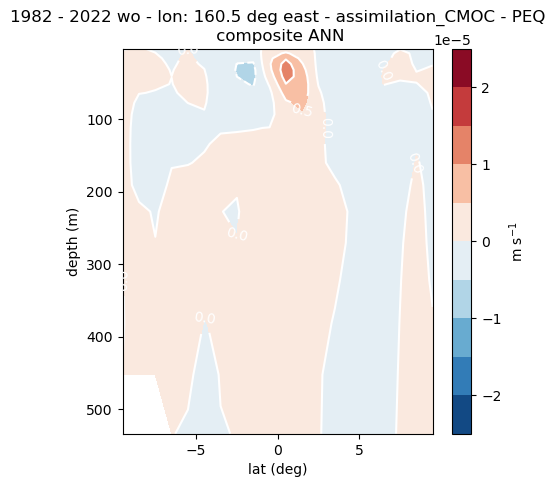

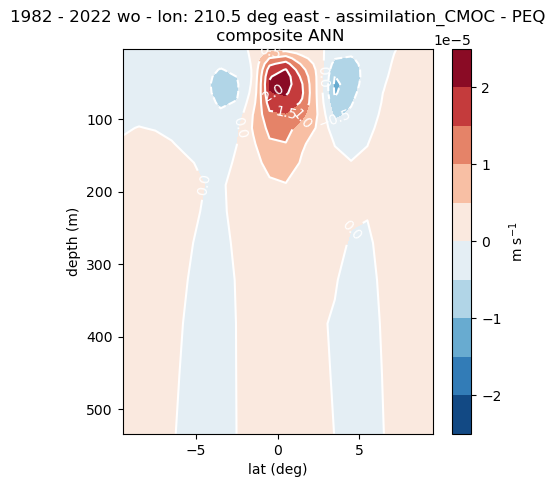

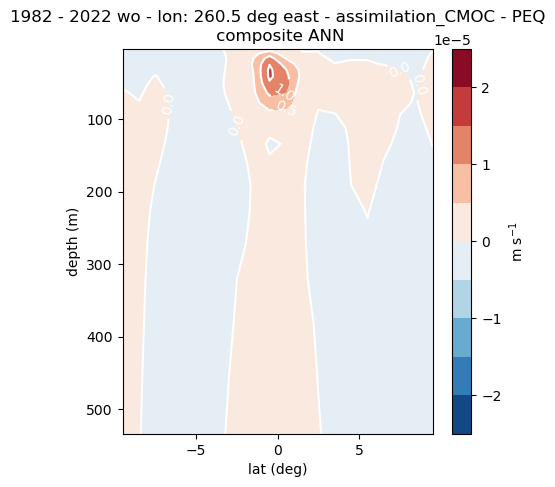

In [63]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4  )
var = 'wo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


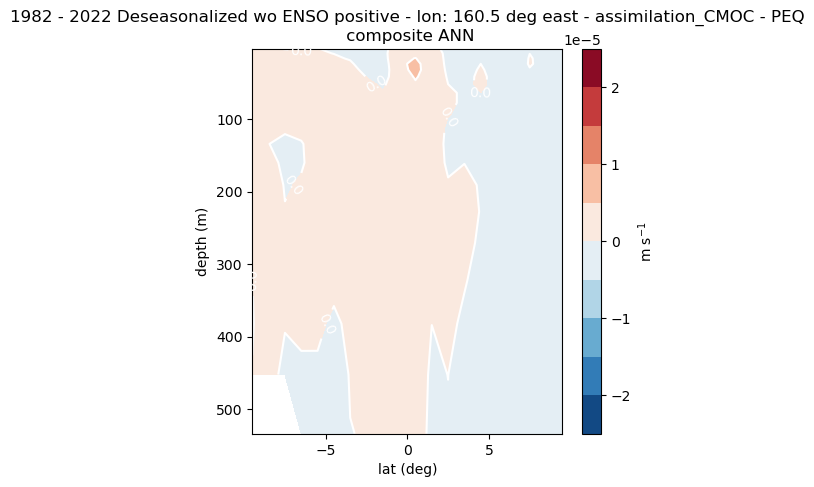

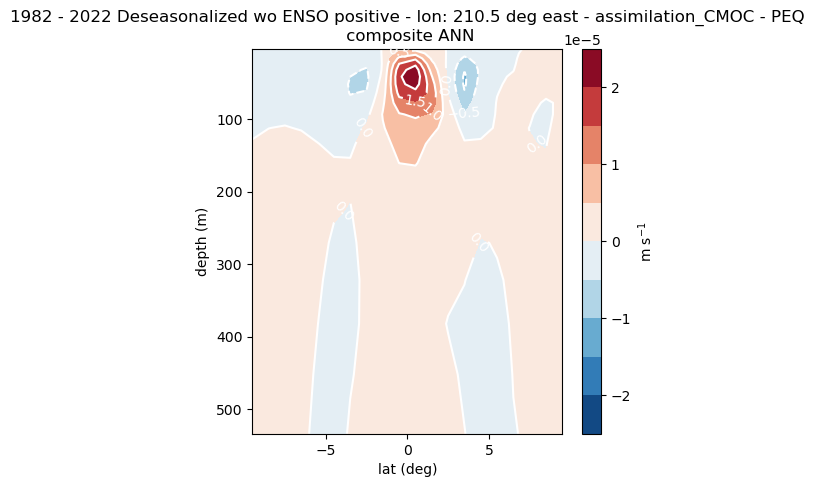

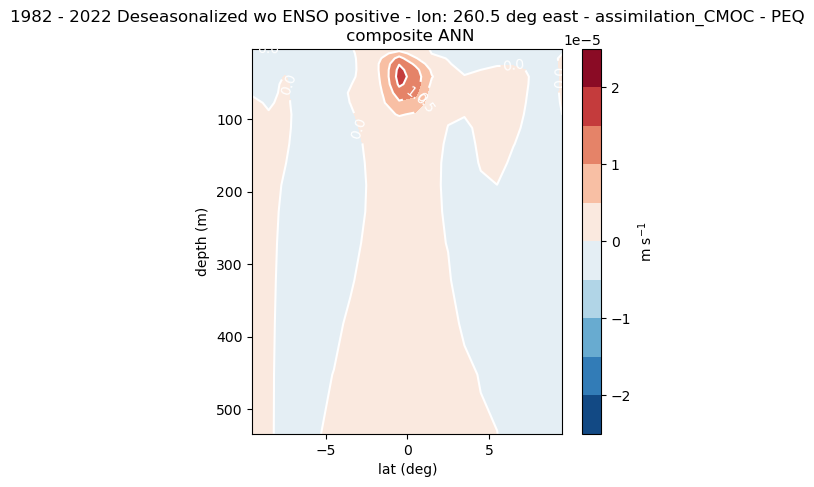

In [64]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_ELNI['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4  )
var = 'wo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO positive'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


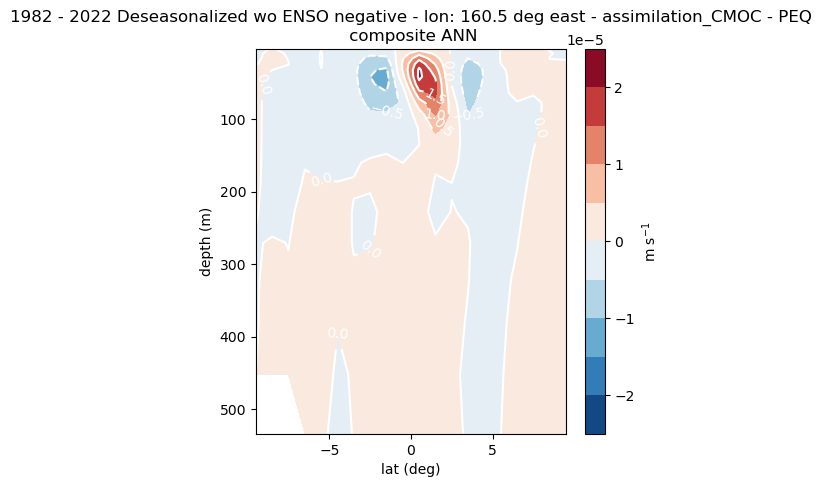

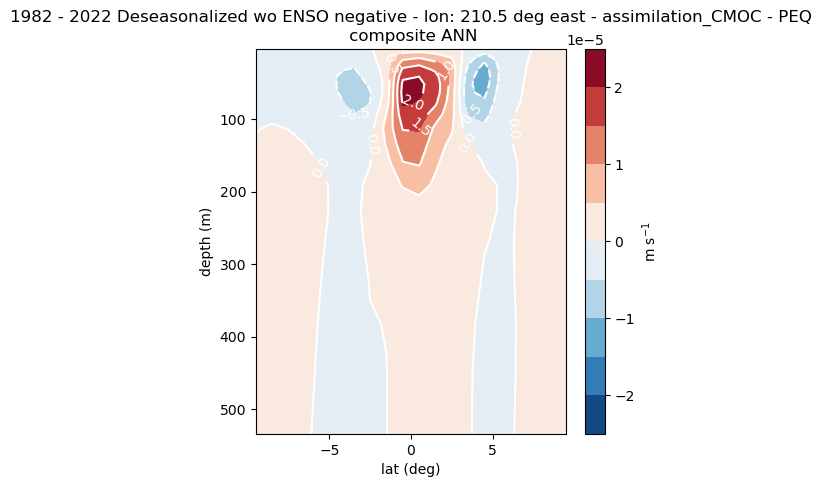

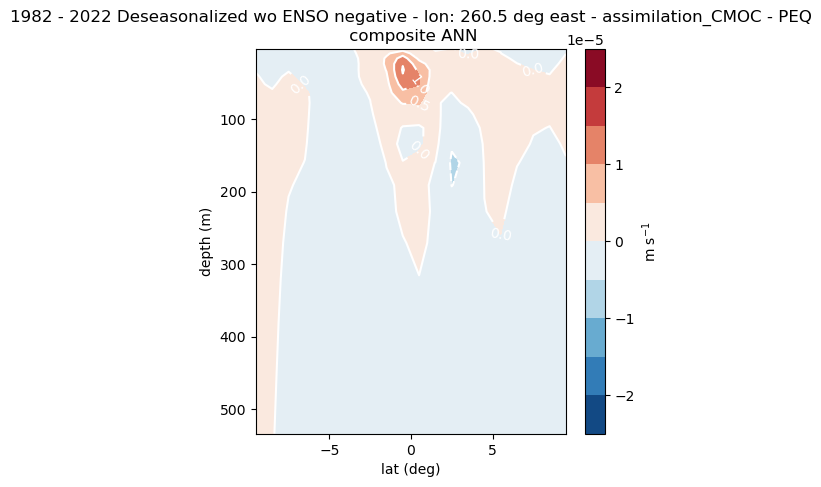

In [65]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_LANI['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4  )
var = 'wo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO negative'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### obs

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


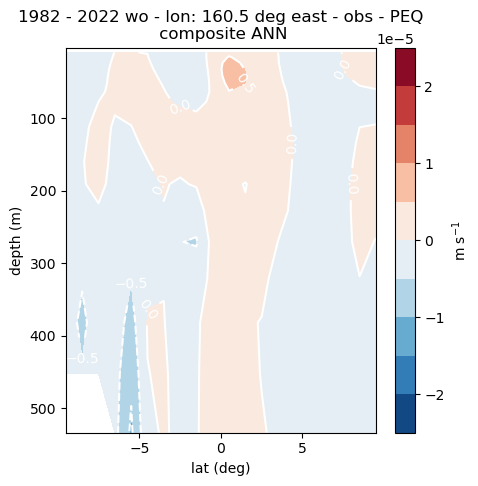

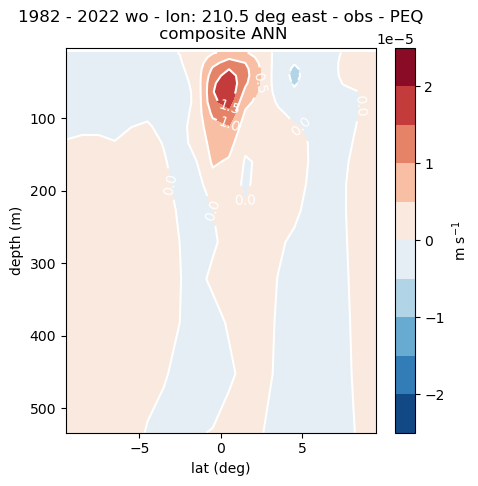

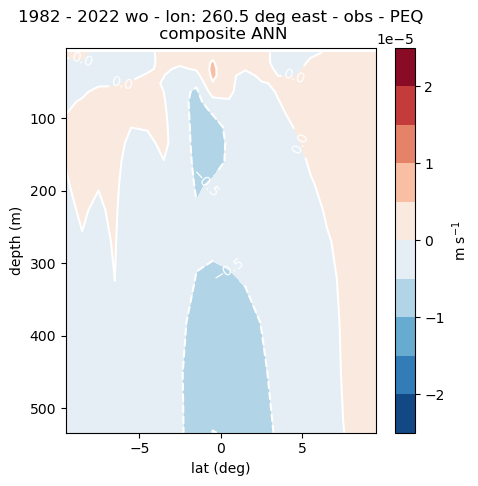

In [66]:
monthly_res = True
ds_list = ['obs']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4  )
var = 'wo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


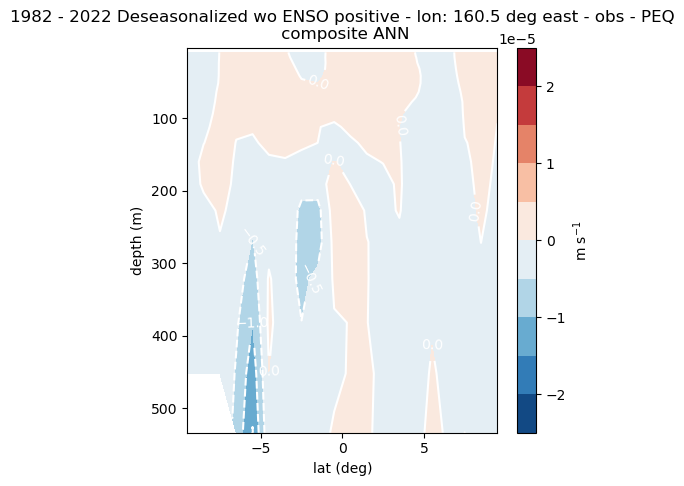

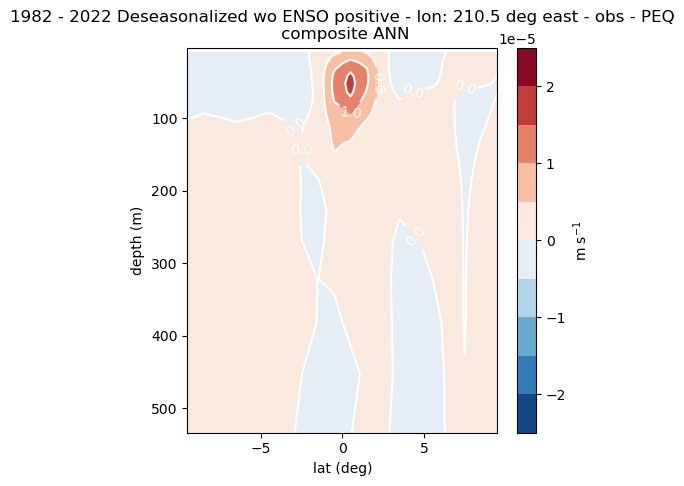

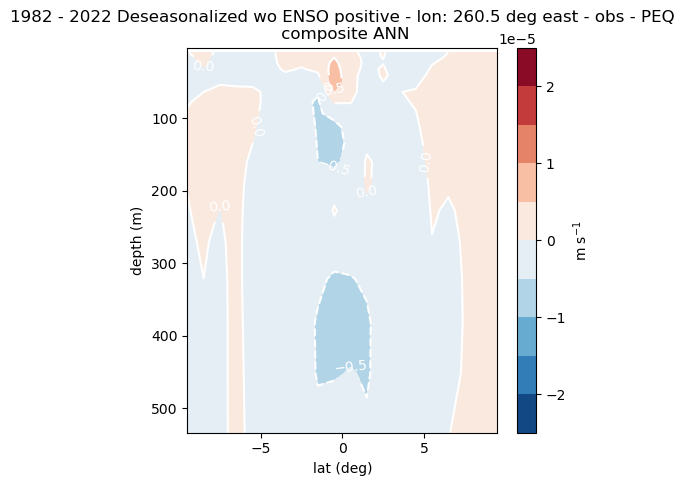

In [67]:
monthly_res = True
ds_list = ['obs']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_ELNI['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4  )
var = 'wo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO positive'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


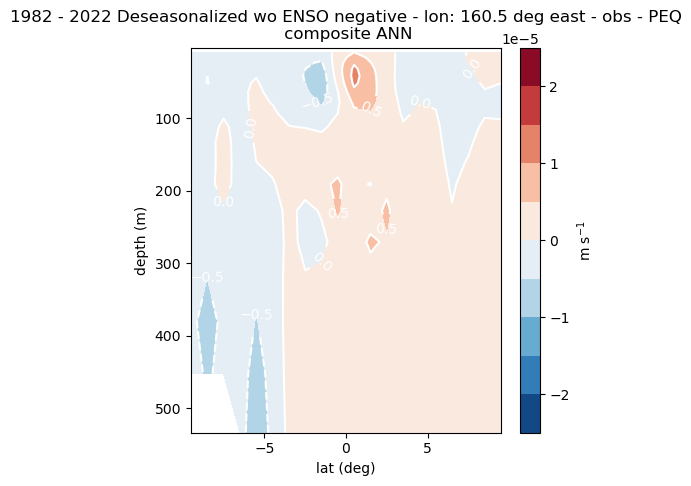

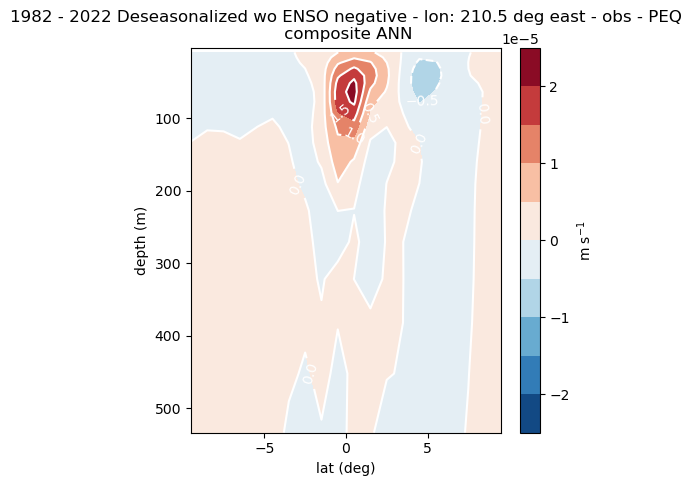

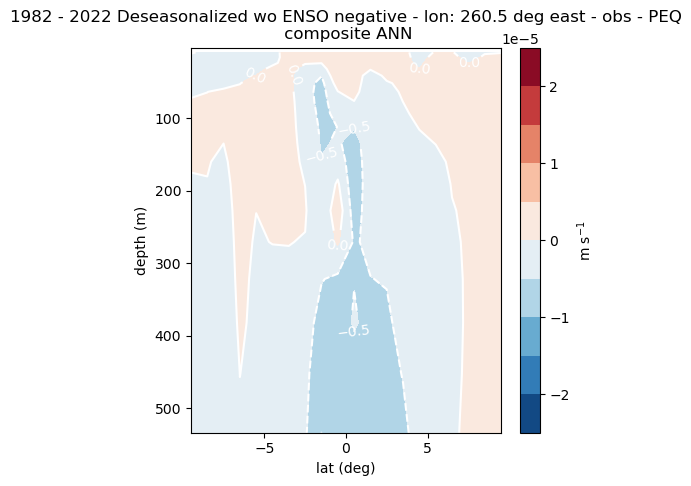

In [68]:
monthly_res = True
ds_list = ['obs']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_LANI['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4  )
var = 'wo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO negative'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### historical

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


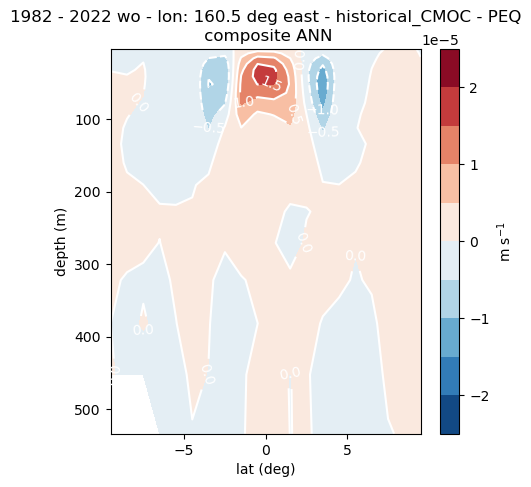

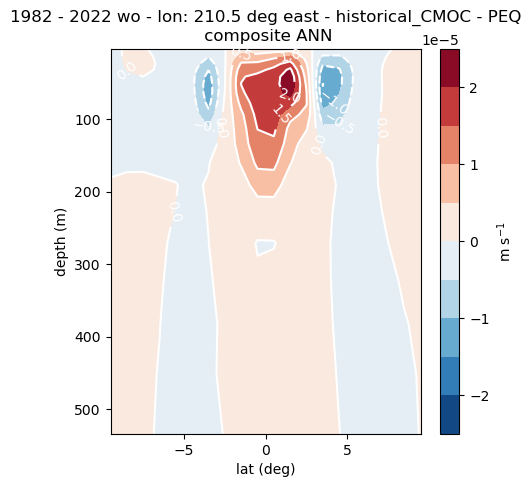

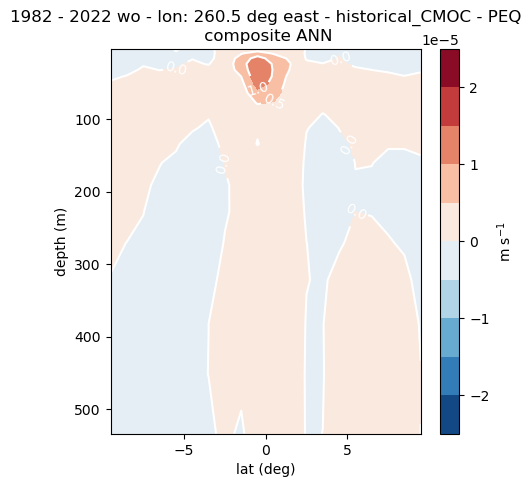

In [69]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4  )
var = 'wo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


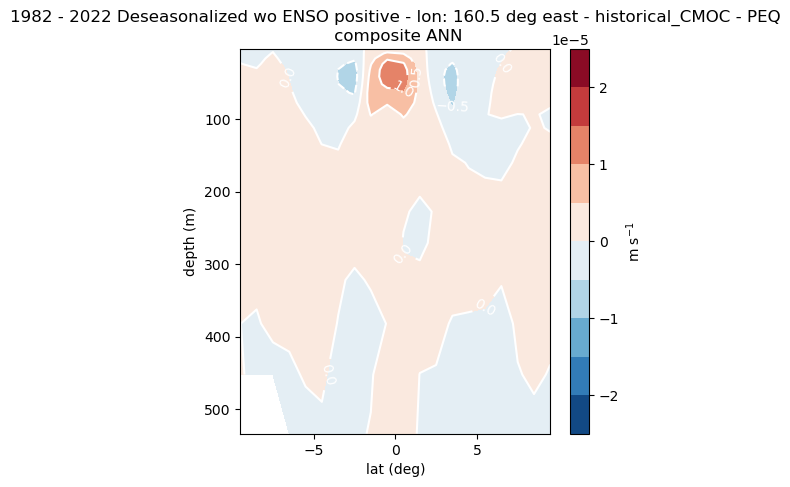

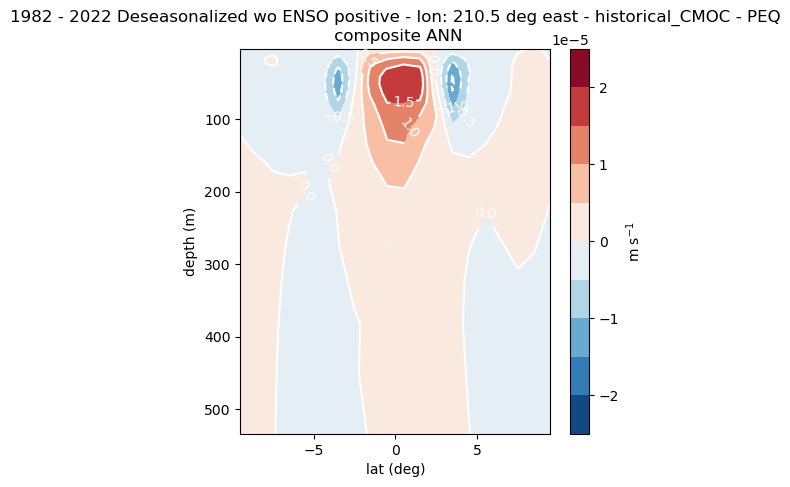

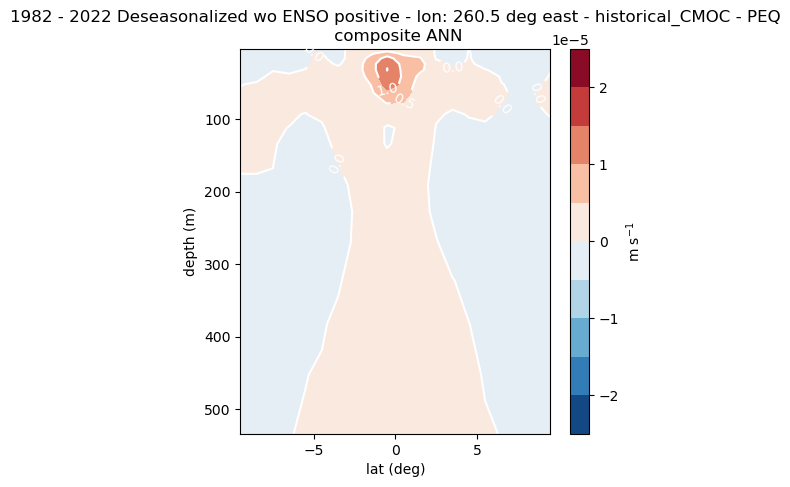

In [70]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_ELNI['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4  )
var = 'wo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO positive'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


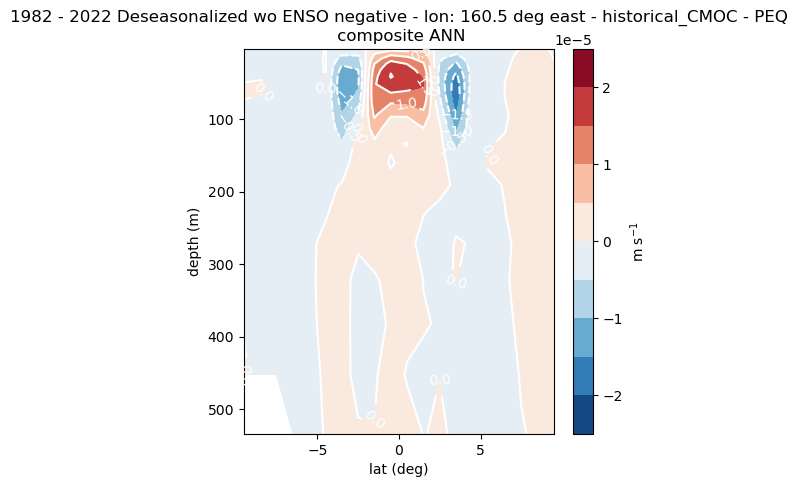

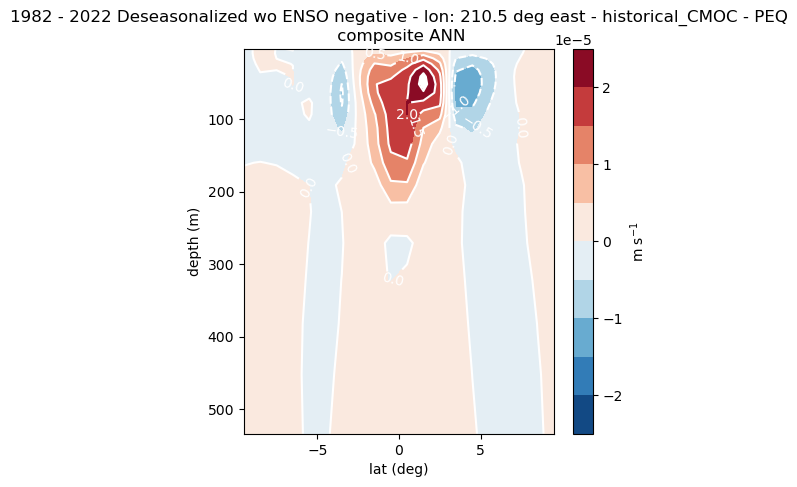

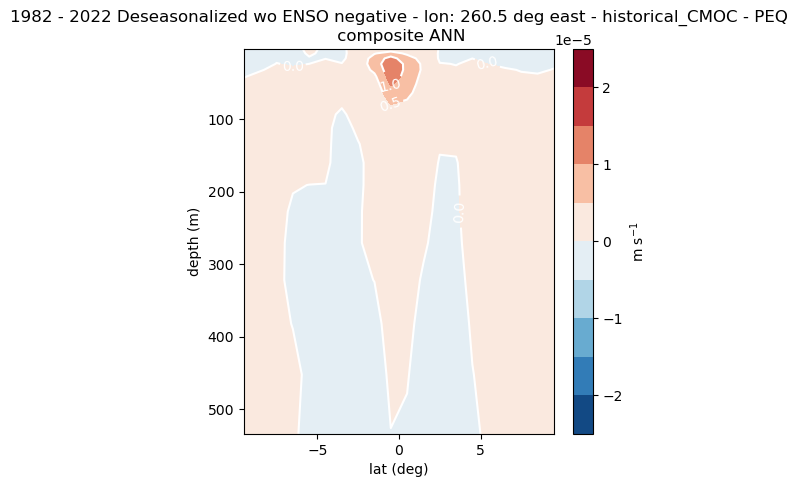

In [71]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = data_dicts_LANI['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4  )
var = 'wo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO negative'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### diffs

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


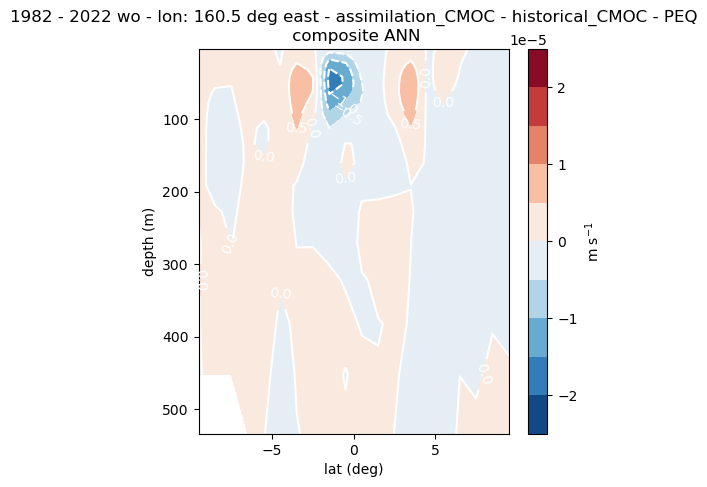

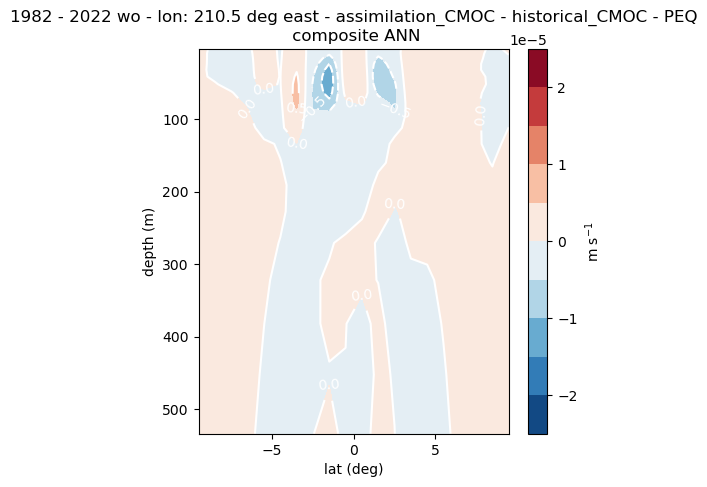

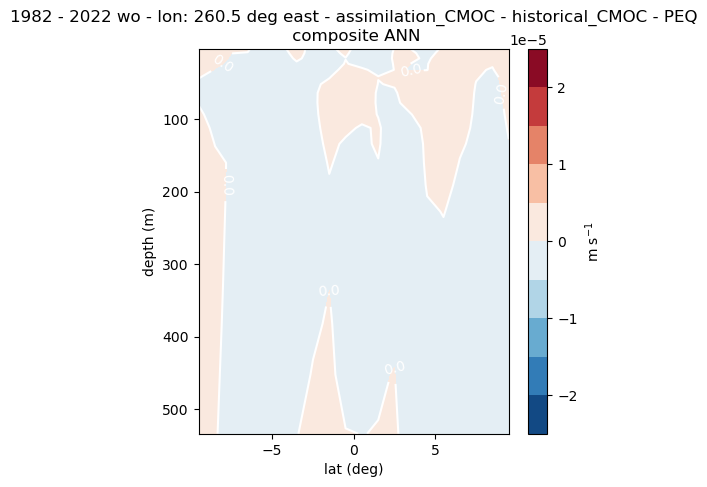

In [74]:
monthly_res = True
ds_list = ['assimilation_CMOC - historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_profile_EQ['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ_diff['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4  )
var = 'wo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


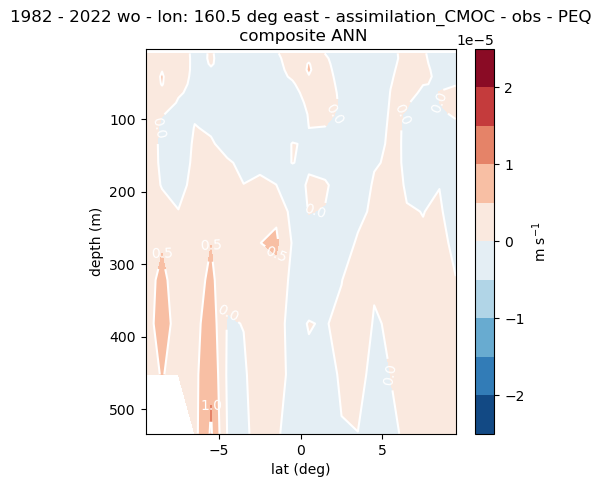

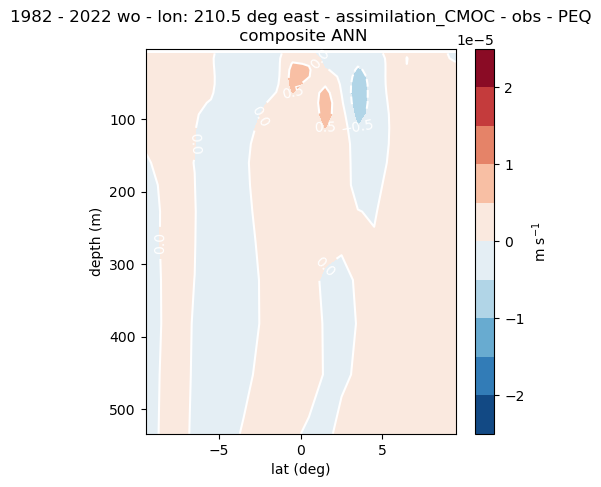

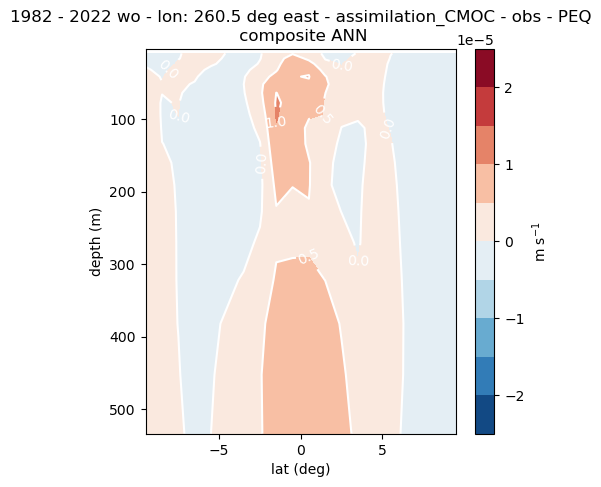

In [75]:
monthly_res = True
ds_list = ['assimilation_CMOC - obs']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_profile_EQ['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ_diff['wo'], unit =  units_dics['wo'], contour_levels = np.arange(-0.25,0.30,0.05)* 1e-4  )
var = 'wo'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



#### Quiver

##### assimilation

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


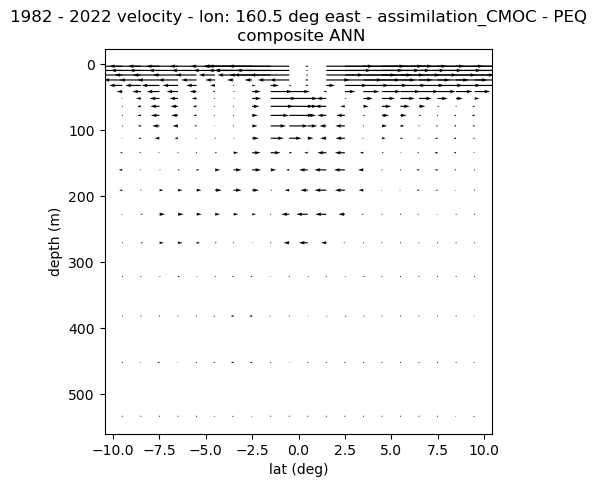

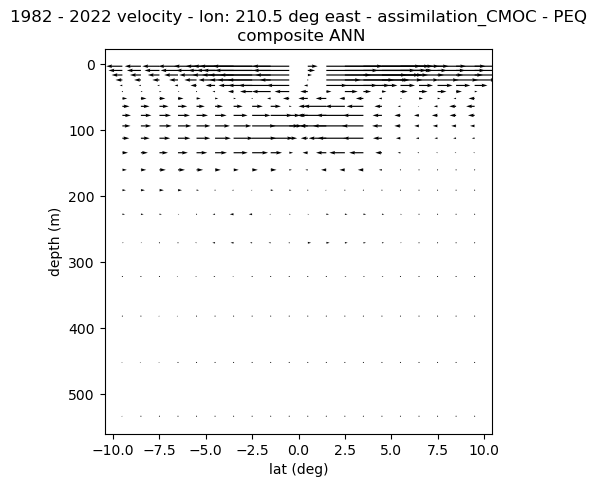

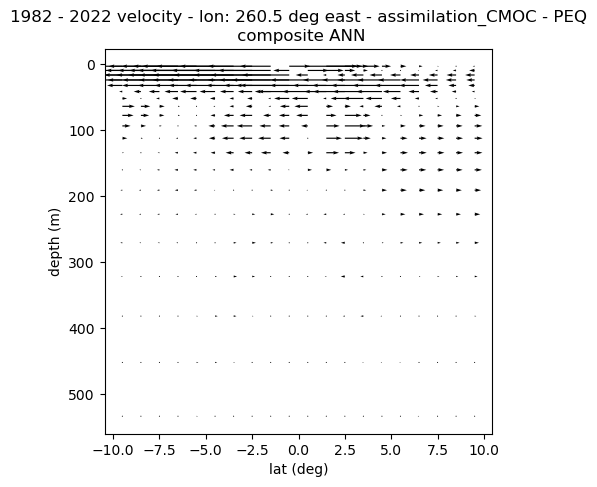

In [102]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = [0,600]
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo']  )
var = 'velocity'
ds_dicts_x = plot_dict['vo']['dict']
ds_dicts_y = plot_dict['wo']['dict']

title = f'{y0_show} - {y1_show} {var}'
units = plot_dict['wo']['unit']


for lon in [160,210,260]:
    snapshot_crossection_quiver(ds_list,
                                ds_dicts_x,
                                ds_dicts_y,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



Scale Factor Y : 1000 
 Scale Factor X : 1 
Scale Factor Y : 1000 
 Scale Factor X : 1 
Scale Factor Y : 1000 
 Scale Factor X : 1 


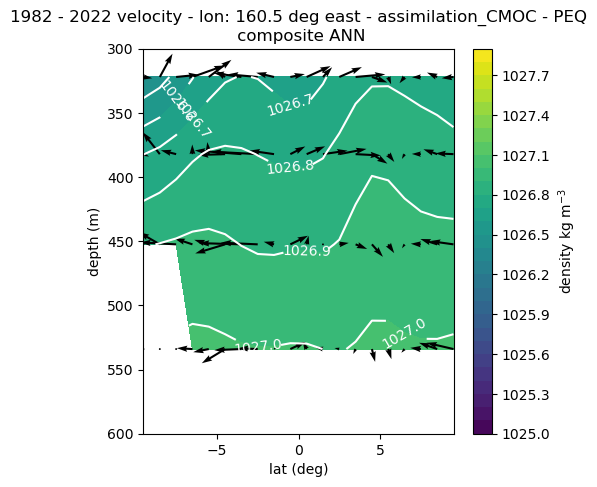

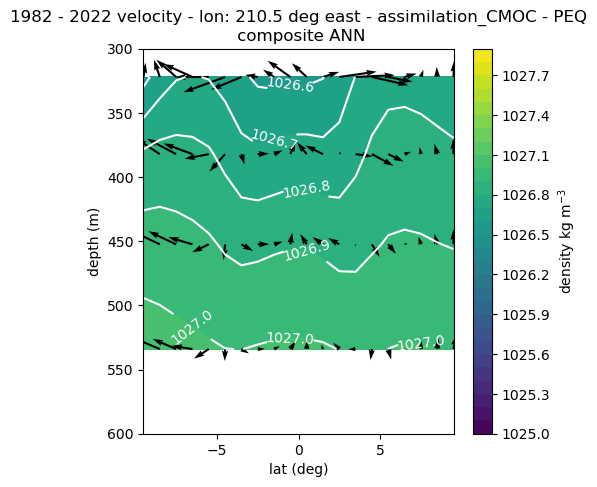

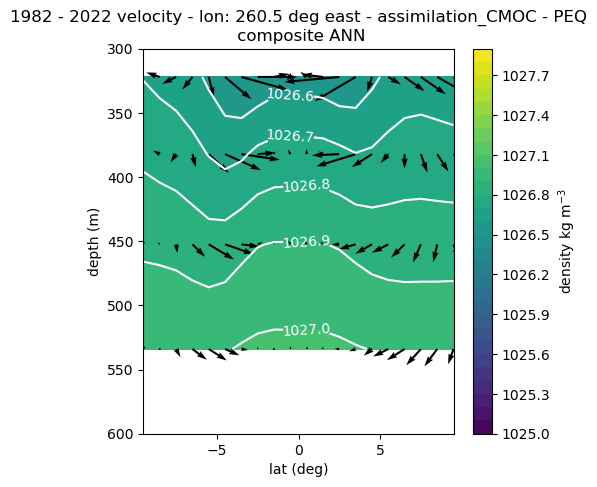

In [85]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = [300,600]
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo']  ) 
var = 'velocity'
ds_dicts_x = plot_dict['vo']['dict']
ds_dicts_y = plot_dict['wo']['dict']

title = f'{y0_show} - {y1_show} {var}'
units = 'density ' +  units_dics['density']


for lon in [160,210,260]:
    snapshot_crossection_quiver(ds_list,
                                ds_dicts_x,
                                ds_dicts_y,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                contour_dict=dict_profile_EQ['density'],
                contour_levels = np.arange(0,3,0.1)+ 1025,
                season = 'ANN',
                lev_range = lev_range,
                show=True,
                scale_factor_Y=1000)



Scale Factor Y : 1000 
 Scale Factor X : 1 
Scale Factor Y : 1000 
 Scale Factor X : 1 
Scale Factor Y : 1000 
 Scale Factor X : 1 


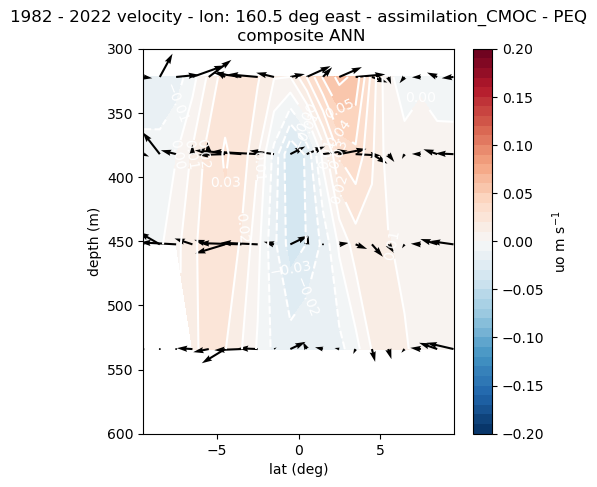

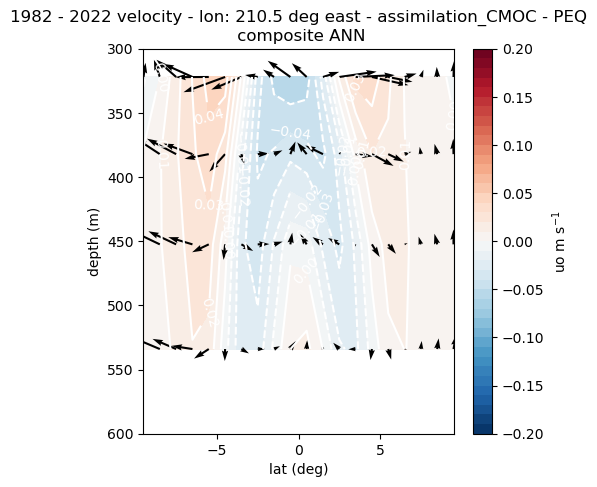

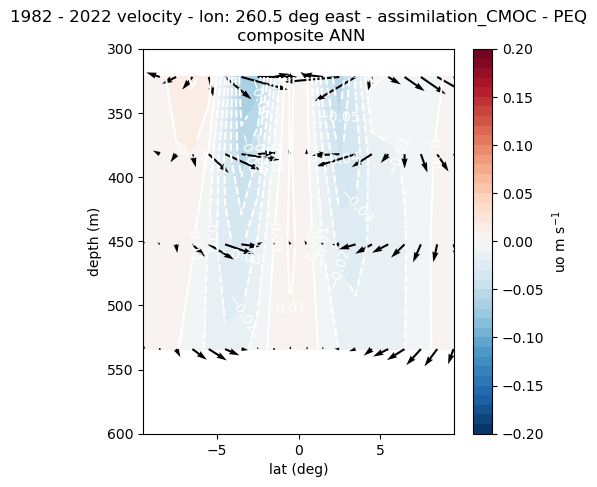

In [88]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = [300,600]
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo']  ) 
var = 'velocity'
ds_dicts_x = plot_dict['vo']['dict']
ds_dicts_y = plot_dict['wo']['dict']

title = f'{y0_show} - {y1_show} {var}'
units = 'uo ' +  units_dics['uo']


for lon in [160,210,260]:
    snapshot_crossection_quiver(ds_list,
                                ds_dicts_x,
                                ds_dicts_y,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                contour_dict=dict_profile_EQ['uo'],
                contour_levels = np.arange(-20,21) * 1e-2,
                season = 'ANN',
                lev_range = lev_range,
                show=True,
                scale_factor_Y=1000)



##### obs

Scale Factor Y : 1 
 Scale Factor X : 1 
Scale Factor Y : 1 
 Scale Factor X : 1 
Scale Factor Y : 1 
 Scale Factor X : 1 


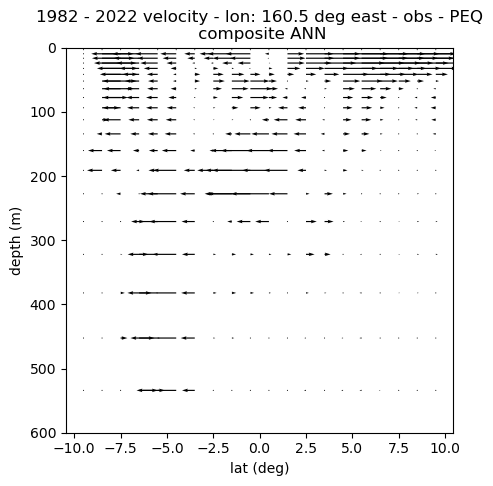

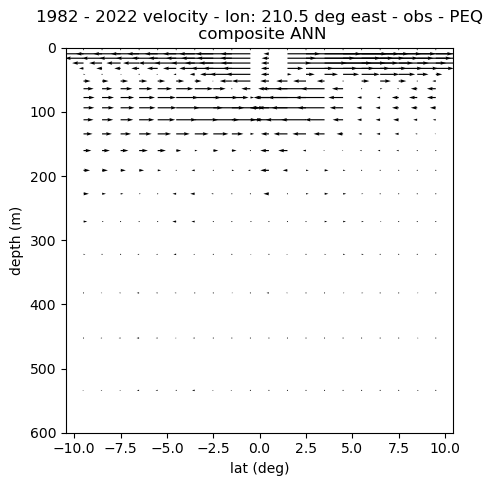

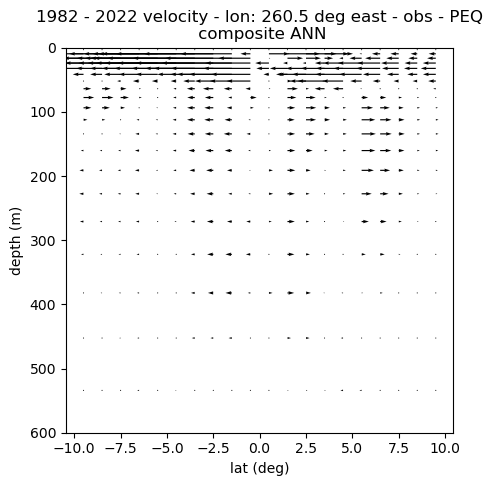

In [78]:
monthly_res = True
ds_list = ['obs']
figsize = (5,5)

lev_range = [0,600]
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'] , unit =  units_dics['wo'] ) 
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo']  )

var = 'velocity'
ds_dicts_x = plot_dict['vo']['dict']
ds_dicts_y = plot_dict['wo']['dict']


title = f'{y0_show} - {y1_show} {var}'
units = plot_dict['wo']['unit']


for lon in [160,210,260]:
    snapshot_crossection_quiver(ds_list,
                                ds_dicts_x,
                                ds_dicts_y,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                # contour_dict=dict_profile_EQ['density'],
                # contour_levels = np.arange(0,10,0.25)+ 1020,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



Scale Factor Y : 1000 
 Scale Factor X : 1 
Scale Factor Y : 1000 
 Scale Factor X : 1 
Scale Factor Y : 1000 
 Scale Factor X : 1 


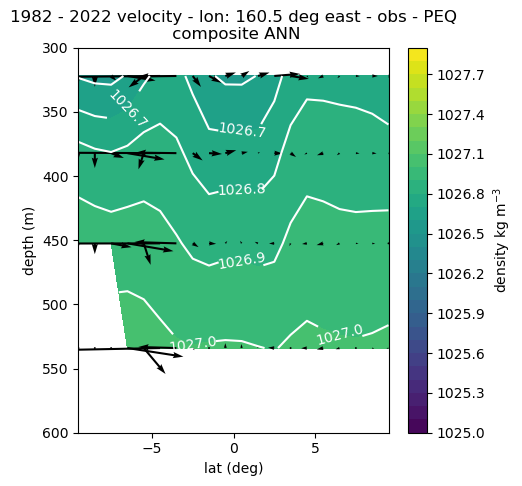

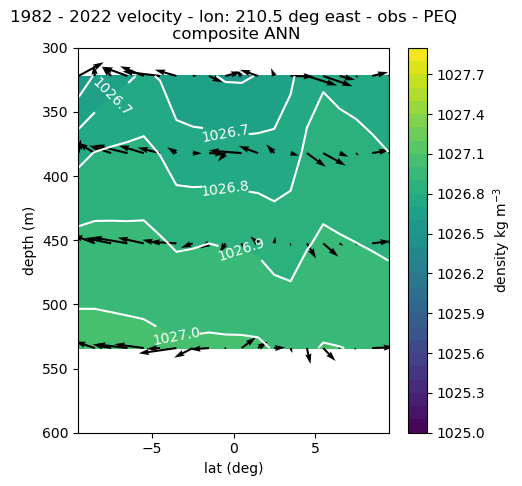

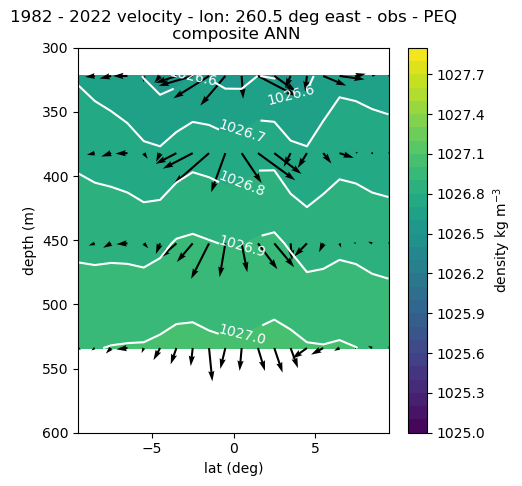

In [76]:
monthly_res = True
ds_list = ['obs']
figsize = (5,5)

lev_range = [300,600]
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo']  )
var = 'velocity'
ds_dicts_x = plot_dict['vo']['dict']
ds_dicts_y = plot_dict['wo']['dict']

title = f'{y0_show} - {y1_show} {var}'
units = 'density ' + units_dics['density']


for lon in [160,210,260]:
    snapshot_crossection_quiver(ds_list,
                                ds_dicts_x,
                                ds_dicts_y,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                contour_dict=dict_profile_EQ['density'],
                contour_levels = np.arange(0,3,0.1)+ 1025,
                season = 'ANN',
                lev_range = lev_range,
                show=True,
                scale_factor_Y = 1000)



Scale Factor Y : 1000 
 Scale Factor X : 1 
Scale Factor Y : 1000 
 Scale Factor X : 1 
Scale Factor Y : 1000 
 Scale Factor X : 1 


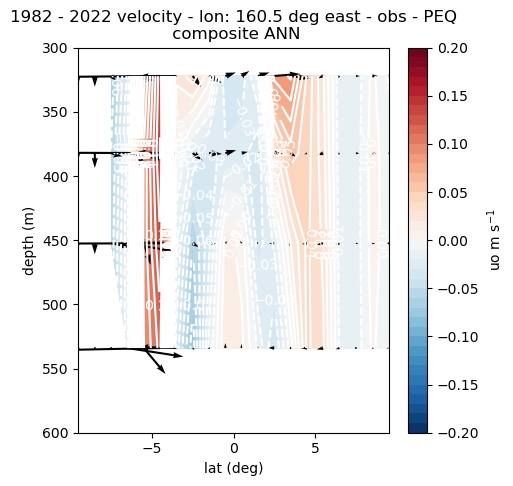

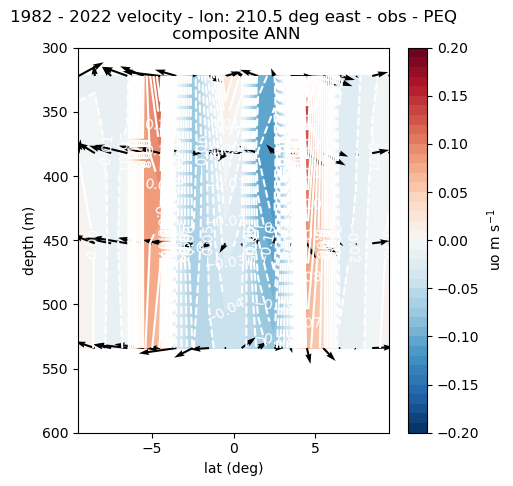

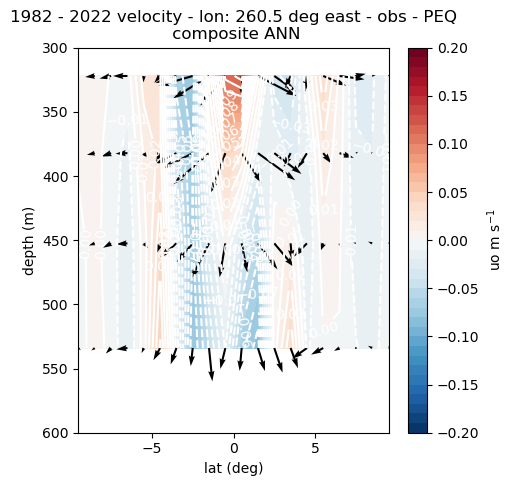

In [82]:
monthly_res = True
ds_list = ['obs']
figsize = (5,5)

lev_range = [300,600]
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo']  )
var = 'velocity'
ds_dicts_x = plot_dict['vo']['dict']
ds_dicts_y = plot_dict['wo']['dict']

title = f'{y0_show} - {y1_show} {var}'
units = 'uo ' +  units_dics['uo']


for lon in [160,210,260]:
    snapshot_crossection_quiver(ds_list,
                                ds_dicts_x,
                                ds_dicts_y,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                contour_dict=dict_profile_EQ['uo'],
                contour_levels = np.arange(-20,21) * 1e-2,
                season = 'ANN',
                lev_range = lev_range,
                show=True,
                scale_factor_Y = 1000)



##### historical

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


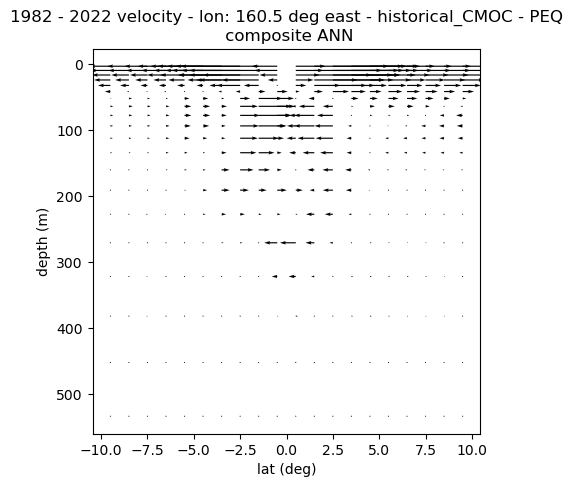

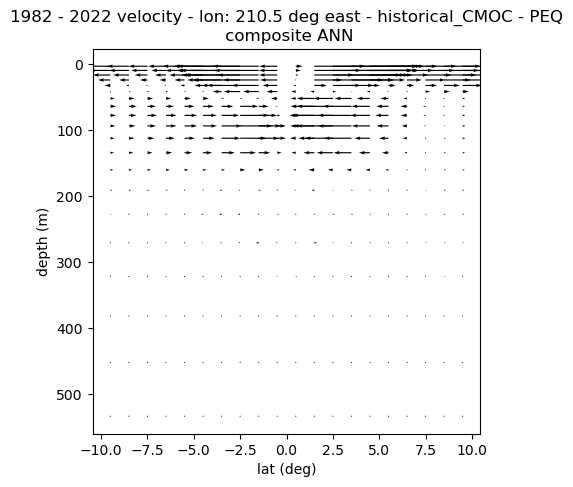

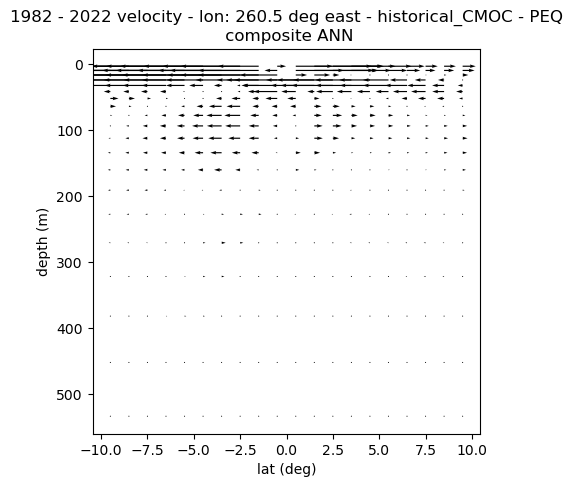

In [38]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = [0,600]
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo']  )
var = 'velocity'
ds_dicts_x = plot_dict['vo']['dict']
ds_dicts_y = plot_dict['wo']['dict']

title = f'{y0_show} - {y1_show} {var}'
units = plot_dict['wo']['unit']


for lon in [160,210,260]:
    snapshot_crossection_quiver(ds_list,
                                ds_dicts_x,
                                ds_dicts_y,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                # lev_interp = lev_interp,
                # contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



Scale Factor Y : 1000 
 Scale Factor X : 1 
Scale Factor Y : 1000 
 Scale Factor X : 1 
Scale Factor Y : 1000 
 Scale Factor X : 1 


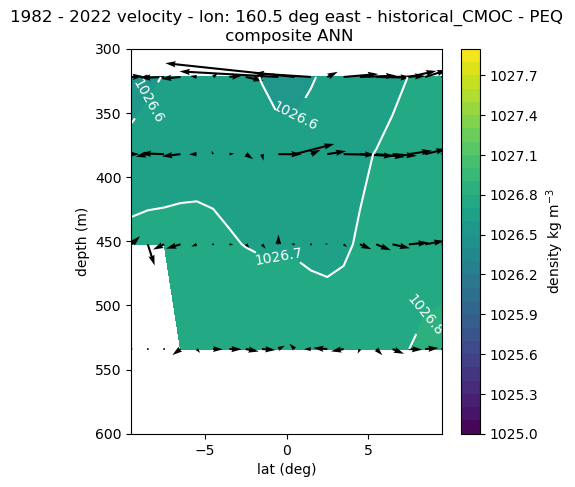

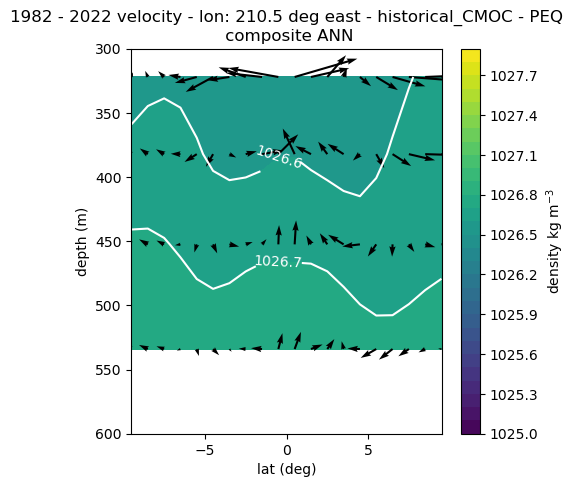

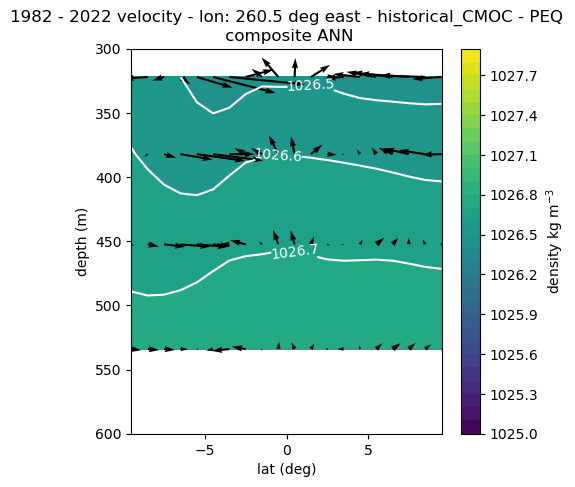

In [83]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = [300,600]
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo']  )
var = 'velocity'
ds_dicts_x = plot_dict['vo']['dict']
ds_dicts_y = plot_dict['wo']['dict']

title = f'{y0_show} - {y1_show} {var}'
units = 'density ' +  units_dics['density']


for lon in [160,210,260]:
    snapshot_crossection_quiver(ds_list,
                                ds_dicts_x,
                                ds_dicts_y,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                contour_dict=dict_profile_EQ['density'],
                contour_levels = np.arange(0,3,0.1)+ 1025,
                season = 'ANN',
                lev_range = lev_range,
                show=True, 
                scale_factor_Y=1000)



Scale Factor Y : 1000 
 Scale Factor X : 1 
Scale Factor Y : 1000 
 Scale Factor X : 1 
Scale Factor Y : 1000 
 Scale Factor X : 1 


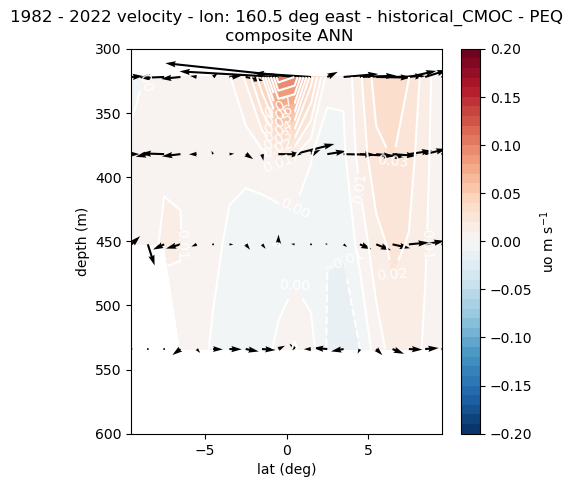

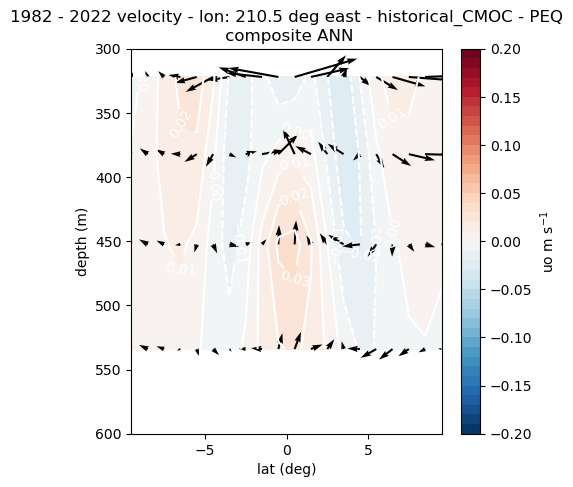

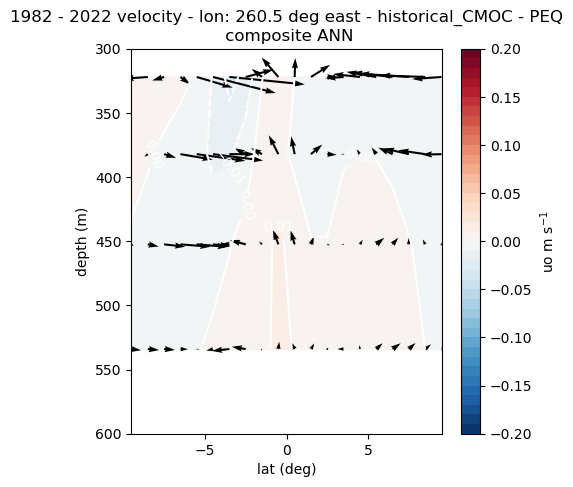

In [84]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = [300,600]
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['wo'] = dict(dict = dict_profile_EQ['wo'], unit =  units_dics['wo'] )
plot_dict['vo'] = dict(dict = dict_profile_EQ['vo'], unit =  units_dics['vo']  )
var = 'velocity'
ds_dicts_x = plot_dict['vo']['dict']
ds_dicts_y = plot_dict['wo']['dict']

title = f'{y0_show} - {y1_show} {var}'
units = 'uo ' +  units_dics['uo']


for lon in [160,210,260]:
    snapshot_crossection_quiver(ds_list,
                                ds_dicts_x,
                                ds_dicts_y,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                contour_dict=dict_profile_EQ['uo'],
                contour_levels = np.arange(-20,21) * 1e-2,
                season = 'ANN',
                lev_range = lev_range,
                show=True,
                scale_factor_Y = 1000)



#### density

##### assimilation

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


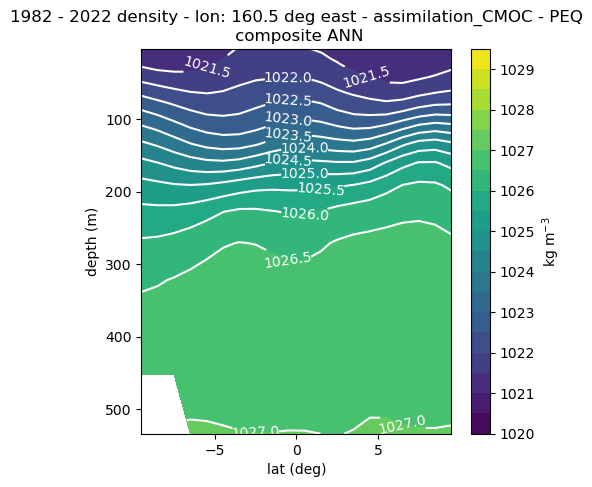

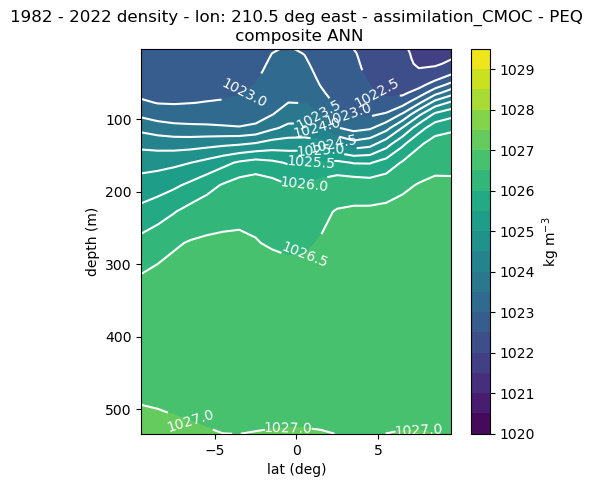

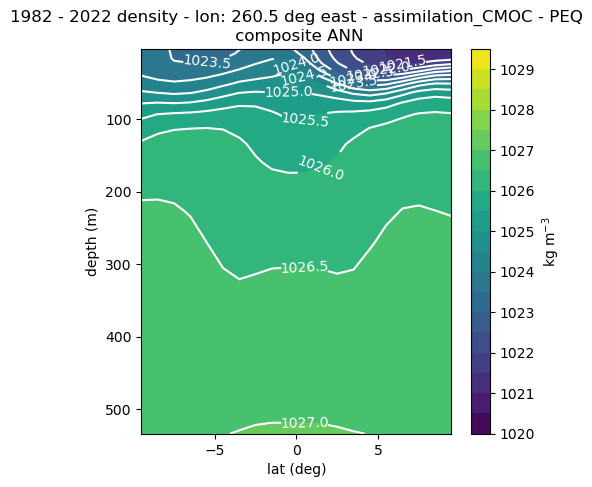

In [73]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['density'] = dict(dict = dict_profile_EQ['density'], unit =  units_dics['density'], contour_levels = np.arange(0,10,0.5)+ 1020 )
var = 'density'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### obs

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


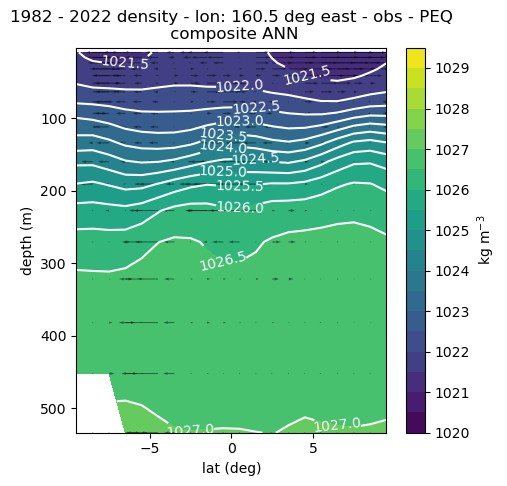

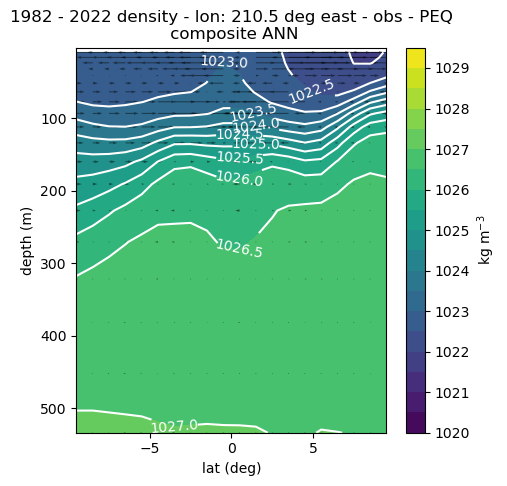

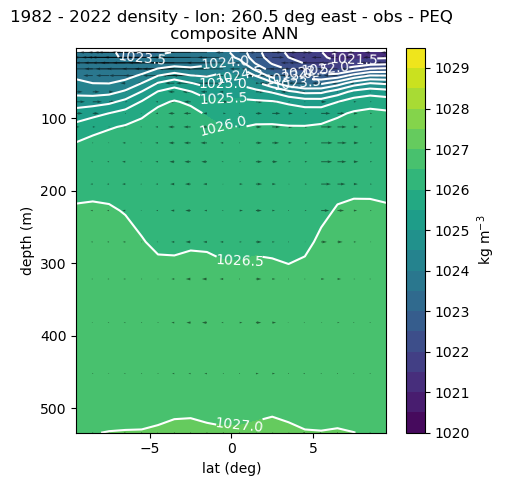

In [41]:
monthly_res = True
ds_list = ['obs']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['density'] = dict(dict = dict_profile_EQ['density'], unit =  units_dics['density'], contour_levels = np.arange(0,10,0.5)+ 1020 )
var = 'density'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### Historical

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


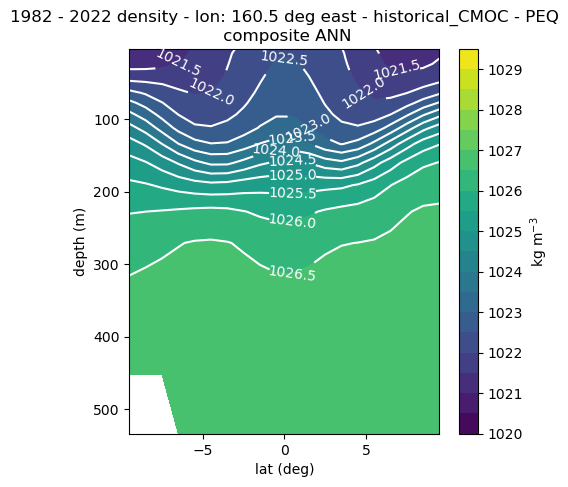

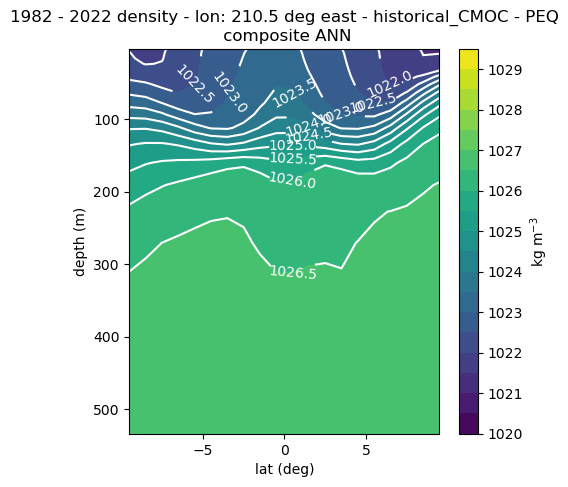

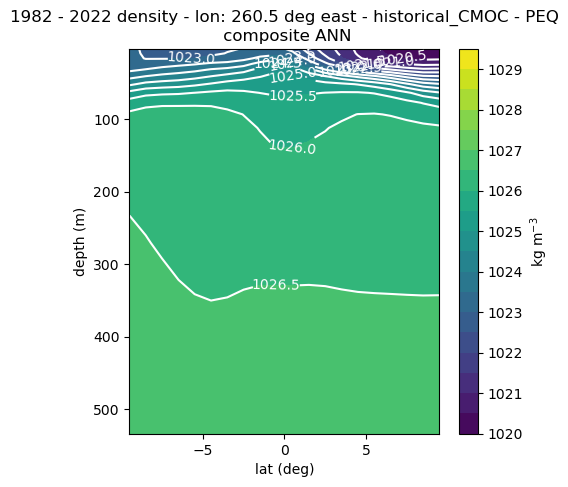

In [78]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['density'] = dict(dict = dict_profile_EQ['density'], unit =  units_dics['density'], contour_levels = np.arange(0,10,0.5)+ 1020 )
var = 'density'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### diffs

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


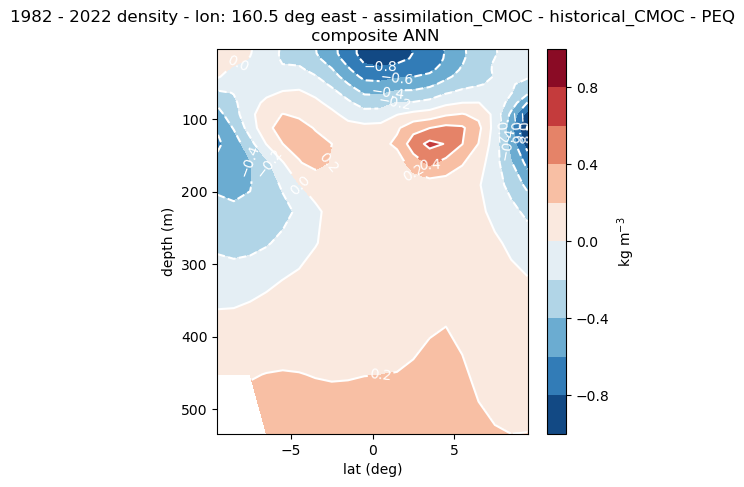

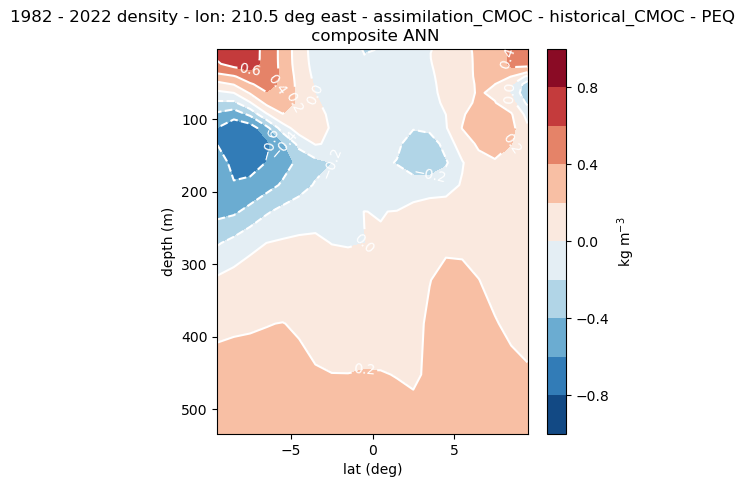

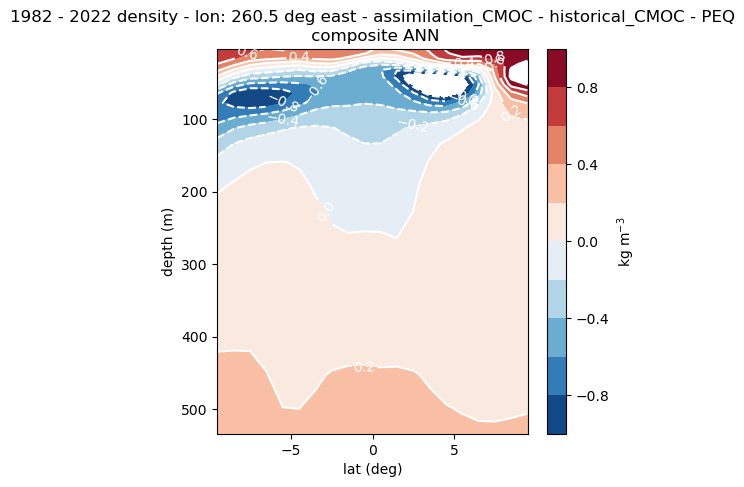

In [79]:
monthly_res = True
ds_list = ['assimilation_CMOC - historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['density'] = dict(dict = dict_profile_EQ_diff['density'], unit =  units_dics['density'], contour_levels = np.arange(-1,1.2,0.2)  )
var = 'density'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


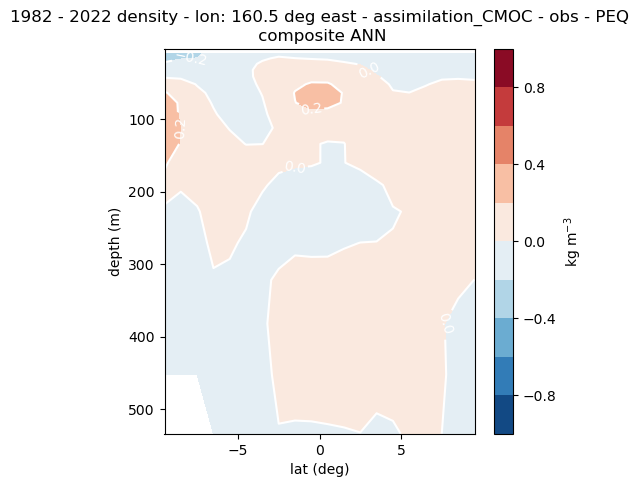

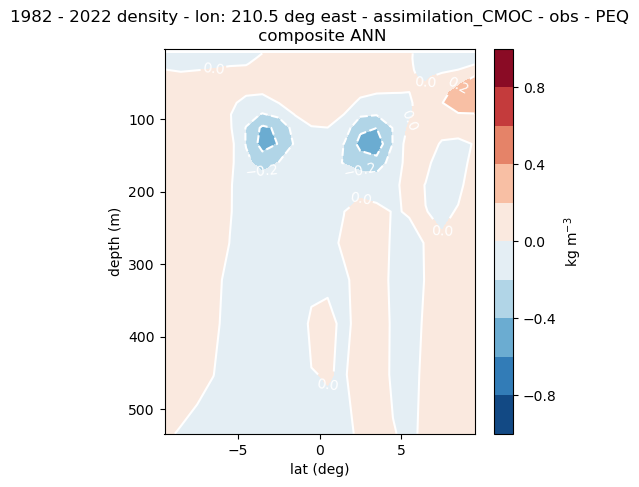

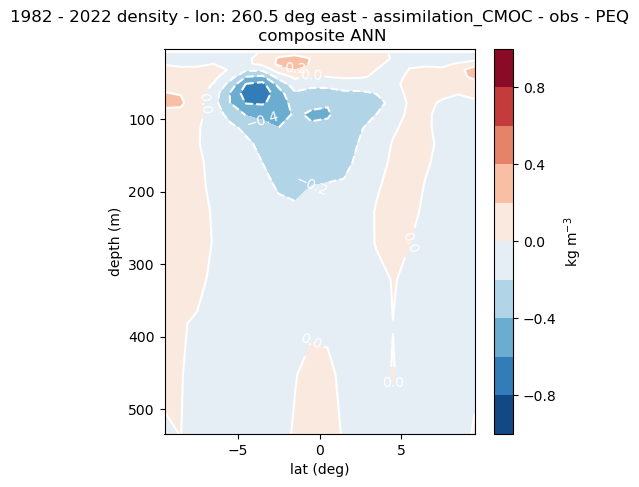

In [80]:
monthly_res = True
ds_list = ['assimilation_CMOC - obs']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['density'] = dict(dict = dict_profile_EQ_diff['density'], unit =  units_dics['density'], contour_levels = np.arange(-1,1.2,0.2)  )
var = 'density'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



#### agessc

##### assimilation

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


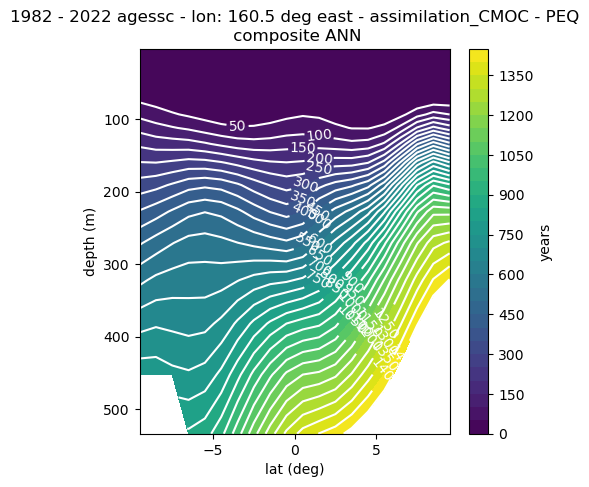

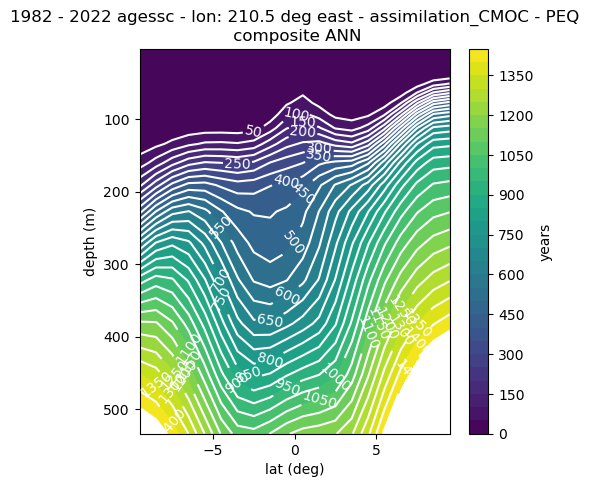

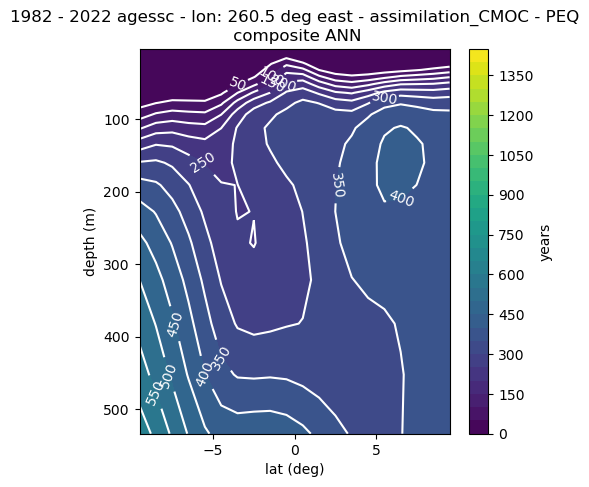

In [79]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['agessc'] = dict(dict = dict_profile_EQ['agessc'], unit =  units_dics['agessc'], contour_levels = np.arange(0,1500,50) )
var = 'agessc'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


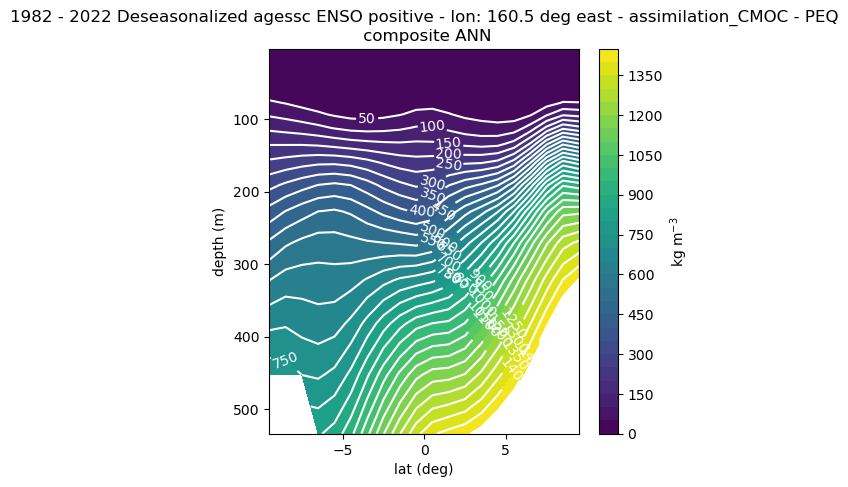

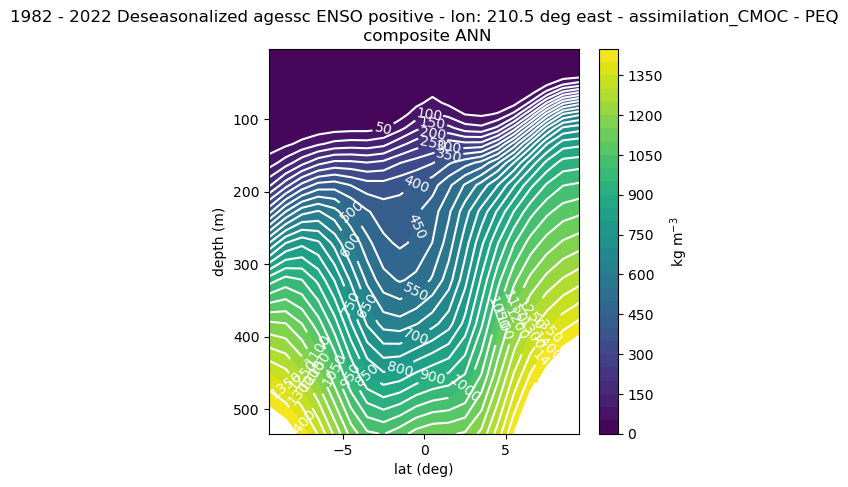

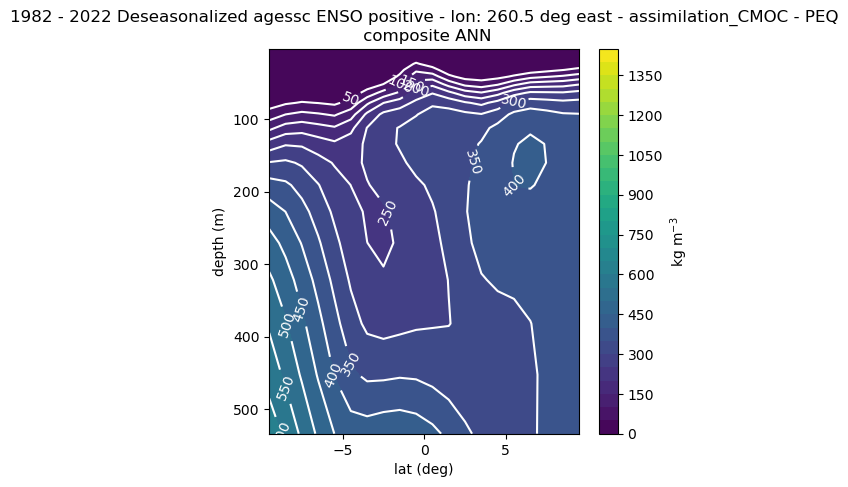

In [80]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['agessc'] = dict(dict = data_dicts_ELNI['agessc'], unit =  units_dics['density'], contour_levels =np.arange(0,1500,50) )
var = 'agessc'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO positive'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


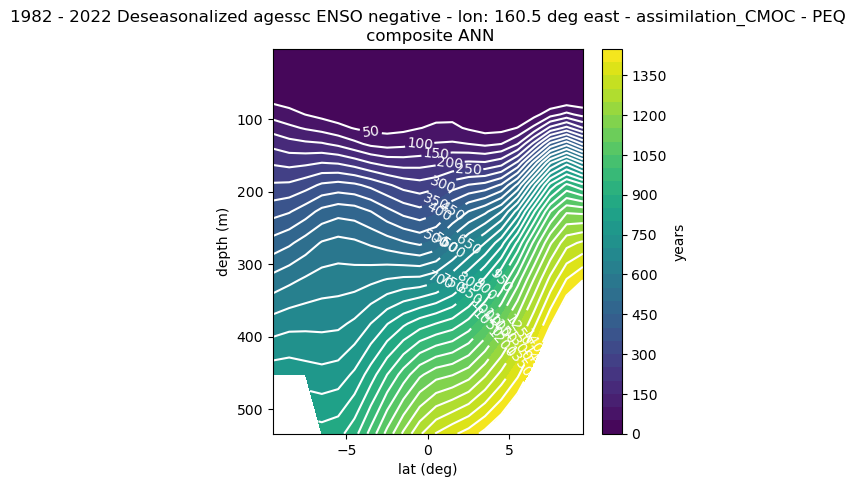

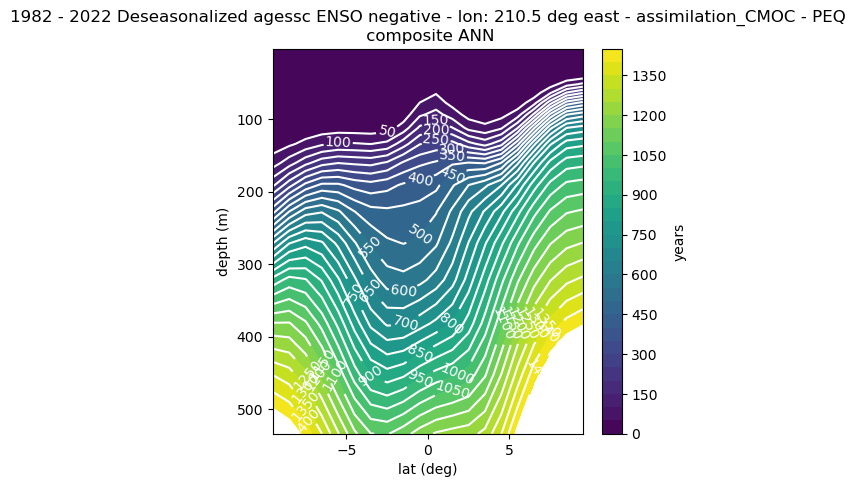

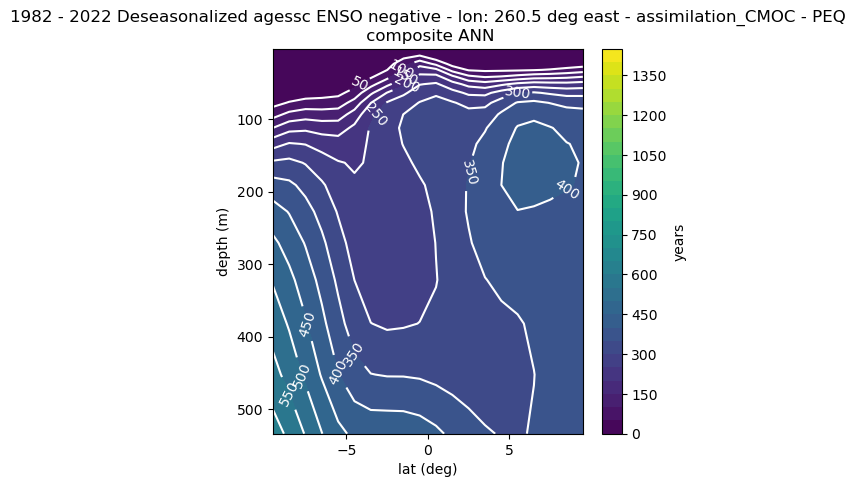

In [81]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['agessc'] = dict(dict = data_dicts_LANI['agessc'], unit =  units_dics['agessc'], contour_levels = np.arange(0,1500,50) )
var = 'agessc'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO negative'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### Historical

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


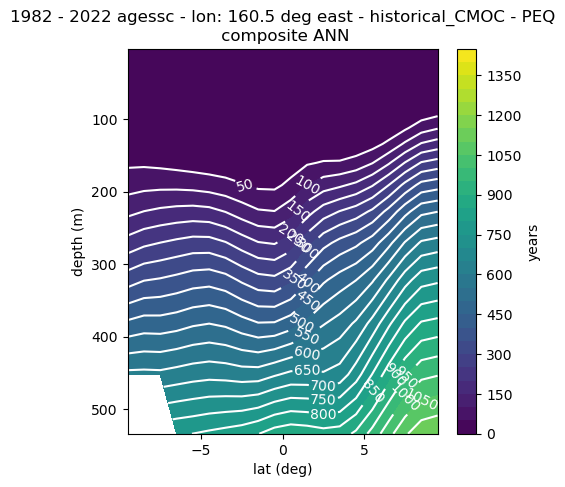

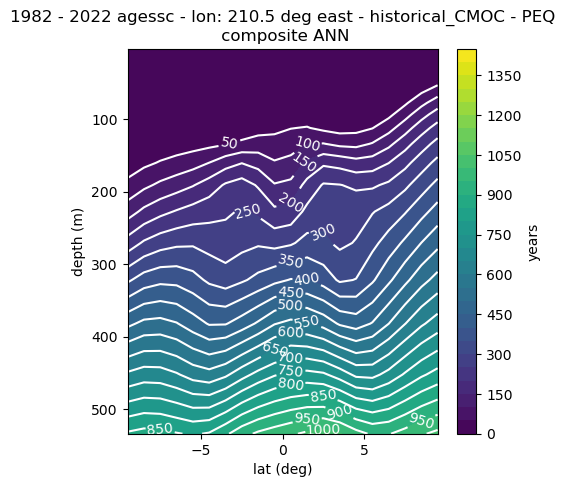

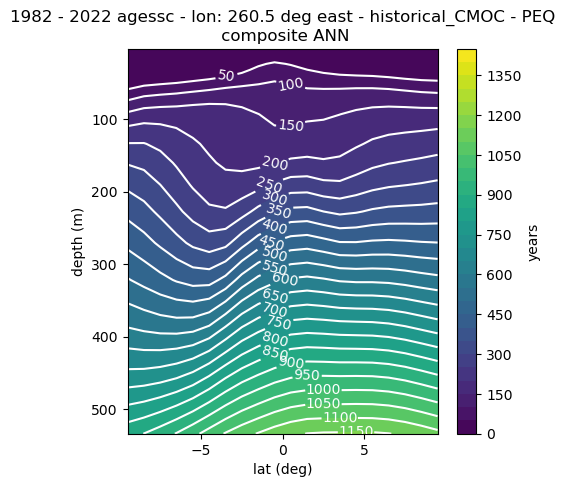

In [82]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['agessc'] = dict(dict = dict_profile_EQ['agessc'], unit =  units_dics['agessc'], contour_levels = np.arange(0,1500,50) )
var = 'agessc'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


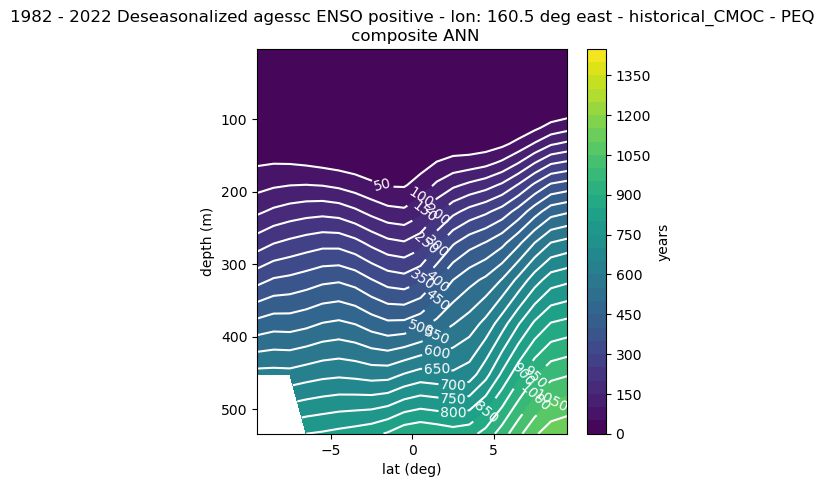

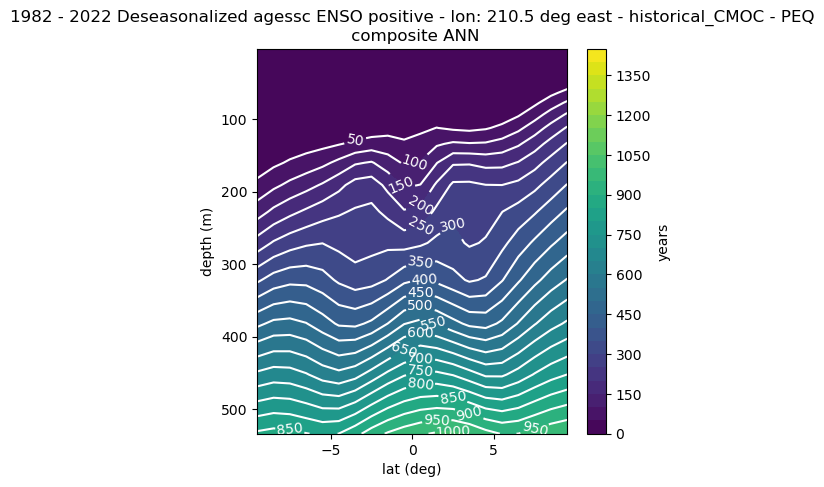

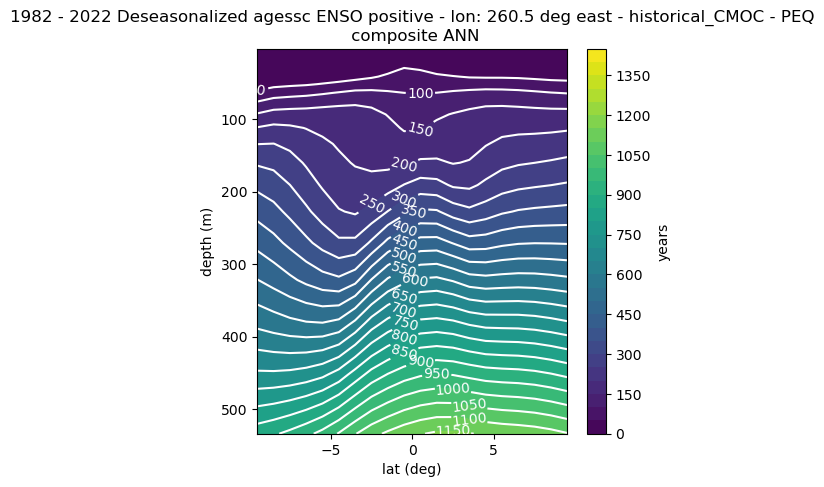

In [87]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['agessc'] = dict(dict = data_dicts_ELNI['agessc'], unit =  units_dics['agessc'], contour_levels = np.arange(0,1500,50) )
var = 'agessc'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO positive'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


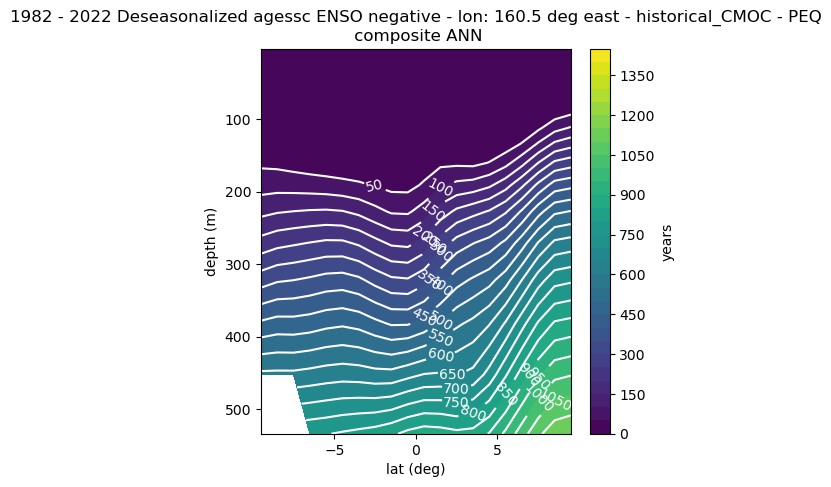

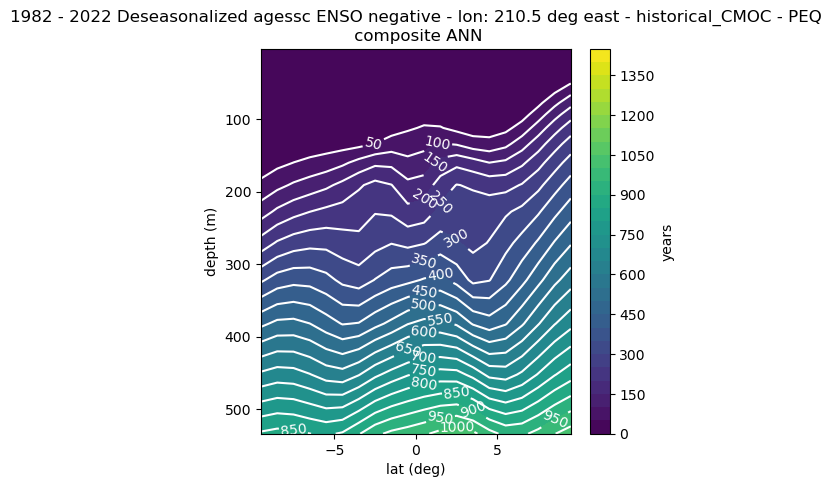

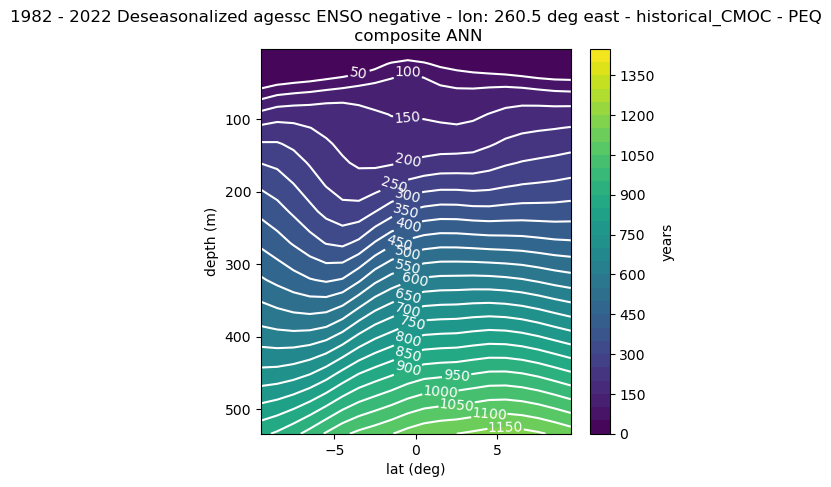

In [88]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['agessc'] = dict(dict = data_dicts_LANI['agessc'], unit =  units_dics['agessc'], contour_levels = np.arange(0,1500,50) )
var = 'agessc'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} Deseasonalized {var} ENSO negative'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



##### diffs

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


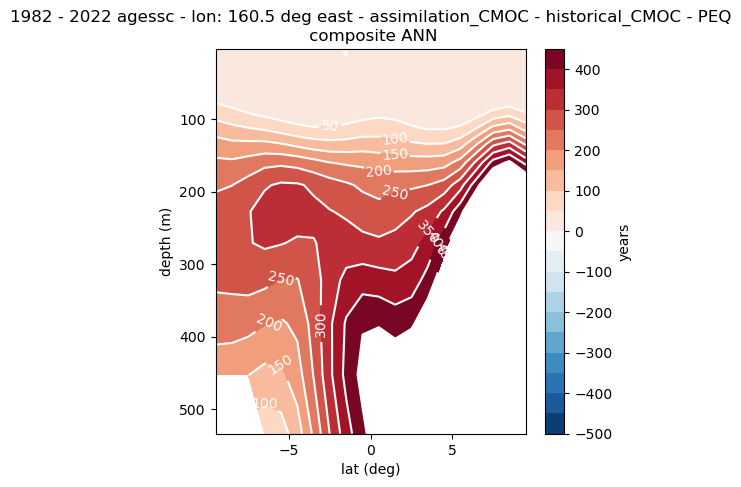

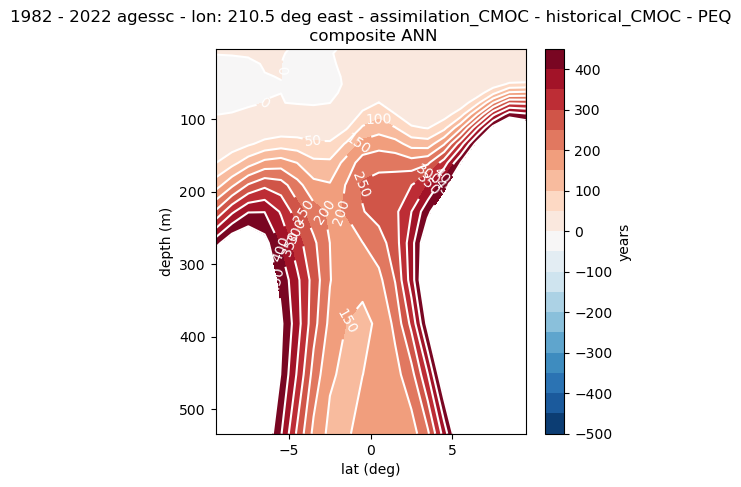

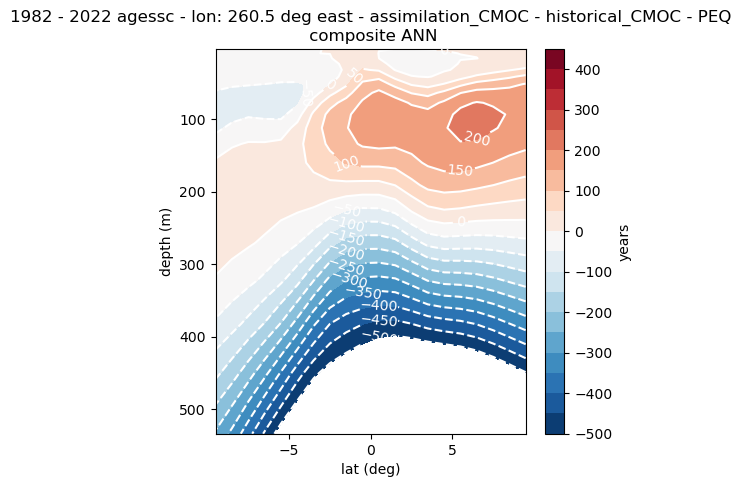

In [86]:
monthly_res = True
ds_list = ['assimilation_CMOC - historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['agessc'] = dict(dict = dict_profile_EQ_diff['agessc'], unit =  units_dics['agessc'], contour_levels = np.arange(-750,750,50)  )
var = 'agessc'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



#### so

JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


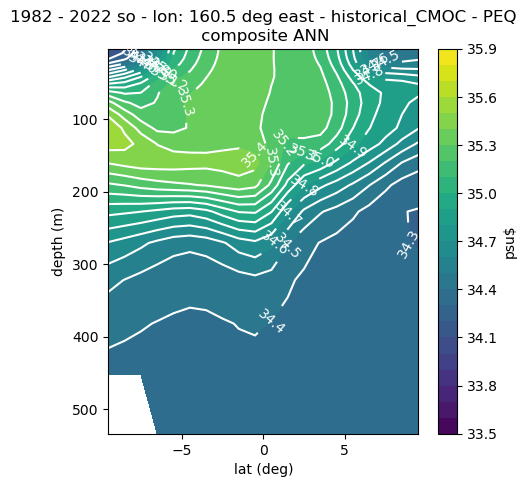

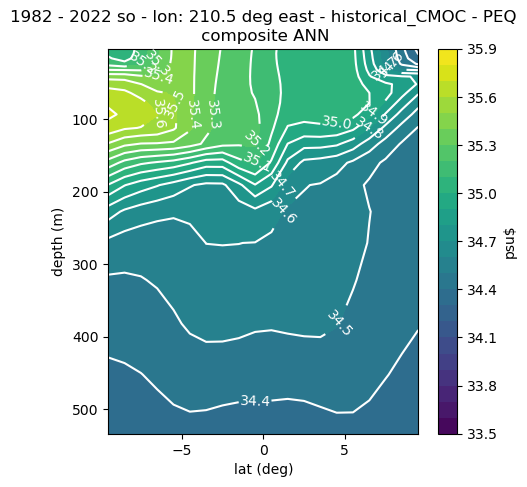

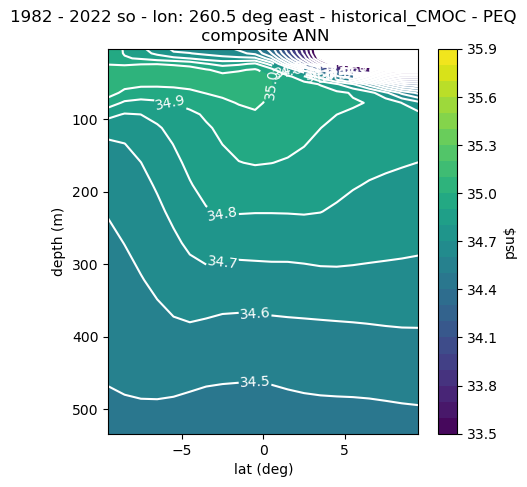

In [81]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['so'] = dict(dict = dict_profile_EQ['so'], unit =  units_dics['so'], contour_levels =  33.5 + np.arange(0,2.5,0.1) )
var = 'so'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


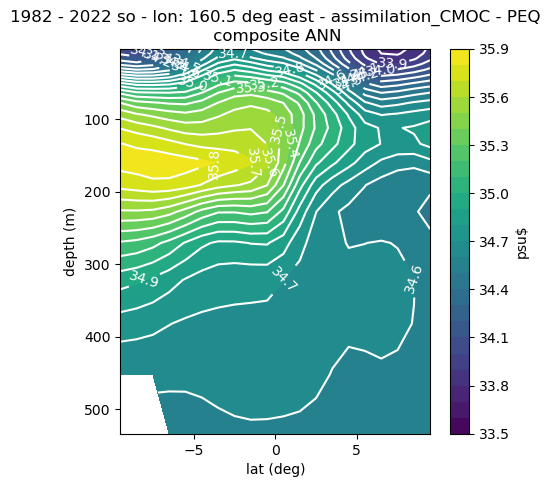

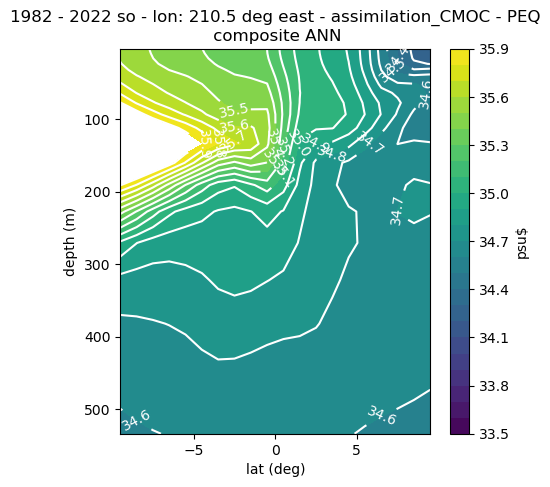

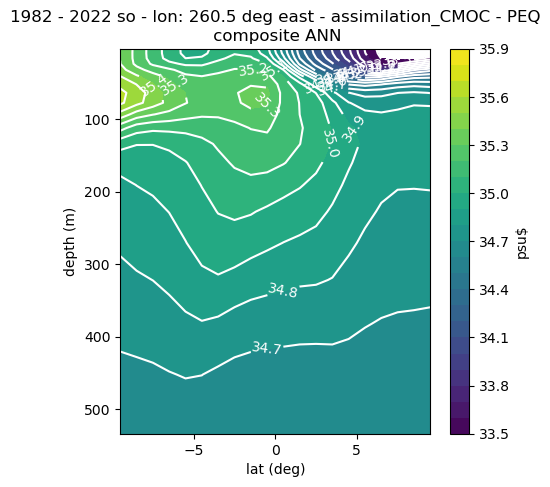

In [82]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['so'] = dict(dict = dict_profile_EQ['so'], unit =  units_dics['so'], contour_levels =  33.5 + np.arange(0,2.5,0.1) )
var = 'so'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


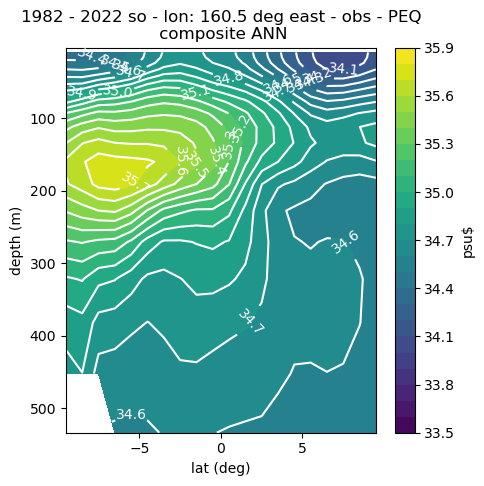

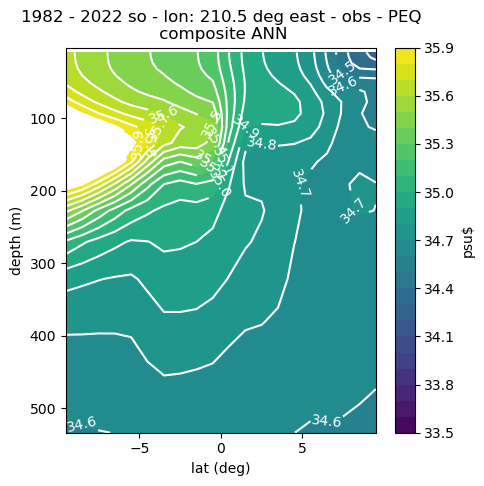

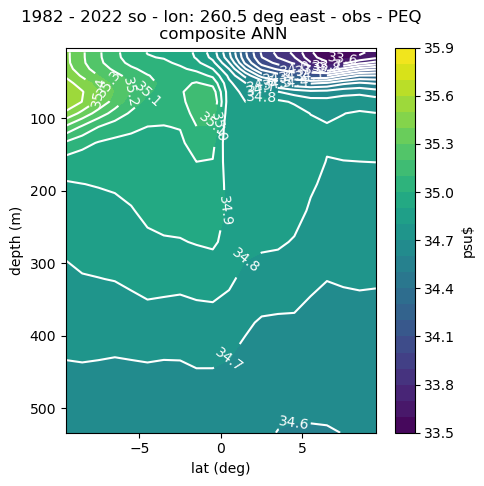

In [83]:
monthly_res = True
ds_list = ['obs']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['so'] = dict(dict = dict_profile_EQ['so'], unit =  units_dics['so'], contour_levels =  33.5 + np.arange(0,2.5,0.1) )
var = 'so'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


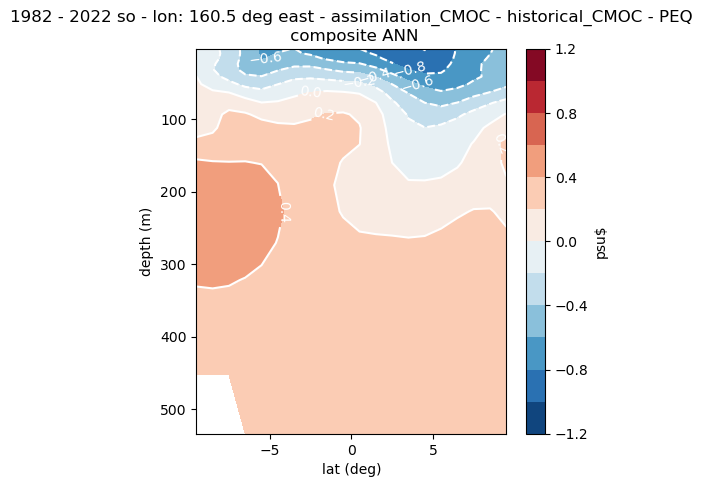

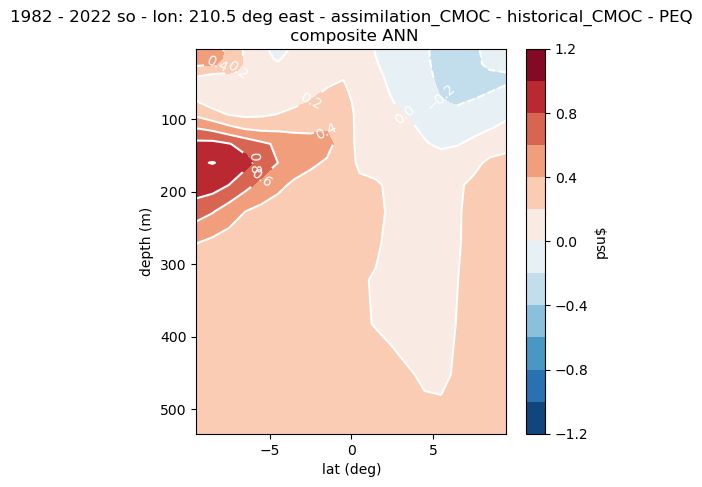

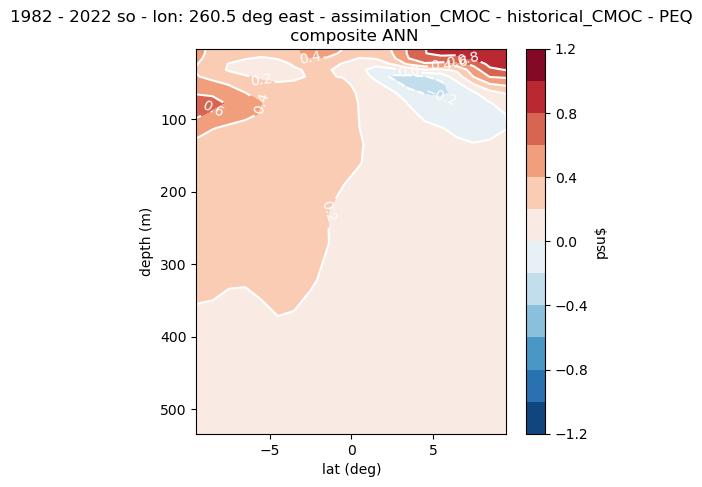

In [84]:
monthly_res = True
ds_list = ['assimilation_CMOC - historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['so'] = dict(dict = dict_profile_EQ_diff['so'], unit =  units_dics['so'], contour_levels =  np.arange(-1.2,1.4,0.2) )
var = 'so'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]
JFM:[0, 1, 2]
AMJ:[3, 4, 5]
JAS:[6, 7, 8]
OND:[9, 10, 11]
ANN:[ 0  1  2  3  4  5  6  7  8  9 10 11]


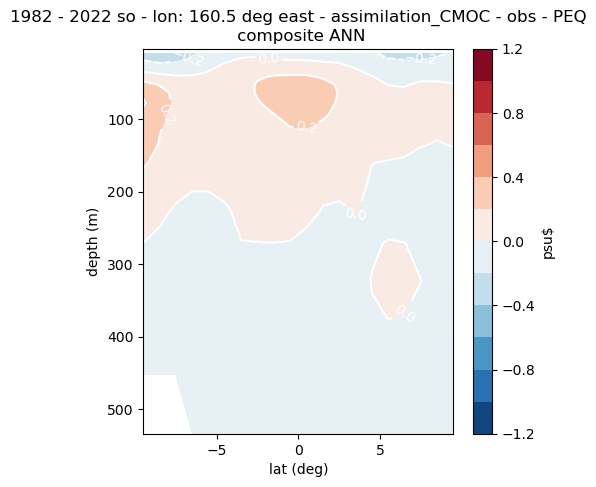

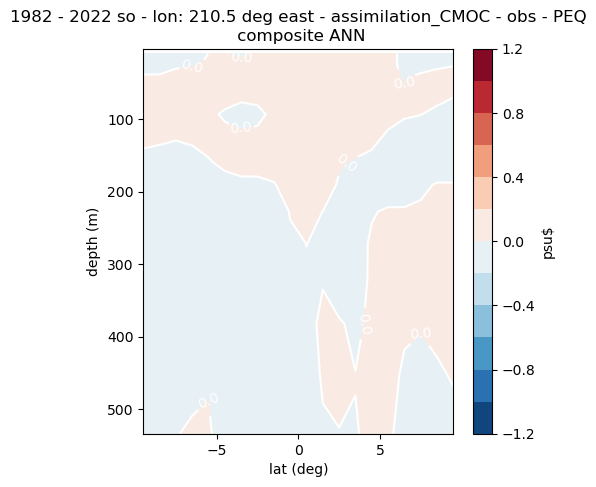

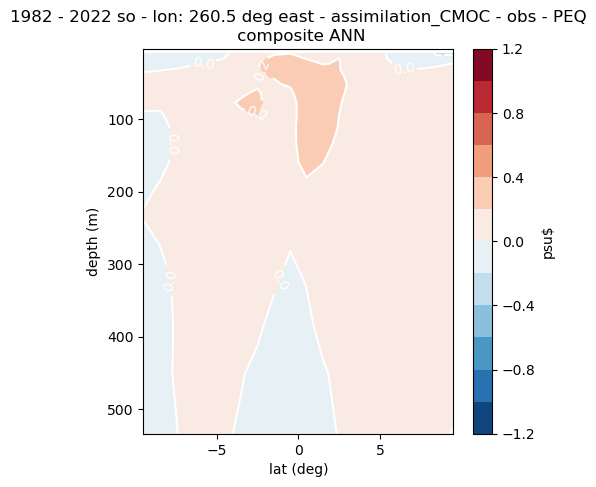

In [85]:
monthly_res = True
ds_list = ['assimilation_CMOC - obs']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['so'] = dict(dict = dict_profile_EQ_diff['so'], unit =  units_dics['so'], contour_levels =  np.arange(-1.2,1.4,0.2) )
var = 'so'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



#### thetao

In [ ]:
monthly_res = True
ds_list = ['historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['so'] = dict(dict = dict_profile_EQ['thetao'], unit =  units_dics['thetao'], contour_levels =  [6,8,10,12,14,16,18,20,22,24,26,28,30,32] )
var = 'so'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



In [ ]:
monthly_res = True
ds_list = ['assimilation_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['so'] = dict(dict = dict_profile_EQ['thetao'], unit =  units_dics['thetao'], contour_levels =  [6,8,10,12,14,16,18,20,22,24,26,28,30,32] )
var = 'so'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



In [ ]:
monthly_res = True
ds_list = ['obs']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['so'] = dict(dict = dict_profile_EQ['thetao'], unit =  units_dics['thetao'], contour_levels =  [6,8,10,12,14,16,18,20,22,24,26,28,30,32] )
var = 'so'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                # cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



In [ ]:
monthly_res = True
ds_list = ['assimilation_CMOC - historical_CMOC']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_profile_EQ_diff['thetao'], unit =  units_dics['thetao'], contour_levels =  np.arange(-5,6) )
var = 'thetao'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)



In [ ]:
monthly_res = True
ds_list = ['assimilation_CMOC - obs']
figsize = (5,5)

lev_range = 600
yeartoplot = list(dict_anom_snaps_clim_removed['uo']['PEQ']['assimilation_CMOC'].year.values)
bms_label = 'PEQ'
longitude = 260

plot_dict = {}
plot_dict['thetao'] = dict(dict = dict_profile_EQ_diff['thetao'], unit =  units_dics['thetao'], contour_levels =  np.arange(-5,6) )
var = 'thetao'
ds_dicts = plot_dict[var]['dict']
title = f'{y0_show} - {y1_show} {var}'
units = plot_dict[var]['unit']
contour_levels = plot_dict[var]['contour_levels']

for lon in [160,210,260]:
    snapshot_crossection(ds_list,
                                ds_dicts,
                                bms_label,
                                yeartoplot,
                                longitude=lon,
                title=title,
                figsize=figsize,
                cmap = 'RdBu_r',
                colorbar_label = units, 
                lev_interp = lev_interp,
                contour_levels = contour_levels,
                season = 'ANN',
                lev_range = lev_range,
                show=True)

